## <center> Студенческий проект, неофициальная реализация по статье "Nasrullah, Z. and Zhao, Y., Musical Artist Classification with Convolutional Recurrent Neural Networks. International Joint Conference on Neural Networks (IJCNN), 2019."</center>
### <center>Статья: https://arxiv.org/pdf/1901.04555.pdf</center>

**<center>Московский государственный университет имени М.В.Ломоносова</center>**

**<center>Факультет вычислительной математики и кибернетики</center>**

**<center>Кафедра математических методов прогнозирования</center>**

<center><b>Команда "2 Миньона и Гераклы" в составе: <i>Алексей Думбай, Виктор Януш, Сергей Серов, Анна Липкина.</i>
</b></center>

In [1]:
%load_ext autoreload
%autoreload 2

import os
import sys
import time
import pickle
from collections import Counter, defaultdict
import itertools

import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.backends.cudnn as cudnn
from torch.utils.data import DataLoader, TensorDataset
import librosa
import librosa.display
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.manifold import TSNE
from tqdm import tqdm
import seaborn as sns
sns.set()

from music_classification.feature_extractor.data_holder import DataHolder
from music_classification.feature_extractor.mel_extractor import MelExtractor
from music_classification.utils import train_model
from music_classification.models.crnn import CRNN

%matplotlib inline

### Часть 1. Загрузка данных

**Датасет artist20 взят отсюда: https://labrosa.ee.columbia.edu/projects/artistid/**

In [3]:
DATA_PATH = "./data/artist20/"
SAMPLING_RATE = 16000
data_holder = DataHolder(**{"sr" : SAMPLING_RATE}) # FIX ME AFTER HOTFIX!!!

In [98]:
#data_holder.process_folder(DATA_PATH)

NoBackendError: 

In [4]:
DATASET_PREPROCESSED_PATH = "./data/artist20_preprocessed.pkl"
#data_holder.save_dataset(DATASET_PREPROCESSED_PATH)

**Загрузка датасета:**

In [5]:
data_holder.load_dataset(DATASET_PREPROCESSED_PATH)

### Часть 2. Разбиение данных на тренировочную, тестовую и валидационную выборки

In [22]:
SLICE_LENGTH = 100
# each window --- SLICE_LENGTH / 32 second

#### Разбиение по песням

In [23]:
song_split_data = data_holder.get_song_split(slice_length=SLICE_LENGTH, overlap=0)

#### Разбиение по альбомам

In [24]:
album_split_data = data_holder.get_album_split(slice_length=SLICE_LENGTH, overlap=0)

### Часть 3. Создание моделей и их обучение

**Параметры моделей**

In [25]:
NUM_CLASSES = len(data_holder.artists_codes)
NUM_CLASSES

20

In [26]:
FREQ_DIM = song_split_data["train"][0].shape[1]
FREQ_DIM

128

**Проверка правильности построения датасетов**

In [27]:
for data_type in ("train", "validation", "test"):
    assert(song_split_data[data_type][0].shape[1] == FREQ_DIM)
    assert(album_split_data[data_type][0].shape[1] == FREQ_DIM)

### Обучение моделей

#### Song-split

In [28]:
NUM_MODELS = 3
models_song = []

for i in range(NUM_MODELS):
    model_song = CRNN(
            freq_dim=FREQ_DIM,
            channel_dim=1, # MONO
            num_classes=NUM_CLASSES)

    result_song = train_model(
                    model=model_song,
                    data=song_split_data,
                    n_epochs=20)
    models_song.append(model_song)
    print(f"TRAINED {i + 1} MODEL OF {NUM_MODELS}")

Epoch 0:   2%|▏         | 60/2750 [00:04<03:15, 13.79 batches/s, iters=60, loss=2.85]


Epoch 0:   4%|▍         | 120/2750 [00:08<03:11, 13.73 batches/s, iters=121, loss=2.84]


Epoch 0:   7%|▋         | 180/2750 [00:13<03:08, 13.61 batches/s, iters=181, loss=2.75]


Epoch 0:   9%|▊         | 240/2750 [00:17<03:02, 13.73 batches/s, iters=241, loss=2.86]


Epoch 0:  11%|█         | 300/2750 [00:21<02:59, 13.62 batches/s, iters=301, loss=2.72]


Epoch 0:  13%|█▎        | 360/2750 [00:26<02:54, 13.72 batches/s, iters=361, loss=2.82]


Epoch 0:  15%|█▌        | 420/2750 [00:30<02:50, 13.70 batches/s, iters=421, loss=2.69]


Epoch 0:  17%|█▋        | 480/2750 [00:35<02:47, 13.58 batches/s, iters=481, loss=2.69]


Epoch 0:  20%|█▉        | 540/2750 [00:39<02:46, 13.26 batches/s, iters=541, loss=2.61]


Epoch 0:  22%|██▏       | 600/2750 [00:44<02:38, 13.56 batches/s, iters=601, loss=2.56]


Epoch 0:  24%|██▍       | 660/2750 [00:48<02:34, 13.56 batches/s, iters=661, loss=2.71]


Epoch 0:  26%|██▌       | 720/2750 [00:52<02:31, 13.38 batches/s, iters=721, loss=2.46]


Epoch 0:  28%|██▊       | 780/2750 [00:57<02:26, 13.47 batches/s, iters=781, loss=2.5] 


Epoch 0:  31%|███       | 840/2750 [01:01<02:22, 13.43 batches/s, iters=841, loss=2.52]


Epoch 0:  33%|███▎      | 900/2750 [01:06<02:17, 13.50 batches/s, iters=901, loss=2.58]


Epoch 0:  35%|███▍      | 960/2750 [01:10<02:13, 13.40 batches/s, iters=961, loss=2.4] 


Epoch 0:  37%|███▋      | 1020/2750 [01:15<02:08, 13.50 batches/s, iters=1020, loss=2.45]


Epoch 0:  39%|███▉      | 1078/2750 [01:19<02:04, 13.43 batches/s, iters=1079, loss=2.6]


Epoch 0:  41%|████▏     | 1136/2750 [01:23<01:59, 13.52 batches/s, iters=1138, loss=2.31]


Epoch 0:  43%|████▎     | 1196/2750 [01:28<01:56, 13.38 batches/s, iters=1196, loss=2.35]


Epoch 0:  46%|████▌     | 1254/2750 [01:32<01:52, 13.33 batches/s, iters=1255, loss=2.28]


Epoch 0:  48%|████▊     | 1312/2750 [01:36<01:48, 13.31 batches/s, iters=1314, loss=2.58]


Epoch 0:  50%|████▉     | 1372/2750 [01:41<01:43, 13.36 batches/s, iters=1372, loss=2.14]


Epoch 0:  52%|█████▏    | 1430/2750 [01:45<01:38, 13.41 batches/s, iters=1431, loss=2.2]


Epoch 0:  54%|█████▍    | 1488/2750 [01:50<01:34, 13.33 batches/s, iters=1490, loss=2.16]


Epoch 0:  56%|█████▋    | 1548/2750 [01:54<01:30, 13.24 batches/s, iters=1548, loss=2.39]


Epoch 0:  58%|█████▊    | 1606/2750 [01:58<01:25, 13.41 batches/s, iters=1607, loss=2.27]


Epoch 0:  61%|██████    | 1664/2750 [02:03<01:21, 13.40 batches/s, iters=1666, loss=2.27]


Epoch 0:  63%|██████▎   | 1724/2750 [02:07<01:16, 13.45 batches/s, iters=1724, loss=2.28]


Epoch 0:  65%|██████▍   | 1782/2750 [02:12<01:13, 13.21 batches/s, iters=1783, loss=2.15]


Epoch 0:  67%|██████▋   | 1840/2750 [02:16<01:07, 13.50 batches/s, iters=1842, loss=2.21]


Epoch 0:  69%|██████▉   | 1900/2750 [02:20<01:03, 13.35 batches/s, iters=1900, loss=2.21]


Epoch 0:  71%|███████   | 1958/2750 [02:25<00:58, 13.52 batches/s, iters=1959, loss=2.03]


Epoch 0:  73%|███████▎  | 2016/2750 [02:29<00:56, 12.98 batches/s, iters=2018, loss=2.23]


Epoch 0:  75%|███████▌  | 2076/2750 [02:33<00:50, 13.43 batches/s, iters=2076, loss=2.14]


Epoch 0:  78%|███████▊  | 2134/2750 [02:38<00:45, 13.44 batches/s, iters=2135, loss=2.12]


Epoch 0:  80%|███████▉  | 2192/2750 [02:42<00:41, 13.34 batches/s, iters=2194, loss=1.9] 


Epoch 0:  82%|████████▏ | 2252/2750 [02:46<00:36, 13.48 batches/s, iters=2252, loss=2.02]


Epoch 0:  84%|████████▍ | 2310/2750 [02:51<00:33, 13.25 batches/s, iters=2311, loss=1.93]


Epoch 0:  86%|████████▌ | 2368/2750 [02:55<00:28, 13.35 batches/s, iters=2370, loss=1.94]


Epoch 0:  88%|████████▊ | 2428/2750 [03:00<00:24, 13.36 batches/s, iters=2428, loss=2.21]


Epoch 0:  90%|█████████ | 2486/2750 [03:04<00:19, 13.43 batches/s, iters=2487, loss=2.04]


Epoch 0:  93%|█████████▎| 2544/2750 [03:08<00:15, 13.37 batches/s, iters=2546, loss=2.12]


Epoch 0:  95%|█████████▍| 2604/2750 [03:13<00:10, 13.46 batches/s, iters=2604, loss=1.93]


Epoch 0:  97%|█████████▋| 2662/2750 [03:17<00:06, 13.37 batches/s, iters=2663, loss=2.01]


Epoch 0:  99%|█████████▉| 2720/2750 [03:22<00:02, 13.33 batches/s, iters=2722, loss=1.92]


Validate:  14%|█▎        | 40/296 [00:01<00:06, 37.82 batches/s, loss=1.26]


Validate:  42%|████▏     | 124/296 [00:03<00:04, 38.02 batches/s, loss=1.8]


Validate:  69%|██████▉   | 204/296 [00:05<00:02, 37.86 batches/s, loss=1.42]


Validate:  96%|█████████▌| 284/296 [00:07<00:00, 37.80 batches/s, loss=3.3] 


Epoch 1:   2%|▏         | 52/2750 [00:03<03:21, 13.39 batches/s, iters=2803, loss=2.13]


Epoch 1:   4%|▍         | 112/2750 [00:08<03:16, 13.43 batches/s, iters=2862, loss=2.24]


Epoch 1:   6%|▌         | 170/2750 [00:12<03:15, 13.22 batches/s, iters=2922, loss=1.96]


Epoch 1:   8%|▊         | 230/2750 [00:17<03:09, 13.33 batches/s, iters=2981, loss=2.02]


Epoch 1:  11%|█         | 290/2750 [00:21<03:04, 13.35 batches/s, iters=3040, loss=1.94]


Epoch 1:  13%|█▎        | 348/2750 [00:26<03:00, 13.34 batches/s, iters=3100, loss=1.84]


Epoch 1:  15%|█▍        | 408/2750 [00:30<02:55, 13.37 batches/s, iters=3159, loss=2.01]


Epoch 1:  17%|█▋        | 468/2750 [00:34<02:50, 13.42 batches/s, iters=3218, loss=1.92]


Epoch 1:  19%|█▉        | 526/2750 [00:39<02:46, 13.34 batches/s, iters=3278, loss=1.97]


Epoch 1:  21%|██▏       | 586/2750 [00:43<02:40, 13.45 batches/s, iters=3337, loss=1.6] 


Epoch 1:  23%|██▎       | 646/2750 [00:48<02:37, 13.37 batches/s, iters=3396, loss=1.82]


Epoch 1:  26%|██▌       | 704/2750 [00:52<02:32, 13.41 batches/s, iters=3456, loss=1.63]


Epoch 1:  28%|██▊       | 764/2750 [00:57<02:28, 13.40 batches/s, iters=3515, loss=1.65]


Epoch 1:  30%|██▉       | 824/2750 [01:01<02:24, 13.34 batches/s, iters=3574, loss=1.78]


Epoch 1:  32%|███▏      | 882/2750 [01:06<02:21, 13.16 batches/s, iters=3634, loss=2.13]


Epoch 1:  34%|███▍      | 942/2750 [01:10<02:15, 13.35 batches/s, iters=3693, loss=1.49]


Epoch 1:  36%|███▋      | 1002/2750 [01:14<02:09, 13.47 batches/s, iters=3752, loss=1.67]


Epoch 1:  39%|███▊      | 1060/2750 [01:19<02:05, 13.43 batches/s, iters=3811, loss=1.91]


Epoch 1:  41%|████      | 1118/2750 [01:23<02:01, 13.40 batches/s, iters=3870, loss=2.24]


Epoch 1:  43%|████▎     | 1178/2750 [01:28<01:57, 13.36 batches/s, iters=3928, loss=1.63]


Epoch 1:  45%|████▍     | 1236/2750 [01:32<01:52, 13.41 batches/s, iters=3987, loss=1.5] 


Epoch 1:  47%|████▋     | 1294/2750 [01:36<01:48, 13.36 batches/s, iters=4046, loss=2.03]


Epoch 1:  49%|████▉     | 1354/2750 [01:41<01:44, 13.38 batches/s, iters=4104, loss=1.56]


Epoch 1:  51%|█████▏    | 1412/2750 [01:45<01:39, 13.47 batches/s, iters=4163, loss=1.64]


Epoch 1:  53%|█████▎    | 1470/2750 [01:50<01:36, 13.32 batches/s, iters=4222, loss=1.68]


Epoch 1:  56%|█████▌    | 1530/2750 [01:54<01:31, 13.31 batches/s, iters=4280, loss=1.74]


Epoch 1:  58%|█████▊    | 1588/2750 [01:58<01:26, 13.41 batches/s, iters=4339, loss=1.67]


Epoch 1:  60%|█████▉    | 1646/2750 [02:03<01:22, 13.37 batches/s, iters=4398, loss=1.65]


Epoch 1:  62%|██████▏   | 1706/2750 [02:07<01:18, 13.38 batches/s, iters=4456, loss=1.6]


Epoch 1:  64%|██████▍   | 1764/2750 [02:11<01:13, 13.41 batches/s, iters=4515, loss=1.62]


Epoch 1:  66%|██████▋   | 1822/2750 [02:16<01:09, 13.37 batches/s, iters=4574, loss=1.51]


Epoch 1:  68%|██████▊   | 1882/2750 [02:20<01:04, 13.37 batches/s, iters=4632, loss=1.72]


Epoch 1:  71%|███████   | 1940/2750 [02:25<01:00, 13.33 batches/s, iters=4691, loss=1.35]


Epoch 1:  73%|███████▎  | 1998/2750 [02:29<00:56, 13.36 batches/s, iters=4750, loss=1.36]


Epoch 1:  75%|███████▍  | 2058/2750 [02:33<00:51, 13.42 batches/s, iters=4808, loss=1.43]


Epoch 1:  77%|███████▋  | 2116/2750 [02:38<00:47, 13.30 batches/s, iters=4867, loss=1.77]


Epoch 1:  79%|███████▉  | 2174/2750 [02:42<00:43, 13.33 batches/s, iters=4926, loss=1.57]


Epoch 1:  81%|████████  | 2234/2750 [02:47<00:38, 13.44 batches/s, iters=4984, loss=1.64]


Epoch 1:  83%|████████▎ | 2292/2750 [02:51<00:34, 13.45 batches/s, iters=5043, loss=1.23]


Epoch 1:  85%|████████▌ | 2350/2750 [02:55<00:29, 13.44 batches/s, iters=5102, loss=1.49]


Epoch 1:  88%|████████▊ | 2410/2750 [03:00<00:25, 13.31 batches/s, iters=5160, loss=1.76]


Epoch 1:  90%|████████▉ | 2468/2750 [03:04<00:20, 13.45 batches/s, iters=5219, loss=1.48]


Epoch 1:  92%|█████████▏| 2526/2750 [03:09<00:16, 13.38 batches/s, iters=5278, loss=1.74]


Epoch 1:  94%|█████████▍| 2586/2750 [03:13<00:12, 13.45 batches/s, iters=5336, loss=1.62]


Epoch 1:  96%|█████████▌| 2644/2750 [03:17<00:07, 13.34 batches/s, iters=5395, loss=1.46]


Epoch 1:  98%|█████████▊| 2702/2750 [03:22<00:03, 13.43 batches/s, iters=5454, loss=1.82]


Validate:   5%|▌         | 16/296 [00:00<00:07, 36.39 batches/s, loss=1.25]


Validate:  32%|███▏      | 96/296 [00:02<00:05, 38.03 batches/s, loss=2.81]


Validate:  59%|█████▉    | 176/296 [00:04<00:03, 37.75 batches/s, loss=0.279]


Validate:  88%|████████▊ | 260/296 [00:06<00:00, 38.08 batches/s, loss=0.13]


Epoch 2:   1%|          | 32/2750 [00:02<03:22, 13.44 batches/s, iters=5533, loss=1.69]


Epoch 2:   3%|▎         | 92/2750 [00:06<03:17, 13.44 batches/s, iters=5593, loss=1.54]


Epoch 2:   6%|▌         | 152/2750 [00:11<03:13, 13.40 batches/s, iters=5652, loss=1.35]


Epoch 2:   8%|▊         | 210/2750 [00:15<03:11, 13.26 batches/s, iters=5712, loss=1.6] 


Epoch 2:  10%|▉         | 270/2750 [00:20<03:05, 13.34 batches/s, iters=5771, loss=1.19]


Epoch 2:  12%|█▏        | 330/2750 [00:24<03:00, 13.38 batches/s, iters=5830, loss=1.29]


Epoch 2:  14%|█▍        | 388/2750 [00:29<02:56, 13.37 batches/s, iters=5890, loss=1.56]


Epoch 2:  16%|█▋        | 448/2750 [00:33<02:53, 13.25 batches/s, iters=5949, loss=1.25]


Epoch 2:  18%|█▊        | 508/2750 [00:37<02:47, 13.37 batches/s, iters=6008, loss=1.44]


Epoch 2:  21%|██        | 566/2750 [00:42<02:41, 13.50 batches/s, iters=6068, loss=1.22]


Epoch 2:  23%|██▎       | 626/2750 [00:46<02:36, 13.56 batches/s, iters=6127, loss=1.48]


Epoch 2:  25%|██▍       | 686/2750 [00:51<02:33, 13.43 batches/s, iters=6186, loss=1.49]


Epoch 2:  27%|██▋       | 744/2750 [00:55<02:28, 13.49 batches/s, iters=6246, loss=1.47]


Epoch 2:  29%|██▉       | 804/2750 [00:59<02:24, 13.51 batches/s, iters=6305, loss=1.32]


Epoch 2:  31%|███▏      | 864/2750 [01:04<02:19, 13.51 batches/s, iters=6364, loss=1.64]


Epoch 2:  34%|███▎      | 922/2750 [01:08<02:16, 13.44 batches/s, iters=6424, loss=1.37]


Epoch 2:  36%|███▌      | 982/2750 [01:13<02:10, 13.50 batches/s, iters=6483, loss=1.54]


Epoch 2:  38%|███▊      | 1040/2750 [01:17<02:05, 13.60 batches/s, iters=6542, loss=1.45]


Epoch 2:  40%|████      | 1100/2750 [01:21<02:02, 13.52 batches/s, iters=6600, loss=1.43]


Epoch 2:  42%|████▏     | 1158/2750 [01:26<01:58, 13.42 batches/s, iters=6659, loss=1.37]


Epoch 2:  44%|████▍     | 1216/2750 [01:30<01:53, 13.46 batches/s, iters=6718, loss=1.52]


Epoch 2:  46%|████▋     | 1276/2750 [01:34<01:49, 13.41 batches/s, iters=6776, loss=1.28]


Epoch 2:  49%|████▊     | 1334/2750 [01:39<01:45, 13.48 batches/s, iters=6835, loss=1.6] 


Epoch 2:  51%|█████     | 1392/2750 [01:43<01:41, 13.41 batches/s, iters=6894, loss=1.23]


Epoch 2:  53%|█████▎    | 1452/2750 [01:48<01:37, 13.36 batches/s, iters=6952, loss=1.5]


Epoch 2:  55%|█████▍    | 1510/2750 [01:52<01:32, 13.41 batches/s, iters=7011, loss=1.52]


Epoch 2:  57%|█████▋    | 1568/2750 [01:56<01:27, 13.44 batches/s, iters=7070, loss=1.18]


Epoch 2:  59%|█████▉    | 1628/2750 [02:01<01:23, 13.45 batches/s, iters=7128, loss=1.5]


Epoch 2:  61%|██████▏   | 1686/2750 [02:05<01:19, 13.40 batches/s, iters=7187, loss=1.48]


Epoch 2:  63%|██████▎   | 1744/2750 [02:10<01:15, 13.41 batches/s, iters=7246, loss=1.19]


Epoch 2:  66%|██████▌   | 1804/2750 [02:14<01:10, 13.35 batches/s, iters=7304, loss=1.18]


Epoch 2:  68%|██████▊   | 1862/2750 [02:18<01:06, 13.41 batches/s, iters=7363, loss=1.02]


Epoch 2:  70%|██████▉   | 1920/2750 [02:23<01:02, 13.33 batches/s, iters=7422, loss=1.29]


Epoch 2:  72%|███████▏  | 1980/2750 [02:27<00:57, 13.43 batches/s, iters=7480, loss=1.65]


Epoch 2:  74%|███████▍  | 2038/2750 [02:31<00:53, 13.41 batches/s, iters=7539, loss=1.41]


Epoch 2:  76%|███████▌  | 2096/2750 [02:36<00:48, 13.38 batches/s, iters=7598, loss=1.22]


Epoch 2:  78%|███████▊  | 2156/2750 [02:40<00:44, 13.41 batches/s, iters=7656, loss=1.13]


Epoch 2:  81%|████████  | 2214/2750 [02:45<00:40, 13.35 batches/s, iters=7715, loss=1.67]


Epoch 2:  83%|████████▎ | 2272/2750 [02:49<00:35, 13.46 batches/s, iters=7774, loss=1.41]


Epoch 2:  85%|████████▍ | 2332/2750 [02:53<00:31, 13.39 batches/s, iters=7832, loss=1.43]


Epoch 2:  87%|████████▋ | 2390/2750 [02:58<00:27, 13.26 batches/s, iters=7891, loss=1.47]


Epoch 2:  89%|████████▉ | 2448/2750 [03:02<00:22, 13.38 batches/s, iters=7950, loss=1.19]


Epoch 2:  91%|█████████ | 2508/2750 [03:07<00:18, 13.25 batches/s, iters=8008, loss=1.03]


Epoch 2:  93%|█████████▎| 2566/2750 [03:11<00:13, 13.34 batches/s, iters=8067, loss=1.29]


Epoch 2:  95%|█████████▌| 2624/2750 [03:15<00:09, 13.44 batches/s, iters=8126, loss=1.54]


Epoch 2:  98%|█████████▊| 2684/2750 [03:20<00:04, 13.33 batches/s, iters=8184, loss=1.13]


Epoch 2: 100%|█████████▉| 2742/2750 [03:24<00:00, 13.24 batches/s, iters=8242, loss=1.25]


Validate:  23%|██▎       | 68/296 [00:01<00:06, 37.82 batches/s, loss=0.811]


Validate:  51%|█████▏    | 152/296 [00:04<00:03, 37.38 batches/s, loss=1.51]


Validate:  78%|███████▊  | 232/296 [00:06<00:01, 37.81 batches/s, loss=2.06] 


Epoch 3:   0%|          | 12/2750 [00:00<03:17, 13.83 batches/s, iters=8263, loss=1.64]


Epoch 3:   3%|▎         | 72/2750 [00:05<03:20, 13.35 batches/s, iters=8323, loss=1.62]


Epoch 3:   5%|▍         | 132/2750 [00:09<03:16, 13.36 batches/s, iters=8382, loss=1.09]


Epoch 3:   7%|▋         | 190/2750 [00:14<03:11, 13.38 batches/s, iters=8442, loss=1.41]


Epoch 3:   9%|▉         | 250/2750 [00:18<03:06, 13.44 batches/s, iters=8500, loss=1.55]


Epoch 3:  11%|█         | 308/2750 [00:23<03:03, 13.32 batches/s, iters=8559, loss=0.87]


Epoch 3:  13%|█▎        | 366/2750 [00:27<02:59, 13.29 batches/s, iters=8618, loss=1.12]


Epoch 3:  15%|█▌        | 426/2750 [00:31<02:53, 13.40 batches/s, iters=8676, loss=1.24]


Epoch 3:  18%|█▊        | 484/2750 [00:36<02:48, 13.43 batches/s, iters=8735, loss=1.07]


Epoch 3:  20%|█▉        | 544/2750 [00:40<02:44, 13.41 batches/s, iters=8794, loss=0.872]


Epoch 3:  22%|██▏       | 602/2750 [00:45<02:40, 13.37 batches/s, iters=8853, loss=1.13]


Epoch 3:  24%|██▍       | 662/2750 [00:49<02:35, 13.40 batches/s, iters=8912, loss=1.2]


Epoch 3:  26%|██▌       | 720/2750 [00:53<02:31, 13.41 batches/s, iters=8971, loss=0.989]


Epoch 3:  28%|██▊       | 780/2750 [00:58<02:27, 13.40 batches/s, iters=9030, loss=1.51]


Epoch 3:  30%|███       | 838/2750 [01:02<02:24, 13.23 batches/s, iters=9089, loss=1.2] 


Epoch 3:  33%|███▎      | 896/2750 [01:07<02:20, 13.23 batches/s, iters=9148, loss=0.928]


Epoch 3:  35%|███▍      | 956/2750 [01:11<02:14, 13.36 batches/s, iters=9206, loss=1.25]


Epoch 3:  37%|███▋      | 1014/2750 [01:15<02:09, 13.37 batches/s, iters=9265, loss=1.08]


Epoch 3:  39%|███▉      | 1072/2750 [01:20<02:05, 13.35 batches/s, iters=9323, loss=0.996]


Epoch 3:  41%|████      | 1130/2750 [01:24<02:01, 13.39 batches/s, iters=9381, loss=1.62]


Epoch 3:  43%|████▎     | 1188/2750 [01:28<01:56, 13.41 batches/s, iters=9439, loss=0.947]


Epoch 3:  45%|████▌     | 1246/2750 [01:33<01:52, 13.34 batches/s, iters=9497, loss=1.16]


Epoch 3:  47%|████▋     | 1304/2750 [01:37<01:47, 13.42 batches/s, iters=9555, loss=1.05]


Epoch 3:  50%|████▉     | 1362/2750 [01:41<01:43, 13.39 batches/s, iters=9613, loss=1.05]


Epoch 3:  52%|█████▏    | 1420/2750 [01:46<01:38, 13.46 batches/s, iters=9671, loss=1.24]


Epoch 3:  54%|█████▎    | 1478/2750 [01:50<01:35, 13.37 batches/s, iters=9729, loss=1.22] 


Epoch 3:  56%|█████▌    | 1536/2750 [01:54<01:31, 13.33 batches/s, iters=9787, loss=1.6] 


Epoch 3:  58%|█████▊    | 1594/2750 [01:59<01:25, 13.46 batches/s, iters=9845, loss=1.53]


Epoch 3:  60%|██████    | 1652/2750 [02:03<01:21, 13.43 batches/s, iters=9903, loss=1.27]


Epoch 3:  62%|██████▏   | 1710/2750 [02:07<01:17, 13.38 batches/s, iters=9961, loss=0.992]


Epoch 3:  64%|██████▍   | 1768/2750 [02:12<01:13, 13.43 batches/s, iters=1e+4, loss=1.04]


Epoch 3:  66%|██████▋   | 1826/2750 [02:16<01:09, 13.36 batches/s, iters=10077, loss=1.17] 


Epoch 3:  69%|██████▊   | 1884/2750 [02:20<01:04, 13.40 batches/s, iters=10134, loss=1.34]


Epoch 3:  71%|███████   | 1940/2750 [02:25<01:00, 13.40 batches/s, iters=10192, loss=1.04]


Epoch 3:  73%|███████▎  | 1998/2750 [02:29<00:56, 13.39 batches/s, iters=10249, loss=0.836]


Epoch 3:  75%|███████▍  | 2056/2750 [02:33<00:51, 13.38 batches/s, iters=10306, loss=0.928]


Epoch 3:  77%|███████▋  | 2112/2750 [02:38<00:47, 13.45 batches/s, iters=10364, loss=0.813]


Epoch 3:  79%|███████▉  | 2170/2750 [02:42<00:43, 13.40 batches/s, iters=10421, loss=1.23]


Epoch 3:  81%|████████  | 2228/2750 [02:46<00:39, 13.34 batches/s, iters=10478, loss=1.33]


Epoch 3:  83%|████████▎ | 2284/2750 [02:50<00:34, 13.47 batches/s, iters=10536, loss=0.806]


Epoch 3:  85%|████████▌ | 2342/2750 [02:55<00:30, 13.47 batches/s, iters=10593, loss=0.93]


Epoch 3:  87%|████████▋ | 2400/2750 [02:59<00:26, 13.42 batches/s, iters=10650, loss=1.06]


Epoch 3:  89%|████████▉ | 2456/2750 [03:03<00:21, 13.52 batches/s, iters=10708, loss=1.07] 


Epoch 3:  91%|█████████▏| 2514/2750 [03:07<00:17, 13.53 batches/s, iters=10765, loss=0.884]


Epoch 3:  94%|█████████▎| 2572/2750 [03:12<00:13, 13.54 batches/s, iters=10822, loss=1.51]


Epoch 3:  96%|█████████▌| 2628/2750 [03:16<00:09, 13.51 batches/s, iters=10880, loss=1.19]


Epoch 3:  98%|█████████▊| 2686/2750 [03:20<00:04, 13.42 batches/s, iters=10937, loss=1.52]


Epoch 3: 100%|█████████▉| 2744/2750 [03:24<00:00, 13.41 batches/s, iters=10994, loss=1.07]


Validate:  24%|██▍       | 72/296 [00:01<00:05, 37.64 batches/s, loss=0.263]


Validate:  51%|█████▏    | 152/296 [00:04<00:03, 37.64 batches/s, loss=2.24]


Validate:  78%|███████▊  | 232/296 [00:06<00:01, 37.82 batches/s, loss=1.21]


Epoch 4:   1%|          | 14/2750 [00:01<03:18, 13.80 batches/s, iters=11014, loss=0.734]


Epoch 4:   3%|▎         | 72/2750 [00:05<03:20, 13.34 batches/s, iters=11073, loss=1.14]


Epoch 4:   5%|▍         | 130/2750 [00:09<03:16, 13.32 batches/s, iters=11132, loss=1.31]


Epoch 4:   7%|▋         | 188/2750 [00:14<03:10, 13.46 batches/s, iters=11190, loss=0.883]


Epoch 4:   9%|▉         | 246/2750 [00:18<03:07, 13.37 batches/s, iters=11248, loss=0.97]


Epoch 4:  11%|█         | 304/2750 [00:22<03:02, 13.41 batches/s, iters=11306, loss=0.951]


Epoch 4:  13%|█▎        | 362/2750 [00:27<02:59, 13.28 batches/s, iters=11364, loss=1.25] 


Epoch 4:  15%|█▌        | 420/2750 [00:31<02:54, 13.33 batches/s, iters=11422, loss=1.38] 


Epoch 4:  17%|█▋        | 478/2750 [00:35<02:49, 13.38 batches/s, iters=11480, loss=1.01]


Epoch 4:  19%|█▉        | 536/2750 [00:40<02:46, 13.33 batches/s, iters=11538, loss=1]    


Epoch 4:  22%|██▏       | 594/2750 [00:44<02:40, 13.40 batches/s, iters=11596, loss=0.9] 


Epoch 4:  24%|██▎       | 652/2750 [00:48<02:40, 13.09 batches/s, iters=11654, loss=1.26]


Epoch 4:  26%|██▌       | 710/2750 [00:53<02:32, 13.40 batches/s, iters=11712, loss=1.46] 


Epoch 4:  28%|██▊       | 768/2750 [00:57<02:28, 13.35 batches/s, iters=11770, loss=1.03]


Epoch 4:  30%|███       | 826/2750 [01:01<02:24, 13.34 batches/s, iters=11828, loss=0.641]


Epoch 4:  32%|███▏      | 884/2750 [01:06<02:18, 13.46 batches/s, iters=11886, loss=0.525]


Epoch 4:  34%|███▍      | 942/2750 [01:10<02:15, 13.36 batches/s, iters=11944, loss=1.24] 


Epoch 4:  36%|███▋      | 1000/2750 [01:14<02:10, 13.45 batches/s, iters=12002, loss=0.974]


Epoch 4:  38%|███▊      | 1058/2750 [01:19<02:05, 13.46 batches/s, iters=12059, loss=0.9] 


Epoch 4:  41%|████      | 1116/2750 [01:23<02:01, 13.41 batches/s, iters=12116, loss=1.34]


Epoch 4:  43%|████▎     | 1172/2750 [01:27<01:58, 13.33 batches/s, iters=12174, loss=1.36]


Epoch 4:  45%|████▍     | 1230/2750 [01:31<01:53, 13.37 batches/s, iters=12231, loss=0.748]


Epoch 4:  47%|████▋     | 1288/2750 [01:36<01:49, 13.32 batches/s, iters=12288, loss=1.44]


Epoch 4:  49%|████▉     | 1344/2750 [01:40<01:44, 13.46 batches/s, iters=12346, loss=0.679]


Epoch 4:  51%|█████     | 1402/2750 [01:44<01:40, 13.40 batches/s, iters=12403, loss=0.945]


Epoch 4:  53%|█████▎    | 1460/2750 [01:49<01:36, 13.43 batches/s, iters=12460, loss=0.684]


Epoch 4:  55%|█████▌    | 1516/2750 [01:53<01:31, 13.45 batches/s, iters=12518, loss=0.93]


Epoch 4:  57%|█████▋    | 1574/2750 [01:57<01:27, 13.38 batches/s, iters=12575, loss=0.756]


Epoch 4:  59%|█████▉    | 1632/2750 [02:01<01:23, 13.37 batches/s, iters=12632, loss=1.09]


Epoch 4:  61%|██████▏   | 1688/2750 [02:06<01:19, 13.30 batches/s, iters=12690, loss=0.874]


Epoch 4:  63%|██████▎   | 1746/2750 [02:10<01:15, 13.34 batches/s, iters=12747, loss=1.07] 


Epoch 4:  66%|██████▌   | 1804/2750 [02:14<01:10, 13.42 batches/s, iters=12804, loss=0.897]


Epoch 4:  68%|██████▊   | 1860/2750 [02:19<01:06, 13.40 batches/s, iters=12862, loss=0.847]


Epoch 4:  70%|██████▉   | 1918/2750 [02:23<01:02, 13.38 batches/s, iters=12919, loss=1.21] 


Epoch 4:  72%|███████▏  | 1976/2750 [02:27<00:57, 13.37 batches/s, iters=12976, loss=1.18]


Epoch 4:  74%|███████▍  | 2032/2750 [02:32<00:53, 13.30 batches/s, iters=13034, loss=1.1] 


Epoch 4:  76%|███████▌  | 2090/2750 [02:36<00:49, 13.33 batches/s, iters=13091, loss=1.4]  


Epoch 4:  78%|███████▊  | 2148/2750 [02:40<00:45, 13.34 batches/s, iters=13148, loss=1.12]


Epoch 4:  80%|████████  | 2204/2750 [02:44<00:41, 13.30 batches/s, iters=13206, loss=0.782]


Epoch 4:  82%|████████▏ | 2262/2750 [02:49<00:36, 13.47 batches/s, iters=13263, loss=0.94] 


Epoch 4:  84%|████████▍ | 2320/2750 [02:53<00:32, 13.37 batches/s, iters=13320, loss=0.756]


Epoch 4:  86%|████████▋ | 2376/2750 [02:57<00:27, 13.43 batches/s, iters=13378, loss=0.805]


Epoch 4:  89%|████████▊ | 2434/2750 [03:02<00:23, 13.45 batches/s, iters=13435, loss=1.08] 


Epoch 4:  91%|█████████ | 2492/2750 [03:06<00:19, 13.34 batches/s, iters=13492, loss=0.926]


Epoch 4:  93%|█████████▎| 2548/2750 [03:10<00:15, 13.34 batches/s, iters=13550, loss=0.995]


Epoch 4:  95%|█████████▍| 2606/2750 [03:14<00:10, 13.38 batches/s, iters=13607, loss=0.627]


Epoch 4:  97%|█████████▋| 2664/2750 [03:19<00:06, 13.39 batches/s, iters=13664, loss=1.13]


Epoch 4:  99%|█████████▉| 2720/2750 [03:23<00:02, 13.36 batches/s, iters=13722, loss=1.35]


Validate:  14%|█▎        | 40/296 [00:01<00:06, 37.33 batches/s, loss=0.137]


Validate:  41%|████      | 120/296 [00:03<00:04, 37.49 batches/s, loss=0.444]


Validate:  68%|██████▊   | 200/296 [00:05<00:02, 37.51 batches/s, loss=1.51]  


Validate:  96%|█████████▌| 284/296 [00:07<00:00, 37.60 batches/s, loss=1.42]


Epoch 5:   2%|▏         | 48/2750 [00:03<03:22, 13.33 batches/s, iters=13800, loss=1.06] 


Epoch 5:   4%|▍         | 108/2750 [00:08<03:17, 13.35 batches/s, iters=13858, loss=0.901]


Epoch 5:   6%|▌         | 166/2750 [00:12<03:13, 13.36 batches/s, iters=13916, loss=0.864]


Epoch 5:   8%|▊         | 224/2750 [00:16<03:08, 13.42 batches/s, iters=13974, loss=1.28]


Epoch 5:  10%|█         | 282/2750 [00:21<03:04, 13.36 batches/s, iters=14032, loss=0.602]


Epoch 5:  12%|█▏        | 340/2750 [00:25<02:59, 13.41 batches/s, iters=14090, loss=0.76]


Epoch 5:  14%|█▍        | 398/2750 [00:29<02:56, 13.33 batches/s, iters=14148, loss=1.15]


Epoch 5:  17%|█▋        | 456/2750 [00:34<02:52, 13.33 batches/s, iters=14206, loss=0.749]


Epoch 5:  19%|█▊        | 514/2750 [00:38<02:47, 13.38 batches/s, iters=14264, loss=1.08]


Epoch 5:  21%|██        | 572/2750 [00:42<02:43, 13.31 batches/s, iters=14322, loss=0.78]


Epoch 5:  23%|██▎       | 630/2750 [00:47<02:37, 13.43 batches/s, iters=14380, loss=1.21]


Epoch 5:  25%|██▌       | 688/2750 [00:51<02:33, 13.43 batches/s, iters=14438, loss=0.66]


Epoch 5:  27%|██▋       | 746/2750 [00:55<02:30, 13.34 batches/s, iters=14496, loss=0.83]


Epoch 5:  29%|██▉       | 804/2750 [01:00<02:27, 13.18 batches/s, iters=14554, loss=0.961]


Epoch 5:  31%|███▏      | 862/2750 [01:04<02:21, 13.36 batches/s, iters=14612, loss=1.14]


Epoch 5:  33%|███▎      | 920/2750 [01:08<02:15, 13.46 batches/s, iters=14670, loss=0.898]


Epoch 5:  36%|███▌      | 978/2750 [01:13<02:12, 13.41 batches/s, iters=14728, loss=0.521]


Epoch 5:  38%|███▊      | 1034/2750 [01:17<02:08, 13.39 batches/s, iters=14786, loss=1.35] 


Epoch 5:  40%|███▉      | 1092/2750 [01:21<02:03, 13.44 batches/s, iters=14843, loss=0.76]


Epoch 5:  42%|████▏     | 1150/2750 [01:25<01:59, 13.44 batches/s, iters=14900, loss=0.781]


Epoch 5:  44%|████▍     | 1206/2750 [01:30<01:54, 13.49 batches/s, iters=14958, loss=0.832]


Epoch 5:  46%|████▌     | 1264/2750 [01:34<01:49, 13.52 batches/s, iters=15015, loss=1.05]


Epoch 5:  48%|████▊     | 1322/2750 [01:38<01:45, 13.47 batches/s, iters=15072, loss=0.84]


Epoch 5:  50%|█████     | 1378/2750 [01:42<01:41, 13.45 batches/s, iters=15130, loss=1]   


Epoch 5:  52%|█████▏    | 1436/2750 [01:47<01:37, 13.52 batches/s, iters=15187, loss=0.752]


Epoch 5:  54%|█████▍    | 1494/2750 [01:51<01:33, 13.45 batches/s, iters=15244, loss=0.703]


Epoch 5:  56%|█████▋    | 1550/2750 [01:55<01:28, 13.50 batches/s, iters=15302, loss=0.991]


Epoch 5:  58%|█████▊    | 1608/2750 [01:59<01:24, 13.49 batches/s, iters=15359, loss=1.68] 


Epoch 5:  61%|██████    | 1666/2750 [02:04<01:20, 13.39 batches/s, iters=15416, loss=0.954]


Epoch 5:  63%|██████▎   | 1722/2750 [02:08<01:16, 13.37 batches/s, iters=15474, loss=1.24] 


Epoch 5:  65%|██████▍   | 1780/2750 [02:12<01:12, 13.33 batches/s, iters=15531, loss=0.632]


Epoch 5:  67%|██████▋   | 1838/2750 [02:17<01:08, 13.39 batches/s, iters=15588, loss=0.924]


Epoch 5:  69%|██████▉   | 1894/2750 [02:21<01:03, 13.42 batches/s, iters=15646, loss=1.2]  


Epoch 5:  71%|███████   | 1952/2750 [02:25<00:59, 13.37 batches/s, iters=15703, loss=1.04]


Epoch 5:  73%|███████▎  | 2010/2750 [02:29<00:55, 13.38 batches/s, iters=15760, loss=0.713]


Epoch 5:  75%|███████▌  | 2066/2750 [02:34<00:51, 13.38 batches/s, iters=15818, loss=0.679]


Epoch 5:  77%|███████▋  | 2124/2750 [02:38<00:46, 13.35 batches/s, iters=15875, loss=1]   


Epoch 5:  79%|███████▉  | 2182/2750 [02:42<00:42, 13.34 batches/s, iters=15932, loss=0.817]


Epoch 5:  81%|████████▏ | 2238/2750 [02:47<00:38, 13.32 batches/s, iters=15990, loss=1.43]


Epoch 5:  83%|████████▎ | 2296/2750 [02:51<00:33, 13.39 batches/s, iters=16047, loss=0.8]  


Epoch 5:  86%|████████▌ | 2354/2750 [02:55<00:29, 13.50 batches/s, iters=16104, loss=0.824]


Epoch 5:  88%|████████▊ | 2410/2750 [02:59<00:25, 13.34 batches/s, iters=16162, loss=0.594]


Epoch 5:  90%|████████▉ | 2468/2750 [03:04<00:21, 13.41 batches/s, iters=16219, loss=1.11] 


Epoch 5:  92%|█████████▏| 2526/2750 [03:08<00:16, 13.39 batches/s, iters=16276, loss=0.974]


Epoch 5:  94%|█████████▍| 2582/2750 [03:12<00:12, 13.39 batches/s, iters=16334, loss=0.409]


Epoch 5:  96%|█████████▌| 2640/2750 [03:17<00:08, 13.40 batches/s, iters=16391, loss=0.742]


Epoch 5:  98%|█████████▊| 2698/2750 [03:21<00:03, 13.36 batches/s, iters=16448, loss=0.628]


Validate:   1%|▏         | 4/296 [00:00<00:08, 34.60 batches/s, loss=0.451]


Validate:  30%|██▉       | 88/296 [00:02<00:05, 37.75 batches/s, loss=0.185] 


Validate:  57%|█████▋    | 168/296 [00:04<00:03, 37.42 batches/s, loss=0.938]


Validate:  84%|████████▍ | 248/296 [00:06<00:01, 37.75 batches/s, loss=2.44]


Epoch 6:   1%|          | 24/2750 [00:01<03:22, 13.47 batches/s, iters=16525, loss=0.841]


Epoch 6:   3%|▎         | 82/2750 [00:06<03:20, 13.32 batches/s, iters=16584, loss=0.458]


Epoch 6:   5%|▌         | 140/2750 [00:10<03:14, 13.42 batches/s, iters=16642, loss=1.42] 


Epoch 6:   7%|▋         | 198/2750 [00:14<03:10, 13.41 batches/s, iters=16700, loss=0.781]


Epoch 6:   9%|▉         | 256/2750 [00:19<03:06, 13.39 batches/s, iters=16758, loss=0.65] 


Epoch 6:  11%|█▏        | 314/2750 [00:23<03:02, 13.35 batches/s, iters=16816, loss=0.711]


Epoch 6:  14%|█▎        | 372/2750 [00:27<02:57, 13.38 batches/s, iters=16874, loss=0.945]


Epoch 6:  16%|█▌        | 430/2750 [00:32<02:53, 13.36 batches/s, iters=16932, loss=0.763]


Epoch 6:  18%|█▊        | 488/2750 [00:36<02:50, 13.30 batches/s, iters=16990, loss=0.593]


Epoch 6:  20%|█▉        | 546/2750 [00:40<02:43, 13.49 batches/s, iters=17048, loss=0.816]


Epoch 6:  22%|██▏       | 604/2750 [00:45<02:40, 13.37 batches/s, iters=17106, loss=0.634]


Epoch 6:  24%|██▍       | 662/2750 [00:49<02:36, 13.33 batches/s, iters=17164, loss=0.883]


Epoch 6:  26%|██▌       | 720/2750 [00:53<02:31, 13.38 batches/s, iters=17222, loss=1.03] 


Epoch 6:  28%|██▊       | 778/2750 [00:58<02:27, 13.37 batches/s, iters=17280, loss=0.921]


Epoch 6:  30%|███       | 836/2750 [01:02<02:22, 13.40 batches/s, iters=17338, loss=0.891]


Epoch 6:  33%|███▎      | 894/2750 [01:06<02:18, 13.40 batches/s, iters=17396, loss=0.953]


Epoch 6:  35%|███▍      | 952/2750 [01:11<02:14, 13.41 batches/s, iters=17454, loss=1.56] 


Epoch 6:  37%|███▋      | 1010/2750 [01:15<02:10, 13.34 batches/s, iters=17512, loss=0.833]


Epoch 6:  39%|███▉      | 1068/2750 [01:19<02:05, 13.42 batches/s, iters=17569, loss=0.907]


Epoch 6:  41%|████      | 1126/2750 [01:24<02:03, 13.13 batches/s, iters=17626, loss=0.779]


Epoch 6:  43%|████▎     | 1182/2750 [01:28<01:57, 13.37 batches/s, iters=17684, loss=0.631]


Epoch 6:  45%|████▌     | 1240/2750 [01:32<01:53, 13.36 batches/s, iters=17741, loss=0.753]


Epoch 6:  47%|████▋     | 1298/2750 [01:36<01:48, 13.44 batches/s, iters=17798, loss=0.927]


Epoch 6:  49%|████▉     | 1354/2750 [01:41<01:44, 13.42 batches/s, iters=17856, loss=0.906]


Epoch 6:  51%|█████▏    | 1412/2750 [01:45<01:39, 13.43 batches/s, iters=17913, loss=0.695]


Epoch 6:  53%|█████▎    | 1470/2750 [01:49<01:35, 13.41 batches/s, iters=17970, loss=0.671]


Epoch 6:  55%|█████▌    | 1526/2750 [01:54<01:31, 13.37 batches/s, iters=18028, loss=1.25] 


Epoch 6:  58%|█████▊    | 1584/2750 [01:58<01:27, 13.37 batches/s, iters=18085, loss=0.922]


Epoch 6:  60%|█████▉    | 1642/2750 [02:02<01:22, 13.38 batches/s, iters=18142, loss=0.65]


Epoch 6:  62%|██████▏   | 1698/2750 [02:07<01:19, 13.28 batches/s, iters=18200, loss=0.891]


Epoch 6:  64%|██████▍   | 1756/2750 [02:11<01:14, 13.39 batches/s, iters=18257, loss=1.05]


Epoch 6:  66%|██████▌   | 1814/2750 [02:15<01:10, 13.36 batches/s, iters=18314, loss=0.597]


Epoch 6:  68%|██████▊   | 1870/2750 [02:19<01:05, 13.36 batches/s, iters=18372, loss=0.973]


Epoch 6:  70%|███████   | 1928/2750 [02:24<01:01, 13.28 batches/s, iters=18429, loss=0.682]


Epoch 6:  72%|███████▏  | 1986/2750 [02:28<00:57, 13.35 batches/s, iters=18486, loss=1.21]


Epoch 6:  74%|███████▍  | 2042/2750 [02:32<00:53, 13.29 batches/s, iters=18544, loss=1.18] 


Epoch 6:  76%|███████▋  | 2100/2750 [02:37<00:48, 13.36 batches/s, iters=18601, loss=0.74] 


Epoch 6:  78%|███████▊  | 2158/2750 [02:41<00:44, 13.38 batches/s, iters=18658, loss=0.979]


Epoch 6:  81%|████████  | 2214/2750 [02:45<00:40, 13.31 batches/s, iters=18716, loss=0.494]


Epoch 6:  83%|████████▎ | 2272/2750 [02:49<00:35, 13.48 batches/s, iters=18773, loss=0.595]


Epoch 6:  85%|████████▍ | 2330/2750 [02:54<00:31, 13.23 batches/s, iters=18830, loss=0.691]


Epoch 6:  87%|████████▋ | 2386/2750 [02:58<00:27, 13.43 batches/s, iters=18888, loss=0.944]


Epoch 6:  89%|████████▉ | 2444/2750 [03:02<00:22, 13.36 batches/s, iters=18945, loss=1.07] 


Epoch 6:  91%|█████████ | 2502/2750 [03:07<00:18, 13.34 batches/s, iters=19002, loss=0.649]


Epoch 6:  93%|█████████▎| 2558/2750 [03:11<00:14, 13.40 batches/s, iters=19060, loss=0.542]


Epoch 6:  95%|█████████▌| 2616/2750 [03:15<00:10, 13.32 batches/s, iters=19117, loss=0.851]


Epoch 6:  97%|█████████▋| 2674/2750 [03:19<00:05, 13.43 batches/s, iters=19174, loss=1]


Epoch 6:  99%|█████████▉| 2730/2750 [03:24<00:01, 13.32 batches/s, iters=19232, loss=0.918]


Validate:  18%|█▊        | 52/296 [00:01<00:06, 37.92 batches/s, loss=0.887]


Validate:  46%|████▌     | 136/296 [00:03<00:04, 38.46 batches/s, loss=1.31]


Validate:  73%|███████▎  | 216/296 [00:05<00:02, 37.84 batches/s, loss=0.776]


Epoch 7:   0%|          | 0/2750 [00:00<?, ? batches/s, iters=19251, loss=0.893]


Epoch 7:   2%|▏         | 58/2750 [00:04<03:20, 13.42 batches/s, iters=19310, loss=0.574]


Epoch 7:   4%|▍         | 116/2750 [00:08<03:16, 13.43 batches/s, iters=19368, loss=0.802]


Epoch 7:   6%|▋         | 174/2750 [00:13<03:10, 13.52 batches/s, iters=19426, loss=0.712]


Epoch 7:   8%|▊         | 232/2750 [00:17<03:07, 13.40 batches/s, iters=19484, loss=0.45] 


Epoch 7:  11%|█         | 290/2750 [00:21<03:03, 13.43 batches/s, iters=19542, loss=0.682]


Epoch 7:  13%|█▎        | 348/2750 [00:25<02:59, 13.39 batches/s, iters=19600, loss=0.584]


Epoch 7:  15%|█▍        | 406/2750 [00:30<02:54, 13.47 batches/s, iters=19658, loss=0.665]


Epoch 7:  17%|█▋        | 464/2750 [00:34<02:53, 13.18 batches/s, iters=19716, loss=0.645]


Epoch 7:  19%|█▉        | 522/2750 [00:38<02:45, 13.43 batches/s, iters=19774, loss=0.945]


Epoch 7:  21%|██        | 580/2750 [00:43<02:41, 13.47 batches/s, iters=19832, loss=0.564]


Epoch 7:  23%|██▎       | 638/2750 [00:47<02:37, 13.43 batches/s, iters=19890, loss=0.502]


Epoch 7:  25%|██▌       | 696/2750 [00:51<02:32, 13.44 batches/s, iters=19948, loss=0.796]


Epoch 7:  27%|██▋       | 756/2750 [00:56<02:28, 13.39 batches/s, iters=2e+4, loss=0.702]


Epoch 7:  30%|██▉       | 814/2750 [01:00<02:23, 13.50 batches/s, iters=20064, loss=0.686]


Epoch 7:  32%|███▏      | 872/2750 [01:04<02:20, 13.35 batches/s, iters=20122, loss=1.37]


Epoch 7:  34%|███▍      | 930/2750 [01:09<02:16, 13.37 batches/s, iters=20180, loss=0.756]


Epoch 7:  36%|███▌      | 988/2750 [01:13<02:11, 13.35 batches/s, iters=20238, loss=0.542]


Epoch 7:  38%|███▊      | 1044/2750 [01:17<02:07, 13.42 batches/s, iters=20296, loss=0.887]


Epoch 7:  40%|████      | 1102/2750 [01:22<02:02, 13.48 batches/s, iters=20353, loss=0.909]


Epoch 7:  42%|████▏     | 1160/2750 [01:26<01:59, 13.30 batches/s, iters=20410, loss=0.703]


Epoch 7:  44%|████▍     | 1216/2750 [01:30<01:54, 13.40 batches/s, iters=20468, loss=0.655]


Epoch 7:  46%|████▋     | 1274/2750 [01:35<01:50, 13.39 batches/s, iters=20525, loss=0.91] 


Epoch 7:  48%|████▊     | 1332/2750 [01:39<01:46, 13.36 batches/s, iters=20582, loss=0.58]


Epoch 7:  50%|█████     | 1388/2750 [01:43<01:41, 13.40 batches/s, iters=20640, loss=0.501]


Epoch 7:  53%|█████▎    | 1446/2750 [01:47<01:37, 13.44 batches/s, iters=20697, loss=0.268]


Epoch 7:  55%|█████▍    | 1504/2750 [01:52<01:33, 13.30 batches/s, iters=20754, loss=0.647]


Epoch 7:  57%|█████▋    | 1560/2750 [01:56<01:29, 13.36 batches/s, iters=20812, loss=1.02] 


Epoch 7:  59%|█████▉    | 1618/2750 [02:00<01:24, 13.47 batches/s, iters=20869, loss=0.642]


Epoch 7:  61%|██████    | 1676/2750 [02:05<01:20, 13.33 batches/s, iters=20926, loss=0.976]


Epoch 7:  63%|██████▎   | 1732/2750 [02:09<01:15, 13.46 batches/s, iters=20984, loss=0.923]


Epoch 7:  65%|██████▌   | 1790/2750 [02:13<01:11, 13.36 batches/s, iters=21041, loss=0.582]


Epoch 7:  67%|██████▋   | 1848/2750 [02:17<01:07, 13.38 batches/s, iters=21098, loss=0.696]


Epoch 7:  69%|██████▉   | 1904/2750 [02:22<01:02, 13.45 batches/s, iters=21156, loss=0.756]


Epoch 7:  71%|███████▏  | 1962/2750 [02:26<00:58, 13.38 batches/s, iters=21213, loss=0.576]


Epoch 7:  73%|███████▎  | 2020/2750 [02:30<00:54, 13.40 batches/s, iters=21270, loss=0.823]


Epoch 7:  75%|███████▌  | 2076/2750 [02:35<00:50, 13.36 batches/s, iters=21328, loss=0.804]


Epoch 7:  78%|███████▊  | 2134/2750 [02:39<00:45, 13.40 batches/s, iters=21385, loss=0.535]


Epoch 7:  80%|███████▉  | 2192/2750 [02:43<00:41, 13.39 batches/s, iters=21442, loss=1.41]


Epoch 7:  82%|████████▏ | 2248/2750 [02:47<00:37, 13.41 batches/s, iters=21500, loss=0.486]


Epoch 7:  84%|████████▍ | 2306/2750 [02:52<00:33, 13.39 batches/s, iters=21557, loss=0.772]


Epoch 7:  86%|████████▌ | 2364/2750 [02:56<00:28, 13.41 batches/s, iters=21614, loss=0.92]


Epoch 7:  88%|████████▊ | 2420/2750 [03:00<00:24, 13.38 batches/s, iters=21672, loss=0.95]


Epoch 7:  90%|█████████ | 2478/2750 [03:05<00:20, 13.44 batches/s, iters=21729, loss=0.598]


Epoch 7:  92%|█████████▏| 2536/2750 [03:09<00:16, 13.29 batches/s, iters=21786, loss=0.673]


Epoch 7:  94%|█████████▍| 2592/2750 [03:13<00:11, 13.36 batches/s, iters=21844, loss=1.32] 


Epoch 7:  96%|█████████▋| 2650/2750 [03:17<00:07, 13.34 batches/s, iters=21901, loss=0.435]


Epoch 7:  98%|█████████▊| 2708/2750 [03:22<00:03, 13.37 batches/s, iters=21958, loss=1.25]


Validate:   7%|▋         | 20/296 [00:00<00:07, 36.69 batches/s, loss=1.22] 


Validate:  34%|███▍      | 100/296 [00:02<00:05, 38.01 batches/s, loss=1.6]


Validate:  61%|██████    | 180/296 [00:04<00:03, 37.85 batches/s, loss=3.36] 


Validate:  89%|████████▉ | 264/296 [00:07<00:00, 37.60 batches/s, loss=0.611]


Epoch 8:   1%|          | 34/2750 [00:02<03:24, 13.27 batches/s, iters=22035, loss=1.08] 


Epoch 8:   3%|▎         | 92/2750 [00:06<03:19, 13.32 batches/s, iters=22094, loss=0.743]


Epoch 8:   5%|▌         | 150/2750 [00:11<03:13, 13.41 batches/s, iters=22152, loss=0.581]


Epoch 8:   8%|▊         | 208/2750 [00:15<03:10, 13.34 batches/s, iters=22210, loss=1.09] 


Epoch 8:  10%|▉         | 266/2750 [00:20<03:05, 13.42 batches/s, iters=22268, loss=1.03] 


Epoch 8:  12%|█▏        | 324/2750 [00:24<03:02, 13.28 batches/s, iters=22326, loss=1.02]


Epoch 8:  14%|█▍        | 382/2750 [00:28<02:56, 13.39 batches/s, iters=22384, loss=0.914]


Epoch 8:  16%|█▌        | 440/2750 [00:33<02:53, 13.34 batches/s, iters=22442, loss=0.929]


Epoch 8:  18%|█▊        | 498/2750 [00:37<02:49, 13.32 batches/s, iters=22500, loss=0.721]


Epoch 8:  20%|██        | 556/2750 [00:41<02:43, 13.40 batches/s, iters=22558, loss=0.959]


Epoch 8:  22%|██▏       | 614/2750 [00:46<02:39, 13.40 batches/s, iters=22616, loss=0.519]


Epoch 8:  24%|██▍       | 672/2750 [00:50<02:35, 13.35 batches/s, iters=22674, loss=0.818]


Epoch 8:  27%|██▋       | 730/2750 [00:54<02:31, 13.34 batches/s, iters=22732, loss=0.712]


Epoch 8:  29%|██▊       | 788/2750 [00:59<02:26, 13.39 batches/s, iters=22790, loss=0.529]


Epoch 8:  31%|███       | 846/2750 [01:03<02:21, 13.42 batches/s, iters=22848, loss=0.799]


Epoch 8:  33%|███▎      | 904/2750 [01:07<02:18, 13.32 batches/s, iters=22906, loss=0.505]


Epoch 8:  35%|███▍      | 962/2750 [01:12<02:13, 13.43 batches/s, iters=22964, loss=0.778]


Epoch 8:  37%|███▋      | 1020/2750 [01:16<02:09, 13.34 batches/s, iters=23021, loss=0.676]


Epoch 8:  39%|███▉      | 1078/2750 [01:20<02:05, 13.37 batches/s, iters=23078, loss=0.244]


Epoch 8:  41%|████      | 1134/2750 [01:24<02:01, 13.34 batches/s, iters=23136, loss=0.751]


Epoch 8:  43%|████▎     | 1192/2750 [01:29<01:56, 13.38 batches/s, iters=23193, loss=0.849]


Epoch 8:  45%|████▌     | 1250/2750 [01:33<01:51, 13.44 batches/s, iters=23250, loss=0.398]


Epoch 8:  47%|████▋     | 1306/2750 [01:37<01:47, 13.42 batches/s, iters=23308, loss=0.79] 


Epoch 8:  50%|████▉     | 1364/2750 [01:42<01:43, 13.36 batches/s, iters=23365, loss=0.636]


Epoch 8:  52%|█████▏    | 1422/2750 [01:46<01:38, 13.41 batches/s, iters=23422, loss=0.71]


Epoch 8:  54%|█████▎    | 1478/2750 [01:50<01:35, 13.35 batches/s, iters=23480, loss=0.566]


Epoch 8:  56%|█████▌    | 1536/2750 [01:54<01:30, 13.37 batches/s, iters=23537, loss=0.825]


Epoch 8:  58%|█████▊    | 1594/2750 [01:59<01:26, 13.35 batches/s, iters=23594, loss=0.687]


Epoch 8:  60%|██████    | 1650/2750 [02:03<01:23, 13.21 batches/s, iters=23652, loss=0.462]


Epoch 8:  62%|██████▏   | 1708/2750 [02:07<01:17, 13.50 batches/s, iters=23709, loss=0.772]


Epoch 8:  64%|██████▍   | 1766/2750 [02:12<01:13, 13.48 batches/s, iters=23766, loss=0.538]


Epoch 8:  66%|██████▋   | 1822/2750 [02:16<01:08, 13.50 batches/s, iters=23824, loss=0.763]


Epoch 8:  68%|██████▊   | 1880/2750 [02:20<01:04, 13.49 batches/s, iters=23881, loss=0.632]


Epoch 8:  70%|███████   | 1938/2750 [02:24<01:00, 13.53 batches/s, iters=23938, loss=1.09]


Epoch 8:  73%|███████▎  | 1994/2750 [02:29<00:56, 13.46 batches/s, iters=23996, loss=0.506]


Epoch 8:  75%|███████▍  | 2052/2750 [02:33<00:52, 13.40 batches/s, iters=24053, loss=0.686]


Epoch 8:  77%|███████▋  | 2110/2750 [02:37<00:47, 13.46 batches/s, iters=24110, loss=0.956]


Epoch 8:  79%|███████▉  | 2166/2750 [02:41<00:43, 13.38 batches/s, iters=24168, loss=0.754]


Epoch 8:  81%|████████  | 2224/2750 [02:46<00:39, 13.35 batches/s, iters=24225, loss=0.564]


Epoch 8:  83%|████████▎ | 2282/2750 [02:50<00:34, 13.51 batches/s, iters=24282, loss=0.735]


Epoch 8:  85%|████████▌ | 2338/2750 [02:54<00:30, 13.35 batches/s, iters=24340, loss=0.82] 


Epoch 8:  87%|████████▋ | 2396/2750 [02:58<00:26, 13.42 batches/s, iters=24397, loss=0.868]


Epoch 8:  89%|████████▉ | 2454/2750 [03:03<00:22, 13.42 batches/s, iters=24454, loss=0.374]


Epoch 8:  91%|█████████▏| 2510/2750 [03:07<00:17, 13.39 batches/s, iters=24512, loss=0.971]


Epoch 8:  93%|█████████▎| 2568/2750 [03:11<00:13, 13.31 batches/s, iters=24569, loss=0.985]


Epoch 8:  95%|█████████▌| 2626/2750 [03:16<00:09, 13.28 batches/s, iters=24626, loss=0.309]


Epoch 8:  98%|█████████▊| 2682/2750 [03:20<00:05, 13.32 batches/s, iters=24684, loss=0.936]


Epoch 8: 100%|█████████▉| 2740/2750 [03:24<00:00, 13.44 batches/s, iters=24741, loss=0.919]


Validate:  22%|██▏       | 66/296 [00:01<00:06, 37.84 batches/s, loss=2.88] 


Validate:  49%|████▉     | 146/296 [00:03<00:03, 38.00 batches/s, loss=0.443]


Validate:  76%|███████▋  | 226/296 [00:06<00:01, 37.64 batches/s, loss=1.8] 


Epoch 9:   0%|          | 8/2750 [00:00<03:08, 14.53 batches/s, iters=24759, loss=0.553]


Epoch 9:   2%|▏         | 66/2750 [00:05<03:20, 13.37 batches/s, iters=24818, loss=1.14] 


Epoch 9:   5%|▍         | 124/2750 [00:09<03:17, 13.31 batches/s, iters=24876, loss=0.482]


Epoch 9:   7%|▋         | 182/2750 [00:13<03:12, 13.33 batches/s, iters=24934, loss=1.11] 


Epoch 9:   9%|▊         | 240/2750 [00:18<03:07, 13.40 batches/s, iters=24992, loss=0.437]


Epoch 9:  11%|█         | 298/2750 [00:22<03:05, 13.22 batches/s, iters=25050, loss=0.552]


Epoch 9:  13%|█▎        | 356/2750 [00:26<02:58, 13.38 batches/s, iters=25108, loss=0.786]


Epoch 9:  15%|█▌        | 414/2750 [00:31<02:53, 13.46 batches/s, iters=25166, loss=0.999]


Epoch 9:  17%|█▋        | 472/2750 [00:35<02:50, 13.39 batches/s, iters=25224, loss=0.842]


Epoch 9:  19%|█▉        | 530/2750 [00:39<02:46, 13.31 batches/s, iters=25282, loss=0.614]


Epoch 9:  21%|██▏       | 588/2750 [00:44<02:43, 13.26 batches/s, iters=25340, loss=0.708]


Epoch 9:  23%|██▎       | 646/2750 [00:48<02:37, 13.40 batches/s, iters=25398, loss=0.651]


Epoch 9:  26%|██▌       | 704/2750 [00:52<02:33, 13.37 batches/s, iters=25456, loss=0.787]


Epoch 9:  28%|██▊       | 762/2750 [00:57<02:27, 13.43 batches/s, iters=25514, loss=0.338]


Epoch 9:  30%|██▉       | 820/2750 [01:01<02:24, 13.36 batches/s, iters=25572, loss=0.434]


Epoch 9:  32%|███▏      | 878/2750 [01:05<02:20, 13.35 batches/s, iters=25630, loss=0.692]


Epoch 9:  34%|███▍      | 936/2750 [01:10<02:17, 13.22 batches/s, iters=25688, loss=0.768]


Epoch 9:  36%|███▌      | 994/2750 [01:14<02:12, 13.28 batches/s, iters=25746, loss=0.427]


Epoch 9:  38%|███▊      | 1052/2750 [01:18<02:07, 13.36 batches/s, iters=25803, loss=0.508]


Epoch 9:  40%|████      | 1110/2750 [01:23<02:02, 13.34 batches/s, iters=25860, loss=0.382]


Epoch 9:  42%|████▏     | 1166/2750 [01:27<01:57, 13.49 batches/s, iters=25918, loss=0.404]


Epoch 9:  45%|████▍     | 1224/2750 [01:31<01:54, 13.33 batches/s, iters=25975, loss=0.383]


Epoch 9:  47%|████▋     | 1282/2750 [01:35<01:49, 13.39 batches/s, iters=26032, loss=0.7]


Epoch 9:  49%|████▊     | 1338/2750 [01:40<01:45, 13.32 batches/s, iters=26090, loss=0.885]


Epoch 9:  51%|█████     | 1396/2750 [01:44<01:42, 13.26 batches/s, iters=26147, loss=0.52] 


Epoch 9:  53%|█████▎    | 1454/2750 [01:48<01:36, 13.36 batches/s, iters=26204, loss=1.01]


Epoch 9:  55%|█████▍    | 1510/2750 [01:53<01:32, 13.35 batches/s, iters=26262, loss=0.491]


Epoch 9:  57%|█████▋    | 1568/2750 [01:57<01:27, 13.44 batches/s, iters=26319, loss=0.223]


Epoch 9:  59%|█████▉    | 1626/2750 [02:01<01:24, 13.35 batches/s, iters=26376, loss=0.59]


Epoch 9:  61%|██████    | 1682/2750 [02:05<01:19, 13.37 batches/s, iters=26434, loss=0.642]


Epoch 9:  63%|██████▎   | 1740/2750 [02:10<01:15, 13.38 batches/s, iters=26491, loss=0.476]


Epoch 9:  65%|██████▌   | 1798/2750 [02:14<01:11, 13.37 batches/s, iters=26548, loss=0.819]


Epoch 9:  67%|██████▋   | 1854/2750 [02:18<01:07, 13.33 batches/s, iters=26606, loss=0.428]


Epoch 9:  70%|██████▉   | 1912/2750 [02:23<01:02, 13.42 batches/s, iters=26663, loss=0.26] 


Epoch 9:  72%|███████▏  | 1970/2750 [02:27<00:58, 13.33 batches/s, iters=26720, loss=0.763]


Epoch 9:  74%|███████▎  | 2026/2750 [02:31<00:54, 13.36 batches/s, iters=26778, loss=0.537]


Epoch 9:  76%|███████▌  | 2084/2750 [02:35<00:49, 13.37 batches/s, iters=26835, loss=0.608]


Epoch 9:  78%|███████▊  | 2142/2750 [02:40<00:45, 13.37 batches/s, iters=26892, loss=0.867]


Epoch 9:  80%|███████▉  | 2198/2750 [02:44<00:41, 13.34 batches/s, iters=26950, loss=0.589]


Epoch 9:  82%|████████▏ | 2256/2750 [02:48<00:36, 13.42 batches/s, iters=27007, loss=0.608]


Epoch 9:  84%|████████▍ | 2314/2750 [02:53<00:32, 13.33 batches/s, iters=27064, loss=0.522]


Epoch 9:  86%|████████▌ | 2370/2750 [02:57<00:28, 13.37 batches/s, iters=27122, loss=0.742]


Epoch 9:  88%|████████▊ | 2428/2750 [03:01<00:24, 13.41 batches/s, iters=27179, loss=1.29] 


Epoch 9:  90%|█████████ | 2486/2750 [03:05<00:19, 13.37 batches/s, iters=27236, loss=0.667]


Epoch 9:  92%|█████████▏| 2542/2750 [03:10<00:15, 13.38 batches/s, iters=27294, loss=0.674]


Epoch 9:  95%|█████████▍| 2600/2750 [03:14<00:11, 13.32 batches/s, iters=27351, loss=0.678]


Epoch 9:  97%|█████████▋| 2658/2750 [03:18<00:06, 13.38 batches/s, iters=27408, loss=0.583]


Epoch 9:  99%|█████████▊| 2714/2750 [03:23<00:02, 13.42 batches/s, iters=27466, loss=0.306]


Validate:   9%|▉         | 28/296 [00:00<00:07, 36.95 batches/s, loss=2.01]


Validate:  38%|███▊      | 112/296 [00:03<00:04, 37.93 batches/s, loss=1.1]   


Validate:  65%|██████▍   | 192/296 [00:05<00:02, 37.78 batches/s, loss=0.351]


Validate:  92%|█████████▏| 272/296 [00:07<00:00, 37.43 batches/s, loss=0.107] 


Epoch 10:   2%|▏         | 42/2750 [00:03<03:22, 13.38 batches/s, iters=27542, loss=0.51]


Epoch 10:   4%|▎         | 100/2750 [00:07<03:19, 13.27 batches/s, iters=27600, loss=0.429]


Epoch 10:   6%|▌         | 156/2750 [00:11<03:13, 13.41 batches/s, iters=27658, loss=0.508]


Epoch 10:   8%|▊         | 214/2750 [00:16<03:11, 13.23 batches/s, iters=27715, loss=0.447]


Epoch 10:  10%|▉         | 272/2750 [00:20<03:04, 13.41 batches/s, iters=27772, loss=0.684]


Epoch 10:  12%|█▏        | 328/2750 [00:24<03:01, 13.37 batches/s, iters=27830, loss=0.272]


Epoch 10:  14%|█▍        | 386/2750 [00:28<02:56, 13.37 batches/s, iters=27887, loss=0.62] 


Epoch 10:  16%|█▌        | 444/2750 [00:33<02:52, 13.33 batches/s, iters=27944, loss=0.61]


Epoch 10:  18%|█▊        | 500/2750 [00:37<02:48, 13.38 batches/s, iters=28002, loss=0.656]


Epoch 10:  20%|██        | 558/2750 [00:41<02:43, 13.39 batches/s, iters=28059, loss=0.925]


Epoch 10:  22%|██▏       | 616/2750 [00:46<02:37, 13.58 batches/s, iters=28116, loss=0.863]


Epoch 10:  24%|██▍       | 672/2750 [00:50<02:35, 13.35 batches/s, iters=28174, loss=0.447]


Epoch 10:  27%|██▋       | 730/2750 [00:54<02:29, 13.55 batches/s, iters=28231, loss=0.287]


Epoch 10:  29%|██▊       | 788/2750 [00:58<02:26, 13.38 batches/s, iters=28288, loss=0.585]


Epoch 10:  31%|███       | 844/2750 [01:03<02:20, 13.52 batches/s, iters=28346, loss=0.726]


Epoch 10:  33%|███▎      | 902/2750 [01:07<02:19, 13.24 batches/s, iters=28403, loss=0.527]


Epoch 10:  35%|███▍      | 960/2750 [01:11<02:12, 13.51 batches/s, iters=28460, loss=0.748]


Epoch 10:  37%|███▋      | 1016/2750 [01:15<02:08, 13.51 batches/s, iters=28518, loss=0.621]


Epoch 10:  39%|███▉      | 1074/2750 [01:20<02:05, 13.37 batches/s, iters=28574, loss=0.342]


Epoch 10:  41%|████      | 1130/2750 [01:24<01:59, 13.52 batches/s, iters=28631, loss=0.714]


Epoch 10:  43%|████▎     | 1186/2750 [01:28<01:57, 13.35 batches/s, iters=28688, loss=0.953]


Epoch 10:  45%|████▌     | 1244/2750 [01:32<01:51, 13.46 batches/s, iters=28744, loss=1.18]


Epoch 10:  47%|████▋     | 1300/2750 [01:37<01:49, 13.26 batches/s, iters=28801, loss=1.04] 


Epoch 10:  49%|████▉     | 1356/2750 [01:41<01:44, 13.39 batches/s, iters=28858, loss=0.858]


Epoch 10:  51%|█████▏    | 1414/2750 [01:45<01:40, 13.35 batches/s, iters=28914, loss=0.641]


Epoch 10:  53%|█████▎    | 1470/2750 [01:49<01:35, 13.44 batches/s, iters=28971, loss=0.488]


Epoch 10:  55%|█████▌    | 1526/2750 [01:53<01:31, 13.38 batches/s, iters=29028, loss=0.666]


Epoch 10:  58%|█████▊    | 1584/2750 [01:58<01:27, 13.33 batches/s, iters=29084, loss=0.554]


Epoch 10:  60%|█████▉    | 1640/2750 [02:02<01:22, 13.43 batches/s, iters=29141, loss=0.644]


Epoch 10:  62%|██████▏   | 1696/2750 [02:06<01:18, 13.38 batches/s, iters=29198, loss=1.09] 


Epoch 10:  64%|██████▍   | 1754/2750 [02:10<01:14, 13.34 batches/s, iters=29254, loss=0.785]


Epoch 10:  66%|██████▌   | 1810/2750 [02:15<01:10, 13.34 batches/s, iters=29311, loss=0.491]


Epoch 10:  68%|██████▊   | 1866/2750 [02:19<01:05, 13.41 batches/s, iters=29368, loss=0.462]


Epoch 10:  70%|██████▉   | 1924/2750 [02:23<01:01, 13.41 batches/s, iters=29424, loss=0.752]


Epoch 10:  72%|███████▏  | 1980/2750 [02:27<00:57, 13.36 batches/s, iters=29481, loss=0.6] 


Epoch 10:  74%|███████▍  | 2036/2750 [02:32<00:53, 13.45 batches/s, iters=29538, loss=0.798]


Epoch 10:  76%|███████▌  | 2094/2750 [02:36<00:49, 13.38 batches/s, iters=29594, loss=1.01]


Epoch 10:  78%|███████▊  | 2150/2750 [02:40<00:44, 13.36 batches/s, iters=29651, loss=0.672]


Epoch 10:  80%|████████  | 2206/2750 [02:44<00:40, 13.33 batches/s, iters=29708, loss=1.27]


Epoch 10:  82%|████████▏ | 2264/2750 [02:49<00:36, 13.41 batches/s, iters=29764, loss=0.713]


Epoch 10:  84%|████████▍ | 2320/2750 [02:53<00:32, 13.42 batches/s, iters=29821, loss=0.761]


Epoch 10:  86%|████████▋ | 2376/2750 [02:57<00:27, 13.43 batches/s, iters=29878, loss=0.736]


Epoch 10:  89%|████████▊ | 2434/2750 [03:01<00:23, 13.33 batches/s, iters=29934, loss=0.668]


Epoch 10:  91%|█████████ | 2490/2750 [03:06<00:19, 13.37 batches/s, iters=3e+4, loss=0.276]


Epoch 10:  93%|█████████▎| 2548/2750 [03:10<00:15, 13.38 batches/s, iters=3e+4, loss=0.817]


Epoch 10:  95%|█████████▍| 2604/2750 [03:14<00:10, 13.35 batches/s, iters=30106, loss=0.52] 


Epoch 10:  97%|█████████▋| 2662/2750 [03:18<00:06, 13.41 batches/s, iters=30162, loss=1]


Epoch 10:  99%|█████████▉| 2718/2750 [03:23<00:02, 13.39 batches/s, iters=30219, loss=0.554]


Validate:  12%|█▏        | 36/296 [00:00<00:06, 37.81 batches/s, loss=0.725]


Validate:  39%|███▉      | 116/296 [00:03<00:04, 37.19 batches/s, loss=0.72]  


Validate:  66%|██████▌   | 196/296 [00:05<00:02, 36.45 batches/s, loss=1.09] 


Validate:  93%|█████████▎| 276/296 [00:07<00:00, 37.36 batches/s, loss=2.03]


Epoch 11:   2%|▏         | 44/2750 [00:03<03:21, 13.45 batches/s, iters=30296, loss=0.432]


Epoch 11:   4%|▎         | 102/2750 [00:07<03:20, 13.22 batches/s, iters=30354, loss=0.527]


Epoch 11:   6%|▌         | 160/2750 [00:12<03:12, 13.48 batches/s, iters=30411, loss=0.397]


Epoch 11:   8%|▊         | 218/2750 [00:16<03:07, 13.48 batches/s, iters=30468, loss=0.592]


Epoch 11:  10%|▉         | 274/2750 [00:20<03:05, 13.33 batches/s, iters=30526, loss=0.934]


Epoch 11:  12%|█▏        | 332/2750 [00:24<03:01, 13.35 batches/s, iters=30583, loss=0.36] 


Epoch 11:  14%|█▍        | 390/2750 [00:29<02:56, 13.38 batches/s, iters=30640, loss=0.805]


Epoch 11:  16%|█▌        | 446/2750 [00:33<02:52, 13.35 batches/s, iters=30698, loss=0.855]


Epoch 11:  18%|█▊        | 504/2750 [00:37<02:47, 13.43 batches/s, iters=30755, loss=0.503]


Epoch 11:  20%|██        | 562/2750 [00:42<02:43, 13.39 batches/s, iters=30812, loss=0.964]


Epoch 11:  22%|██▏       | 618/2750 [00:46<02:39, 13.40 batches/s, iters=30870, loss=0.368]


Epoch 11:  25%|██▍       | 676/2750 [00:50<02:34, 13.40 batches/s, iters=30927, loss=0.499]


Epoch 11:  27%|██▋       | 734/2750 [00:54<02:30, 13.38 batches/s, iters=30984, loss=0.407]


Epoch 11:  29%|██▊       | 790/2750 [00:59<02:26, 13.37 batches/s, iters=31042, loss=0.623]


Epoch 11:  31%|███       | 848/2750 [01:03<02:22, 13.33 batches/s, iters=31099, loss=0.797]


Epoch 11:  33%|███▎      | 906/2750 [01:07<02:18, 13.36 batches/s, iters=31156, loss=0.937]


Epoch 11:  35%|███▍      | 962/2750 [01:12<02:13, 13.44 batches/s, iters=31214, loss=0.445]


Epoch 11:  37%|███▋      | 1020/2750 [01:16<02:09, 13.39 batches/s, iters=31271, loss=0.329]


Epoch 11:  39%|███▉      | 1076/2750 [01:20<02:06, 13.28 batches/s, iters=31328, loss=0.553]


Epoch 11:  41%|████      | 1134/2750 [01:24<02:00, 13.40 batches/s, iters=31384, loss=1.03]


Epoch 11:  43%|████▎     | 1190/2750 [01:29<01:56, 13.36 batches/s, iters=31441, loss=0.32] 


Epoch 11:  45%|████▌     | 1246/2750 [01:33<01:51, 13.44 batches/s, iters=31498, loss=0.486]


Epoch 11:  47%|████▋     | 1304/2750 [01:37<01:48, 13.32 batches/s, iters=31554, loss=0.776]


Epoch 11:  49%|████▉     | 1360/2750 [01:41<01:43, 13.43 batches/s, iters=31611, loss=0.767]


Epoch 11:  51%|█████▏    | 1416/2750 [01:46<01:39, 13.41 batches/s, iters=31668, loss=0.598]


Epoch 11:  54%|█████▎    | 1474/2750 [01:50<01:35, 13.38 batches/s, iters=31724, loss=0.331]


Epoch 11:  56%|█████▌    | 1530/2750 [01:54<01:31, 13.31 batches/s, iters=31781, loss=0.707]


Epoch 11:  58%|█████▊    | 1586/2750 [01:58<01:26, 13.42 batches/s, iters=31838, loss=0.431]


Epoch 11:  60%|█████▉    | 1644/2750 [02:02<01:23, 13.27 batches/s, iters=31894, loss=0.29]


Epoch 11:  62%|██████▏   | 1700/2750 [02:07<01:18, 13.41 batches/s, iters=31951, loss=0.461]


Epoch 11:  64%|██████▍   | 1756/2750 [02:11<01:14, 13.41 batches/s, iters=32008, loss=0.447]


Epoch 11:  66%|██████▌   | 1814/2750 [02:15<01:10, 13.24 batches/s, iters=32064, loss=0.394]


Epoch 11:  68%|██████▊   | 1870/2750 [02:19<01:06, 13.33 batches/s, iters=32121, loss=0.618]


Epoch 11:  70%|███████   | 1926/2750 [02:24<01:01, 13.40 batches/s, iters=32178, loss=0.419]


Epoch 11:  72%|███████▏  | 1984/2750 [02:28<00:57, 13.38 batches/s, iters=32234, loss=0.411]


Epoch 11:  74%|███████▍  | 2040/2750 [02:32<00:53, 13.31 batches/s, iters=32291, loss=0.524]


Epoch 11:  76%|███████▌  | 2096/2750 [02:36<00:49, 13.31 batches/s, iters=32348, loss=0.775]


Epoch 11:  78%|███████▊  | 2154/2750 [02:41<00:44, 13.30 batches/s, iters=32404, loss=0.947]


Epoch 11:  80%|████████  | 2210/2750 [02:45<00:40, 13.31 batches/s, iters=32461, loss=1.31] 


Epoch 11:  82%|████████▏ | 2266/2750 [02:49<00:36, 13.25 batches/s, iters=32518, loss=0.455]


Epoch 11:  85%|████████▍ | 2324/2750 [02:53<00:31, 13.33 batches/s, iters=32574, loss=0.404]


Epoch 11:  87%|████████▋ | 2380/2750 [02:58<00:27, 13.43 batches/s, iters=32631, loss=0.589]


Epoch 11:  89%|████████▊ | 2436/2750 [03:02<00:23, 13.48 batches/s, iters=32688, loss=0.494]


Epoch 11:  91%|█████████ | 2494/2750 [03:06<00:18, 13.51 batches/s, iters=32744, loss=0.593]


Epoch 11:  93%|█████████▎| 2550/2750 [03:10<00:14, 13.54 batches/s, iters=32801, loss=0.234]


Epoch 11:  95%|█████████▍| 2606/2750 [03:14<00:10, 13.42 batches/s, iters=32858, loss=0.529]


Epoch 11:  97%|█████████▋| 2664/2750 [03:19<00:06, 13.49 batches/s, iters=32914, loss=0.489]


Epoch 11:  99%|█████████▉| 2720/2750 [03:23<00:02, 13.35 batches/s, iters=32971, loss=0.395]


Validate:  12%|█▏        | 36/296 [00:01<00:06, 37.35 batches/s, loss=0.98] 


Validate:  41%|████      | 120/296 [00:03<00:04, 37.75 batches/s, loss=0.112]


Validate:  68%|██████▊   | 200/296 [00:05<00:02, 38.20 batches/s, loss=0.962]


Validate:  95%|█████████▍| 280/296 [00:07<00:00, 38.24 batches/s, loss=2.07]


Epoch 12:   2%|▏         | 46/2750 [00:03<03:22, 13.35 batches/s, iters=33047, loss=0.776]


Epoch 12:   4%|▍         | 104/2750 [00:07<03:16, 13.45 batches/s, iters=33105, loss=0.55] 


Epoch 12:   6%|▌         | 162/2750 [00:12<03:13, 13.39 batches/s, iters=33162, loss=0.53]


Epoch 12:   8%|▊         | 218/2750 [00:16<03:08, 13.44 batches/s, iters=33220, loss=0.546]


Epoch 12:  10%|█         | 276/2750 [00:20<03:06, 13.27 batches/s, iters=33277, loss=0.563]


Epoch 12:  12%|█▏        | 334/2750 [00:24<03:00, 13.42 batches/s, iters=33334, loss=0.599]


Epoch 12:  14%|█▍        | 390/2750 [00:29<02:57, 13.32 batches/s, iters=33392, loss=0.483]


Epoch 12:  16%|█▋        | 448/2750 [00:33<02:53, 13.30 batches/s, iters=33449, loss=0.328]


Epoch 12:  18%|█▊        | 506/2750 [00:37<02:47, 13.41 batches/s, iters=33506, loss=0.787]


Epoch 12:  20%|██        | 562/2750 [00:42<02:43, 13.37 batches/s, iters=33564, loss=0.642]


Epoch 12:  23%|██▎       | 620/2750 [00:46<02:39, 13.36 batches/s, iters=33621, loss=0.791]


Epoch 12:  25%|██▍       | 678/2750 [00:50<02:34, 13.45 batches/s, iters=33678, loss=0.588]


Epoch 12:  27%|██▋       | 734/2750 [00:54<02:30, 13.39 batches/s, iters=33736, loss=0.775]


Epoch 12:  29%|██▉       | 792/2750 [00:59<02:27, 13.31 batches/s, iters=33793, loss=0.271]


Epoch 12:  31%|███       | 850/2750 [01:03<02:22, 13.34 batches/s, iters=33850, loss=0.424]


Epoch 12:  33%|███▎      | 906/2750 [01:07<02:17, 13.45 batches/s, iters=33908, loss=0.489]


Epoch 12:  35%|███▌      | 964/2750 [01:12<02:13, 13.34 batches/s, iters=33965, loss=0.994]


Epoch 12:  37%|███▋      | 1020/2750 [01:16<02:09, 13.35 batches/s, iters=34022, loss=0.512]


Epoch 12:  39%|███▉      | 1078/2750 [01:20<02:04, 13.39 batches/s, iters=34078, loss=0.609]


Epoch 12:  41%|████      | 1134/2750 [01:24<02:01, 13.33 batches/s, iters=34135, loss=0.619]


Epoch 12:  43%|████▎     | 1190/2750 [01:29<01:56, 13.34 batches/s, iters=34192, loss=0.677]


Epoch 12:  45%|████▌     | 1248/2750 [01:33<01:52, 13.34 batches/s, iters=34248, loss=0.372]


Epoch 12:  47%|████▋     | 1304/2750 [01:37<01:47, 13.42 batches/s, iters=34305, loss=0.356]


Epoch 12:  49%|████▉     | 1360/2750 [01:41<01:43, 13.38 batches/s, iters=34362, loss=0.411]


Epoch 12:  52%|█████▏    | 1418/2750 [01:46<01:39, 13.34 batches/s, iters=34418, loss=0.607]


Epoch 12:  54%|█████▎    | 1474/2750 [01:50<01:35, 13.40 batches/s, iters=34475, loss=0.621]


Epoch 12:  56%|█████▌    | 1530/2750 [01:54<01:31, 13.33 batches/s, iters=34532, loss=0.466]


Epoch 12:  58%|█████▊    | 1588/2750 [01:58<01:26, 13.38 batches/s, iters=34588, loss=0.409]


Epoch 12:  60%|█████▉    | 1644/2750 [02:02<01:22, 13.48 batches/s, iters=34645, loss=0.625]


Epoch 12:  62%|██████▏   | 1700/2750 [02:07<01:18, 13.35 batches/s, iters=34702, loss=0.561]


Epoch 12:  64%|██████▍   | 1758/2750 [02:11<01:14, 13.27 batches/s, iters=34758, loss=0.799]


Epoch 12:  66%|██████▌   | 1814/2750 [02:15<01:09, 13.42 batches/s, iters=34815, loss=0.542]


Epoch 12:  68%|██████▊   | 1870/2750 [02:19<01:05, 13.41 batches/s, iters=34872, loss=0.55] 


Epoch 12:  70%|███████   | 1928/2750 [02:24<01:01, 13.31 batches/s, iters=34928, loss=0.533]


Epoch 12:  72%|███████▏  | 1984/2750 [02:28<00:57, 13.38 batches/s, iters=34985, loss=0.452]


Epoch 12:  74%|███████▍  | 2040/2750 [02:32<00:53, 13.29 batches/s, iters=35042, loss=0.64]


Epoch 12:  76%|███████▋  | 2098/2750 [02:36<00:48, 13.41 batches/s, iters=35098, loss=0.382]


Epoch 12:  78%|███████▊  | 2154/2750 [02:41<00:44, 13.30 batches/s, iters=35155, loss=0.681]


Epoch 12:  80%|████████  | 2210/2750 [02:45<00:39, 13.50 batches/s, iters=35212, loss=0.102]


Epoch 12:  82%|████████▏ | 2268/2750 [02:49<00:35, 13.46 batches/s, iters=35268, loss=0.654]


Epoch 12:  85%|████████▍ | 2324/2750 [02:53<00:31, 13.40 batches/s, iters=35325, loss=0.668]


Epoch 12:  87%|████████▋ | 2380/2750 [02:58<00:27, 13.39 batches/s, iters=35382, loss=0.453]


Epoch 12:  89%|████████▊ | 2438/2750 [03:02<00:23, 13.38 batches/s, iters=35438, loss=0.587]


Epoch 12:  91%|█████████ | 2494/2750 [03:06<00:19, 13.38 batches/s, iters=35495, loss=0.71] 


Epoch 12:  93%|█████████▎| 2550/2750 [03:10<00:14, 13.44 batches/s, iters=35552, loss=0.644]


Epoch 12:  95%|█████████▍| 2608/2750 [03:15<00:10, 13.46 batches/s, iters=35608, loss=0.512]


Epoch 12:  97%|█████████▋| 2664/2750 [03:19<00:06, 13.33 batches/s, iters=35665, loss=0.9]  


Epoch 12:  99%|█████████▉| 2720/2750 [03:23<00:02, 13.36 batches/s, iters=35722, loss=0.439]


Validate:  14%|█▎        | 40/296 [00:01<00:06, 37.61 batches/s, loss=1.05]


Validate:  41%|████      | 120/296 [00:03<00:04, 37.62 batches/s, loss=0.192] 


Validate:  68%|██████▊   | 200/296 [00:05<00:02, 37.76 batches/s, loss=0.00886]


Validate:  95%|█████████▍| 280/296 [00:07<00:00, 36.90 batches/s, loss=1.32]


Epoch 13:   2%|▏         | 48/2750 [00:03<03:21, 13.40 batches/s, iters=35798, loss=0.646]


Epoch 13:   4%|▍         | 106/2750 [00:07<03:18, 13.34 batches/s, iters=35856, loss=0.551]


Epoch 13:   6%|▌         | 162/2750 [00:12<03:14, 13.32 batches/s, iters=35914, loss=0.898]


Epoch 13:   8%|▊         | 220/2750 [00:16<03:08, 13.40 batches/s, iters=35971, loss=0.476]


Epoch 13:  10%|█         | 278/2750 [00:20<03:05, 13.35 batches/s, iters=36028, loss=0.727]


Epoch 13:  12%|█▏        | 334/2750 [00:25<03:00, 13.38 batches/s, iters=36086, loss=0.351]


Epoch 13:  14%|█▍        | 392/2750 [00:29<02:56, 13.39 batches/s, iters=36143, loss=0.481]


Epoch 13:  16%|█▋        | 450/2750 [00:33<02:52, 13.36 batches/s, iters=36200, loss=0.403]


Epoch 13:  18%|█▊        | 506/2750 [00:37<02:47, 13.43 batches/s, iters=36258, loss=0.762]


Epoch 13:  21%|██        | 564/2750 [00:42<02:43, 13.38 batches/s, iters=36315, loss=0.481]


Epoch 13:  23%|██▎       | 622/2750 [00:46<02:39, 13.36 batches/s, iters=36372, loss=0.506]


Epoch 13:  25%|██▍       | 678/2750 [00:50<02:34, 13.39 batches/s, iters=36430, loss=0.955]


Epoch 13:  27%|██▋       | 736/2750 [00:55<02:30, 13.35 batches/s, iters=36487, loss=0.434]


Epoch 13:  29%|██▉       | 794/2750 [00:59<02:25, 13.42 batches/s, iters=36544, loss=0.355]


Epoch 13:  31%|███       | 850/2750 [01:03<02:22, 13.34 batches/s, iters=36602, loss=0.702]


Epoch 13:  33%|███▎      | 908/2750 [01:07<02:19, 13.25 batches/s, iters=36659, loss=0.398]


Epoch 13:  35%|███▌      | 966/2750 [01:12<02:12, 13.44 batches/s, iters=36716, loss=0.267]


Epoch 13:  37%|███▋      | 1022/2750 [01:16<02:08, 13.40 batches/s, iters=36773, loss=0.289]


Epoch 13:  39%|███▉      | 1078/2750 [01:20<02:04, 13.40 batches/s, iters=36830, loss=0.365]


Epoch 13:  41%|████▏     | 1136/2750 [01:24<02:01, 13.26 batches/s, iters=36886, loss=0.53]


Epoch 13:  43%|████▎     | 1192/2750 [01:29<01:56, 13.36 batches/s, iters=36943, loss=0.275]


Epoch 13:  45%|████▌     | 1248/2750 [01:33<01:52, 13.36 batches/s, iters=37000, loss=0.65] 


Epoch 13:  47%|████▋     | 1306/2750 [01:37<01:47, 13.45 batches/s, iters=37056, loss=0.77]


Epoch 13:  50%|████▉     | 1362/2750 [01:41<01:43, 13.45 batches/s, iters=37113, loss=0.536]


Epoch 13:  52%|█████▏    | 1418/2750 [01:46<01:38, 13.51 batches/s, iters=37170, loss=0.739]


Epoch 13:  54%|█████▎    | 1476/2750 [01:50<01:34, 13.45 batches/s, iters=37226, loss=0.138]


Epoch 13:  56%|█████▌    | 1532/2750 [01:54<01:30, 13.43 batches/s, iters=37283, loss=0.356]


Epoch 13:  58%|█████▊    | 1588/2750 [01:58<01:25, 13.57 batches/s, iters=37340, loss=0.446]


Epoch 13:  60%|█████▉    | 1646/2750 [02:02<01:21, 13.57 batches/s, iters=37396, loss=0.509]


Epoch 13:  62%|██████▏   | 1702/2750 [02:07<01:17, 13.45 batches/s, iters=37453, loss=0.729]


Epoch 13:  64%|██████▍   | 1758/2750 [02:11<01:13, 13.55 batches/s, iters=37510, loss=0.312]


Epoch 13:  66%|██████▌   | 1816/2750 [02:15<01:09, 13.44 batches/s, iters=37566, loss=0.762]


Epoch 13:  68%|██████▊   | 1872/2750 [02:19<01:04, 13.59 batches/s, iters=37623, loss=0.34] 


Epoch 13:  70%|███████   | 1928/2750 [02:23<01:00, 13.51 batches/s, iters=37680, loss=0.732]


Epoch 13:  72%|███████▏  | 1986/2750 [02:28<00:56, 13.42 batches/s, iters=37736, loss=0.689]


Epoch 13:  74%|███████▍  | 2042/2750 [02:32<00:52, 13.54 batches/s, iters=37793, loss=0.613]


Epoch 13:  76%|███████▋  | 2098/2750 [02:36<00:48, 13.35 batches/s, iters=37850, loss=1.06] 


Epoch 13:  78%|███████▊  | 2156/2750 [02:40<00:44, 13.27 batches/s, iters=37906, loss=0.364]


Epoch 13:  80%|████████  | 2212/2750 [02:45<00:40, 13.36 batches/s, iters=37963, loss=0.272]


Epoch 13:  82%|████████▏ | 2268/2750 [02:49<00:35, 13.42 batches/s, iters=38020, loss=0.759]


Epoch 13:  85%|████████▍ | 2326/2750 [02:53<00:31, 13.33 batches/s, iters=38076, loss=0.67]


Epoch 13:  87%|████████▋ | 2382/2750 [02:57<00:27, 13.41 batches/s, iters=38133, loss=0.454]


Epoch 13:  89%|████████▊ | 2438/2750 [03:02<00:23, 13.39 batches/s, iters=38190, loss=0.676]


Epoch 13:  91%|█████████ | 2496/2750 [03:06<00:19, 13.21 batches/s, iters=38246, loss=0.443]


Epoch 13:  93%|█████████▎| 2552/2750 [03:10<00:14, 13.41 batches/s, iters=38303, loss=0.419]


Epoch 13:  95%|█████████▍| 2608/2750 [03:14<00:10, 13.36 batches/s, iters=38360, loss=0.942]


Epoch 13:  97%|█████████▋| 2666/2750 [03:18<00:06, 13.34 batches/s, iters=38416, loss=0.253]


Epoch 13:  99%|█████████▉| 2722/2750 [03:23<00:02, 13.34 batches/s, iters=38473, loss=0.726]


Validate:  14%|█▎        | 40/296 [00:01<00:06, 37.11 batches/s, loss=0.321]


Validate:  41%|████      | 120/296 [00:03<00:04, 37.68 batches/s, loss=2.66] 


Validate:  69%|██████▉   | 204/296 [00:05<00:02, 37.70 batches/s, loss=1.69]


Validate:  96%|█████████▌| 284/296 [00:07<00:00, 37.89 batches/s, loss=1.65]


Epoch 14:   2%|▏         | 48/2750 [00:03<03:23, 13.30 batches/s, iters=38550, loss=0.341]


Epoch 14:   4%|▍         | 106/2750 [00:08<03:16, 13.45 batches/s, iters=38608, loss=0.488]


Epoch 14:   6%|▌         | 164/2750 [00:12<03:13, 13.36 batches/s, iters=38665, loss=0.538]


Epoch 14:   8%|▊         | 222/2750 [00:16<03:09, 13.35 batches/s, iters=38722, loss=0.392]


Epoch 14:  10%|█         | 278/2750 [00:20<03:05, 13.35 batches/s, iters=38780, loss=0.456]


Epoch 14:  12%|█▏        | 336/2750 [00:25<03:00, 13.40 batches/s, iters=38837, loss=0.328]


Epoch 14:  14%|█▍        | 394/2750 [00:29<02:54, 13.49 batches/s, iters=38894, loss=0.427]


Epoch 14:  16%|█▋        | 450/2750 [00:33<02:51, 13.39 batches/s, iters=38952, loss=0.348]


Epoch 14:  18%|█▊        | 508/2750 [00:38<02:47, 13.42 batches/s, iters=39009, loss=0.548]


Epoch 14:  21%|██        | 566/2750 [00:42<02:43, 13.39 batches/s, iters=39066, loss=1.05]


Epoch 14:  23%|██▎       | 622/2750 [00:46<02:38, 13.44 batches/s, iters=39124, loss=0.195]


Epoch 14:  25%|██▍       | 680/2750 [00:50<02:34, 13.41 batches/s, iters=39181, loss=0.572]


Epoch 14:  27%|██▋       | 738/2750 [00:55<02:29, 13.47 batches/s, iters=39238, loss=0.4]


Epoch 14:  29%|██▉       | 794/2750 [00:59<02:26, 13.35 batches/s, iters=39296, loss=0.427]


Epoch 14:  31%|███       | 852/2750 [01:03<02:21, 13.37 batches/s, iters=39353, loss=0.431]


Epoch 14:  33%|███▎      | 910/2750 [01:07<02:16, 13.45 batches/s, iters=39410, loss=0.569]


Epoch 14:  35%|███▌      | 966/2750 [01:12<02:13, 13.41 batches/s, iters=39468, loss=0.499]


Epoch 14:  37%|███▋      | 1024/2750 [01:16<02:09, 13.31 batches/s, iters=39524, loss=0.641]


Epoch 14:  39%|███▉      | 1080/2750 [01:20<02:04, 13.41 batches/s, iters=39581, loss=0.511]


Epoch 14:  41%|████▏     | 1136/2750 [01:25<01:59, 13.46 batches/s, iters=39638, loss=0.493]


Epoch 14:  43%|████▎     | 1194/2750 [01:29<01:56, 13.38 batches/s, iters=39694, loss=0.38]


Epoch 14:  45%|████▌     | 1250/2750 [01:33<01:52, 13.37 batches/s, iters=39751, loss=0.57] 


Epoch 14:  47%|████▋     | 1306/2750 [01:37<01:47, 13.39 batches/s, iters=39808, loss=0.422]


Epoch 14:  50%|████▉     | 1364/2750 [01:41<01:43, 13.36 batches/s, iters=39864, loss=0.838]


Epoch 14:  52%|█████▏    | 1420/2750 [01:46<01:39, 13.43 batches/s, iters=39921, loss=0.347]


Epoch 14:  54%|█████▎    | 1476/2750 [01:50<01:35, 13.28 batches/s, iters=4e+4, loss=0.584]


Epoch 14:  56%|█████▌    | 1534/2750 [01:54<01:30, 13.45 batches/s, iters=4e+4, loss=0.368]


Epoch 14:  58%|█████▊    | 1590/2750 [01:58<01:26, 13.45 batches/s, iters=40092, loss=0.35] 


Epoch 14:  60%|█████▉    | 1648/2750 [02:03<01:22, 13.42 batches/s, iters=40148, loss=0.571]


Epoch 14:  62%|██████▏   | 1704/2750 [02:07<01:18, 13.34 batches/s, iters=40205, loss=0.327]


Epoch 14:  64%|██████▍   | 1760/2750 [02:11<01:14, 13.37 batches/s, iters=40262, loss=0.371]


Epoch 14:  66%|██████▌   | 1818/2750 [02:15<01:09, 13.39 batches/s, iters=40318, loss=0.874]


Epoch 14:  68%|██████▊   | 1874/2750 [02:20<01:05, 13.35 batches/s, iters=40375, loss=0.212]


Epoch 14:  70%|███████   | 1930/2750 [02:24<01:01, 13.42 batches/s, iters=40432, loss=0.475]


Epoch 14:  72%|███████▏  | 1988/2750 [02:28<00:56, 13.40 batches/s, iters=40488, loss=0.474]


Epoch 14:  74%|███████▍  | 2044/2750 [02:32<00:52, 13.33 batches/s, iters=40545, loss=0.678]


Epoch 14:  76%|███████▋  | 2100/2750 [02:37<00:48, 13.42 batches/s, iters=40602, loss=0.511]


Epoch 14:  78%|███████▊  | 2158/2750 [02:41<00:44, 13.29 batches/s, iters=40658, loss=0.418]


Epoch 14:  81%|████████  | 2214/2750 [02:45<00:40, 13.34 batches/s, iters=40715, loss=0.711]


Epoch 14:  83%|████████▎ | 2270/2750 [02:49<00:35, 13.41 batches/s, iters=40772, loss=0.289]


Epoch 14:  85%|████████▍ | 2328/2750 [02:54<00:31, 13.38 batches/s, iters=40828, loss=0.592]


Epoch 14:  87%|████████▋ | 2384/2750 [02:58<00:27, 13.43 batches/s, iters=40885, loss=0.432]


Epoch 14:  89%|████████▊ | 2440/2750 [03:02<00:23, 13.35 batches/s, iters=40942, loss=0.512]


Epoch 14:  91%|█████████ | 2498/2750 [03:06<00:18, 13.36 batches/s, iters=40998, loss=0.434]


Epoch 14:  93%|█████████▎| 2554/2750 [03:11<00:14, 13.33 batches/s, iters=41055, loss=0.658]


Epoch 14:  95%|█████████▍| 2610/2750 [03:15<00:10, 13.33 batches/s, iters=41112, loss=0.58] 


Epoch 14:  97%|█████████▋| 2668/2750 [03:19<00:06, 13.39 batches/s, iters=41168, loss=0.316]


Epoch 14:  99%|█████████▉| 2724/2750 [03:23<00:01, 13.35 batches/s, iters=41225, loss=0.71] 


Validate:  15%|█▍        | 44/296 [00:01<00:06, 37.16 batches/s, loss=0.702]


Validate:  42%|████▏     | 124/296 [00:03<00:04, 37.73 batches/s, loss=1.2] 


Validate:  69%|██████▉   | 204/296 [00:05<00:02, 37.32 batches/s, loss=0.0113]


Validate:  96%|█████████▌| 284/296 [00:07<00:00, 37.90 batches/s, loss=5.71]


Epoch 15:   2%|▏         | 50/2750 [00:03<03:22, 13.30 batches/s, iters=41301, loss=0.551]


Epoch 15:   4%|▍         | 108/2750 [00:08<03:18, 13.31 batches/s, iters=41359, loss=0.535]


Epoch 15:   6%|▌         | 166/2750 [00:12<03:13, 13.36 batches/s, iters=41416, loss=0.554]


Epoch 15:   8%|▊         | 222/2750 [00:16<03:09, 13.37 batches/s, iters=41474, loss=0.399]


Epoch 15:  10%|█         | 280/2750 [00:21<03:06, 13.24 batches/s, iters=41531, loss=0.282]


Epoch 15:  12%|█▏        | 338/2750 [00:25<02:59, 13.45 batches/s, iters=41588, loss=0.397]


Epoch 15:  14%|█▍        | 394/2750 [00:29<02:54, 13.53 batches/s, iters=41646, loss=0.348]


Epoch 15:  16%|█▋        | 452/2750 [00:33<02:51, 13.36 batches/s, iters=41703, loss=0.798]


Epoch 15:  19%|█▊        | 510/2750 [00:38<02:46, 13.47 batches/s, iters=41760, loss=0.65]


Epoch 15:  21%|██        | 566/2750 [00:42<02:42, 13.48 batches/s, iters=41818, loss=0.392]


Epoch 15:  23%|██▎       | 624/2750 [00:46<02:37, 13.48 batches/s, iters=41875, loss=0.253]


Epoch 15:  25%|██▍       | 682/2750 [00:50<02:33, 13.43 batches/s, iters=41932, loss=0.397]


Epoch 15:  27%|██▋       | 738/2750 [00:55<02:30, 13.36 batches/s, iters=41990, loss=0.402]


Epoch 15:  29%|██▉       | 796/2750 [00:59<02:24, 13.50 batches/s, iters=42047, loss=0.3]  


Epoch 15:  31%|███       | 854/2750 [01:03<02:20, 13.54 batches/s, iters=42104, loss=0.629]


Epoch 15:  33%|███▎      | 910/2750 [01:07<02:16, 13.47 batches/s, iters=42162, loss=0.638]


Epoch 15:  35%|███▌      | 968/2750 [01:12<02:10, 13.61 batches/s, iters=42219, loss=0.834]


Epoch 15:  37%|███▋      | 1024/2750 [01:16<02:07, 13.58 batches/s, iters=42276, loss=0.309]


Epoch 15:  39%|███▉      | 1082/2750 [01:20<02:04, 13.40 batches/s, iters=42332, loss=0.599]


Epoch 15:  41%|████▏     | 1138/2750 [01:24<02:03, 13.04 batches/s, iters=42389, loss=0.47] 


Epoch 15:  43%|████▎     | 1194/2750 [01:29<01:56, 13.32 batches/s, iters=42446, loss=0.289]


Epoch 15:  46%|████▌     | 1252/2750 [01:33<01:51, 13.38 batches/s, iters=42502, loss=0.35]


Epoch 15:  48%|████▊     | 1308/2750 [01:37<01:48, 13.35 batches/s, iters=42559, loss=0.451]


Epoch 15:  50%|████▉     | 1364/2750 [01:41<01:43, 13.33 batches/s, iters=42616, loss=0.212]


Epoch 15:  52%|█████▏    | 1422/2750 [01:45<01:39, 13.37 batches/s, iters=42672, loss=0.179]


Epoch 15:  54%|█████▎    | 1478/2750 [01:50<01:34, 13.40 batches/s, iters=42729, loss=0.339]


Epoch 15:  56%|█████▌    | 1534/2750 [01:54<01:31, 13.36 batches/s, iters=42786, loss=0.399]


Epoch 15:  58%|█████▊    | 1592/2750 [01:58<01:26, 13.43 batches/s, iters=42842, loss=0.505]


Epoch 15:  60%|█████▉    | 1648/2750 [02:02<01:22, 13.37 batches/s, iters=42899, loss=0.632]


Epoch 15:  62%|██████▏   | 1704/2750 [02:07<01:17, 13.43 batches/s, iters=42956, loss=0.72] 


Epoch 15:  64%|██████▍   | 1762/2750 [02:11<01:14, 13.33 batches/s, iters=43012, loss=0.995]


Epoch 15:  66%|██████▌   | 1818/2750 [02:15<01:09, 13.43 batches/s, iters=43069, loss=0.654]


Epoch 15:  68%|██████▊   | 1874/2750 [02:19<01:05, 13.45 batches/s, iters=43126, loss=0.331]


Epoch 15:  70%|███████   | 1932/2750 [02:24<01:00, 13.43 batches/s, iters=43182, loss=0.439]


Epoch 15:  72%|███████▏  | 1988/2750 [02:28<00:56, 13.45 batches/s, iters=43239, loss=0.406]


Epoch 15:  74%|███████▍  | 2044/2750 [02:32<00:52, 13.44 batches/s, iters=43296, loss=0.37]


Epoch 15:  76%|███████▋  | 2102/2750 [02:36<00:48, 13.43 batches/s, iters=43352, loss=0.51]


Epoch 15:  78%|███████▊  | 2158/2750 [02:41<00:44, 13.38 batches/s, iters=43409, loss=0.343]


Epoch 15:  81%|████████  | 2214/2750 [02:45<00:39, 13.46 batches/s, iters=43466, loss=0.584]


Epoch 15:  83%|████████▎ | 2272/2750 [02:49<00:35, 13.38 batches/s, iters=43522, loss=0.538]


Epoch 15:  85%|████████▍ | 2328/2750 [02:53<00:31, 13.33 batches/s, iters=43579, loss=0.512]


Epoch 15:  87%|████████▋ | 2384/2750 [02:57<00:27, 13.46 batches/s, iters=43636, loss=0.511]


Epoch 15:  89%|████████▉ | 2442/2750 [03:02<00:23, 13.39 batches/s, iters=43692, loss=0.485]


Epoch 15:  91%|█████████ | 2498/2750 [03:06<00:18, 13.28 batches/s, iters=43749, loss=0.21] 


Epoch 15:  93%|█████████▎| 2554/2750 [03:10<00:14, 13.26 batches/s, iters=43806, loss=0.53] 


Epoch 15:  95%|█████████▍| 2612/2750 [03:14<00:10, 13.34 batches/s, iters=43862, loss=0.327]


Epoch 15:  97%|█████████▋| 2668/2750 [03:19<00:06, 13.39 batches/s, iters=43919, loss=0.881]


Epoch 15:  99%|█████████▉| 2724/2750 [03:23<00:01, 13.45 batches/s, iters=43976, loss=0.478]


Validate:  15%|█▍        | 44/296 [00:01<00:06, 37.81 batches/s, loss=0.996]


Validate:  42%|████▏     | 124/296 [00:03<00:04, 37.83 batches/s, loss=0.034]


Validate:  69%|██████▉   | 204/296 [00:05<00:02, 37.82 batches/s, loss=0.212] 


Validate:  97%|█████████▋| 288/296 [00:07<00:00, 37.23 batches/s, loss=4.32]


Epoch 16:   2%|▏         | 50/2750 [00:03<03:23, 13.29 batches/s, iters=44052, loss=0.574]


Epoch 16:   4%|▍         | 108/2750 [00:08<03:17, 13.35 batches/s, iters=44110, loss=0.297]


Epoch 16:   6%|▌         | 166/2750 [00:12<03:13, 13.35 batches/s, iters=44167, loss=0.496]


Epoch 16:   8%|▊         | 224/2750 [00:16<03:09, 13.32 batches/s, iters=44224, loss=0.66]


Epoch 16:  10%|█         | 280/2750 [00:21<03:03, 13.48 batches/s, iters=44282, loss=0.432]


Epoch 16:  12%|█▏        | 338/2750 [00:25<03:00, 13.38 batches/s, iters=44339, loss=0.402]


Epoch 16:  14%|█▍        | 396/2750 [00:29<02:55, 13.38 batches/s, iters=44396, loss=0.864]


Epoch 16:  16%|█▋        | 452/2750 [00:33<02:51, 13.42 batches/s, iters=44454, loss=0.504]


Epoch 16:  19%|█▊        | 510/2750 [00:38<02:47, 13.34 batches/s, iters=44511, loss=0.32] 


Epoch 16:  21%|██        | 568/2750 [00:42<02:43, 13.37 batches/s, iters=44568, loss=0.213]


Epoch 16:  23%|██▎       | 624/2750 [00:46<02:39, 13.36 batches/s, iters=44626, loss=0.346]


Epoch 16:  25%|██▍       | 682/2750 [00:51<02:34, 13.40 batches/s, iters=44683, loss=0.258]


Epoch 16:  27%|██▋       | 740/2750 [00:55<02:30, 13.35 batches/s, iters=44740, loss=0.537]


Epoch 16:  29%|██▉       | 796/2750 [00:59<02:26, 13.35 batches/s, iters=44798, loss=0.572]


Epoch 16:  31%|███       | 854/2750 [01:03<02:22, 13.34 batches/s, iters=44855, loss=0.355]


Epoch 16:  33%|███▎      | 912/2750 [01:08<02:16, 13.42 batches/s, iters=44912, loss=0.369]


Epoch 16:  35%|███▌      | 968/2750 [01:12<02:13, 13.37 batches/s, iters=44970, loss=0.302]


Epoch 16:  37%|███▋      | 1026/2750 [01:16<02:08, 13.37 batches/s, iters=45026, loss=0.635]


Epoch 16:  39%|███▉      | 1082/2750 [01:20<02:04, 13.37 batches/s, iters=45083, loss=0.343]


Epoch 16:  41%|████▏     | 1138/2750 [01:25<02:01, 13.27 batches/s, iters=45140, loss=0.335]


Epoch 16:  43%|████▎     | 1196/2750 [01:29<01:57, 13.23 batches/s, iters=45196, loss=0.571]


Epoch 16:  46%|████▌     | 1252/2750 [01:33<01:51, 13.46 batches/s, iters=45253, loss=0.416]


Epoch 16:  48%|████▊     | 1308/2750 [01:37<01:48, 13.26 batches/s, iters=45310, loss=0.418]


Epoch 16:  50%|████▉     | 1366/2750 [01:42<01:43, 13.34 batches/s, iters=45366, loss=0.415]


Epoch 16:  52%|█████▏    | 1422/2750 [01:46<01:39, 13.36 batches/s, iters=45423, loss=0.339]


Epoch 16:  54%|█████▎    | 1478/2750 [01:50<01:35, 13.38 batches/s, iters=45480, loss=0.465]


Epoch 16:  56%|█████▌    | 1536/2750 [01:54<01:30, 13.43 batches/s, iters=45536, loss=0.294]


Epoch 16:  58%|█████▊    | 1592/2750 [01:59<01:26, 13.36 batches/s, iters=45593, loss=0.349]


Epoch 16:  60%|█████▉    | 1648/2750 [02:03<01:22, 13.37 batches/s, iters=45650, loss=0.52] 


Epoch 16:  62%|██████▏   | 1706/2750 [02:07<01:18, 13.38 batches/s, iters=45706, loss=0.271]


Epoch 16:  64%|██████▍   | 1762/2750 [02:11<01:13, 13.36 batches/s, iters=45763, loss=0.341]


Epoch 16:  66%|██████▌   | 1818/2750 [02:16<01:09, 13.44 batches/s, iters=45820, loss=0.483]


Epoch 16:  68%|██████▊   | 1876/2750 [02:20<01:05, 13.42 batches/s, iters=45876, loss=0.14]


Epoch 16:  70%|███████   | 1932/2750 [02:24<01:01, 13.36 batches/s, iters=45933, loss=0.326]


Epoch 16:  72%|███████▏  | 1988/2750 [02:28<00:56, 13.38 batches/s, iters=45990, loss=0.49] 


Epoch 16:  74%|███████▍  | 2046/2750 [02:32<00:52, 13.39 batches/s, iters=46046, loss=0.513]


Epoch 16:  76%|███████▋  | 2102/2750 [02:37<00:48, 13.43 batches/s, iters=46103, loss=0.312]


Epoch 16:  78%|███████▊  | 2158/2750 [02:41<00:44, 13.44 batches/s, iters=46160, loss=0.398]


Epoch 16:  81%|████████  | 2216/2750 [02:45<00:39, 13.58 batches/s, iters=46216, loss=0.363]


Epoch 16:  83%|████████▎ | 2272/2750 [02:49<00:35, 13.50 batches/s, iters=46273, loss=0.345]


Epoch 16:  85%|████████▍ | 2328/2750 [02:54<00:31, 13.43 batches/s, iters=46330, loss=0.453]


Epoch 16:  87%|████████▋ | 2386/2750 [02:58<00:26, 13.48 batches/s, iters=46386, loss=0.541]


Epoch 16:  89%|████████▉ | 2442/2750 [03:02<00:22, 13.43 batches/s, iters=46443, loss=0.418]


Epoch 16:  91%|█████████ | 2498/2750 [03:06<00:18, 13.40 batches/s, iters=46500, loss=0.52] 


Epoch 16:  93%|█████████▎| 2556/2750 [03:10<00:14, 13.47 batches/s, iters=46556, loss=0.474]


Epoch 16:  95%|█████████▍| 2612/2750 [03:15<00:10, 13.45 batches/s, iters=46613, loss=0.382]


Epoch 16:  97%|█████████▋| 2668/2750 [03:19<00:06, 13.24 batches/s, iters=46670, loss=0.508]


Epoch 16:  99%|█████████▉| 2726/2750 [03:23<00:01, 13.35 batches/s, iters=46726, loss=0.39]


Validate:  15%|█▍        | 44/296 [00:01<00:06, 37.87 batches/s, loss=0.734]


Validate:  42%|████▏     | 124/296 [00:03<00:04, 37.67 batches/s, loss=1.73]  


Validate:  70%|███████   | 208/296 [00:05<00:02, 37.92 batches/s, loss=0.551]


Validate:  97%|█████████▋| 288/296 [00:07<00:00, 37.98 batches/s, loss=0.398]


Epoch 17:   2%|▏         | 52/2750 [00:03<03:21, 13.42 batches/s, iters=46802, loss=0.307]


Epoch 17:   4%|▍         | 110/2750 [00:08<03:17, 13.35 batches/s, iters=46860, loss=0.755]


Epoch 17:   6%|▌         | 166/2750 [00:12<03:13, 13.37 batches/s, iters=46918, loss=0.214]


Epoch 17:   8%|▊         | 224/2750 [00:16<03:08, 13.38 batches/s, iters=46975, loss=0.459]


Epoch 17:  10%|█         | 282/2750 [00:21<03:04, 13.36 batches/s, iters=47032, loss=0.349]


Epoch 17:  12%|█▏        | 338/2750 [00:25<02:59, 13.44 batches/s, iters=47090, loss=0.49] 


Epoch 17:  14%|█▍        | 396/2750 [00:29<02:55, 13.42 batches/s, iters=47147, loss=0.396]


Epoch 17:  17%|█▋        | 454/2750 [00:33<02:51, 13.36 batches/s, iters=47204, loss=0.514]


Epoch 17:  19%|█▊        | 510/2750 [00:38<02:46, 13.44 batches/s, iters=47262, loss=0.362]


Epoch 17:  21%|██        | 568/2750 [00:42<02:41, 13.47 batches/s, iters=47319, loss=0.227]


Epoch 17:  23%|██▎       | 626/2750 [00:46<02:39, 13.33 batches/s, iters=47376, loss=0.438]


Epoch 17:  25%|██▍       | 682/2750 [00:51<02:34, 13.41 batches/s, iters=47434, loss=0.197]


Epoch 17:  27%|██▋       | 740/2750 [00:55<02:30, 13.38 batches/s, iters=47491, loss=0.382]


Epoch 17:  29%|██▉       | 798/2750 [00:59<02:25, 13.37 batches/s, iters=47548, loss=0.33]


Epoch 17:  31%|███       | 854/2750 [01:03<02:21, 13.36 batches/s, iters=47606, loss=0.294]


Epoch 17:  33%|███▎      | 912/2750 [01:08<02:16, 13.43 batches/s, iters=47663, loss=0.861]


Epoch 17:  35%|███▌      | 970/2750 [01:12<02:13, 13.30 batches/s, iters=47720, loss=0.382]


Epoch 17:  37%|███▋      | 1026/2750 [01:16<02:08, 13.42 batches/s, iters=47777, loss=0.921]


Epoch 17:  39%|███▉      | 1082/2750 [01:20<02:04, 13.34 batches/s, iters=47834, loss=0.4]  


Epoch 17:  41%|████▏     | 1140/2750 [01:25<01:59, 13.43 batches/s, iters=47890, loss=0.571]


Epoch 17:  43%|████▎     | 1196/2750 [01:29<01:56, 13.31 batches/s, iters=47947, loss=0.232]


Epoch 17:  46%|████▌     | 1252/2750 [01:33<01:52, 13.31 batches/s, iters=48004, loss=0.623]


Epoch 17:  48%|████▊     | 1310/2750 [01:37<01:48, 13.32 batches/s, iters=48060, loss=0.337]


Epoch 17:  50%|████▉     | 1366/2750 [01:42<01:43, 13.42 batches/s, iters=48117, loss=0.232]


Epoch 17:  52%|█████▏    | 1422/2750 [01:46<01:40, 13.26 batches/s, iters=48174, loss=0.381]


Epoch 17:  54%|█████▍    | 1480/2750 [01:50<01:35, 13.36 batches/s, iters=48230, loss=0.54]


Epoch 17:  56%|█████▌    | 1536/2750 [01:54<01:30, 13.38 batches/s, iters=48287, loss=0.3]  


Epoch 17:  58%|█████▊    | 1592/2750 [01:59<01:26, 13.36 batches/s, iters=48344, loss=0.672]


Epoch 17:  60%|██████    | 1650/2750 [02:03<01:22, 13.38 batches/s, iters=48400, loss=0.515]


Epoch 17:  62%|██████▏   | 1706/2750 [02:07<01:18, 13.34 batches/s, iters=48457, loss=0.218]


Epoch 17:  64%|██████▍   | 1762/2750 [02:11<01:13, 13.40 batches/s, iters=48514, loss=0.41] 


Epoch 17:  66%|██████▌   | 1820/2750 [02:16<01:09, 13.29 batches/s, iters=48570, loss=0.481]


Epoch 17:  68%|██████▊   | 1876/2750 [02:20<01:05, 13.39 batches/s, iters=48627, loss=0.308]


Epoch 17:  70%|███████   | 1932/2750 [02:24<01:00, 13.45 batches/s, iters=48684, loss=0.23] 


Epoch 17:  72%|███████▏  | 1990/2750 [02:28<00:56, 13.45 batches/s, iters=48740, loss=0.399]


Epoch 17:  74%|███████▍  | 2046/2750 [02:33<00:52, 13.43 batches/s, iters=48797, loss=0.31] 


Epoch 17:  76%|███████▋  | 2102/2750 [02:37<00:48, 13.34 batches/s, iters=48854, loss=0.41] 


Epoch 17:  79%|███████▊  | 2160/2750 [02:41<00:44, 13.40 batches/s, iters=48910, loss=0.458]


Epoch 17:  81%|████████  | 2216/2750 [02:45<00:39, 13.36 batches/s, iters=48967, loss=0.267]


Epoch 17:  83%|████████▎ | 2272/2750 [02:50<00:36, 13.24 batches/s, iters=49024, loss=0.317]


Epoch 17:  85%|████████▍ | 2330/2750 [02:54<00:31, 13.50 batches/s, iters=49080, loss=0.45]


Epoch 17:  87%|████████▋ | 2386/2750 [02:58<00:27, 13.34 batches/s, iters=49137, loss=0.387]


Epoch 17:  89%|████████▉ | 2442/2750 [03:02<00:22, 13.42 batches/s, iters=49194, loss=0.439]


Epoch 17:  91%|█████████ | 2500/2750 [03:06<00:18, 13.41 batches/s, iters=49250, loss=0.294]


Epoch 17:  93%|█████████▎| 2556/2750 [03:11<00:14, 13.38 batches/s, iters=49307, loss=0.653]


Epoch 17:  95%|█████████▍| 2612/2750 [03:15<00:10, 13.32 batches/s, iters=49364, loss=0.179]


Epoch 17:  97%|█████████▋| 2670/2750 [03:19<00:05, 13.42 batches/s, iters=49420, loss=0.359]


Epoch 17:  99%|█████████▉| 2726/2750 [03:23<00:01, 13.45 batches/s, iters=49477, loss=0.466]


Validate:  15%|█▍        | 44/296 [00:01<00:06, 37.76 batches/s, loss=1.05]


Validate:  43%|████▎     | 128/296 [00:03<00:04, 37.71 batches/s, loss=1.78]


Validate:  70%|███████   | 208/296 [00:05<00:02, 37.69 batches/s, loss=0.642]


Validate:  97%|█████████▋| 288/296 [00:07<00:00, 37.61 batches/s, loss=0.647]


Epoch 18:   2%|▏         | 52/2750 [00:03<03:20, 13.45 batches/s, iters=49553, loss=0.524]


Epoch 18:   4%|▍         | 110/2750 [00:08<03:18, 13.33 batches/s, iters=49611, loss=0.519]


Epoch 18:   6%|▌         | 168/2750 [00:12<03:13, 13.35 batches/s, iters=49668, loss=0.903]


Epoch 18:   8%|▊         | 224/2750 [00:16<03:09, 13.35 batches/s, iters=49726, loss=0.284]


Epoch 18:  10%|█         | 282/2750 [00:21<03:03, 13.45 batches/s, iters=49783, loss=0.336]


Epoch 18:  12%|█▏        | 340/2750 [00:25<02:59, 13.39 batches/s, iters=49840, loss=0.206]


Epoch 18:  14%|█▍        | 396/2750 [00:29<02:57, 13.30 batches/s, iters=49898, loss=0.408]


Epoch 18:  17%|█▋        | 454/2750 [00:33<02:51, 13.39 batches/s, iters=5e+4, loss=0.346]


Epoch 18:  19%|█▊        | 512/2750 [00:38<02:47, 13.32 batches/s, iters=5e+4, loss=0.197]


Epoch 18:  21%|██        | 570/2750 [00:42<02:42, 13.40 batches/s, iters=50070, loss=0.572]


Epoch 18:  23%|██▎       | 626/2750 [00:46<02:40, 13.21 batches/s, iters=50128, loss=0.536]


Epoch 18:  25%|██▍       | 684/2750 [00:51<02:37, 13.13 batches/s, iters=50185, loss=0.454]


Epoch 18:  27%|██▋       | 742/2750 [00:55<02:30, 13.32 batches/s, iters=50242, loss=0.468]


Epoch 18:  29%|██▉       | 798/2750 [00:59<02:25, 13.40 batches/s, iters=50300, loss=0.493]


Epoch 18:  31%|███       | 856/2750 [01:04<02:21, 13.40 batches/s, iters=50357, loss=0.521]


Epoch 18:  33%|███▎      | 914/2750 [01:08<02:16, 13.48 batches/s, iters=50414, loss=1.01]


Epoch 18:  35%|███▌      | 970/2750 [01:12<02:13, 13.32 batches/s, iters=50472, loss=0.289]


Epoch 18:  37%|███▋      | 1028/2750 [01:16<02:08, 13.40 batches/s, iters=50528, loss=0.345]


Epoch 18:  39%|███▉      | 1084/2750 [01:21<02:04, 13.36 batches/s, iters=50585, loss=0.615]


Epoch 18:  41%|████▏     | 1140/2750 [01:25<01:59, 13.45 batches/s, iters=50642, loss=0.16] 


Epoch 18:  44%|████▎     | 1198/2750 [01:29<01:55, 13.39 batches/s, iters=50698, loss=0.209]


Epoch 18:  46%|████▌     | 1254/2750 [01:33<01:51, 13.48 batches/s, iters=50755, loss=0.336]


Epoch 18:  48%|████▊     | 1310/2750 [01:38<01:46, 13.47 batches/s, iters=50812, loss=0.201]


Epoch 18:  50%|████▉     | 1368/2750 [01:42<01:42, 13.45 batches/s, iters=50868, loss=0.526]


Epoch 18:  52%|█████▏    | 1424/2750 [01:46<01:39, 13.31 batches/s, iters=50925, loss=0.207]


Epoch 18:  54%|█████▍    | 1480/2750 [01:50<01:34, 13.48 batches/s, iters=50982, loss=0.773]


Epoch 18:  56%|█████▌    | 1538/2750 [01:54<01:30, 13.42 batches/s, iters=51038, loss=0.242]


Epoch 18:  58%|█████▊    | 1594/2750 [01:59<01:25, 13.45 batches/s, iters=51095, loss=0.329]


Epoch 18:  60%|██████    | 1650/2750 [02:03<01:21, 13.55 batches/s, iters=51152, loss=0.113]


Epoch 18:  62%|██████▏   | 1708/2750 [02:07<01:17, 13.46 batches/s, iters=51208, loss=0.538]


Epoch 18:  64%|██████▍   | 1764/2750 [02:11<01:13, 13.42 batches/s, iters=51265, loss=0.55] 


Epoch 18:  66%|██████▌   | 1820/2750 [02:15<01:08, 13.54 batches/s, iters=51322, loss=0.21] 


Epoch 18:  68%|██████▊   | 1878/2750 [02:20<01:04, 13.43 batches/s, iters=51378, loss=0.547]


Epoch 18:  70%|███████   | 1934/2750 [02:24<01:00, 13.55 batches/s, iters=51435, loss=0.609]


Epoch 18:  72%|███████▏  | 1990/2750 [02:28<00:56, 13.39 batches/s, iters=51492, loss=0.537]


Epoch 18:  74%|███████▍  | 2048/2750 [02:32<00:52, 13.40 batches/s, iters=51548, loss=0.35]


Epoch 18:  77%|███████▋  | 2104/2750 [02:37<00:48, 13.42 batches/s, iters=51605, loss=0.42] 


Epoch 18:  79%|███████▊  | 2160/2750 [02:41<00:44, 13.34 batches/s, iters=51662, loss=1.02] 


Epoch 18:  81%|████████  | 2218/2750 [02:45<00:39, 13.40 batches/s, iters=51718, loss=0.252]


Epoch 18:  83%|████████▎ | 2274/2750 [02:49<00:35, 13.36 batches/s, iters=51775, loss=0.502]


Epoch 18:  85%|████████▍ | 2330/2750 [02:54<00:31, 13.33 batches/s, iters=51832, loss=0.446]


Epoch 18:  87%|████████▋ | 2388/2750 [02:58<00:26, 13.42 batches/s, iters=51888, loss=0.514]


Epoch 18:  89%|████████▉ | 2444/2750 [03:02<00:22, 13.37 batches/s, iters=51945, loss=0.357]


Epoch 18:  91%|█████████ | 2500/2750 [03:06<00:18, 13.40 batches/s, iters=52002, loss=0.562]


Epoch 18:  93%|█████████▎| 2558/2750 [03:10<00:14, 13.36 batches/s, iters=52058, loss=0.239]


Epoch 18:  95%|█████████▌| 2614/2750 [03:15<00:10, 13.40 batches/s, iters=52115, loss=0.396]


Epoch 18:  97%|█████████▋| 2670/2750 [03:19<00:05, 13.37 batches/s, iters=52172, loss=0.305]


Epoch 18:  99%|█████████▉| 2728/2750 [03:23<00:01, 13.32 batches/s, iters=52228, loss=0.305]


Validate:  16%|█▌        | 48/296 [00:01<00:06, 37.54 batches/s, loss=0.212]


Validate:  43%|████▎     | 128/296 [00:03<00:04, 37.25 batches/s, loss=1.43]


Validate:  70%|███████   | 208/296 [00:05<00:02, 37.97 batches/s, loss=3.02]


Validate:  97%|█████████▋| 288/296 [00:07<00:00, 37.86 batches/s, loss=0.0727]


Epoch 19:   2%|▏         | 54/2750 [00:04<03:21, 13.39 batches/s, iters=52304, loss=0.393]


Epoch 19:   4%|▍         | 110/2750 [00:08<03:17, 13.35 batches/s, iters=52362, loss=0.582]


Epoch 19:   6%|▌         | 168/2750 [00:12<03:13, 13.37 batches/s, iters=52419, loss=0.443]


Epoch 19:   8%|▊         | 226/2750 [00:16<03:09, 13.35 batches/s, iters=52476, loss=0.423]


Epoch 19:  10%|█         | 282/2750 [00:21<03:05, 13.33 batches/s, iters=52534, loss=0.3]  


Epoch 19:  12%|█▏        | 340/2750 [00:25<03:01, 13.29 batches/s, iters=52591, loss=0.222]


Epoch 19:  14%|█▍        | 398/2750 [00:29<02:56, 13.35 batches/s, iters=52648, loss=0.842]


Epoch 19:  17%|█▋        | 454/2750 [00:34<03:00, 12.74 batches/s, iters=52706, loss=0.473]


Epoch 19:  19%|█▊        | 512/2750 [00:38<02:46, 13.42 batches/s, iters=52763, loss=0.724]


Epoch 19:  21%|██        | 570/2750 [00:42<02:42, 13.42 batches/s, iters=52820, loss=0.491]


Epoch 19:  23%|██▎       | 626/2750 [00:46<02:37, 13.46 batches/s, iters=52878, loss=0.323]


Epoch 19:  25%|██▍       | 684/2750 [00:51<02:34, 13.35 batches/s, iters=52935, loss=0.317]


Epoch 19:  27%|██▋       | 742/2750 [00:55<02:29, 13.43 batches/s, iters=52992, loss=0.235]


Epoch 19:  29%|██▉       | 798/2750 [00:59<02:26, 13.28 batches/s, iters=53050, loss=0.335]


Epoch 19:  31%|███       | 856/2750 [01:03<02:21, 13.41 batches/s, iters=53107, loss=0.534]


Epoch 19:  33%|███▎      | 914/2750 [01:08<02:17, 13.37 batches/s, iters=53164, loss=0.257]


Epoch 19:  35%|███▌      | 970/2750 [01:12<02:12, 13.41 batches/s, iters=53222, loss=0.542]


Epoch 19:  37%|███▋      | 1028/2750 [01:16<02:09, 13.34 batches/s, iters=53278, loss=0.22]


Epoch 19:  39%|███▉      | 1084/2750 [01:21<02:05, 13.31 batches/s, iters=53335, loss=0.481]


Epoch 19:  41%|████▏     | 1140/2750 [01:25<02:00, 13.33 batches/s, iters=53392, loss=0.447]


Epoch 19:  44%|████▎     | 1198/2750 [01:29<01:55, 13.42 batches/s, iters=53448, loss=0.485]


Epoch 19:  46%|████▌     | 1254/2750 [01:33<01:51, 13.41 batches/s, iters=53505, loss=0.376]


Epoch 19:  48%|████▊     | 1310/2750 [01:38<01:47, 13.40 batches/s, iters=53562, loss=0.318]


Epoch 19:  50%|████▉     | 1368/2750 [01:42<01:43, 13.38 batches/s, iters=53618, loss=0.705]


Epoch 19:  52%|█████▏    | 1424/2750 [01:46<01:39, 13.38 batches/s, iters=53675, loss=0.302]


Epoch 19:  54%|█████▍    | 1480/2750 [01:50<01:34, 13.46 batches/s, iters=53732, loss=0.224]


Epoch 19:  56%|█████▌    | 1538/2750 [01:54<01:30, 13.38 batches/s, iters=53788, loss=0.773]


Epoch 19:  58%|█████▊    | 1594/2750 [01:59<01:26, 13.32 batches/s, iters=53845, loss=0.163]


Epoch 19:  60%|██████    | 1650/2750 [02:03<01:22, 13.37 batches/s, iters=53902, loss=0.217]


Epoch 19:  62%|██████▏   | 1708/2750 [02:07<01:17, 13.42 batches/s, iters=53958, loss=0.932]


Epoch 19:  64%|██████▍   | 1764/2750 [02:11<01:13, 13.44 batches/s, iters=54015, loss=0.604]


Epoch 19:  66%|██████▌   | 1820/2750 [02:16<01:09, 13.30 batches/s, iters=54072, loss=0.159]


Epoch 19:  68%|██████▊   | 1878/2750 [02:20<01:05, 13.36 batches/s, iters=54128, loss=0.31]


Epoch 19:  70%|███████   | 1934/2750 [02:24<01:01, 13.36 batches/s, iters=54185, loss=0.405]


Epoch 19:  72%|███████▏  | 1990/2750 [02:28<00:56, 13.35 batches/s, iters=54242, loss=0.744]


Epoch 19:  74%|███████▍  | 2048/2750 [02:33<00:52, 13.37 batches/s, iters=54298, loss=0.114]


Epoch 19:  77%|███████▋  | 2104/2750 [02:37<00:48, 13.35 batches/s, iters=54355, loss=0.398]


Epoch 19:  79%|███████▊  | 2160/2750 [02:41<00:44, 13.19 batches/s, iters=54412, loss=0.329]


Epoch 19:  81%|████████  | 2218/2750 [02:45<00:39, 13.42 batches/s, iters=54468, loss=0.279]


Epoch 19:  83%|████████▎ | 2274/2750 [02:50<00:35, 13.34 batches/s, iters=54525, loss=0.357]


Epoch 19:  85%|████████▍ | 2330/2750 [02:54<00:31, 13.44 batches/s, iters=54582, loss=0.119]


Epoch 19:  87%|████████▋ | 2388/2750 [02:58<00:27, 13.33 batches/s, iters=54638, loss=0.318]


Epoch 19:  89%|████████▉ | 2444/2750 [03:02<00:22, 13.40 batches/s, iters=54695, loss=0.447]


Epoch 19:  91%|█████████ | 2500/2750 [03:07<00:18, 13.46 batches/s, iters=54752, loss=0.523]


Epoch 19:  93%|█████████▎| 2558/2750 [03:11<00:14, 13.35 batches/s, iters=54808, loss=0.418]


Epoch 19:  95%|█████████▌| 2614/2750 [03:15<00:10, 13.41 batches/s, iters=54865, loss=0.453]


Epoch 19:  97%|█████████▋| 2670/2750 [03:19<00:05, 13.40 batches/s, iters=54922, loss=0.358]


Epoch 19:  99%|█████████▉| 2728/2750 [03:23<00:01, 13.35 batches/s, iters=54978, loss=1.02]


Validate:  16%|█▌        | 48/296 [00:01<00:06, 37.41 batches/s, loss=0.208]


Validate:  43%|████▎     | 128/296 [00:03<00:04, 38.05 batches/s, loss=2.11]


Validate:  70%|███████   | 208/296 [00:05<00:02, 36.73 batches/s, loss=3.23] 


Validate:  97%|█████████▋| 288/296 [00:07<00:00, 37.01 batches/s, loss=0.195]


Train: 100%|██████████| 20/20 [1:11:05<00:00, 213.35s/epoch]es/s, loss=1.28]


TRAINED 1 MODEL OF 3


Epoch 0:   2%|▏         | 60/2750 [00:04<03:21, 13.37 batches/s, iters=60, loss=2.9]


Epoch 0:   4%|▍         | 120/2750 [00:08<03:16, 13.36 batches/s, iters=121, loss=2.89]


Epoch 0:   7%|▋         | 180/2750 [00:13<03:11, 13.43 batches/s, iters=181, loss=2.71]


Epoch 0:   9%|▊         | 240/2750 [00:17<03:08, 13.35 batches/s, iters=241, loss=2.8] 


Epoch 0:  11%|█         | 300/2750 [00:22<03:01, 13.52 batches/s, iters=301, loss=2.69]


Epoch 0:  13%|█▎        | 360/2750 [00:26<03:01, 13.13 batches/s, iters=361, loss=2.71]


Epoch 0:  15%|█▌        | 420/2750 [00:31<02:52, 13.55 batches/s, iters=421, loss=2.75]


Epoch 0:  17%|█▋        | 480/2750 [00:35<02:48, 13.43 batches/s, iters=481, loss=2.7] 


Epoch 0:  20%|█▉        | 540/2750 [00:40<02:43, 13.52 batches/s, iters=541, loss=2.57]


Epoch 0:  22%|██▏       | 600/2750 [00:44<02:38, 13.53 batches/s, iters=601, loss=2.64]


Epoch 0:  24%|██▍       | 660/2750 [00:49<02:34, 13.51 batches/s, iters=661, loss=2.79]


Epoch 0:  26%|██▌       | 720/2750 [00:53<02:31, 13.44 batches/s, iters=721, loss=2.5] 


Epoch 0:  28%|██▊       | 780/2750 [00:57<02:26, 13.41 batches/s, iters=781, loss=2.45]


Epoch 0:  31%|███       | 840/2750 [01:02<02:22, 13.41 batches/s, iters=841, loss=2.43]


Epoch 0:  33%|███▎      | 900/2750 [01:06<02:16, 13.52 batches/s, iters=901, loss=2.46]


Epoch 0:  35%|███▍      | 960/2750 [01:11<02:12, 13.50 batches/s, iters=961, loss=2.27]


Epoch 0:  37%|███▋      | 1020/2750 [01:15<02:08, 13.45 batches/s, iters=1020, loss=2.56]


Epoch 0:  39%|███▉      | 1078/2750 [01:20<02:04, 13.43 batches/s, iters=1079, loss=2.54]


Epoch 0:  41%|████▏     | 1136/2750 [01:24<02:01, 13.34 batches/s, iters=1138, loss=2.25]


Epoch 0:  43%|████▎     | 1196/2750 [01:28<01:55, 13.45 batches/s, iters=1196, loss=2.38]


Epoch 0:  46%|████▌     | 1254/2750 [01:33<01:51, 13.40 batches/s, iters=1255, loss=2.32]


Epoch 0:  48%|████▊     | 1312/2750 [01:37<01:47, 13.41 batches/s, iters=1314, loss=2.49]


Epoch 0:  50%|████▉     | 1372/2750 [01:41<01:44, 13.24 batches/s, iters=1372, loss=2.24]


Epoch 0:  52%|█████▏    | 1430/2750 [01:46<01:38, 13.45 batches/s, iters=1431, loss=2.17]


Epoch 0:  54%|█████▍    | 1488/2750 [01:50<01:34, 13.42 batches/s, iters=1490, loss=2.15]


Epoch 0:  56%|█████▋    | 1548/2750 [01:55<01:29, 13.44 batches/s, iters=1548, loss=2.37]


Epoch 0:  58%|█████▊    | 1606/2750 [01:59<01:25, 13.40 batches/s, iters=1607, loss=2.3] 


Epoch 0:  61%|██████    | 1664/2750 [02:03<01:20, 13.43 batches/s, iters=1666, loss=2.37]


Epoch 0:  63%|██████▎   | 1724/2750 [02:08<01:16, 13.42 batches/s, iters=1724, loss=2.25]


Epoch 0:  65%|██████▍   | 1782/2750 [02:12<01:12, 13.42 batches/s, iters=1783, loss=2.06]


Epoch 0:  67%|██████▋   | 1840/2750 [02:17<01:07, 13.41 batches/s, iters=1842, loss=2.3] 


Epoch 0:  69%|██████▉   | 1900/2750 [02:21<01:03, 13.40 batches/s, iters=1900, loss=2.18]


Epoch 0:  71%|███████   | 1958/2750 [02:25<00:59, 13.37 batches/s, iters=1959, loss=1.92]


Epoch 0:  73%|███████▎  | 2016/2750 [02:30<00:54, 13.47 batches/s, iters=2018, loss=2.13]


Epoch 0:  75%|███████▌  | 2076/2750 [02:34<00:50, 13.42 batches/s, iters=2076, loss=2.35]


Epoch 0:  78%|███████▊  | 2134/2750 [02:38<00:45, 13.41 batches/s, iters=2135, loss=2.02]


Epoch 0:  80%|███████▉  | 2192/2750 [02:43<00:41, 13.39 batches/s, iters=2194, loss=2.1] 


Epoch 0:  82%|████████▏ | 2252/2750 [02:47<00:37, 13.41 batches/s, iters=2252, loss=2.2]


Epoch 0:  84%|████████▍ | 2310/2750 [02:52<00:33, 13.32 batches/s, iters=2311, loss=1.96]


Epoch 0:  86%|████████▌ | 2368/2750 [02:56<00:28, 13.41 batches/s, iters=2370, loss=1.85]


Epoch 0:  88%|████████▊ | 2428/2750 [03:00<00:23, 13.42 batches/s, iters=2428, loss=2.16]


Epoch 0:  90%|█████████ | 2486/2750 [03:05<00:19, 13.30 batches/s, iters=2487, loss=2.12]


Epoch 0:  93%|█████████▎| 2544/2750 [03:09<00:15, 13.42 batches/s, iters=2546, loss=2.02]


Epoch 0:  95%|█████████▍| 2604/2750 [03:13<00:10, 13.29 batches/s, iters=2604, loss=1.99]


Epoch 0:  97%|█████████▋| 2662/2750 [03:18<00:06, 13.41 batches/s, iters=2663, loss=1.83]


Epoch 0:  99%|█████████▉| 2720/2750 [03:22<00:02, 13.51 batches/s, iters=2722, loss=1.83]


Validate:  14%|█▎        | 40/296 [00:01<00:06, 37.97 batches/s, loss=1.57]


Validate:  41%|████      | 120/296 [00:03<00:04, 37.67 batches/s, loss=2.55] 


Validate:  69%|██████▉   | 204/296 [00:05<00:02, 37.72 batches/s, loss=3.23]


Validate:  96%|█████████▌| 284/296 [00:07<00:00, 37.52 batches/s, loss=3.15]


Epoch 1:   2%|▏         | 52/2750 [00:03<03:20, 13.42 batches/s, iters=2802, loss=1.76]


Epoch 1:   4%|▍         | 110/2750 [00:08<03:16, 13.45 batches/s, iters=2862, loss=2.15]


Epoch 1:   6%|▌         | 170/2750 [00:12<03:13, 13.35 batches/s, iters=2921, loss=1.74]


Epoch 1:   8%|▊         | 230/2750 [00:17<03:09, 13.28 batches/s, iters=2980, loss=1.81]


Epoch 1:  10%|█         | 288/2750 [00:21<03:02, 13.46 batches/s, iters=3040, loss=1.98]


Epoch 1:  13%|█▎        | 348/2750 [00:26<02:58, 13.45 batches/s, iters=3099, loss=1.88]


Epoch 1:  15%|█▍        | 408/2750 [00:30<02:57, 13.22 batches/s, iters=3158, loss=1.52]


Epoch 1:  17%|█▋        | 466/2750 [00:34<02:49, 13.45 batches/s, iters=3218, loss=1.87]


Epoch 1:  19%|█▉        | 526/2750 [00:39<02:45, 13.42 batches/s, iters=3277, loss=1.71]


Epoch 1:  21%|██▏       | 586/2750 [00:43<02:41, 13.40 batches/s, iters=3336, loss=2.05]


Epoch 1:  23%|██▎       | 644/2750 [00:48<02:37, 13.41 batches/s, iters=3396, loss=1.74]


Epoch 1:  26%|██▌       | 704/2750 [00:52<02:32, 13.41 batches/s, iters=3455, loss=1.7] 


Epoch 1:  28%|██▊       | 764/2750 [00:57<02:27, 13.50 batches/s, iters=3514, loss=1.75]


Epoch 1:  30%|██▉       | 822/2750 [01:01<02:23, 13.42 batches/s, iters=3574, loss=1.71]


Epoch 1:  32%|███▏      | 882/2750 [01:05<02:18, 13.47 batches/s, iters=3633, loss=1.98]


Epoch 1:  34%|███▍      | 942/2750 [01:10<02:14, 13.45 batches/s, iters=3692, loss=1.62]


Epoch 1:  36%|███▋      | 1000/2750 [01:14<02:10, 13.40 batches/s, iters=3752, loss=1.75]


Epoch 1:  39%|███▊      | 1060/2750 [01:19<02:05, 13.44 batches/s, iters=3810, loss=2.1]


Epoch 1:  41%|████      | 1118/2750 [01:23<02:01, 13.46 batches/s, iters=3869, loss=1.7] 


Epoch 1:  43%|████▎     | 1176/2750 [01:27<01:58, 13.31 batches/s, iters=3928, loss=1.62]


Epoch 1:  45%|████▍     | 1236/2750 [01:32<01:54, 13.26 batches/s, iters=3986, loss=2.02]


Epoch 1:  47%|████▋     | 1294/2750 [01:36<01:48, 13.43 batches/s, iters=4045, loss=2.11]


Epoch 1:  49%|████▉     | 1352/2750 [01:41<01:44, 13.32 batches/s, iters=4104, loss=1.61]


Epoch 1:  51%|█████▏    | 1412/2750 [01:45<01:40, 13.35 batches/s, iters=4162, loss=2.14]


Epoch 1:  53%|█████▎    | 1470/2750 [01:49<01:35, 13.35 batches/s, iters=4221, loss=1.55]


Epoch 1:  56%|█████▌    | 1528/2750 [01:54<01:32, 13.23 batches/s, iters=4280, loss=1.6] 


Epoch 1:  58%|█████▊    | 1588/2750 [01:58<01:27, 13.36 batches/s, iters=4338, loss=1.66]


Epoch 1:  60%|█████▉    | 1646/2750 [02:03<01:22, 13.34 batches/s, iters=4397, loss=2.1] 


Epoch 1:  62%|██████▏   | 1704/2750 [02:07<01:18, 13.40 batches/s, iters=4456, loss=1.6] 


Epoch 1:  64%|██████▍   | 1764/2750 [02:11<01:14, 13.31 batches/s, iters=4514, loss=1.73]


Epoch 1:  66%|██████▋   | 1822/2750 [02:16<01:08, 13.45 batches/s, iters=4573, loss=1.67]


Epoch 1:  68%|██████▊   | 1880/2750 [02:20<01:04, 13.40 batches/s, iters=4632, loss=1.82]


Epoch 1:  71%|███████   | 1940/2750 [02:24<01:00, 13.34 batches/s, iters=4690, loss=1.55]


Epoch 1:  73%|███████▎  | 1998/2750 [02:29<00:56, 13.35 batches/s, iters=4749, loss=1.53]


Epoch 1:  75%|███████▍  | 2056/2750 [02:33<00:51, 13.46 batches/s, iters=4808, loss=1.51]


Epoch 1:  77%|███████▋  | 2116/2750 [02:38<00:47, 13.35 batches/s, iters=4866, loss=1.4]


Epoch 1:  79%|███████▉  | 2174/2750 [02:42<00:42, 13.48 batches/s, iters=4925, loss=1.77]


Epoch 1:  81%|████████  | 2232/2750 [02:46<00:38, 13.57 batches/s, iters=4984, loss=1.54]


Epoch 1:  83%|████████▎ | 2292/2750 [02:51<00:33, 13.52 batches/s, iters=5042, loss=1.74]


Epoch 1:  85%|████████▌ | 2350/2750 [02:55<00:29, 13.38 batches/s, iters=5101, loss=1.43]


Epoch 1:  88%|████████▊ | 2408/2750 [02:59<00:25, 13.47 batches/s, iters=5160, loss=1.91]


Epoch 1:  90%|████████▉ | 2468/2750 [03:04<00:20, 13.46 batches/s, iters=5218, loss=1.27]


Epoch 1:  92%|█████████▏| 2526/2750 [03:08<00:16, 13.56 batches/s, iters=5277, loss=1.62]


Epoch 1:  94%|█████████▍| 2584/2750 [03:12<00:12, 13.48 batches/s, iters=5336, loss=1.66]


Epoch 1:  96%|█████████▌| 2644/2750 [03:17<00:07, 13.48 batches/s, iters=5394, loss=1.68]


Epoch 1:  98%|█████████▊| 2702/2750 [03:21<00:03, 13.47 batches/s, iters=5453, loss=1.5] 


Validate:   4%|▍         | 12/296 [00:00<00:07, 36.27 batches/s, loss=1.11]


Validate:  32%|███▏      | 96/296 [00:02<00:05, 38.09 batches/s, loss=3.15]


Validate:  59%|█████▉    | 176/296 [00:04<00:03, 37.32 batches/s, loss=1.13]


Validate:  86%|████████▋ | 256/296 [00:06<00:01, 37.97 batches/s, loss=0.127]


Epoch 2:   1%|          | 32/2750 [00:02<03:21, 13.49 batches/s, iters=5532, loss=1.41]


Epoch 2:   3%|▎         | 92/2750 [00:06<03:18, 13.40 batches/s, iters=5592, loss=1.5]


Epoch 2:   5%|▌         | 150/2750 [00:11<03:14, 13.36 batches/s, iters=5652, loss=1.5] 


Epoch 2:   8%|▊         | 210/2750 [00:15<03:10, 13.33 batches/s, iters=5711, loss=1.3] 


Epoch 2:  10%|▉         | 270/2750 [00:20<03:05, 13.38 batches/s, iters=5770, loss=1.63]


Epoch 2:  12%|█▏        | 328/2750 [00:24<03:01, 13.36 batches/s, iters=5830, loss=1.46]


Epoch 2:  14%|█▍        | 388/2750 [00:28<02:54, 13.50 batches/s, iters=5889, loss=1.46]


Epoch 2:  16%|█▋        | 448/2750 [00:33<02:51, 13.41 batches/s, iters=5948, loss=1.48]


Epoch 2:  18%|█▊        | 506/2750 [00:37<02:48, 13.30 batches/s, iters=6008, loss=1.19]


Epoch 2:  21%|██        | 566/2750 [00:42<02:42, 13.41 batches/s, iters=6067, loss=1.23]


Epoch 2:  23%|██▎       | 626/2750 [00:46<02:40, 13.26 batches/s, iters=6126, loss=1.43]


Epoch 2:  25%|██▍       | 684/2750 [00:51<02:33, 13.49 batches/s, iters=6186, loss=1.42]


Epoch 2:  27%|██▋       | 744/2750 [00:55<02:30, 13.37 batches/s, iters=6245, loss=1.43]


Epoch 2:  29%|██▉       | 804/2750 [00:59<02:24, 13.45 batches/s, iters=6304, loss=1.4]


Epoch 2:  31%|███▏      | 862/2750 [01:04<02:20, 13.42 batches/s, iters=6364, loss=1.53]


Epoch 2:  34%|███▎      | 922/2750 [01:08<02:16, 13.35 batches/s, iters=6423, loss=1.11]


Epoch 2:  36%|███▌      | 982/2750 [01:13<02:11, 13.43 batches/s, iters=6482, loss=1.16]


Epoch 2:  38%|███▊      | 1040/2750 [01:17<02:07, 13.37 batches/s, iters=6541, loss=1.46]


Epoch 2:  40%|███▉      | 1098/2750 [01:22<02:03, 13.33 batches/s, iters=6600, loss=1.38]


Epoch 2:  42%|████▏     | 1158/2750 [01:26<01:58, 13.41 batches/s, iters=6658, loss=1.6]


Epoch 2:  44%|████▍     | 1216/2750 [01:30<01:56, 13.16 batches/s, iters=6717, loss=1.34]


Epoch 2:  46%|████▋     | 1274/2750 [01:35<01:50, 13.42 batches/s, iters=6776, loss=1.45]


Epoch 2:  49%|████▊     | 1334/2750 [01:39<01:46, 13.34 batches/s, iters=6834, loss=1.33]


Epoch 2:  51%|█████     | 1392/2750 [01:43<01:41, 13.35 batches/s, iters=6893, loss=1.44]


Epoch 2:  53%|█████▎    | 1450/2750 [01:48<01:37, 13.37 batches/s, iters=6952, loss=1.21]


Epoch 2:  55%|█████▍    | 1510/2750 [01:52<01:32, 13.38 batches/s, iters=7010, loss=1.64]


Epoch 2:  57%|█████▋    | 1568/2750 [01:57<01:29, 13.22 batches/s, iters=7069, loss=1.58]


Epoch 2:  59%|█████▉    | 1626/2750 [02:01<01:24, 13.31 batches/s, iters=7128, loss=1.31]


Epoch 2:  61%|██████    | 1684/2750 [02:05<01:19, 13.40 batches/s, iters=7186, loss=1.22]


Epoch 2:  63%|██████▎   | 1744/2750 [02:10<01:15, 13.39 batches/s, iters=7244, loss=1.2]


Epoch 2:  66%|██████▌   | 1802/2750 [02:14<01:10, 13.44 batches/s, iters=7303, loss=1.36]


Epoch 2:  68%|██████▊   | 1860/2750 [02:19<01:06, 13.36 batches/s, iters=7362, loss=1.47]


Epoch 2:  70%|██████▉   | 1920/2750 [02:23<01:01, 13.45 batches/s, iters=7420, loss=1.46]


Epoch 2:  72%|███████▏  | 1978/2750 [02:27<00:57, 13.48 batches/s, iters=7479, loss=1.59]


Epoch 2:  74%|███████▍  | 2036/2750 [02:32<00:53, 13.37 batches/s, iters=7538, loss=1.32]


Epoch 2:  76%|███████▌  | 2096/2750 [02:36<00:48, 13.41 batches/s, iters=7596, loss=1.49]


Epoch 2:  78%|███████▊  | 2154/2750 [02:40<00:44, 13.42 batches/s, iters=7655, loss=1.25]


Epoch 2:  80%|████████  | 2212/2750 [02:45<00:40, 13.44 batches/s, iters=7714, loss=1.17]


Epoch 2:  83%|████████▎ | 2272/2750 [02:49<00:35, 13.45 batches/s, iters=7772, loss=1.78]


Epoch 2:  85%|████████▍ | 2330/2750 [02:54<00:31, 13.42 batches/s, iters=7831, loss=1.4] 


Epoch 2:  87%|████████▋ | 2388/2750 [02:58<00:27, 13.24 batches/s, iters=7890, loss=1.58]


Epoch 2:  89%|████████▉ | 2448/2750 [03:02<00:22, 13.48 batches/s, iters=7948, loss=1.67]


Epoch 2:  91%|█████████ | 2506/2750 [03:07<00:18, 13.33 batches/s, iters=8007, loss=1.34]


Epoch 2:  93%|█████████▎| 2564/2750 [03:11<00:13, 13.44 batches/s, iters=8066, loss=1.38]


Epoch 2:  95%|█████████▌| 2624/2750 [03:15<00:09, 13.32 batches/s, iters=8124, loss=1.1]


Epoch 2:  98%|█████████▊| 2682/2750 [03:20<00:05, 13.43 batches/s, iters=8183, loss=1.25]


Epoch 2: 100%|█████████▉| 2740/2750 [03:24<00:00, 13.32 batches/s, iters=8242, loss=0.978]


Validate:  23%|██▎       | 68/296 [00:01<00:06, 37.92 batches/s, loss=0.746]


Validate:  50%|█████     | 148/296 [00:04<00:03, 37.65 batches/s, loss=0.584]


Validate:  77%|███████▋  | 228/296 [00:06<00:01, 37.24 batches/s, loss=0.981]


Epoch 3:   0%|          | 10/2750 [00:00<03:13, 14.13 batches/s, iters=8262, loss=1.21]


Epoch 3:   3%|▎         | 70/2750 [00:05<03:19, 13.45 batches/s, iters=8321, loss=1.05]


Epoch 3:   5%|▍         | 130/2750 [00:09<03:15, 13.38 batches/s, iters=8380, loss=1.38]


Epoch 3:   7%|▋         | 188/2750 [00:14<03:11, 13.39 batches/s, iters=8440, loss=1.08]


Epoch 3:   9%|▉         | 248/2750 [00:18<03:06, 13.41 batches/s, iters=8498, loss=1.01]


Epoch 3:  11%|█         | 306/2750 [00:22<03:01, 13.49 batches/s, iters=8558, loss=1.47]


Epoch 3:  13%|█▎        | 366/2750 [00:27<02:58, 13.34 batches/s, iters=8616, loss=1.15]


Epoch 3:  15%|█▌        | 424/2750 [00:31<02:52, 13.48 batches/s, iters=8675, loss=1.11]


Epoch 3:  18%|█▊        | 482/2750 [00:36<02:50, 13.34 batches/s, iters=8734, loss=1.45]


Epoch 3:  20%|█▉        | 542/2750 [00:40<02:46, 13.29 batches/s, iters=8792, loss=1.09]


Epoch 3:  22%|██▏       | 600/2750 [00:44<02:41, 13.35 batches/s, iters=8851, loss=1.32]


Epoch 3:  24%|██▍       | 658/2750 [00:49<02:36, 13.37 batches/s, iters=8910, loss=1.21]


Epoch 3:  26%|██▌       | 718/2750 [00:53<02:32, 13.32 batches/s, iters=8968, loss=1.01]


Epoch 3:  28%|██▊       | 776/2750 [00:57<02:27, 13.35 batches/s, iters=9027, loss=1.19]


Epoch 3:  30%|███       | 834/2750 [01:02<02:22, 13.48 batches/s, iters=9086, loss=0.9] 


Epoch 3:  33%|███▎      | 894/2750 [01:06<02:18, 13.39 batches/s, iters=9144, loss=1.43]


Epoch 3:  35%|███▍      | 952/2750 [01:11<02:14, 13.41 batches/s, iters=9203, loss=1.61] 


Epoch 3:  37%|███▋      | 1010/2750 [01:15<02:08, 13.52 batches/s, iters=9262, loss=0.964]


Epoch 3:  39%|███▉      | 1068/2750 [01:19<02:06, 13.34 batches/s, iters=9320, loss=1.47]


Epoch 3:  41%|████      | 1128/2750 [01:24<02:00, 13.48 batches/s, iters=9378, loss=0.954]


Epoch 3:  43%|████▎     | 1186/2750 [01:28<01:57, 13.35 batches/s, iters=9436, loss=1.1]


Epoch 3:  45%|████▌     | 1244/2750 [01:32<01:51, 13.50 batches/s, iters=9494, loss=1.13]


Epoch 3:  47%|████▋     | 1302/2750 [01:37<01:47, 13.53 batches/s, iters=9553, loss=1.02]


Epoch 3:  49%|████▉     | 1360/2750 [01:41<01:42, 13.60 batches/s, iters=9611, loss=1.08]


Epoch 3:  52%|█████▏    | 1418/2750 [01:45<01:38, 13.47 batches/s, iters=9669, loss=1.14]


Epoch 3:  54%|█████▎    | 1476/2750 [01:50<01:34, 13.42 batches/s, iters=9727, loss=1.25]


Epoch 3:  56%|█████▌    | 1534/2750 [01:54<01:30, 13.47 batches/s, iters=9785, loss=1.03] 


Epoch 3:  58%|█████▊    | 1592/2750 [01:58<01:25, 13.47 batches/s, iters=9844, loss=0.978]


Epoch 3:  60%|██████    | 1650/2750 [02:03<01:21, 13.49 batches/s, iters=9902, loss=1.22]


Epoch 3:  62%|██████▏   | 1708/2750 [02:07<01:17, 13.50 batches/s, iters=9960, loss=1.42]


Epoch 3:  64%|██████▍   | 1766/2750 [02:11<01:12, 13.60 batches/s, iters=1e+4, loss=1.15] 


Epoch 3:  66%|██████▋   | 1824/2750 [02:16<01:08, 13.48 batches/s, iters=10076, loss=1.17] 


Epoch 3:  68%|██████▊   | 1882/2750 [02:20<01:03, 13.56 batches/s, iters=10133, loss=0.947]


Epoch 3:  71%|███████   | 1940/2750 [02:24<01:00, 13.49 batches/s, iters=10190, loss=1.13]


Epoch 3:  73%|███████▎  | 1996/2750 [02:28<00:56, 13.43 batches/s, iters=10248, loss=1.07]


Epoch 3:  75%|███████▍  | 2054/2750 [02:33<00:51, 13.47 batches/s, iters=10305, loss=1.27]


Epoch 3:  77%|███████▋  | 2112/2750 [02:37<00:48, 13.26 batches/s, iters=10362, loss=1.15]


Epoch 3:  79%|███████▉  | 2168/2750 [02:41<00:43, 13.31 batches/s, iters=10420, loss=1.43] 


Epoch 3:  81%|████████  | 2226/2750 [02:45<00:39, 13.35 batches/s, iters=10477, loss=0.816]


Epoch 3:  83%|████████▎ | 2284/2750 [02:50<00:34, 13.44 batches/s, iters=10534, loss=1.59]


Epoch 3:  85%|████████▌ | 2340/2750 [02:54<00:30, 13.33 batches/s, iters=10592, loss=1.44]


Epoch 3:  87%|████████▋ | 2398/2750 [02:58<00:26, 13.48 batches/s, iters=10649, loss=1.15]


Epoch 3:  89%|████████▉ | 2456/2750 [03:02<00:21, 13.44 batches/s, iters=10706, loss=0.966]


Epoch 3:  91%|█████████▏| 2512/2750 [03:07<00:17, 13.26 batches/s, iters=10764, loss=1.31]


Epoch 3:  93%|█████████▎| 2570/2750 [03:11<00:13, 13.46 batches/s, iters=10821, loss=0.95]


Epoch 3:  96%|█████████▌| 2628/2750 [03:15<00:09, 13.39 batches/s, iters=10878, loss=1.08]


Epoch 3:  98%|█████████▊| 2684/2750 [03:20<00:04, 13.32 batches/s, iters=10936, loss=0.924]


Epoch 3: 100%|█████████▉| 2742/2750 [03:24<00:00, 13.07 batches/s, iters=10993, loss=0.854]


Validate:  23%|██▎       | 68/296 [00:01<00:06, 37.17 batches/s, loss=0.256]


Validate:  51%|█████▏    | 152/296 [00:04<00:03, 37.62 batches/s, loss=0.961]


Validate:  78%|███████▊  | 232/296 [00:06<00:01, 37.53 batches/s, loss=2.7] 


Epoch 4:   0%|          | 12/2750 [00:00<03:15, 14.03 batches/s, iters=11013, loss=1.21]


Epoch 4:   3%|▎         | 70/2750 [00:05<03:20, 13.35 batches/s, iters=11072, loss=1]    


Epoch 4:   5%|▍         | 130/2750 [00:09<03:15, 13.37 batches/s, iters=11130, loss=0.908]


Epoch 4:   7%|▋         | 188/2750 [00:14<03:11, 13.37 batches/s, iters=11188, loss=1]


Epoch 4:   9%|▉         | 246/2750 [00:18<03:06, 13.40 batches/s, iters=11246, loss=0.971]


Epoch 4:  11%|█         | 304/2750 [00:22<03:01, 13.45 batches/s, iters=11304, loss=1.11]


Epoch 4:  13%|█▎        | 362/2750 [00:27<02:57, 13.44 batches/s, iters=11362, loss=0.669]


Epoch 4:  15%|█▌        | 420/2750 [00:31<02:53, 13.46 batches/s, iters=11420, loss=1.4]


Epoch 4:  17%|█▋        | 478/2750 [00:35<02:48, 13.47 batches/s, iters=11478, loss=1.62]


Epoch 4:  19%|█▉        | 536/2750 [00:39<02:46, 13.27 batches/s, iters=11536, loss=0.783]


Epoch 4:  22%|██▏       | 594/2750 [00:44<02:41, 13.35 batches/s, iters=11594, loss=0.825]


Epoch 4:  24%|██▎       | 652/2750 [00:48<02:38, 13.25 batches/s, iters=11652, loss=1.28]


Epoch 4:  26%|██▌       | 710/2750 [00:52<02:32, 13.34 batches/s, iters=11710, loss=0.977]


Epoch 4:  28%|██▊       | 768/2750 [00:57<02:28, 13.35 batches/s, iters=11768, loss=0.842]


Epoch 4:  30%|███       | 826/2750 [01:01<02:23, 13.39 batches/s, iters=11826, loss=1.02]


Epoch 4:  32%|███▏      | 884/2750 [01:05<02:20, 13.30 batches/s, iters=11884, loss=1.25]


Epoch 4:  34%|███▍      | 942/2750 [01:10<02:14, 13.46 batches/s, iters=11942, loss=1.37]


Epoch 4:  36%|███▋      | 1000/2750 [01:14<02:11, 13.33 batches/s, iters=12000, loss=0.781]


Epoch 4:  38%|███▊      | 1056/2750 [01:18<02:06, 13.38 batches/s, iters=12058, loss=0.72]


Epoch 4:  41%|████      | 1114/2750 [01:23<02:02, 13.31 batches/s, iters=12115, loss=1.17]


Epoch 4:  43%|████▎     | 1172/2750 [01:27<01:57, 13.46 batches/s, iters=12172, loss=1.05]


Epoch 4:  45%|████▍     | 1228/2750 [01:31<01:53, 13.43 batches/s, iters=12230, loss=1.1] 


Epoch 4:  47%|████▋     | 1286/2750 [01:36<01:49, 13.38 batches/s, iters=12287, loss=0.963]


Epoch 4:  49%|████▉     | 1344/2750 [01:40<01:44, 13.44 batches/s, iters=12344, loss=1.06]


Epoch 4:  51%|█████     | 1400/2750 [01:44<01:41, 13.36 batches/s, iters=12402, loss=1.08] 


Epoch 4:  53%|█████▎    | 1458/2750 [01:48<01:36, 13.46 batches/s, iters=12459, loss=0.936]


Epoch 4:  55%|█████▌    | 1516/2750 [01:53<01:32, 13.41 batches/s, iters=12516, loss=1.13]


Epoch 4:  57%|█████▋    | 1572/2750 [01:57<01:30, 13.07 batches/s, iters=12574, loss=0.76]


Epoch 4:  59%|█████▉    | 1630/2750 [02:01<01:23, 13.39 batches/s, iters=12631, loss=1.11]


Epoch 4:  61%|██████▏   | 1688/2750 [02:06<01:19, 13.32 batches/s, iters=12688, loss=0.675]


Epoch 4:  63%|██████▎   | 1744/2750 [02:10<01:14, 13.44 batches/s, iters=12746, loss=0.64] 


Epoch 4:  66%|██████▌   | 1802/2750 [02:14<01:11, 13.33 batches/s, iters=12803, loss=1.15] 


Epoch 4:  68%|██████▊   | 1860/2750 [02:18<01:06, 13.44 batches/s, iters=12860, loss=0.974]


Epoch 4:  70%|██████▉   | 1916/2750 [02:23<01:02, 13.40 batches/s, iters=12918, loss=1.06] 


Epoch 4:  72%|███████▏  | 1974/2750 [02:27<00:58, 13.23 batches/s, iters=12975, loss=1.15] 


Epoch 4:  74%|███████▍  | 2032/2750 [02:31<00:53, 13.36 batches/s, iters=13032, loss=1.04]


Epoch 4:  76%|███████▌  | 2088/2750 [02:36<00:49, 13.34 batches/s, iters=13090, loss=0.809]


Epoch 4:  78%|███████▊  | 2146/2750 [02:40<00:45, 13.34 batches/s, iters=13147, loss=0.918]


Epoch 4:  80%|████████  | 2204/2750 [02:44<00:40, 13.41 batches/s, iters=13204, loss=0.963]


Epoch 4:  82%|████████▏ | 2260/2750 [02:48<00:36, 13.37 batches/s, iters=13262, loss=1.04] 


Epoch 4:  84%|████████▍ | 2318/2750 [02:53<00:32, 13.41 batches/s, iters=13319, loss=1.16]


Epoch 4:  86%|████████▋ | 2376/2750 [02:57<00:28, 13.29 batches/s, iters=13376, loss=0.75]


Epoch 4:  88%|████████▊ | 2432/2750 [03:01<00:23, 13.37 batches/s, iters=13434, loss=0.911]


Epoch 4:  91%|█████████ | 2490/2750 [03:06<00:19, 13.42 batches/s, iters=13491, loss=0.725]


Epoch 4:  93%|█████████▎| 2548/2750 [03:10<00:14, 13.47 batches/s, iters=13548, loss=0.804]


Epoch 4:  95%|█████████▍| 2604/2750 [03:14<00:10, 13.41 batches/s, iters=13606, loss=0.847]


Epoch 4:  97%|█████████▋| 2662/2750 [03:18<00:06, 13.37 batches/s, iters=13663, loss=1.27]


Epoch 4:  99%|█████████▉| 2720/2750 [03:23<00:02, 13.30 batches/s, iters=13720, loss=1.07]


Validate:  12%|█▏        | 36/296 [00:01<00:06, 37.39 batches/s, loss=1.17] 


Validate:  41%|████      | 120/296 [00:03<00:04, 37.60 batches/s, loss=0.119]


Validate:  68%|██████▊   | 200/296 [00:05<00:02, 37.48 batches/s, loss=0.939]


Validate:  95%|█████████▍| 280/296 [00:07<00:00, 36.81 batches/s, loss=1.82]


Epoch 5:   2%|▏         | 46/2750 [00:03<03:20, 13.50 batches/s, iters=13798, loss=0.805]


Epoch 5:   4%|▍         | 106/2750 [00:07<03:16, 13.47 batches/s, iters=13856, loss=1.05]


Epoch 5:   6%|▌         | 164/2750 [00:12<03:13, 13.35 batches/s, iters=13914, loss=0.878]


Epoch 5:   8%|▊         | 222/2750 [00:16<03:10, 13.30 batches/s, iters=13972, loss=0.879]


Epoch 5:  10%|█         | 280/2750 [00:20<03:04, 13.38 batches/s, iters=14030, loss=1.11]


Epoch 5:  12%|█▏        | 338/2750 [00:25<02:59, 13.44 batches/s, iters=14088, loss=0.891]


Epoch 5:  14%|█▍        | 396/2750 [00:29<02:54, 13.49 batches/s, iters=14146, loss=0.974]


Epoch 5:  17%|█▋        | 454/2750 [00:33<02:49, 13.54 batches/s, iters=14204, loss=0.929]


Epoch 5:  19%|█▊        | 512/2750 [00:38<02:46, 13.44 batches/s, iters=14262, loss=0.956]


Epoch 5:  21%|██        | 570/2750 [00:42<02:41, 13.52 batches/s, iters=14320, loss=0.922]


Epoch 5:  23%|██▎       | 628/2750 [00:46<02:38, 13.43 batches/s, iters=14378, loss=0.723]


Epoch 5:  25%|██▍       | 686/2750 [00:51<02:32, 13.55 batches/s, iters=14436, loss=0.374]


Epoch 5:  27%|██▋       | 744/2750 [00:55<02:28, 13.53 batches/s, iters=14494, loss=1.22]


Epoch 5:  29%|██▉       | 802/2750 [00:59<02:24, 13.51 batches/s, iters=14552, loss=1.4]


Epoch 5:  31%|███▏      | 860/2750 [01:03<02:21, 13.35 batches/s, iters=14610, loss=0.926]


Epoch 5:  33%|███▎      | 918/2750 [01:08<02:15, 13.57 batches/s, iters=14668, loss=1.36]


Epoch 5:  35%|███▌      | 976/2750 [01:12<02:11, 13.50 batches/s, iters=14726, loss=0.683]


Epoch 5:  38%|███▊      | 1032/2750 [01:16<02:08, 13.36 batches/s, iters=14784, loss=0.766]


Epoch 5:  40%|███▉      | 1090/2750 [01:21<02:04, 13.38 batches/s, iters=14841, loss=0.961]


Epoch 5:  42%|████▏     | 1148/2750 [01:25<01:58, 13.47 batches/s, iters=14898, loss=0.971]


Epoch 5:  44%|████▍     | 1204/2750 [01:29<01:55, 13.36 batches/s, iters=14956, loss=0.815]


Epoch 5:  46%|████▌     | 1262/2750 [01:33<01:51, 13.40 batches/s, iters=15013, loss=0.983]


Epoch 5:  48%|████▊     | 1320/2750 [01:38<01:46, 13.45 batches/s, iters=15070, loss=0.648]


Epoch 5:  50%|█████     | 1376/2750 [01:42<01:42, 13.44 batches/s, iters=15128, loss=0.767]


Epoch 5:  52%|█████▏    | 1434/2750 [01:46<01:39, 13.26 batches/s, iters=15185, loss=0.931]


Epoch 5:  54%|█████▍    | 1492/2750 [01:51<01:34, 13.38 batches/s, iters=15242, loss=0.808]


Epoch 5:  56%|█████▋    | 1548/2750 [01:55<01:29, 13.43 batches/s, iters=15300, loss=0.795]


Epoch 5:  58%|█████▊    | 1606/2750 [01:59<01:25, 13.42 batches/s, iters=15357, loss=0.735]


Epoch 5:  61%|██████    | 1664/2750 [02:03<01:20, 13.42 batches/s, iters=15414, loss=0.934]


Epoch 5:  63%|██████▎   | 1720/2750 [02:08<01:17, 13.34 batches/s, iters=15472, loss=0.662]


Epoch 5:  65%|██████▍   | 1778/2750 [02:12<01:12, 13.47 batches/s, iters=15529, loss=0.584]


Epoch 5:  67%|██████▋   | 1836/2750 [02:16<01:08, 13.34 batches/s, iters=15586, loss=0.895]


Epoch 5:  69%|██████▉   | 1892/2750 [02:21<01:04, 13.35 batches/s, iters=15644, loss=0.768]


Epoch 5:  71%|███████   | 1950/2750 [02:25<00:59, 13.37 batches/s, iters=15701, loss=1.02] 


Epoch 5:  73%|███████▎  | 2008/2750 [02:29<00:55, 13.43 batches/s, iters=15758, loss=1.1]


Epoch 5:  75%|███████▌  | 2064/2750 [02:33<00:51, 13.39 batches/s, iters=15816, loss=0.993]


Epoch 5:  77%|███████▋  | 2122/2750 [02:38<00:46, 13.47 batches/s, iters=15873, loss=1.45] 


Epoch 5:  79%|███████▉  | 2180/2750 [02:42<00:42, 13.41 batches/s, iters=15930, loss=1.25]


Epoch 5:  81%|████████▏ | 2236/2750 [02:46<00:38, 13.45 batches/s, iters=15988, loss=0.77] 


Epoch 5:  83%|████████▎ | 2294/2750 [02:50<00:33, 13.42 batches/s, iters=16045, loss=0.79]


Epoch 5:  86%|████████▌ | 2352/2750 [02:55<00:29, 13.42 batches/s, iters=16102, loss=0.961]


Epoch 5:  88%|████████▊ | 2408/2750 [02:59<00:25, 13.32 batches/s, iters=16160, loss=0.585]


Epoch 5:  90%|████████▉ | 2466/2750 [03:03<00:21, 13.39 batches/s, iters=16217, loss=0.969]


Epoch 5:  92%|█████████▏| 2524/2750 [03:08<00:16, 13.37 batches/s, iters=16274, loss=1.28]


Epoch 5:  94%|█████████▍| 2580/2750 [03:12<00:12, 13.45 batches/s, iters=16332, loss=0.893]


Epoch 5:  96%|█████████▌| 2638/2750 [03:16<00:08, 13.39 batches/s, iters=16389, loss=0.923]


Epoch 5:  98%|█████████▊| 2696/2750 [03:20<00:04, 13.32 batches/s, iters=16446, loss=1.23]


Validate:   1%|▏         | 4/296 [00:00<00:08, 34.78 batches/s, loss=0.379]


Validate:  28%|██▊       | 84/296 [00:02<00:05, 37.88 batches/s, loss=0.0773]


Validate:  55%|█████▌    | 164/296 [00:04<00:03, 37.64 batches/s, loss=0.953]


Validate:  82%|████████▏ | 244/296 [00:06<00:01, 37.67 batches/s, loss=0.873]


Epoch 6:   1%|          | 22/2750 [00:01<03:23, 13.42 batches/s, iters=16523, loss=0.784]


Epoch 6:   3%|▎         | 80/2750 [00:06<03:19, 13.41 batches/s, iters=16582, loss=0.861]


Epoch 6:   5%|▌         | 138/2750 [00:10<03:15, 13.38 batches/s, iters=16640, loss=0.65] 


Epoch 6:   7%|▋         | 196/2750 [00:14<03:10, 13.41 batches/s, iters=16698, loss=0.751]


Epoch 6:   9%|▉         | 254/2750 [00:19<03:08, 13.26 batches/s, iters=16756, loss=0.752]


Epoch 6:  11%|█▏        | 312/2750 [00:23<03:02, 13.32 batches/s, iters=16814, loss=0.893]


Epoch 6:  13%|█▎        | 370/2750 [00:27<02:57, 13.38 batches/s, iters=16872, loss=0.927]


Epoch 6:  16%|█▌        | 428/2750 [00:32<02:52, 13.44 batches/s, iters=16930, loss=0.661]


Epoch 6:  18%|█▊        | 486/2750 [00:36<02:48, 13.47 batches/s, iters=16988, loss=0.812]


Epoch 6:  20%|█▉        | 544/2750 [00:40<02:44, 13.43 batches/s, iters=17046, loss=0.873]


Epoch 6:  22%|██▏       | 602/2750 [00:45<02:40, 13.40 batches/s, iters=17104, loss=0.764]


Epoch 6:  24%|██▍       | 660/2750 [00:49<02:36, 13.38 batches/s, iters=17162, loss=0.776]


Epoch 6:  26%|██▌       | 718/2750 [00:53<02:31, 13.43 batches/s, iters=17220, loss=1.21] 


Epoch 6:  28%|██▊       | 776/2750 [00:58<02:28, 13.33 batches/s, iters=17278, loss=0.788]


Epoch 6:  30%|███       | 834/2750 [01:02<02:23, 13.36 batches/s, iters=17336, loss=1.24]


Epoch 6:  32%|███▏      | 892/2750 [01:06<02:18, 13.44 batches/s, iters=17394, loss=0.739]


Epoch 6:  35%|███▍      | 950/2750 [01:11<02:14, 13.42 batches/s, iters=17452, loss=0.554]


Epoch 6:  37%|███▋      | 1008/2750 [01:15<02:09, 13.43 batches/s, iters=17510, loss=0.486]


Epoch 6:  39%|███▉      | 1066/2750 [01:19<02:05, 13.41 batches/s, iters=17567, loss=0.945]


Epoch 6:  41%|████      | 1124/2750 [01:23<02:00, 13.46 batches/s, iters=17624, loss=0.656]


Epoch 6:  43%|████▎     | 1180/2750 [01:28<01:57, 13.35 batches/s, iters=17682, loss=0.733]


Epoch 6:  45%|████▌     | 1238/2750 [01:32<01:53, 13.37 batches/s, iters=17739, loss=0.533]


Epoch 6:  47%|████▋     | 1296/2750 [01:36<01:48, 13.37 batches/s, iters=17796, loss=0.768]


Epoch 6:  49%|████▉     | 1352/2750 [01:41<01:44, 13.43 batches/s, iters=17854, loss=0.89]


Epoch 6:  51%|█████▏    | 1410/2750 [01:45<01:40, 13.32 batches/s, iters=17911, loss=0.68] 


Epoch 6:  53%|█████▎    | 1468/2750 [01:49<01:35, 13.46 batches/s, iters=17968, loss=0.969]


Epoch 6:  55%|█████▌    | 1524/2750 [01:53<01:32, 13.32 batches/s, iters=18026, loss=1.05] 


Epoch 6:  58%|█████▊    | 1582/2750 [01:58<01:27, 13.35 batches/s, iters=18083, loss=1.23] 


Epoch 6:  60%|█████▉    | 1640/2750 [02:02<01:22, 13.47 batches/s, iters=18140, loss=0.576]


Epoch 6:  62%|██████▏   | 1696/2750 [02:06<01:19, 13.30 batches/s, iters=18198, loss=1.16] 


Epoch 6:  64%|██████▍   | 1754/2750 [02:11<01:14, 13.40 batches/s, iters=18255, loss=1.02] 


Epoch 6:  66%|██████▌   | 1812/2750 [02:15<01:10, 13.31 batches/s, iters=18312, loss=0.667]


Epoch 6:  68%|██████▊   | 1868/2750 [02:19<01:05, 13.46 batches/s, iters=18370, loss=1.17] 


Epoch 6:  70%|███████   | 1926/2750 [02:23<01:01, 13.41 batches/s, iters=18427, loss=0.921]


Epoch 6:  72%|███████▏  | 1984/2750 [02:28<00:57, 13.23 batches/s, iters=18484, loss=1.22]


Epoch 6:  74%|███████▍  | 2040/2750 [02:32<00:52, 13.44 batches/s, iters=18542, loss=0.943]


Epoch 6:  76%|███████▋  | 2098/2750 [02:36<00:48, 13.42 batches/s, iters=18599, loss=0.907]


Epoch 6:  78%|███████▊  | 2156/2750 [02:40<00:44, 13.47 batches/s, iters=18656, loss=0.659]


Epoch 6:  80%|████████  | 2212/2750 [02:45<00:40, 13.29 batches/s, iters=18714, loss=0.877]


Epoch 6:  83%|████████▎ | 2270/2750 [02:49<00:35, 13.39 batches/s, iters=18771, loss=0.755]


Epoch 6:  85%|████████▍ | 2328/2750 [02:53<00:31, 13.54 batches/s, iters=18828, loss=0.737]


Epoch 6:  87%|████████▋ | 2384/2750 [02:58<00:27, 13.47 batches/s, iters=18886, loss=0.922]


Epoch 6:  89%|████████▉ | 2442/2750 [03:02<00:22, 13.64 batches/s, iters=18943, loss=0.946]


Epoch 6:  91%|█████████ | 2500/2750 [03:06<00:18, 13.53 batches/s, iters=19000, loss=1.14]


Epoch 6:  93%|█████████▎| 2556/2750 [03:10<00:14, 13.48 batches/s, iters=19058, loss=0.589]


Epoch 6:  95%|█████████▌| 2614/2750 [03:15<00:10, 13.40 batches/s, iters=19115, loss=0.964]


Epoch 6:  97%|█████████▋| 2672/2750 [03:19<00:05, 13.40 batches/s, iters=19172, loss=1.02]


Epoch 6:  99%|█████████▉| 2728/2750 [03:23<00:01, 13.57 batches/s, iters=19230, loss=0.748]


Validate:  16%|█▌        | 48/296 [00:01<00:06, 37.73 batches/s, loss=0.925] 


Validate:  45%|████▍     | 132/296 [00:03<00:04, 38.16 batches/s, loss=0.335]


Validate:  72%|███████▏  | 212/296 [00:05<00:02, 37.73 batches/s, loss=3.04]


Validate:  99%|█████████▊| 292/296 [00:07<00:00, 38.26 batches/s, loss=0.629]


Epoch 7:   2%|▏         | 56/2750 [00:04<03:19, 13.52 batches/s, iters=19307, loss=0.721]


Epoch 7:   4%|▍         | 114/2750 [00:08<03:15, 13.52 batches/s, iters=19366, loss=0.695]


Epoch 7:   6%|▋         | 172/2750 [00:12<03:11, 13.45 batches/s, iters=19424, loss=0.972]


Epoch 7:   8%|▊         | 230/2750 [00:17<03:07, 13.43 batches/s, iters=19482, loss=1.09]


Epoch 7:  10%|█         | 288/2750 [00:21<03:01, 13.56 batches/s, iters=19540, loss=0.555]


Epoch 7:  13%|█▎        | 346/2750 [00:25<02:59, 13.39 batches/s, iters=19598, loss=0.97] 


Epoch 7:  15%|█▍        | 404/2750 [00:30<02:55, 13.37 batches/s, iters=19656, loss=0.516]


Epoch 7:  17%|█▋        | 462/2750 [00:34<02:52, 13.27 batches/s, iters=19714, loss=0.616]


Epoch 7:  19%|█▉        | 520/2750 [00:38<02:48, 13.23 batches/s, iters=19772, loss=0.656]


Epoch 7:  21%|██        | 578/2750 [00:43<02:43, 13.30 batches/s, iters=19830, loss=0.717]


Epoch 7:  23%|██▎       | 636/2750 [00:47<02:38, 13.35 batches/s, iters=19888, loss=0.502]


Epoch 7:  25%|██▌       | 694/2750 [00:51<02:33, 13.38 batches/s, iters=19946, loss=0.911]


Epoch 7:  27%|██▋       | 754/2750 [00:56<02:29, 13.32 batches/s, iters=2e+4, loss=0.488]


Epoch 7:  30%|██▉       | 812/2750 [01:00<02:25, 13.36 batches/s, iters=20063, loss=0.641]


Epoch 7:  32%|███▏      | 870/2750 [01:04<02:19, 13.44 batches/s, iters=20121, loss=0.766]


Epoch 7:  34%|███▎      | 928/2750 [01:09<02:15, 13.43 batches/s, iters=20179, loss=0.528]


Epoch 7:  36%|███▌      | 986/2750 [01:13<02:13, 13.25 batches/s, iters=20237, loss=1.17]


Epoch 7:  38%|███▊      | 1044/2750 [01:17<02:06, 13.47 batches/s, iters=20294, loss=0.539]


Epoch 7:  40%|████      | 1100/2750 [01:22<02:03, 13.32 batches/s, iters=20352, loss=0.795]


Epoch 7:  42%|████▏     | 1158/2750 [01:26<01:58, 13.46 batches/s, iters=20409, loss=0.553]


Epoch 7:  44%|████▍     | 1216/2750 [01:30<01:55, 13.28 batches/s, iters=20466, loss=0.884]


Epoch 7:  46%|████▋     | 1272/2750 [01:35<01:51, 13.31 batches/s, iters=20524, loss=0.573]


Epoch 7:  48%|████▊     | 1330/2750 [01:39<01:45, 13.47 batches/s, iters=20581, loss=1.12] 


Epoch 7:  50%|█████     | 1388/2750 [01:43<01:42, 13.29 batches/s, iters=20638, loss=0.728]


Epoch 7:  53%|█████▎    | 1444/2750 [01:47<01:37, 13.34 batches/s, iters=20696, loss=0.51] 


Epoch 7:  55%|█████▍    | 1502/2750 [01:52<01:34, 13.25 batches/s, iters=20753, loss=0.716]


Epoch 7:  57%|█████▋    | 1560/2750 [01:56<01:28, 13.44 batches/s, iters=20810, loss=0.585]


Epoch 7:  59%|█████▉    | 1616/2750 [02:00<01:24, 13.43 batches/s, iters=20868, loss=0.448]


Epoch 7:  61%|██████    | 1674/2750 [02:04<01:20, 13.40 batches/s, iters=20925, loss=0.492]


Epoch 7:  63%|██████▎   | 1732/2750 [02:09<01:17, 13.21 batches/s, iters=20982, loss=1.15]


Epoch 7:  65%|██████▌   | 1788/2750 [02:13<01:11, 13.36 batches/s, iters=21040, loss=0.757]


Epoch 7:  67%|██████▋   | 1846/2750 [02:17<01:07, 13.45 batches/s, iters=21097, loss=0.581]


Epoch 7:  69%|██████▉   | 1904/2750 [02:22<01:03, 13.33 batches/s, iters=21154, loss=0.373]


Epoch 7:  71%|███████▏  | 1960/2750 [02:26<00:58, 13.46 batches/s, iters=21212, loss=0.808]


Epoch 7:  73%|███████▎  | 2018/2750 [02:30<00:54, 13.41 batches/s, iters=21269, loss=0.498]


Epoch 7:  75%|███████▌  | 2076/2750 [02:34<00:50, 13.26 batches/s, iters=21326, loss=0.99]


Epoch 7:  78%|███████▊  | 2132/2750 [02:39<00:46, 13.35 batches/s, iters=21384, loss=0.698]


Epoch 7:  80%|███████▉  | 2190/2750 [02:43<00:41, 13.38 batches/s, iters=21441, loss=1.15] 


Epoch 7:  82%|████████▏ | 2248/2750 [02:47<00:37, 13.45 batches/s, iters=21498, loss=0.477]


Epoch 7:  84%|████████▍ | 2304/2750 [02:52<00:33, 13.39 batches/s, iters=21556, loss=0.397]


Epoch 7:  86%|████████▌ | 2362/2750 [02:56<00:28, 13.47 batches/s, iters=21613, loss=0.992]


Epoch 7:  88%|████████▊ | 2420/2750 [03:00<00:24, 13.33 batches/s, iters=21670, loss=0.839]


Epoch 7:  90%|█████████ | 2476/2750 [03:04<00:20, 13.46 batches/s, iters=21728, loss=0.877]


Epoch 7:  92%|█████████▏| 2534/2750 [03:09<00:16, 13.39 batches/s, iters=21785, loss=0.632]


Epoch 7:  94%|█████████▍| 2592/2750 [03:13<00:11, 13.35 batches/s, iters=21842, loss=0.585]


Epoch 7:  96%|█████████▋| 2648/2750 [03:17<00:07, 13.36 batches/s, iters=21900, loss=0.614]


Epoch 7:  98%|█████████▊| 2706/2750 [03:22<00:03, 13.37 batches/s, iters=21957, loss=0.464]


Validate:   5%|▌         | 16/296 [00:00<00:07, 36.06 batches/s, loss=1.62] 


Validate:  34%|███▍      | 100/296 [00:02<00:05, 37.31 batches/s, loss=2.87]


Validate:  61%|██████    | 180/296 [00:04<00:03, 37.78 batches/s, loss=0.425] 


Validate:  88%|████████▊ | 260/296 [00:06<00:00, 37.26 batches/s, loss=0.484]


Epoch 8:   1%|          | 32/2750 [00:02<03:22, 13.40 batches/s, iters=22034, loss=0.355]


Epoch 8:   3%|▎         | 92/2750 [00:06<03:17, 13.43 batches/s, iters=22092, loss=0.607]


Epoch 8:   5%|▌         | 150/2750 [00:11<03:13, 13.40 batches/s, iters=22150, loss=0.584]


Epoch 8:   8%|▊         | 208/2750 [00:15<03:10, 13.37 batches/s, iters=22208, loss=0.78]


Epoch 8:  10%|▉         | 266/2750 [00:19<03:05, 13.39 batches/s, iters=22266, loss=0.954]


Epoch 8:  12%|█▏        | 324/2750 [00:24<03:00, 13.43 batches/s, iters=22324, loss=0.981]


Epoch 8:  14%|█▍        | 382/2750 [00:28<02:58, 13.25 batches/s, iters=22382, loss=0.828]


Epoch 8:  16%|█▌        | 440/2750 [00:32<02:52, 13.39 batches/s, iters=22440, loss=1.08]


Epoch 8:  18%|█▊        | 498/2750 [00:37<02:47, 13.46 batches/s, iters=22498, loss=0.737]


Epoch 8:  20%|██        | 556/2750 [00:41<02:43, 13.39 batches/s, iters=22556, loss=0.912]


Epoch 8:  22%|██▏       | 614/2750 [00:45<02:39, 13.39 batches/s, iters=22614, loss=0.615]


Epoch 8:  24%|██▍       | 672/2750 [00:50<02:35, 13.36 batches/s, iters=22672, loss=0.47]


Epoch 8:  27%|██▋       | 730/2750 [00:54<02:30, 13.41 batches/s, iters=22730, loss=0.812]


Epoch 8:  29%|██▊       | 788/2750 [00:58<02:27, 13.33 batches/s, iters=22788, loss=0.885]


Epoch 8:  31%|███       | 846/2750 [01:03<02:21, 13.41 batches/s, iters=22846, loss=0.52]


Epoch 8:  33%|███▎      | 904/2750 [01:07<02:18, 13.35 batches/s, iters=22904, loss=0.909]


Epoch 8:  35%|███▍      | 962/2750 [01:11<02:13, 13.35 batches/s, iters=22962, loss=0.379]


Epoch 8:  37%|███▋      | 1018/2750 [01:16<02:09, 13.36 batches/s, iters=23020, loss=0.657]


Epoch 8:  39%|███▉      | 1076/2750 [01:20<02:04, 13.47 batches/s, iters=23077, loss=0.607]


Epoch 8:  41%|████      | 1134/2750 [01:24<02:00, 13.41 batches/s, iters=23134, loss=0.852]


Epoch 8:  43%|████▎     | 1190/2750 [01:29<01:56, 13.43 batches/s, iters=23192, loss=0.938]


Epoch 8:  45%|████▌     | 1248/2750 [01:33<01:52, 13.34 batches/s, iters=23249, loss=0.853]


Epoch 8:  47%|████▋     | 1306/2750 [01:37<01:47, 13.38 batches/s, iters=23306, loss=0.664]


Epoch 8:  50%|████▉     | 1362/2750 [01:41<01:43, 13.37 batches/s, iters=23364, loss=0.642]


Epoch 8:  52%|█████▏    | 1420/2750 [01:46<01:39, 13.31 batches/s, iters=23421, loss=0.95]


Epoch 8:  54%|█████▎    | 1478/2750 [01:50<01:34, 13.47 batches/s, iters=23478, loss=0.463]


Epoch 8:  56%|█████▌    | 1534/2750 [01:54<01:30, 13.51 batches/s, iters=23536, loss=0.724]


Epoch 8:  58%|█████▊    | 1592/2750 [01:58<01:25, 13.56 batches/s, iters=23593, loss=0.748]


Epoch 8:  60%|██████    | 1650/2750 [02:03<01:21, 13.56 batches/s, iters=23650, loss=0.512]


Epoch 8:  62%|██████▏   | 1706/2750 [02:07<01:17, 13.53 batches/s, iters=23708, loss=0.669]


Epoch 8:  64%|██████▍   | 1764/2750 [02:11<01:13, 13.46 batches/s, iters=23765, loss=0.605]


Epoch 8:  66%|██████▋   | 1822/2750 [02:15<01:08, 13.49 batches/s, iters=23822, loss=0.32]


Epoch 8:  68%|██████▊   | 1878/2750 [02:20<01:04, 13.48 batches/s, iters=23880, loss=0.625]


Epoch 8:  70%|███████   | 1936/2750 [02:24<01:00, 13.55 batches/s, iters=23937, loss=0.446]


Epoch 8:  73%|███████▎  | 1994/2750 [02:28<00:56, 13.35 batches/s, iters=23994, loss=0.824]


Epoch 8:  75%|███████▍  | 2050/2750 [02:32<00:51, 13.54 batches/s, iters=24052, loss=0.704]


Epoch 8:  77%|███████▋  | 2108/2750 [02:37<00:47, 13.50 batches/s, iters=24109, loss=0.386]


Epoch 8:  79%|███████▉  | 2166/2750 [02:41<00:43, 13.41 batches/s, iters=24166, loss=0.566]


Epoch 8:  81%|████████  | 2222/2750 [02:45<00:39, 13.35 batches/s, iters=24224, loss=0.985]


Epoch 8:  83%|████████▎ | 2280/2750 [02:49<00:34, 13.44 batches/s, iters=24281, loss=0.622]


Epoch 8:  85%|████████▌ | 2338/2750 [02:54<00:30, 13.35 batches/s, iters=24338, loss=0.789]


Epoch 8:  87%|████████▋ | 2394/2750 [02:58<00:26, 13.44 batches/s, iters=24396, loss=0.709]


Epoch 8:  89%|████████▉ | 2452/2750 [03:02<00:22, 13.40 batches/s, iters=24453, loss=0.508]


Epoch 8:  91%|█████████▏| 2510/2750 [03:07<00:18, 13.28 batches/s, iters=24510, loss=0.372]


Epoch 8:  93%|█████████▎| 2566/2750 [03:11<00:13, 13.21 batches/s, iters=24568, loss=0.902]


Epoch 8:  95%|█████████▌| 2624/2750 [03:15<00:09, 13.45 batches/s, iters=24625, loss=1.31] 


Epoch 8:  98%|█████████▊| 2682/2750 [03:19<00:05, 13.46 batches/s, iters=24682, loss=0.534]


Epoch 8: 100%|█████████▉| 2738/2750 [03:24<00:00, 13.38 batches/s, iters=24740, loss=0.814]


Validate:  22%|██▏       | 64/296 [00:01<00:06, 37.48 batches/s, loss=0.933]


Validate:  49%|████▊     | 144/296 [00:03<00:04, 37.85 batches/s, loss=0.234] 


Validate:  76%|███████▌  | 224/296 [00:06<00:01, 37.73 batches/s, loss=2.39]   


Epoch 9:   0%|          | 8/2750 [00:00<03:10, 14.40 batches/s, iters=24758, loss=0.623]


Epoch 9:   2%|▏         | 66/2750 [00:04<03:19, 13.43 batches/s, iters=24817, loss=0.799]


Epoch 9:   5%|▍         | 124/2750 [00:09<03:15, 13.40 batches/s, iters=24875, loss=0.517]


Epoch 9:   7%|▋         | 182/2750 [00:13<03:12, 13.35 batches/s, iters=24933, loss=0.844]


Epoch 9:   9%|▊         | 240/2750 [00:17<03:08, 13.34 batches/s, iters=24991, loss=0.504]


Epoch 9:  11%|█         | 298/2750 [00:22<03:04, 13.32 batches/s, iters=25049, loss=0.543]


Epoch 9:  13%|█▎        | 356/2750 [00:26<02:58, 13.43 batches/s, iters=25107, loss=0.442]


Epoch 9:  15%|█▌        | 414/2750 [00:30<02:55, 13.34 batches/s, iters=25165, loss=0.43]


Epoch 9:  17%|█▋        | 472/2750 [00:35<02:50, 13.36 batches/s, iters=25223, loss=0.385]


Epoch 9:  19%|█▉        | 530/2750 [00:39<02:46, 13.37 batches/s, iters=25281, loss=0.394]


Epoch 9:  21%|██▏       | 588/2750 [00:43<02:41, 13.36 batches/s, iters=25339, loss=0.427]


Epoch 9:  23%|██▎       | 646/2750 [00:48<02:37, 13.36 batches/s, iters=25397, loss=0.515]


Epoch 9:  26%|██▌       | 704/2750 [00:52<02:31, 13.53 batches/s, iters=25455, loss=0.597]


Epoch 9:  28%|██▊       | 762/2750 [00:56<02:28, 13.41 batches/s, iters=25513, loss=0.593]


Epoch 9:  30%|██▉       | 820/2750 [01:01<02:23, 13.43 batches/s, iters=25571, loss=0.782]


Epoch 9:  32%|███▏      | 878/2750 [01:05<02:20, 13.31 batches/s, iters=25629, loss=0.539]


Epoch 9:  34%|███▍      | 936/2750 [01:09<02:15, 13.41 batches/s, iters=25687, loss=0.845]


Epoch 9:  36%|███▌      | 994/2750 [01:14<02:10, 13.43 batches/s, iters=25745, loss=0.554]


Epoch 9:  38%|███▊      | 1052/2750 [01:18<02:06, 13.40 batches/s, iters=25802, loss=0.523]


Epoch 9:  40%|████      | 1108/2750 [01:22<02:03, 13.32 batches/s, iters=25860, loss=0.715]


Epoch 9:  42%|████▏     | 1166/2750 [01:27<01:57, 13.44 batches/s, iters=25917, loss=0.343]


Epoch 9:  45%|████▍     | 1224/2750 [01:31<01:54, 13.28 batches/s, iters=25974, loss=0.381]


Epoch 9:  47%|████▋     | 1280/2750 [01:35<01:49, 13.47 batches/s, iters=26032, loss=0.473]


Epoch 9:  49%|████▊     | 1338/2750 [01:39<01:44, 13.45 batches/s, iters=26089, loss=0.349]


Epoch 9:  51%|█████     | 1396/2750 [01:44<01:41, 13.38 batches/s, iters=26146, loss=0.502]


Epoch 9:  53%|█████▎    | 1452/2750 [01:48<01:37, 13.38 batches/s, iters=26204, loss=0.86] 


Epoch 9:  55%|█████▍    | 1510/2750 [01:52<01:32, 13.44 batches/s, iters=26261, loss=0.443]


Epoch 9:  57%|█████▋    | 1568/2750 [01:57<01:27, 13.48 batches/s, iters=26318, loss=0.568]


Epoch 9:  59%|█████▉    | 1624/2750 [02:01<01:24, 13.25 batches/s, iters=26376, loss=0.702]


Epoch 9:  61%|██████    | 1682/2750 [02:05<01:19, 13.42 batches/s, iters=26433, loss=0.484]


Epoch 9:  63%|██████▎   | 1740/2750 [02:09<01:15, 13.45 batches/s, iters=26490, loss=0.776]


Epoch 9:  65%|██████▌   | 1796/2750 [02:14<01:11, 13.36 batches/s, iters=26548, loss=0.852]


Epoch 9:  67%|██████▋   | 1854/2750 [02:18<01:06, 13.37 batches/s, iters=26605, loss=0.656]


Epoch 9:  70%|██████▉   | 1912/2750 [02:22<01:03, 13.29 batches/s, iters=26662, loss=0.749]


Epoch 9:  72%|███████▏  | 1968/2750 [02:27<00:57, 13.50 batches/s, iters=26720, loss=0.781]


Epoch 9:  74%|███████▎  | 2026/2750 [02:31<00:54, 13.38 batches/s, iters=26777, loss=0.442]


Epoch 9:  76%|███████▌  | 2084/2750 [02:35<00:49, 13.35 batches/s, iters=26834, loss=0.677]


Epoch 9:  78%|███████▊  | 2140/2750 [02:40<00:45, 13.28 batches/s, iters=26892, loss=0.687]


Epoch 9:  80%|███████▉  | 2198/2750 [02:44<00:41, 13.34 batches/s, iters=26949, loss=0.571]


Epoch 9:  82%|████████▏ | 2256/2750 [02:48<00:36, 13.35 batches/s, iters=27006, loss=1.16]


Epoch 9:  84%|████████▍ | 2312/2750 [02:52<00:32, 13.35 batches/s, iters=27064, loss=0.573]


Epoch 9:  86%|████████▌ | 2370/2750 [02:57<00:28, 13.44 batches/s, iters=27121, loss=0.249]


Epoch 9:  88%|████████▊ | 2428/2750 [03:01<00:23, 13.45 batches/s, iters=27178, loss=0.582]


Epoch 9:  90%|█████████ | 2484/2750 [03:05<00:19, 13.33 batches/s, iters=27236, loss=0.952]


Epoch 9:  92%|█████████▏| 2542/2750 [03:09<00:15, 13.28 batches/s, iters=27293, loss=0.585]


Epoch 9:  95%|█████████▍| 2600/2750 [03:14<00:11, 13.36 batches/s, iters=27350, loss=0.932]


Epoch 9:  97%|█████████▋| 2656/2750 [03:18<00:06, 13.47 batches/s, iters=27408, loss=0.675]


Epoch 9:  99%|█████████▊| 2714/2750 [03:22<00:02, 13.36 batches/s, iters=27465, loss=0.577]


Validate:   9%|▉         | 28/296 [00:00<00:07, 37.17 batches/s, loss=1.11] 


Validate:  38%|███▊      | 112/296 [00:02<00:04, 37.42 batches/s, loss=0.0242]


Validate:  65%|██████▍   | 192/296 [00:05<00:02, 37.33 batches/s, loss=0.129]


Validate:  92%|█████████▏| 272/296 [00:07<00:00, 37.39 batches/s, loss=0.179]


Epoch 10:   1%|▏         | 40/2750 [00:03<03:22, 13.39 batches/s, iters=27542, loss=0.7]  


Epoch 10:   4%|▎         | 98/2750 [00:07<03:17, 13.39 batches/s, iters=27600, loss=0.569]


Epoch 10:   6%|▌         | 156/2750 [00:11<03:14, 13.36 batches/s, iters=27657, loss=0.486]


Epoch 10:   8%|▊         | 214/2750 [00:15<03:09, 13.41 batches/s, iters=27714, loss=0.884]


Epoch 10:  10%|▉         | 270/2750 [00:20<03:06, 13.31 batches/s, iters=27772, loss=0.618]


Epoch 10:  12%|█▏        | 328/2750 [00:24<03:00, 13.41 batches/s, iters=27829, loss=0.486]


Epoch 10:  14%|█▍        | 386/2750 [00:28<02:55, 13.47 batches/s, iters=27886, loss=0.674]


Epoch 10:  16%|█▌        | 442/2750 [00:33<02:51, 13.49 batches/s, iters=27944, loss=0.73] 


Epoch 10:  18%|█▊        | 500/2750 [00:37<02:48, 13.36 batches/s, iters=28001, loss=0.315]


Epoch 10:  20%|██        | 558/2750 [00:41<02:42, 13.46 batches/s, iters=28058, loss=0.715]


Epoch 10:  22%|██▏       | 614/2750 [00:45<02:38, 13.49 batches/s, iters=28116, loss=0.957]


Epoch 10:  24%|██▍       | 672/2750 [00:50<02:33, 13.51 batches/s, iters=28173, loss=0.881]


Epoch 10:  27%|██▋       | 730/2750 [00:54<02:31, 13.38 batches/s, iters=28230, loss=0.324]


Epoch 10:  29%|██▊       | 786/2750 [00:58<02:24, 13.59 batches/s, iters=28288, loss=0.478]


Epoch 10:  31%|███       | 844/2750 [01:02<02:22, 13.38 batches/s, iters=28345, loss=0.649]


Epoch 10:  33%|███▎      | 902/2750 [01:07<02:17, 13.47 batches/s, iters=28402, loss=0.753]


Epoch 10:  35%|███▍      | 958/2750 [01:11<02:12, 13.52 batches/s, iters=28460, loss=0.543]


Epoch 10:  37%|███▋      | 1016/2750 [01:15<02:08, 13.51 batches/s, iters=28517, loss=0.474]


Epoch 10:  39%|███▉      | 1072/2750 [01:19<02:04, 13.44 batches/s, iters=28574, loss=0.44] 


Epoch 10:  41%|████      | 1130/2750 [01:24<01:59, 13.55 batches/s, iters=28630, loss=0.621]


Epoch 10:  43%|████▎     | 1186/2750 [01:28<01:55, 13.49 batches/s, iters=28687, loss=0.5]  


Epoch 10:  45%|████▌     | 1242/2750 [01:32<01:51, 13.51 batches/s, iters=28744, loss=0.532]


Epoch 10:  47%|████▋     | 1300/2750 [01:36<01:47, 13.48 batches/s, iters=28800, loss=0.657]


Epoch 10:  49%|████▉     | 1356/2750 [01:40<01:43, 13.47 batches/s, iters=28857, loss=0.41] 


Epoch 10:  51%|█████▏    | 1412/2750 [01:45<01:39, 13.50 batches/s, iters=28914, loss=0.453]


Epoch 10:  53%|█████▎    | 1470/2750 [01:49<01:34, 13.60 batches/s, iters=28970, loss=0.373]


Epoch 10:  55%|█████▌    | 1526/2750 [01:53<01:31, 13.39 batches/s, iters=29027, loss=0.406]


Epoch 10:  58%|█████▊    | 1582/2750 [01:57<01:26, 13.44 batches/s, iters=29084, loss=0.778]


Epoch 10:  60%|█████▉    | 1640/2750 [02:02<01:23, 13.37 batches/s, iters=29140, loss=0.596]


Epoch 10:  62%|██████▏   | 1696/2750 [02:06<01:18, 13.41 batches/s, iters=29197, loss=0.889]


Epoch 10:  64%|██████▎   | 1752/2750 [02:10<01:14, 13.42 batches/s, iters=29254, loss=0.784]


Epoch 10:  66%|██████▌   | 1810/2750 [02:14<01:09, 13.43 batches/s, iters=29310, loss=0.517]


Epoch 10:  68%|██████▊   | 1866/2750 [02:18<01:06, 13.38 batches/s, iters=29367, loss=0.526]


Epoch 10:  70%|██████▉   | 1922/2750 [02:23<01:01, 13.37 batches/s, iters=29424, loss=0.839]


Epoch 10:  72%|███████▏  | 1980/2750 [02:27<00:57, 13.37 batches/s, iters=29480, loss=0.718]


Epoch 10:  74%|███████▍  | 2036/2750 [02:31<00:53, 13.40 batches/s, iters=29537, loss=1.15] 


Epoch 10:  76%|███████▌  | 2092/2750 [02:35<00:49, 13.30 batches/s, iters=29594, loss=0.953]


Epoch 10:  78%|███████▊  | 2150/2750 [02:40<00:44, 13.39 batches/s, iters=29650, loss=0.569]


Epoch 10:  80%|████████  | 2206/2750 [02:44<00:40, 13.33 batches/s, iters=29707, loss=0.519]


Epoch 10:  82%|████████▏ | 2262/2750 [02:48<00:36, 13.43 batches/s, iters=29764, loss=0.889]


Epoch 10:  84%|████████▍ | 2320/2750 [02:52<00:32, 13.42 batches/s, iters=29820, loss=0.727]


Epoch 10:  86%|████████▋ | 2376/2750 [02:57<00:27, 13.48 batches/s, iters=29877, loss=0.657]


Epoch 10:  88%|████████▊ | 2432/2750 [03:01<00:23, 13.35 batches/s, iters=29934, loss=0.528]


Epoch 10:  91%|█████████ | 2490/2750 [03:05<00:19, 13.44 batches/s, iters=3e+4, loss=0.482]


Epoch 10:  93%|█████████▎| 2548/2750 [03:09<00:15, 13.31 batches/s, iters=3e+4, loss=0.361]


Epoch 10:  95%|█████████▍| 2604/2750 [03:14<00:10, 13.45 batches/s, iters=30105, loss=0.556]


Epoch 10:  97%|█████████▋| 2660/2750 [03:18<00:06, 13.44 batches/s, iters=30162, loss=0.806]


Epoch 10:  99%|█████████▉| 2718/2750 [03:22<00:02, 13.34 batches/s, iters=30218, loss=0.65]


Validate:  11%|█         | 32/296 [00:00<00:07, 37.37 batches/s, loss=0.265]


Validate:  39%|███▉      | 116/296 [00:03<00:04, 37.45 batches/s, loss=0.00968]


Validate:  66%|██████▌   | 196/296 [00:05<00:02, 37.73 batches/s, loss=0.462]


Validate:  93%|█████████▎| 276/296 [00:07<00:00, 37.73 batches/s, loss=1.4] 


Epoch 11:   2%|▏         | 44/2750 [00:03<03:21, 13.42 batches/s, iters=30295, loss=0.53] 


Epoch 11:   4%|▎         | 102/2750 [00:07<03:18, 13.33 batches/s, iters=30353, loss=0.422]


Epoch 11:   6%|▌         | 160/2750 [00:11<03:14, 13.33 batches/s, iters=30410, loss=0.246]


Epoch 11:   8%|▊         | 216/2750 [00:16<03:10, 13.30 batches/s, iters=30468, loss=0.88] 


Epoch 11:  10%|▉         | 274/2750 [00:20<03:04, 13.42 batches/s, iters=30525, loss=0.8]  


Epoch 11:  12%|█▏        | 332/2750 [00:24<03:01, 13.36 batches/s, iters=30582, loss=0.628]


Epoch 11:  14%|█▍        | 388/2750 [00:29<02:55, 13.47 batches/s, iters=30640, loss=0.595]


Epoch 11:  16%|█▌        | 446/2750 [00:33<02:52, 13.36 batches/s, iters=30697, loss=0.669]


Epoch 11:  18%|█▊        | 504/2750 [00:37<02:48, 13.37 batches/s, iters=30754, loss=0.582]


Epoch 11:  20%|██        | 560/2750 [00:41<02:42, 13.45 batches/s, iters=30812, loss=0.741]


Epoch 11:  22%|██▏       | 618/2750 [00:46<02:39, 13.35 batches/s, iters=30869, loss=0.317]


Epoch 11:  25%|██▍       | 676/2750 [00:50<02:33, 13.48 batches/s, iters=30926, loss=0.249]


Epoch 11:  27%|██▋       | 732/2750 [00:54<02:30, 13.43 batches/s, iters=30984, loss=0.335]


Epoch 11:  29%|██▊       | 790/2750 [00:58<02:25, 13.47 batches/s, iters=31041, loss=0.446]


Epoch 11:  31%|███       | 848/2750 [01:03<02:22, 13.34 batches/s, iters=31098, loss=0.571]


Epoch 11:  33%|███▎      | 904/2750 [01:07<02:16, 13.48 batches/s, iters=31156, loss=0.667]


Epoch 11:  35%|███▍      | 962/2750 [01:11<02:13, 13.35 batches/s, iters=31213, loss=0.654]


Epoch 11:  37%|███▋      | 1020/2750 [01:16<02:09, 13.38 batches/s, iters=31270, loss=0.602]


Epoch 11:  39%|███▉      | 1076/2750 [01:20<02:05, 13.33 batches/s, iters=31327, loss=0.646]


Epoch 11:  41%|████      | 1132/2750 [01:24<02:00, 13.43 batches/s, iters=31384, loss=1.14] 


Epoch 11:  43%|████▎     | 1190/2750 [01:28<01:57, 13.29 batches/s, iters=31440, loss=0.787]


Epoch 11:  45%|████▌     | 1246/2750 [01:33<01:52, 13.42 batches/s, iters=31497, loss=0.462]


Epoch 11:  47%|████▋     | 1302/2750 [01:37<01:47, 13.41 batches/s, iters=31554, loss=0.646]


Epoch 11:  49%|████▉     | 1360/2750 [01:41<01:43, 13.44 batches/s, iters=31610, loss=0.208]


Epoch 11:  51%|█████▏    | 1416/2750 [01:45<01:39, 13.40 batches/s, iters=31667, loss=0.391]


Epoch 11:  54%|█████▎    | 1472/2750 [01:50<01:35, 13.43 batches/s, iters=31724, loss=0.336]


Epoch 11:  56%|█████▌    | 1530/2750 [01:54<01:31, 13.28 batches/s, iters=31780, loss=0.517]


Epoch 11:  58%|█████▊    | 1586/2750 [01:58<01:27, 13.38 batches/s, iters=31837, loss=0.697]


Epoch 11:  60%|█████▉    | 1642/2750 [02:02<01:22, 13.41 batches/s, iters=31894, loss=0.333]


Epoch 11:  62%|██████▏   | 1700/2750 [02:06<01:19, 13.27 batches/s, iters=31950, loss=0.57]


Epoch 11:  64%|██████▍   | 1756/2750 [02:11<01:14, 13.26 batches/s, iters=32007, loss=0.432]


Epoch 11:  66%|██████▌   | 1812/2750 [02:15<01:10, 13.28 batches/s, iters=32064, loss=0.827]


Epoch 11:  68%|██████▊   | 1870/2750 [02:19<01:06, 13.29 batches/s, iters=32120, loss=0.771]


Epoch 11:  70%|███████   | 1926/2750 [02:23<01:00, 13.52 batches/s, iters=32177, loss=0.628]


Epoch 11:  72%|███████▏  | 1982/2750 [02:28<00:57, 13.32 batches/s, iters=32234, loss=0.35]


Epoch 11:  74%|███████▍  | 2040/2750 [02:32<00:52, 13.40 batches/s, iters=32290, loss=0.392]


Epoch 11:  76%|███████▌  | 2096/2750 [02:36<00:49, 13.31 batches/s, iters=32347, loss=0.457]


Epoch 11:  78%|███████▊  | 2152/2750 [02:40<00:44, 13.42 batches/s, iters=32404, loss=1.23] 


Epoch 11:  80%|████████  | 2210/2750 [02:45<00:40, 13.45 batches/s, iters=32460, loss=0.701]


Epoch 11:  82%|████████▏ | 2266/2750 [02:49<00:36, 13.44 batches/s, iters=32517, loss=0.86] 


Epoch 11:  84%|████████▍ | 2322/2750 [02:53<00:32, 13.34 batches/s, iters=32574, loss=0.324]


Epoch 11:  87%|████████▋ | 2380/2750 [02:57<00:27, 13.46 batches/s, iters=32630, loss=0.242]


Epoch 11:  89%|████████▊ | 2436/2750 [03:02<00:23, 13.35 batches/s, iters=32687, loss=0.505]


Epoch 11:  91%|█████████ | 2492/2750 [03:06<00:19, 13.34 batches/s, iters=32744, loss=0.567]


Epoch 11:  93%|█████████▎| 2550/2750 [03:10<00:14, 13.41 batches/s, iters=32800, loss=0.872]


Epoch 11:  95%|█████████▍| 2606/2750 [03:14<00:10, 13.24 batches/s, iters=32857, loss=0.904]


Epoch 11:  97%|█████████▋| 2662/2750 [03:18<00:06, 13.52 batches/s, iters=32914, loss=0.794]


Epoch 11:  99%|█████████▉| 2720/2750 [03:23<00:02, 13.48 batches/s, iters=32970, loss=0.516]


Validate:  12%|█▏        | 36/296 [00:01<00:06, 38.11 batches/s, loss=0.861]  


Validate:  39%|███▉      | 116/296 [00:03<00:04, 37.83 batches/s, loss=0.0119]


Validate:  66%|██████▌   | 196/296 [00:05<00:02, 37.70 batches/s, loss=0.418]


Validate:  95%|█████████▍| 280/296 [00:07<00:00, 37.89 batches/s, loss=0.796]


Epoch 12:   2%|▏         | 46/2750 [00:03<03:20, 13.49 batches/s, iters=33046, loss=0.209]


Epoch 12:   4%|▍         | 104/2750 [00:07<03:15, 13.52 batches/s, iters=33104, loss=0.922]


Epoch 12:   6%|▌         | 160/2750 [00:11<03:12, 13.48 batches/s, iters=33162, loss=0.539]


Epoch 12:   8%|▊         | 218/2750 [00:16<03:06, 13.54 batches/s, iters=33219, loss=0.81] 


Epoch 12:  10%|█         | 276/2750 [00:20<03:03, 13.49 batches/s, iters=33276, loss=0.538]


Epoch 12:  12%|█▏        | 332/2750 [00:24<02:59, 13.51 batches/s, iters=33334, loss=0.443]


Epoch 12:  14%|█▍        | 390/2750 [00:28<02:54, 13.54 batches/s, iters=33391, loss=0.621]


Epoch 12:  16%|█▋        | 448/2750 [00:33<02:51, 13.44 batches/s, iters=33448, loss=0.679]


Epoch 12:  18%|█▊        | 504/2750 [00:37<02:49, 13.28 batches/s, iters=33506, loss=0.557]


Epoch 12:  20%|██        | 562/2750 [00:41<02:44, 13.34 batches/s, iters=33563, loss=0.919]


Epoch 12:  23%|██▎       | 620/2750 [00:46<02:38, 13.47 batches/s, iters=33620, loss=0.707]


Epoch 12:  25%|██▍       | 676/2750 [00:50<02:35, 13.34 batches/s, iters=33678, loss=0.501]


Epoch 12:  27%|██▋       | 734/2750 [00:54<02:30, 13.36 batches/s, iters=33735, loss=0.884]


Epoch 12:  29%|██▉       | 792/2750 [00:58<02:25, 13.47 batches/s, iters=33792, loss=0.664]


Epoch 12:  31%|███       | 848/2750 [01:03<02:22, 13.37 batches/s, iters=33850, loss=0.315]


Epoch 12:  33%|███▎      | 906/2750 [01:07<02:17, 13.38 batches/s, iters=33907, loss=0.62] 


Epoch 12:  35%|███▌      | 964/2750 [01:11<02:13, 13.40 batches/s, iters=33964, loss=0.62]


Epoch 12:  37%|███▋      | 1020/2750 [01:16<02:08, 13.43 batches/s, iters=34022, loss=0.469]


Epoch 12:  39%|███▉      | 1078/2750 [01:20<02:04, 13.45 batches/s, iters=34078, loss=0.434]


Epoch 12:  41%|████      | 1134/2750 [01:24<02:00, 13.41 batches/s, iters=34135, loss=0.681]


Epoch 12:  43%|████▎     | 1190/2750 [01:28<01:56, 13.36 batches/s, iters=34192, loss=0.458]


Epoch 12:  45%|████▌     | 1248/2750 [01:32<01:52, 13.36 batches/s, iters=34248, loss=0.407]


Epoch 12:  47%|████▋     | 1304/2750 [01:37<01:48, 13.37 batches/s, iters=34305, loss=0.338]


Epoch 12:  49%|████▉     | 1360/2750 [01:41<01:43, 13.37 batches/s, iters=34362, loss=0.393]


Epoch 12:  52%|█████▏    | 1418/2750 [01:45<01:39, 13.34 batches/s, iters=34418, loss=0.498]


Epoch 12:  54%|█████▎    | 1474/2750 [01:49<01:35, 13.39 batches/s, iters=34475, loss=0.906]


Epoch 12:  56%|█████▌    | 1530/2750 [01:54<01:31, 13.32 batches/s, iters=34532, loss=0.716]


Epoch 12:  58%|█████▊    | 1588/2750 [01:58<01:26, 13.40 batches/s, iters=34588, loss=0.465]


Epoch 12:  60%|█████▉    | 1644/2750 [02:02<01:23, 13.30 batches/s, iters=34645, loss=0.948]


Epoch 12:  62%|██████▏   | 1700/2750 [02:06<01:18, 13.30 batches/s, iters=34702, loss=0.663]


Epoch 12:  64%|██████▍   | 1758/2750 [02:11<01:14, 13.36 batches/s, iters=34758, loss=0.791]


Epoch 12:  66%|██████▌   | 1814/2750 [02:15<01:09, 13.50 batches/s, iters=34815, loss=0.598]


Epoch 12:  68%|██████▊   | 1870/2750 [02:19<01:05, 13.40 batches/s, iters=34872, loss=0.46] 


Epoch 12:  70%|███████   | 1928/2750 [02:23<01:01, 13.36 batches/s, iters=34928, loss=0.496]


Epoch 12:  72%|███████▏  | 1984/2750 [02:28<00:57, 13.38 batches/s, iters=34985, loss=0.368]


Epoch 12:  74%|███████▍  | 2040/2750 [02:32<00:53, 13.31 batches/s, iters=35042, loss=0.719]


Epoch 12:  76%|███████▋  | 2098/2750 [02:36<00:48, 13.44 batches/s, iters=35098, loss=0.46]


Epoch 12:  78%|███████▊  | 2154/2750 [02:40<00:44, 13.32 batches/s, iters=35155, loss=0.477]


Epoch 12:  80%|████████  | 2210/2750 [02:45<00:40, 13.46 batches/s, iters=35212, loss=0.177]


Epoch 12:  82%|████████▏ | 2268/2750 [02:49<00:35, 13.42 batches/s, iters=35268, loss=0.606]


Epoch 12:  85%|████████▍ | 2324/2750 [02:53<00:31, 13.44 batches/s, iters=35325, loss=0.74] 


Epoch 12:  87%|████████▋ | 2380/2750 [02:57<00:27, 13.46 batches/s, iters=35382, loss=0.51] 


Epoch 12:  89%|████████▊ | 2438/2750 [03:01<00:23, 13.37 batches/s, iters=35438, loss=0.854]


Epoch 12:  91%|█████████ | 2494/2750 [03:06<00:19, 13.35 batches/s, iters=35495, loss=0.647]


Epoch 12:  93%|█████████▎| 2550/2750 [03:10<00:14, 13.46 batches/s, iters=35552, loss=0.579]


Epoch 12:  95%|█████████▍| 2608/2750 [03:14<00:10, 13.43 batches/s, iters=35608, loss=0.545]


Epoch 12:  97%|█████████▋| 2664/2750 [03:18<00:06, 13.40 batches/s, iters=35665, loss=0.767]


Epoch 12:  99%|█████████▉| 2720/2750 [03:23<00:02, 13.44 batches/s, iters=35722, loss=0.315]


Validate:  14%|█▎        | 40/296 [00:01<00:06, 37.46 batches/s, loss=1.27]


Validate:  41%|████      | 120/296 [00:03<00:04, 37.41 batches/s, loss=0.119] 


Validate:  68%|██████▊   | 200/296 [00:05<00:02, 37.64 batches/s, loss=0.118]


Validate:  95%|█████████▍| 280/296 [00:07<00:00, 38.12 batches/s, loss=1.33]


Epoch 13:   2%|▏         | 46/2750 [00:03<03:22, 13.34 batches/s, iters=35798, loss=0.484]


Epoch 13:   4%|▍         | 104/2750 [00:07<03:18, 13.33 batches/s, iters=35856, loss=0.276]


Epoch 13:   6%|▌         | 162/2750 [00:12<03:13, 13.37 batches/s, iters=35913, loss=0.498]


Epoch 13:   8%|▊         | 220/2750 [00:16<03:08, 13.41 batches/s, iters=35970, loss=0.464]


Epoch 13:  10%|█         | 276/2750 [00:20<03:05, 13.32 batches/s, iters=36028, loss=0.669]


Epoch 13:  12%|█▏        | 334/2750 [00:25<02:59, 13.42 batches/s, iters=36085, loss=0.643]


Epoch 13:  14%|█▍        | 392/2750 [00:29<02:56, 13.37 batches/s, iters=36142, loss=0.53]


Epoch 13:  16%|█▋        | 448/2750 [00:33<02:52, 13.36 batches/s, iters=36200, loss=0.441]


Epoch 13:  18%|█▊        | 506/2750 [00:37<02:47, 13.43 batches/s, iters=36257, loss=0.701]


Epoch 13:  21%|██        | 564/2750 [00:42<02:43, 13.39 batches/s, iters=36314, loss=0.595]


Epoch 13:  23%|██▎       | 620/2750 [00:46<02:40, 13.26 batches/s, iters=36372, loss=0.611]


Epoch 13:  25%|██▍       | 678/2750 [00:50<02:34, 13.42 batches/s, iters=36429, loss=0.882]


Epoch 13:  27%|██▋       | 736/2750 [00:55<02:30, 13.38 batches/s, iters=36486, loss=0.582]


Epoch 13:  29%|██▉       | 792/2750 [00:59<02:26, 13.36 batches/s, iters=36544, loss=0.397]


Epoch 13:  31%|███       | 850/2750 [01:03<02:21, 13.43 batches/s, iters=36601, loss=0.51]


Epoch 13:  33%|███▎      | 908/2750 [01:07<02:18, 13.33 batches/s, iters=36658, loss=0.468]


Epoch 13:  35%|███▌      | 964/2750 [01:12<02:13, 13.42 batches/s, iters=36716, loss=0.546]


Epoch 13:  37%|███▋      | 1022/2750 [01:16<02:08, 13.47 batches/s, iters=36772, loss=0.66]


Epoch 13:  39%|███▉      | 1078/2750 [01:20<02:05, 13.36 batches/s, iters=36829, loss=0.648]


Epoch 13:  41%|████      | 1134/2750 [01:24<02:00, 13.40 batches/s, iters=36886, loss=0.651]


Epoch 13:  43%|████▎     | 1192/2750 [01:29<02:00, 12.97 batches/s, iters=36942, loss=0.758]


Epoch 13:  45%|████▌     | 1248/2750 [01:33<01:53, 13.26 batches/s, iters=36999, loss=0.382]


Epoch 13:  47%|████▋     | 1304/2750 [01:37<01:48, 13.38 batches/s, iters=37056, loss=0.81] 


Epoch 13:  50%|████▉     | 1362/2750 [01:41<01:43, 13.35 batches/s, iters=37112, loss=0.416]


Epoch 13:  52%|█████▏    | 1418/2750 [01:46<01:39, 13.37 batches/s, iters=37169, loss=0.713]


Epoch 13:  54%|█████▎    | 1474/2750 [01:50<01:35, 13.36 batches/s, iters=37226, loss=0.193]


Epoch 13:  56%|█████▌    | 1532/2750 [01:54<01:31, 13.37 batches/s, iters=37282, loss=0.918]


Epoch 13:  58%|█████▊    | 1588/2750 [01:58<01:26, 13.38 batches/s, iters=37339, loss=0.428]


Epoch 13:  60%|█████▉    | 1644/2750 [02:03<01:22, 13.46 batches/s, iters=37396, loss=0.502]


Epoch 13:  62%|██████▏   | 1702/2750 [02:07<01:18, 13.37 batches/s, iters=37452, loss=0.693]


Epoch 13:  64%|██████▍   | 1758/2750 [02:11<01:14, 13.38 batches/s, iters=37509, loss=0.475]


Epoch 13:  66%|██████▌   | 1814/2750 [02:15<01:10, 13.32 batches/s, iters=37566, loss=0.606]


Epoch 13:  68%|██████▊   | 1872/2750 [02:19<01:05, 13.48 batches/s, iters=37622, loss=0.291]


Epoch 13:  70%|███████   | 1928/2750 [02:24<01:01, 13.46 batches/s, iters=37679, loss=0.477]


Epoch 13:  72%|███████▏  | 1984/2750 [02:28<00:56, 13.59 batches/s, iters=37736, loss=0.527]


Epoch 13:  74%|███████▍  | 2042/2750 [02:32<00:52, 13.54 batches/s, iters=37792, loss=0.64]


Epoch 13:  76%|███████▋  | 2098/2750 [02:36<00:48, 13.45 batches/s, iters=37849, loss=0.312]


Epoch 13:  78%|███████▊  | 2154/2750 [02:40<00:44, 13.46 batches/s, iters=37906, loss=0.47] 


Epoch 13:  80%|████████  | 2212/2750 [02:45<00:39, 13.50 batches/s, iters=37962, loss=0.801]


Epoch 13:  82%|████████▏ | 2268/2750 [02:49<00:35, 13.55 batches/s, iters=38019, loss=0.31] 


Epoch 13:  85%|████████▍ | 2324/2750 [02:53<00:31, 13.49 batches/s, iters=38076, loss=0.741]


Epoch 13:  87%|████████▋ | 2382/2750 [02:57<00:27, 13.29 batches/s, iters=38132, loss=0.891]


Epoch 13:  89%|████████▊ | 2438/2750 [03:02<00:23, 13.50 batches/s, iters=38189, loss=0.578]


Epoch 13:  91%|█████████ | 2494/2750 [03:06<00:19, 13.31 batches/s, iters=38246, loss=0.414]


Epoch 13:  93%|█████████▎| 2552/2750 [03:10<00:14, 13.53 batches/s, iters=38302, loss=0.191]


Epoch 13:  95%|█████████▍| 2608/2750 [03:14<00:10, 13.57 batches/s, iters=38359, loss=0.214]


Epoch 13:  97%|█████████▋| 2664/2750 [03:18<00:06, 13.48 batches/s, iters=38416, loss=0.275]


Epoch 13:  99%|█████████▉| 2722/2750 [03:23<00:02, 13.58 batches/s, iters=38472, loss=0.529]


Validate:  14%|█▎        | 40/296 [00:01<00:06, 38.09 batches/s, loss=0.154]


Validate:  41%|████      | 120/296 [00:03<00:04, 37.61 batches/s, loss=0.189] 


Validate:  68%|██████▊   | 200/296 [00:05<00:02, 37.70 batches/s, loss=0.015]


Validate:  95%|█████████▍| 280/296 [00:07<00:00, 37.62 batches/s, loss=1.3] 


Epoch 14:   2%|▏         | 48/2750 [00:03<03:21, 13.39 batches/s, iters=38548, loss=1.17]


Epoch 14:   4%|▍         | 106/2750 [00:07<03:17, 13.37 batches/s, iters=38606, loss=0.297]


Epoch 14:   6%|▌         | 162/2750 [00:12<03:13, 13.38 batches/s, iters=38664, loss=0.611]


Epoch 14:   8%|▊         | 220/2750 [00:16<03:08, 13.40 batches/s, iters=38721, loss=0.616]


Epoch 14:  10%|█         | 278/2750 [00:20<03:04, 13.38 batches/s, iters=38778, loss=0.473]


Epoch 14:  12%|█▏        | 334/2750 [00:25<03:00, 13.36 batches/s, iters=38836, loss=0.479]


Epoch 14:  14%|█▍        | 392/2750 [00:29<02:56, 13.37 batches/s, iters=38893, loss=0.371]


Epoch 14:  16%|█▋        | 450/2750 [00:33<02:52, 13.32 batches/s, iters=38950, loss=0.359]


Epoch 14:  18%|█▊        | 506/2750 [00:37<02:48, 13.36 batches/s, iters=39008, loss=0.271]


Epoch 14:  21%|██        | 564/2750 [00:42<02:42, 13.43 batches/s, iters=39065, loss=0.223]


Epoch 14:  23%|██▎       | 622/2750 [00:46<02:38, 13.40 batches/s, iters=39122, loss=0.245]


Epoch 14:  25%|██▍       | 678/2750 [00:50<02:35, 13.36 batches/s, iters=39180, loss=0.858]


Epoch 14:  27%|██▋       | 736/2750 [00:55<02:30, 13.40 batches/s, iters=39237, loss=0.949]


Epoch 14:  29%|██▉       | 794/2750 [00:59<02:26, 13.38 batches/s, iters=39294, loss=0.58]


Epoch 14:  31%|███       | 850/2750 [01:03<02:21, 13.41 batches/s, iters=39352, loss=0.383]


Epoch 14:  33%|███▎      | 908/2750 [01:07<02:17, 13.36 batches/s, iters=39409, loss=0.34] 


Epoch 14:  35%|███▌      | 966/2750 [01:12<02:13, 13.32 batches/s, iters=39466, loss=0.803]


Epoch 14:  37%|███▋      | 1022/2750 [01:16<02:08, 13.44 batches/s, iters=39523, loss=0.353]


Epoch 14:  39%|███▉      | 1078/2750 [01:20<02:04, 13.42 batches/s, iters=39580, loss=0.261]


Epoch 14:  41%|████▏     | 1136/2750 [01:24<02:00, 13.39 batches/s, iters=39636, loss=0.322]


Epoch 14:  43%|████▎     | 1192/2750 [01:29<01:56, 13.39 batches/s, iters=39693, loss=0.361]


Epoch 14:  45%|████▌     | 1248/2750 [01:33<01:51, 13.47 batches/s, iters=39750, loss=0.231]


Epoch 14:  47%|████▋     | 1306/2750 [01:37<01:48, 13.36 batches/s, iters=39806, loss=0.288]


Epoch 14:  50%|████▉     | 1362/2750 [01:41<01:43, 13.46 batches/s, iters=39863, loss=0.438]


Epoch 14:  52%|█████▏    | 1418/2750 [01:46<01:39, 13.37 batches/s, iters=39920, loss=0.65] 


Epoch 14:  54%|█████▎    | 1476/2750 [01:50<01:35, 13.34 batches/s, iters=4e+4, loss=0.525]


Epoch 14:  56%|█████▌    | 1532/2750 [01:54<01:31, 13.38 batches/s, iters=4e+4, loss=0.346]


Epoch 14:  58%|█████▊    | 1590/2750 [01:58<01:26, 13.34 batches/s, iters=40090, loss=0.485]


Epoch 14:  60%|█████▉    | 1646/2750 [02:02<01:22, 13.42 batches/s, iters=40147, loss=0.385]


Epoch 14:  62%|██████▏   | 1702/2750 [02:07<01:18, 13.41 batches/s, iters=40204, loss=0.51] 


Epoch 14:  64%|██████▍   | 1760/2750 [02:11<01:14, 13.27 batches/s, iters=40260, loss=0.143]


Epoch 14:  66%|██████▌   | 1816/2750 [02:15<01:09, 13.37 batches/s, iters=40317, loss=0.341]


Epoch 14:  68%|██████▊   | 1872/2750 [02:19<01:05, 13.35 batches/s, iters=40374, loss=0.36] 


Epoch 14:  70%|███████   | 1930/2750 [02:24<01:01, 13.42 batches/s, iters=40430, loss=0.557]


Epoch 14:  72%|███████▏  | 1986/2750 [02:28<00:57, 13.34 batches/s, iters=40487, loss=0.923]


Epoch 14:  74%|███████▍  | 2042/2750 [02:32<00:52, 13.39 batches/s, iters=40544, loss=0.37] 


Epoch 14:  76%|███████▋  | 2100/2750 [02:36<00:48, 13.38 batches/s, iters=40600, loss=0.72]


Epoch 14:  78%|███████▊  | 2156/2750 [02:41<00:44, 13.41 batches/s, iters=40657, loss=0.519]


Epoch 14:  80%|████████  | 2212/2750 [02:45<00:40, 13.43 batches/s, iters=40714, loss=0.612]


Epoch 14:  83%|████████▎ | 2270/2750 [02:49<00:35, 13.42 batches/s, iters=40770, loss=0.914]


Epoch 14:  85%|████████▍ | 2326/2750 [02:53<00:31, 13.41 batches/s, iters=40827, loss=0.454]


Epoch 14:  87%|████████▋ | 2382/2750 [02:58<00:27, 13.42 batches/s, iters=40884, loss=0.325]


Epoch 14:  89%|████████▊ | 2440/2750 [03:02<00:23, 13.17 batches/s, iters=40940, loss=0.173]


Epoch 14:  91%|█████████ | 2496/2750 [03:06<00:18, 13.47 batches/s, iters=40997, loss=1.02] 


Epoch 14:  93%|█████████▎| 2552/2750 [03:10<00:14, 13.35 batches/s, iters=41054, loss=0.46] 


Epoch 14:  95%|█████████▍| 2610/2750 [03:14<00:10, 13.36 batches/s, iters=41110, loss=0.191]


Epoch 14:  97%|█████████▋| 2666/2750 [03:19<00:06, 13.50 batches/s, iters=41167, loss=0.232]


Epoch 14:  99%|█████████▉| 2722/2750 [03:23<00:02, 13.34 batches/s, iters=41224, loss=0.283]


Validate:  14%|█▎        | 40/296 [00:01<00:06, 37.53 batches/s, loss=1.29]  


Validate:  41%|████      | 120/296 [00:03<00:04, 36.09 batches/s, loss=2.72]  


Validate:  69%|██████▉   | 204/296 [00:05<00:02, 37.79 batches/s, loss=1.61]


Validate:  96%|█████████▌| 284/296 [00:07<00:00, 37.32 batches/s, loss=3.14] 


Epoch 15:   2%|▏         | 48/2750 [00:03<03:21, 13.40 batches/s, iters=41300, loss=0.752]


Epoch 15:   4%|▍         | 106/2750 [00:08<03:16, 13.43 batches/s, iters=41358, loss=0.12] 


Epoch 15:   6%|▌         | 164/2750 [00:12<03:12, 13.43 batches/s, iters=41415, loss=0.401]


Epoch 15:   8%|▊         | 222/2750 [00:16<03:10, 13.28 batches/s, iters=41472, loss=0.875]


Epoch 15:  10%|█         | 278/2750 [00:20<03:05, 13.36 batches/s, iters=41530, loss=0.541]


Epoch 15:  12%|█▏        | 336/2750 [00:25<02:59, 13.43 batches/s, iters=41587, loss=0.224]


Epoch 15:  14%|█▍        | 394/2750 [00:29<02:55, 13.39 batches/s, iters=41644, loss=0.188]


Epoch 15:  16%|█▋        | 450/2750 [00:33<02:52, 13.36 batches/s, iters=41702, loss=0.624]


Epoch 15:  18%|█▊        | 508/2750 [00:37<02:47, 13.39 batches/s, iters=41759, loss=0.484]


Epoch 15:  21%|██        | 566/2750 [00:42<02:44, 13.26 batches/s, iters=41816, loss=0.734]


Epoch 15:  23%|██▎       | 622/2750 [00:46<02:38, 13.41 batches/s, iters=41874, loss=0.698]


Epoch 15:  25%|██▍       | 680/2750 [00:50<02:35, 13.31 batches/s, iters=41931, loss=0.605]


Epoch 15:  27%|██▋       | 738/2750 [00:55<02:30, 13.39 batches/s, iters=41988, loss=0.342]


Epoch 15:  29%|██▉       | 794/2750 [00:59<02:25, 13.40 batches/s, iters=42046, loss=0.515]


Epoch 15:  31%|███       | 852/2750 [01:03<02:21, 13.37 batches/s, iters=42103, loss=0.493]


Epoch 15:  33%|███▎      | 910/2750 [01:07<02:17, 13.35 batches/s, iters=42160, loss=0.522]


Epoch 15:  35%|███▌      | 966/2750 [01:12<02:12, 13.42 batches/s, iters=42218, loss=0.64] 


Epoch 15:  37%|███▋      | 1024/2750 [01:16<02:09, 13.32 batches/s, iters=42274, loss=0.429]


Epoch 15:  39%|███▉      | 1080/2750 [01:20<02:03, 13.54 batches/s, iters=42331, loss=0.426]


Epoch 15:  41%|████▏     | 1136/2750 [01:24<01:59, 13.49 batches/s, iters=42388, loss=0.332]


Epoch 15:  43%|████▎     | 1194/2750 [01:29<01:56, 13.39 batches/s, iters=42444, loss=0.332]


Epoch 15:  45%|████▌     | 1250/2750 [01:33<01:51, 13.45 batches/s, iters=42501, loss=0.214]


Epoch 15:  47%|████▋     | 1306/2750 [01:37<01:47, 13.41 batches/s, iters=42558, loss=0.721]


Epoch 15:  50%|████▉     | 1364/2750 [01:41<01:42, 13.46 batches/s, iters=42614, loss=0.464]


Epoch 15:  52%|█████▏    | 1420/2750 [01:45<01:38, 13.44 batches/s, iters=42671, loss=0.445]


Epoch 15:  54%|█████▎    | 1476/2750 [01:50<01:34, 13.47 batches/s, iters=42728, loss=0.38] 


Epoch 15:  56%|█████▌    | 1534/2750 [01:54<01:29, 13.56 batches/s, iters=42784, loss=0.698]


Epoch 15:  58%|█████▊    | 1590/2750 [01:58<01:26, 13.47 batches/s, iters=42841, loss=0.391]


Epoch 15:  60%|█████▉    | 1646/2750 [02:02<01:21, 13.57 batches/s, iters=42898, loss=0.326]


Epoch 15:  62%|██████▏   | 1704/2750 [02:06<01:17, 13.49 batches/s, iters=42954, loss=0.883]


Epoch 15:  64%|██████▍   | 1760/2750 [02:11<01:13, 13.50 batches/s, iters=43011, loss=0.446]


Epoch 15:  66%|██████▌   | 1816/2750 [02:15<01:09, 13.50 batches/s, iters=43068, loss=0.413]


Epoch 15:  68%|██████▊   | 1874/2750 [02:19<01:05, 13.46 batches/s, iters=43124, loss=0.605]


Epoch 15:  70%|███████   | 1930/2750 [02:23<01:01, 13.36 batches/s, iters=43181, loss=0.179]


Epoch 15:  72%|███████▏  | 1986/2750 [02:28<00:56, 13.42 batches/s, iters=43238, loss=0.468]


Epoch 15:  74%|███████▍  | 2044/2750 [02:32<00:52, 13.37 batches/s, iters=43294, loss=0.435]


Epoch 15:  76%|███████▋  | 2100/2750 [02:36<00:48, 13.42 batches/s, iters=43351, loss=0.302]


Epoch 15:  78%|███████▊  | 2156/2750 [02:40<00:44, 13.36 batches/s, iters=43408, loss=0.298]


Epoch 15:  81%|████████  | 2214/2750 [02:44<00:39, 13.40 batches/s, iters=43464, loss=0.361]


Epoch 15:  83%|████████▎ | 2270/2750 [02:49<00:35, 13.36 batches/s, iters=43521, loss=0.618]


Epoch 15:  85%|████████▍ | 2326/2750 [02:53<00:31, 13.37 batches/s, iters=43578, loss=0.441]


Epoch 15:  87%|████████▋ | 2384/2750 [02:57<00:27, 13.36 batches/s, iters=43634, loss=0.201]


Epoch 15:  89%|████████▊ | 2440/2750 [03:01<00:23, 13.40 batches/s, iters=43691, loss=0.345]


Epoch 15:  91%|█████████ | 2496/2750 [03:06<00:18, 13.47 batches/s, iters=43748, loss=0.396]


Epoch 15:  93%|█████████▎| 2554/2750 [03:10<00:14, 13.35 batches/s, iters=43804, loss=0.322]


Epoch 15:  95%|█████████▍| 2610/2750 [03:14<00:10, 13.45 batches/s, iters=43861, loss=0.602]


Epoch 15:  97%|█████████▋| 2666/2750 [03:18<00:06, 13.34 batches/s, iters=43918, loss=0.358]


Epoch 15:  99%|█████████▉| 2724/2750 [03:23<00:01, 13.37 batches/s, iters=43974, loss=0.798]


Validate:  14%|█▎        | 40/296 [00:01<00:06, 37.74 batches/s, loss=0.11] 


Validate:  42%|████▏     | 124/296 [00:03<00:04, 37.93 batches/s, loss=2.35]


Validate:  69%|██████▉   | 204/296 [00:05<00:02, 37.94 batches/s, loss=1.68]


Validate:  96%|█████████▌| 284/296 [00:07<00:00, 37.38 batches/s, loss=4.93]


Epoch 16:   2%|▏         | 50/2750 [00:03<03:20, 13.48 batches/s, iters=44050, loss=0.275]


Epoch 16:   4%|▍         | 108/2750 [00:08<03:18, 13.34 batches/s, iters=44108, loss=0.493]


Epoch 16:   6%|▌         | 164/2750 [00:12<03:13, 13.40 batches/s, iters=44166, loss=0.39]


Epoch 16:   8%|▊         | 222/2750 [00:16<03:08, 13.38 batches/s, iters=44223, loss=0.354]


Epoch 16:  10%|█         | 280/2750 [00:20<03:04, 13.37 batches/s, iters=44280, loss=0.413]


Epoch 16:  12%|█▏        | 336/2750 [00:25<03:01, 13.33 batches/s, iters=44338, loss=0.346]


Epoch 16:  14%|█▍        | 394/2750 [00:29<02:57, 13.30 batches/s, iters=44395, loss=0.239]


Epoch 16:  16%|█▋        | 452/2750 [00:33<02:51, 13.41 batches/s, iters=44452, loss=0.584]


Epoch 16:  18%|█▊        | 508/2750 [00:38<02:46, 13.48 batches/s, iters=44510, loss=0.837]


Epoch 16:  21%|██        | 566/2750 [00:42<02:43, 13.37 batches/s, iters=44567, loss=0.622]


Epoch 16:  23%|██▎       | 624/2750 [00:46<02:39, 13.36 batches/s, iters=44624, loss=0.314]


Epoch 16:  25%|██▍       | 680/2750 [00:50<02:34, 13.41 batches/s, iters=44682, loss=0.772]


Epoch 16:  27%|██▋       | 738/2750 [00:55<02:29, 13.43 batches/s, iters=44739, loss=0.399]


Epoch 16:  29%|██▉       | 796/2750 [00:59<02:25, 13.41 batches/s, iters=44796, loss=0.345]


Epoch 16:  31%|███       | 852/2750 [01:03<02:21, 13.46 batches/s, iters=44854, loss=0.613]


Epoch 16:  33%|███▎      | 910/2750 [01:07<02:17, 13.34 batches/s, iters=44911, loss=0.424]


Epoch 16:  35%|███▌      | 968/2750 [01:12<02:12, 13.50 batches/s, iters=44968, loss=0.58]


Epoch 16:  37%|███▋      | 1024/2750 [01:16<02:09, 13.35 batches/s, iters=45025, loss=0.974]


Epoch 16:  39%|███▉      | 1080/2750 [01:20<02:04, 13.37 batches/s, iters=45082, loss=0.516]


Epoch 16:  41%|████▏     | 1138/2750 [01:24<02:00, 13.36 batches/s, iters=45138, loss=0.588]


Epoch 16:  43%|████▎     | 1194/2750 [01:29<01:55, 13.49 batches/s, iters=45195, loss=0.286]


Epoch 16:  45%|████▌     | 1250/2750 [01:33<01:51, 13.46 batches/s, iters=45252, loss=0.525]


Epoch 16:  48%|████▊     | 1308/2750 [01:37<01:47, 13.38 batches/s, iters=45308, loss=0.429]


Epoch 16:  50%|████▉     | 1364/2750 [01:41<01:43, 13.45 batches/s, iters=45365, loss=1.04] 


Epoch 16:  52%|█████▏    | 1420/2750 [01:46<01:38, 13.45 batches/s, iters=45422, loss=0.515]


Epoch 16:  54%|█████▎    | 1478/2750 [01:50<01:34, 13.41 batches/s, iters=45478, loss=0.451]


Epoch 16:  56%|█████▌    | 1534/2750 [01:54<01:30, 13.45 batches/s, iters=45535, loss=0.41] 


Epoch 16:  58%|█████▊    | 1590/2750 [01:58<01:26, 13.37 batches/s, iters=45592, loss=0.338]


Epoch 16:  60%|█████▉    | 1648/2750 [02:03<01:22, 13.38 batches/s, iters=45648, loss=0.454]


Epoch 16:  62%|██████▏   | 1704/2750 [02:07<01:17, 13.48 batches/s, iters=45705, loss=0.678]


Epoch 16:  64%|██████▍   | 1760/2750 [02:11<01:13, 13.41 batches/s, iters=45762, loss=0.32] 


Epoch 16:  66%|██████▌   | 1818/2750 [02:15<01:09, 13.43 batches/s, iters=45818, loss=0.428]


Epoch 16:  68%|██████▊   | 1874/2750 [02:19<01:05, 13.48 batches/s, iters=45875, loss=0.55]


Epoch 16:  70%|███████   | 1930/2750 [02:24<01:01, 13.40 batches/s, iters=45932, loss=0.623]


Epoch 16:  72%|███████▏  | 1988/2750 [02:28<00:56, 13.37 batches/s, iters=45988, loss=0.251]


Epoch 16:  74%|███████▍  | 2044/2750 [02:32<00:52, 13.45 batches/s, iters=46045, loss=0.686]


Epoch 16:  76%|███████▋  | 2100/2750 [02:36<00:48, 13.36 batches/s, iters=46102, loss=0.401]


Epoch 16:  78%|███████▊  | 2158/2750 [02:41<00:44, 13.36 batches/s, iters=46158, loss=0.214]


Epoch 16:  81%|████████  | 2214/2750 [02:45<00:39, 13.40 batches/s, iters=46215, loss=1.03] 


Epoch 16:  83%|████████▎ | 2270/2750 [02:49<00:35, 13.41 batches/s, iters=46272, loss=0.49] 


Epoch 16:  85%|████████▍ | 2328/2750 [02:53<00:31, 13.35 batches/s, iters=46328, loss=0.619]


Epoch 16:  87%|████████▋ | 2384/2750 [02:58<00:27, 13.30 batches/s, iters=46385, loss=0.749]


Epoch 16:  89%|████████▊ | 2440/2750 [03:02<00:23, 13.44 batches/s, iters=46442, loss=0.627]


Epoch 16:  91%|█████████ | 2498/2750 [03:06<00:18, 13.41 batches/s, iters=46498, loss=0.517]


Epoch 16:  93%|█████████▎| 2554/2750 [03:10<00:14, 13.41 batches/s, iters=46555, loss=0.112]


Epoch 16:  95%|█████████▍| 2610/2750 [03:15<00:10, 13.30 batches/s, iters=46612, loss=0.566]


Epoch 16:  97%|█████████▋| 2668/2750 [03:19<00:06, 13.45 batches/s, iters=46668, loss=0.572]


Epoch 16:  99%|█████████▉| 2724/2750 [03:23<00:01, 13.41 batches/s, iters=46725, loss=0.428]


Validate:  15%|█▍        | 44/296 [00:01<00:06, 37.54 batches/s, loss=0.992]


Validate:  42%|████▏     | 124/296 [00:03<00:04, 37.28 batches/s, loss=3.57]


Validate:  69%|██████▉   | 204/296 [00:05<00:02, 37.31 batches/s, loss=0.023]


Validate:  96%|█████████▌| 284/296 [00:07<00:00, 37.86 batches/s, loss=6.76]


Epoch 17:   2%|▏         | 50/2750 [00:03<03:21, 13.39 batches/s, iters=46801, loss=0.363]


Epoch 17:   4%|▍         | 108/2750 [00:08<03:16, 13.42 batches/s, iters=46859, loss=0.211]


Epoch 17:   6%|▌         | 166/2750 [00:12<03:12, 13.40 batches/s, iters=46916, loss=0.435]


Epoch 17:   8%|▊         | 222/2750 [00:16<03:08, 13.42 batches/s, iters=46974, loss=0.433]


Epoch 17:  10%|█         | 280/2750 [00:20<03:04, 13.40 batches/s, iters=47031, loss=0.756]


Epoch 17:  12%|█▏        | 338/2750 [00:25<02:59, 13.41 batches/s, iters=47088, loss=0.271]


Epoch 17:  14%|█▍        | 394/2750 [00:29<02:54, 13.47 batches/s, iters=47146, loss=0.31]


Epoch 17:  16%|█▋        | 452/2750 [00:33<02:50, 13.46 batches/s, iters=47203, loss=0.278]


Epoch 17:  19%|█▊        | 510/2750 [00:37<02:45, 13.56 batches/s, iters=47260, loss=0.987]


Epoch 17:  21%|██        | 566/2750 [00:42<02:41, 13.56 batches/s, iters=47318, loss=0.458]


Epoch 17:  23%|██▎       | 624/2750 [00:46<02:38, 13.39 batches/s, iters=47375, loss=0.555]


Epoch 17:  25%|██▍       | 682/2750 [00:50<02:33, 13.43 batches/s, iters=47432, loss=0.177]


Epoch 17:  27%|██▋       | 738/2750 [00:55<02:29, 13.49 batches/s, iters=47490, loss=0.255]


Epoch 17:  29%|██▉       | 796/2750 [00:59<02:25, 13.39 batches/s, iters=47547, loss=0.345]


Epoch 17:  31%|███       | 854/2750 [01:03<02:20, 13.51 batches/s, iters=47604, loss=0.441]


Epoch 17:  33%|███▎      | 910/2750 [01:07<02:16, 13.47 batches/s, iters=47662, loss=0.263]


Epoch 17:  35%|███▌      | 968/2750 [01:12<02:12, 13.43 batches/s, iters=47719, loss=0.318]


Epoch 17:  37%|███▋      | 1024/2750 [01:16<02:07, 13.52 batches/s, iters=47776, loss=0.35] 


Epoch 17:  39%|███▉      | 1082/2750 [01:20<02:04, 13.45 batches/s, iters=47832, loss=0.454]


Epoch 17:  41%|████▏     | 1138/2750 [01:24<01:59, 13.48 batches/s, iters=47889, loss=0.441]


Epoch 17:  43%|████▎     | 1194/2750 [01:28<01:55, 13.43 batches/s, iters=47946, loss=0.579]


Epoch 17:  46%|████▌     | 1252/2750 [01:33<01:51, 13.46 batches/s, iters=48002, loss=0.228]


Epoch 17:  48%|████▊     | 1308/2750 [01:37<01:47, 13.44 batches/s, iters=48059, loss=0.747]


Epoch 17:  50%|████▉     | 1364/2750 [01:41<01:43, 13.40 batches/s, iters=48116, loss=0.327]


Epoch 17:  52%|█████▏    | 1422/2750 [01:45<01:39, 13.29 batches/s, iters=48172, loss=0.381]


Epoch 17:  54%|█████▎    | 1478/2750 [01:50<01:34, 13.47 batches/s, iters=48229, loss=0.33] 


Epoch 17:  56%|█████▌    | 1534/2750 [01:54<01:30, 13.42 batches/s, iters=48286, loss=0.559]


Epoch 17:  58%|█████▊    | 1592/2750 [01:58<01:26, 13.35 batches/s, iters=48342, loss=0.362]


Epoch 17:  60%|█████▉    | 1648/2750 [02:02<01:22, 13.30 batches/s, iters=48399, loss=0.308]


Epoch 17:  62%|██████▏   | 1704/2750 [02:06<01:17, 13.48 batches/s, iters=48456, loss=0.549]


Epoch 17:  64%|██████▍   | 1762/2750 [02:11<01:13, 13.42 batches/s, iters=48512, loss=0.584]


Epoch 17:  66%|██████▌   | 1818/2750 [02:15<01:09, 13.49 batches/s, iters=48569, loss=0.632]


Epoch 17:  68%|██████▊   | 1874/2750 [02:19<01:05, 13.32 batches/s, iters=48626, loss=0.603]


Epoch 17:  70%|███████   | 1932/2750 [02:23<01:01, 13.41 batches/s, iters=48682, loss=0.448]


Epoch 17:  72%|███████▏  | 1988/2750 [02:28<00:56, 13.39 batches/s, iters=48739, loss=0.45] 


Epoch 17:  74%|███████▍  | 2044/2750 [02:32<00:52, 13.38 batches/s, iters=48796, loss=0.361]


Epoch 17:  76%|███████▋  | 2102/2750 [02:36<00:48, 13.40 batches/s, iters=48852, loss=0.476]


Epoch 17:  78%|███████▊  | 2158/2750 [02:40<00:44, 13.43 batches/s, iters=48909, loss=0.168]


Epoch 17:  81%|████████  | 2214/2750 [02:45<00:40, 13.30 batches/s, iters=48966, loss=0.245]


Epoch 17:  83%|████████▎ | 2272/2750 [02:49<00:35, 13.48 batches/s, iters=49022, loss=0.742]


Epoch 17:  85%|████████▍ | 2328/2750 [02:53<00:31, 13.34 batches/s, iters=49079, loss=0.569]


Epoch 17:  87%|████████▋ | 2384/2750 [02:57<00:27, 13.41 batches/s, iters=49136, loss=0.314]


Epoch 17:  89%|████████▉ | 2442/2750 [03:01<00:22, 13.41 batches/s, iters=49192, loss=0.53]


Epoch 17:  91%|█████████ | 2498/2750 [03:06<00:18, 13.42 batches/s, iters=49249, loss=0.176]


Epoch 17:  93%|█████████▎| 2554/2750 [03:10<00:14, 13.41 batches/s, iters=49306, loss=0.716]


Epoch 17:  95%|█████████▍| 2612/2750 [03:14<00:10, 13.47 batches/s, iters=49362, loss=0.474]


Epoch 17:  97%|█████████▋| 2668/2750 [03:18<00:06, 13.33 batches/s, iters=49419, loss=0.463]


Epoch 17:  99%|█████████▉| 2724/2750 [03:23<00:01, 13.44 batches/s, iters=49476, loss=0.525]


Validate:  15%|█▍        | 44/296 [00:01<00:06, 37.05 batches/s, loss=0.832]


Validate:  42%|████▏     | 124/296 [00:03<00:04, 37.70 batches/s, loss=0.00934]


Validate:  69%|██████▉   | 204/296 [00:05<00:02, 37.42 batches/s, loss=0.386]


Validate:  97%|█████████▋| 288/296 [00:07<00:00, 37.51 batches/s, loss=4.69]


Epoch 18:   2%|▏         | 50/2750 [00:03<03:23, 13.28 batches/s, iters=49552, loss=0.455]


Epoch 18:   4%|▍         | 108/2750 [00:08<03:18, 13.31 batches/s, iters=49609, loss=0.112]


Epoch 18:   6%|▌         | 166/2750 [00:12<03:12, 13.42 batches/s, iters=49666, loss=0.32]


Epoch 18:   8%|▊         | 222/2750 [00:16<03:07, 13.49 batches/s, iters=49724, loss=0.189]


Epoch 18:  10%|█         | 280/2750 [00:20<03:05, 13.34 batches/s, iters=49781, loss=0.624]


Epoch 18:  12%|█▏        | 338/2750 [00:25<03:00, 13.36 batches/s, iters=49838, loss=0.698]


Epoch 18:  14%|█▍        | 394/2750 [00:29<02:55, 13.45 batches/s, iters=49896, loss=0.597]


Epoch 18:  16%|█▋        | 452/2750 [00:33<02:50, 13.48 batches/s, iters=5e+4, loss=0.327]


Epoch 18:  19%|█▊        | 510/2750 [00:38<02:47, 13.39 batches/s, iters=5e+4, loss=0.367]


Epoch 18:  21%|██        | 568/2750 [00:42<02:43, 13.38 batches/s, iters=50068, loss=0.464]


Epoch 18:  23%|██▎       | 624/2750 [00:46<02:38, 13.43 batches/s, iters=50126, loss=0.621]


Epoch 18:  25%|██▍       | 682/2750 [00:50<02:34, 13.38 batches/s, iters=50183, loss=0.278]


Epoch 18:  27%|██▋       | 740/2750 [00:55<02:30, 13.39 batches/s, iters=50240, loss=0.492]


Epoch 18:  29%|██▉       | 796/2750 [00:59<02:25, 13.39 batches/s, iters=50298, loss=0.538]


Epoch 18:  31%|███       | 854/2750 [01:03<02:21, 13.42 batches/s, iters=50355, loss=0.414]


Epoch 18:  33%|███▎      | 912/2750 [01:08<02:18, 13.29 batches/s, iters=50412, loss=0.624]


Epoch 18:  35%|███▌      | 968/2750 [01:12<02:13, 13.39 batches/s, iters=50470, loss=0.229]


Epoch 18:  37%|███▋      | 1026/2750 [01:16<02:08, 13.45 batches/s, iters=50526, loss=0.871]


Epoch 18:  39%|███▉      | 1082/2750 [01:20<02:04, 13.37 batches/s, iters=50583, loss=0.453]


Epoch 18:  41%|████▏     | 1138/2750 [01:25<02:00, 13.33 batches/s, iters=50640, loss=0.419]


Epoch 18:  43%|████▎     | 1196/2750 [01:29<01:55, 13.45 batches/s, iters=50696, loss=0.388]


Epoch 18:  46%|████▌     | 1252/2750 [01:33<01:53, 13.21 batches/s, iters=50753, loss=0.307]


Epoch 18:  48%|████▊     | 1308/2750 [01:37<01:47, 13.42 batches/s, iters=50810, loss=0.271]


Epoch 18:  50%|████▉     | 1366/2750 [01:42<01:43, 13.41 batches/s, iters=50866, loss=0.361]


Epoch 18:  52%|█████▏    | 1422/2750 [01:46<01:38, 13.43 batches/s, iters=50923, loss=0.433]


Epoch 18:  54%|█████▎    | 1478/2750 [01:50<01:34, 13.43 batches/s, iters=50980, loss=0.439]


Epoch 18:  56%|█████▌    | 1536/2750 [01:54<01:30, 13.36 batches/s, iters=51036, loss=0.924]


Epoch 18:  58%|█████▊    | 1592/2750 [01:58<01:26, 13.40 batches/s, iters=51093, loss=0.464]


Epoch 18:  60%|█████▉    | 1648/2750 [02:03<01:22, 13.28 batches/s, iters=51150, loss=0.518]


Epoch 18:  62%|██████▏   | 1706/2750 [02:07<01:17, 13.43 batches/s, iters=51206, loss=0.705]


Epoch 18:  64%|██████▍   | 1762/2750 [02:11<01:13, 13.38 batches/s, iters=51263, loss=0.733]


Epoch 18:  66%|██████▌   | 1818/2750 [02:15<01:09, 13.42 batches/s, iters=51320, loss=0.569]


Epoch 18:  68%|██████▊   | 1876/2750 [02:20<01:05, 13.40 batches/s, iters=51376, loss=0.411]


Epoch 18:  70%|███████   | 1932/2750 [02:24<01:01, 13.36 batches/s, iters=51433, loss=0.442]


Epoch 18:  72%|███████▏  | 1988/2750 [02:28<00:56, 13.43 batches/s, iters=51490, loss=0.263]


Epoch 18:  74%|███████▍  | 2046/2750 [02:32<00:52, 13.32 batches/s, iters=51546, loss=0.309]


Epoch 18:  76%|███████▋  | 2102/2750 [02:37<00:48, 13.46 batches/s, iters=51603, loss=0.467]


Epoch 18:  78%|███████▊  | 2158/2750 [02:41<00:44, 13.39 batches/s, iters=51660, loss=0.484]


Epoch 18:  81%|████████  | 2216/2750 [02:45<00:39, 13.41 batches/s, iters=51716, loss=0.396]


Epoch 18:  83%|████████▎ | 2272/2750 [02:49<00:35, 13.34 batches/s, iters=51773, loss=0.545]


Epoch 18:  85%|████████▍ | 2328/2750 [02:54<00:31, 13.33 batches/s, iters=51830, loss=0.549]


Epoch 18:  87%|████████▋ | 2386/2750 [02:58<00:27, 13.42 batches/s, iters=51886, loss=0.619]


Epoch 18:  89%|████████▉ | 2442/2750 [03:02<00:22, 13.52 batches/s, iters=51943, loss=0.416]


Epoch 18:  91%|█████████ | 2498/2750 [03:06<00:18, 13.46 batches/s, iters=52000, loss=0.648]


Epoch 18:  93%|█████████▎| 2556/2750 [03:10<00:14, 13.34 batches/s, iters=52056, loss=0.138]


Epoch 18:  95%|█████████▍| 2612/2750 [03:15<00:10, 13.60 batches/s, iters=52113, loss=0.355]


Epoch 18:  97%|█████████▋| 2668/2750 [03:19<00:06, 13.50 batches/s, iters=52170, loss=0.128]


Epoch 18:  99%|█████████▉| 2726/2750 [03:23<00:01, 13.48 batches/s, iters=52226, loss=0.319]


Validate:  15%|█▍        | 44/296 [00:01<00:06, 38.05 batches/s, loss=1.28]


Validate:  42%|████▏     | 124/296 [00:03<00:04, 38.26 batches/s, loss=1.67] 


Validate:  70%|███████   | 208/296 [00:05<00:02, 38.15 batches/s, loss=0.495]


Validate:  97%|█████████▋| 288/296 [00:07<00:00, 37.15 batches/s, loss=1.3] 


Epoch 19:   2%|▏         | 52/2750 [00:03<03:21, 13.42 batches/s, iters=52302, loss=0.419]


Epoch 19:   4%|▍         | 108/2750 [00:08<03:15, 13.51 batches/s, iters=52360, loss=0.318]


Epoch 19:   6%|▌         | 166/2750 [00:12<03:12, 13.44 batches/s, iters=52417, loss=0.593]


Epoch 19:   8%|▊         | 224/2750 [00:16<03:07, 13.45 batches/s, iters=52474, loss=0.253]


Epoch 19:  10%|█         | 280/2750 [00:20<03:02, 13.50 batches/s, iters=52532, loss=0.504]


Epoch 19:  12%|█▏        | 338/2750 [00:25<02:59, 13.43 batches/s, iters=52589, loss=0.444]


Epoch 19:  14%|█▍        | 396/2750 [00:29<02:54, 13.53 batches/s, iters=52646, loss=0.565]


Epoch 19:  16%|█▋        | 452/2750 [00:33<02:51, 13.43 batches/s, iters=52704, loss=0.43] 


Epoch 19:  19%|█▊        | 510/2750 [00:37<02:46, 13.46 batches/s, iters=52761, loss=0.281]


Epoch 19:  21%|██        | 568/2750 [00:42<02:43, 13.34 batches/s, iters=52818, loss=0.409]


Epoch 19:  23%|██▎       | 624/2750 [00:46<02:38, 13.39 batches/s, iters=52876, loss=0.537]


Epoch 19:  25%|██▍       | 682/2750 [00:50<02:35, 13.26 batches/s, iters=52933, loss=0.917]


Epoch 19:  27%|██▋       | 740/2750 [00:55<02:29, 13.44 batches/s, iters=52990, loss=0.387]


Epoch 19:  29%|██▉       | 796/2750 [00:59<02:26, 13.32 batches/s, iters=53048, loss=0.18] 


Epoch 19:  31%|███       | 854/2750 [01:03<02:22, 13.31 batches/s, iters=53105, loss=0.926]


Epoch 19:  33%|███▎      | 912/2750 [01:07<02:17, 13.39 batches/s, iters=53162, loss=0.325]


Epoch 19:  35%|███▌      | 968/2750 [01:12<02:12, 13.44 batches/s, iters=53220, loss=0.49] 


Epoch 19:  37%|███▋      | 1026/2750 [01:16<02:08, 13.44 batches/s, iters=53276, loss=0.348]


Epoch 19:  39%|███▉      | 1082/2750 [01:20<02:05, 13.32 batches/s, iters=53333, loss=0.32]


Epoch 19:  41%|████▏     | 1138/2750 [01:24<02:00, 13.34 batches/s, iters=53390, loss=0.349]


Epoch 19:  43%|████▎     | 1196/2750 [01:29<01:55, 13.40 batches/s, iters=53446, loss=0.52]


Epoch 19:  46%|████▌     | 1252/2750 [01:33<01:51, 13.42 batches/s, iters=53503, loss=0.432]


Epoch 19:  48%|████▊     | 1308/2750 [01:37<01:48, 13.31 batches/s, iters=53560, loss=0.321]


Epoch 19:  50%|████▉     | 1366/2750 [01:41<01:43, 13.32 batches/s, iters=53616, loss=0.498]


Epoch 19:  52%|█████▏    | 1422/2750 [01:46<01:38, 13.53 batches/s, iters=53673, loss=0.45] 


Epoch 19:  54%|█████▎    | 1478/2750 [01:50<01:34, 13.42 batches/s, iters=53730, loss=0.269]


Epoch 19:  56%|█████▌    | 1536/2750 [01:54<01:30, 13.39 batches/s, iters=53786, loss=0.79]


Epoch 19:  58%|█████▊    | 1592/2750 [01:58<01:27, 13.29 batches/s, iters=53843, loss=0.396]


Epoch 19:  60%|█████▉    | 1648/2750 [02:03<01:22, 13.34 batches/s, iters=53900, loss=0.435]


Epoch 19:  62%|██████▏   | 1706/2750 [02:07<01:18, 13.33 batches/s, iters=53956, loss=0.21]


Epoch 19:  64%|██████▍   | 1762/2750 [02:11<01:13, 13.44 batches/s, iters=54013, loss=0.368]


Epoch 19:  66%|██████▌   | 1818/2750 [02:15<01:09, 13.36 batches/s, iters=54070, loss=0.421]


Epoch 19:  68%|██████▊   | 1876/2750 [02:19<01:04, 13.45 batches/s, iters=54126, loss=0.409]


Epoch 19:  70%|███████   | 1932/2750 [02:24<01:01, 13.40 batches/s, iters=54183, loss=0.661]


Epoch 19:  72%|███████▏  | 1988/2750 [02:28<00:56, 13.38 batches/s, iters=54240, loss=0.374]


Epoch 19:  74%|███████▍  | 2046/2750 [02:32<00:52, 13.33 batches/s, iters=54296, loss=0.331]


Epoch 19:  76%|███████▋  | 2102/2750 [02:36<00:48, 13.33 batches/s, iters=54353, loss=0.639]


Epoch 19:  78%|███████▊  | 2158/2750 [02:41<00:43, 13.47 batches/s, iters=54410, loss=0.412]


Epoch 19:  81%|████████  | 2216/2750 [02:45<00:39, 13.49 batches/s, iters=54466, loss=0.524]


Epoch 19:  83%|████████▎ | 2272/2750 [02:49<00:35, 13.38 batches/s, iters=54523, loss=1.01] 


Epoch 19:  85%|████████▍ | 2328/2750 [02:53<00:31, 13.41 batches/s, iters=54580, loss=0.298]


Epoch 19:  87%|████████▋ | 2386/2750 [02:58<00:27, 13.42 batches/s, iters=54636, loss=0.464]


Epoch 19:  89%|████████▉ | 2442/2750 [03:02<00:23, 13.34 batches/s, iters=54693, loss=0.288]


Epoch 19:  91%|█████████ | 2498/2750 [03:06<00:18, 13.40 batches/s, iters=54750, loss=0.656]


Epoch 19:  93%|█████████▎| 2556/2750 [03:10<00:14, 13.46 batches/s, iters=54806, loss=0.544]


Epoch 19:  95%|█████████▍| 2612/2750 [03:15<00:10, 13.44 batches/s, iters=54863, loss=0.427]


Epoch 19:  97%|█████████▋| 2668/2750 [03:19<00:06, 13.30 batches/s, iters=54920, loss=0.326]


Epoch 19:  99%|█████████▉| 2726/2750 [03:23<00:01, 13.43 batches/s, iters=54976, loss=0.332]


Validate:  15%|█▍        | 44/296 [00:01<00:06, 37.40 batches/s, loss=1.06]


Validate:  42%|████▏     | 124/296 [00:03<00:04, 37.92 batches/s, loss=1.73]  


Validate:  70%|███████   | 208/296 [00:05<00:02, 37.55 batches/s, loss=0.885]


Validate:  97%|█████████▋| 288/296 [00:07<00:00, 37.54 batches/s, loss=0.739]


Train: 100%|██████████| 20/20 [1:11:01<00:00, 213.07s/epoch]es/s, loss=0.561]


TRAINED 2 MODEL OF 3


Epoch 0:   2%|▏         | 60/2750 [00:04<03:20, 13.39 batches/s, iters=60, loss=2.9]


Epoch 0:   4%|▍         | 120/2750 [00:09<03:16, 13.38 batches/s, iters=121, loss=2.89]


Epoch 0:   7%|▋         | 180/2750 [00:13<03:12, 13.36 batches/s, iters=181, loss=2.7] 


Epoch 0:   9%|▊         | 240/2750 [00:17<03:06, 13.43 batches/s, iters=241, loss=2.8] 


Epoch 0:  11%|█         | 300/2750 [00:22<03:01, 13.48 batches/s, iters=301, loss=2.69]


Epoch 0:  13%|█▎        | 360/2750 [00:26<02:59, 13.31 batches/s, iters=361, loss=2.72]


Epoch 0:  15%|█▌        | 420/2750 [00:31<02:55, 13.27 batches/s, iters=421, loss=2.75]


Epoch 0:  17%|█▋        | 480/2750 [00:35<02:49, 13.37 batches/s, iters=481, loss=2.69]


Epoch 0:  20%|█▉        | 540/2750 [00:40<02:44, 13.44 batches/s, iters=541, loss=2.57]


Epoch 0:  22%|██▏       | 600/2750 [00:44<02:39, 13.45 batches/s, iters=601, loss=2.64]


Epoch 0:  24%|██▍       | 660/2750 [00:49<02:35, 13.42 batches/s, iters=661, loss=2.79]


Epoch 0:  26%|██▌       | 720/2750 [00:53<02:31, 13.37 batches/s, iters=721, loss=2.51]


Epoch 0:  28%|██▊       | 780/2750 [00:58<02:26, 13.43 batches/s, iters=781, loss=2.45]


Epoch 0:  31%|███       | 840/2750 [01:02<02:22, 13.42 batches/s, iters=841, loss=2.43]


Epoch 0:  33%|███▎      | 900/2750 [01:07<02:18, 13.39 batches/s, iters=901, loss=2.47]


Epoch 0:  35%|███▍      | 960/2750 [01:11<02:13, 13.44 batches/s, iters=961, loss=2.26]


Epoch 0:  37%|███▋      | 1020/2750 [01:16<02:09, 13.37 batches/s, iters=1020, loss=2.55]


Epoch 0:  39%|███▉      | 1078/2750 [01:20<02:05, 13.36 batches/s, iters=1079, loss=2.54]


Epoch 0:  41%|████▏     | 1136/2750 [01:24<02:00, 13.41 batches/s, iters=1138, loss=2.26]


Epoch 0:  43%|████▎     | 1196/2750 [01:29<01:56, 13.38 batches/s, iters=1196, loss=2.39]


Epoch 0:  46%|████▌     | 1254/2750 [01:33<01:52, 13.35 batches/s, iters=1255, loss=2.32]


Epoch 0:  48%|████▊     | 1312/2750 [01:38<01:46, 13.49 batches/s, iters=1314, loss=2.5] 


Epoch 0:  50%|████▉     | 1372/2750 [01:42<01:42, 13.42 batches/s, iters=1372, loss=2.24]


Epoch 0:  52%|█████▏    | 1430/2750 [01:46<01:38, 13.41 batches/s, iters=1431, loss=2.18]


Epoch 0:  54%|█████▍    | 1488/2750 [01:51<01:34, 13.35 batches/s, iters=1490, loss=2.15]


Epoch 0:  56%|█████▋    | 1548/2750 [01:55<01:29, 13.37 batches/s, iters=1548, loss=2.36]


Epoch 0:  58%|█████▊    | 1606/2750 [01:59<01:25, 13.38 batches/s, iters=1607, loss=2.3] 


Epoch 0:  61%|██████    | 1664/2750 [02:04<01:21, 13.37 batches/s, iters=1666, loss=2.38]


Epoch 0:  63%|██████▎   | 1724/2750 [02:08<01:16, 13.41 batches/s, iters=1724, loss=2.26]


Epoch 0:  65%|██████▍   | 1782/2750 [02:13<01:11, 13.48 batches/s, iters=1783, loss=2.07]


Epoch 0:  67%|██████▋   | 1840/2750 [02:17<01:07, 13.53 batches/s, iters=1842, loss=2.32]


Epoch 0:  69%|██████▉   | 1900/2750 [02:21<01:02, 13.53 batches/s, iters=1900, loss=2.19]


Epoch 0:  71%|███████   | 1958/2750 [02:26<00:58, 13.45 batches/s, iters=1959, loss=1.92]


Epoch 0:  73%|███████▎  | 2016/2750 [02:30<00:54, 13.56 batches/s, iters=2018, loss=2.14]


Epoch 0:  75%|███████▌  | 2076/2750 [02:34<00:49, 13.56 batches/s, iters=2076, loss=2.35]


Epoch 0:  78%|███████▊  | 2134/2750 [02:39<00:45, 13.50 batches/s, iters=2135, loss=2.02]


Epoch 0:  80%|███████▉  | 2192/2750 [02:43<00:41, 13.33 batches/s, iters=2194, loss=2.12]


Epoch 0:  82%|████████▏ | 2252/2750 [02:47<00:36, 13.51 batches/s, iters=2252, loss=2.23]


Epoch 0:  84%|████████▍ | 2310/2750 [02:52<00:32, 13.45 batches/s, iters=2311, loss=1.95]


Epoch 0:  86%|████████▌ | 2368/2750 [02:56<00:28, 13.54 batches/s, iters=2370, loss=1.83]


Epoch 0:  88%|████████▊ | 2428/2750 [03:00<00:24, 13.42 batches/s, iters=2428, loss=2.13]


Epoch 0:  90%|█████████ | 2486/2750 [03:05<00:19, 13.41 batches/s, iters=2487, loss=2.09]


Epoch 0:  93%|█████████▎| 2544/2750 [03:09<00:15, 13.41 batches/s, iters=2546, loss=2.01]


Epoch 0:  95%|█████████▍| 2604/2750 [03:13<00:10, 13.48 batches/s, iters=2604, loss=1.96]


Epoch 0:  97%|█████████▋| 2662/2750 [03:18<00:06, 13.50 batches/s, iters=2663, loss=1.85]


Epoch 0:  99%|█████████▉| 2720/2750 [03:22<00:02, 13.50 batches/s, iters=2722, loss=1.85]


Validate:  14%|█▎        | 40/296 [00:01<00:06, 37.46 batches/s, loss=1.46]


Validate:  41%|████      | 120/296 [00:03<00:04, 36.99 batches/s, loss=2.48] 


Validate:  69%|██████▉   | 204/296 [00:05<00:02, 37.41 batches/s, loss=3.18]


Validate:  96%|█████████▌| 284/296 [00:07<00:00, 37.52 batches/s, loss=3.29]


Epoch 1:   2%|▏         | 52/2750 [00:03<03:22, 13.32 batches/s, iters=2802, loss=1.76]


Epoch 1:   4%|▍         | 110/2750 [00:08<03:18, 13.30 batches/s, iters=2862, loss=2.14]


Epoch 1:   6%|▌         | 170/2750 [00:12<03:12, 13.43 batches/s, iters=2921, loss=1.75]


Epoch 1:   8%|▊         | 230/2750 [00:17<03:08, 13.38 batches/s, iters=2980, loss=1.82]


Epoch 1:  10%|█         | 288/2750 [00:21<03:04, 13.37 batches/s, iters=3040, loss=1.98]


Epoch 1:  13%|█▎        | 348/2750 [00:26<02:59, 13.36 batches/s, iters=3099, loss=1.88]


Epoch 1:  15%|█▍        | 408/2750 [00:30<02:53, 13.48 batches/s, iters=3158, loss=1.48]


Epoch 1:  17%|█▋        | 466/2750 [00:34<02:50, 13.42 batches/s, iters=3218, loss=1.87]


Epoch 1:  19%|█▉        | 526/2750 [00:39<02:45, 13.40 batches/s, iters=3277, loss=1.7] 


Epoch 1:  21%|██▏       | 586/2750 [00:43<02:42, 13.35 batches/s, iters=3336, loss=2]


Epoch 1:  23%|██▎       | 644/2750 [00:48<02:37, 13.38 batches/s, iters=3396, loss=1.75]


Epoch 1:  26%|██▌       | 704/2750 [00:52<02:33, 13.32 batches/s, iters=3455, loss=1.77]


Epoch 1:  28%|██▊       | 764/2750 [00:57<02:28, 13.34 batches/s, iters=3514, loss=1.72]


Epoch 1:  30%|██▉       | 822/2750 [01:01<02:23, 13.39 batches/s, iters=3574, loss=1.67]


Epoch 1:  32%|███▏      | 882/2750 [01:05<02:19, 13.41 batches/s, iters=3633, loss=1.95]


Epoch 1:  34%|███▍      | 942/2750 [01:10<02:15, 13.36 batches/s, iters=3692, loss=1.65]


Epoch 1:  36%|███▋      | 1000/2750 [01:14<02:10, 13.43 batches/s, iters=3752, loss=1.77]


Epoch 1:  39%|███▊      | 1060/2750 [01:19<02:06, 13.38 batches/s, iters=3810, loss=2.09]


Epoch 1:  41%|████      | 1118/2750 [01:23<02:02, 13.32 batches/s, iters=3869, loss=1.7] 


Epoch 1:  43%|████▎     | 1176/2750 [01:28<01:57, 13.39 batches/s, iters=3928, loss=1.59]


Epoch 1:  45%|████▍     | 1236/2750 [01:32<01:53, 13.39 batches/s, iters=3986, loss=1.95]


Epoch 1:  47%|████▋     | 1294/2750 [01:36<01:49, 13.34 batches/s, iters=4045, loss=2.09]


Epoch 1:  49%|████▉     | 1352/2750 [01:41<01:44, 13.39 batches/s, iters=4104, loss=1.57]


Epoch 1:  51%|█████▏    | 1412/2750 [01:45<01:40, 13.34 batches/s, iters=4162, loss=2.14]


Epoch 1:  53%|█████▎    | 1470/2750 [01:49<01:35, 13.37 batches/s, iters=4221, loss=1.6] 


Epoch 1:  56%|█████▌    | 1528/2750 [01:54<01:30, 13.44 batches/s, iters=4280, loss=1.52]


Epoch 1:  58%|█████▊    | 1588/2750 [01:58<01:25, 13.52 batches/s, iters=4338, loss=1.67]


Epoch 1:  60%|█████▉    | 1646/2750 [02:03<01:22, 13.42 batches/s, iters=4397, loss=2.09]


Epoch 1:  62%|██████▏   | 1704/2750 [02:07<01:18, 13.37 batches/s, iters=4456, loss=1.57]


Epoch 1:  64%|██████▍   | 1764/2750 [02:11<01:13, 13.46 batches/s, iters=4514, loss=1.69]


Epoch 1:  66%|██████▋   | 1822/2750 [02:16<01:09, 13.44 batches/s, iters=4573, loss=1.66]


Epoch 1:  68%|██████▊   | 1880/2750 [02:20<01:05, 13.38 batches/s, iters=4632, loss=1.8]


Epoch 1:  71%|███████   | 1940/2750 [02:24<01:00, 13.39 batches/s, iters=4690, loss=1.57]


Epoch 1:  73%|███████▎  | 1998/2750 [02:29<00:56, 13.38 batches/s, iters=4749, loss=1.48]


Epoch 1:  75%|███████▍  | 2056/2750 [02:33<00:51, 13.38 batches/s, iters=4808, loss=1.48]


Epoch 1:  77%|███████▋  | 2116/2750 [02:38<00:47, 13.35 batches/s, iters=4866, loss=1.37]


Epoch 1:  79%|███████▉  | 2174/2750 [02:42<00:42, 13.46 batches/s, iters=4925, loss=1.73]


Epoch 1:  81%|████████  | 2232/2750 [02:46<00:38, 13.37 batches/s, iters=4984, loss=1.49]


Epoch 1:  83%|████████▎ | 2292/2750 [02:51<00:34, 13.35 batches/s, iters=5042, loss=1.73]


Epoch 1:  85%|████████▌ | 2350/2750 [02:55<00:29, 13.40 batches/s, iters=5101, loss=1.42]


Epoch 1:  88%|████████▊ | 2408/2750 [02:59<00:25, 13.36 batches/s, iters=5160, loss=1.94]


Epoch 1:  90%|████████▉ | 2468/2750 [03:04<00:20, 13.47 batches/s, iters=5218, loss=1.33]


Epoch 1:  92%|█████████▏| 2526/2750 [03:08<00:16, 13.41 batches/s, iters=5277, loss=1.66]


Epoch 1:  94%|█████████▍| 2584/2750 [03:13<00:12, 13.39 batches/s, iters=5336, loss=1.64]


Epoch 1:  96%|█████████▌| 2644/2750 [03:17<00:07, 13.41 batches/s, iters=5394, loss=1.73]


Epoch 1:  98%|█████████▊| 2702/2750 [03:21<00:03, 13.39 batches/s, iters=5453, loss=1.49]


Validate:   4%|▍         | 12/296 [00:00<00:07, 35.76 batches/s, loss=1.17]


Validate:  32%|███▏      | 96/296 [00:02<00:05, 38.11 batches/s, loss=3.24]


Validate:  59%|█████▉    | 176/296 [00:04<00:03, 37.96 batches/s, loss=1.15] 


Validate:  86%|████████▋ | 256/296 [00:06<00:01, 37.73 batches/s, loss=0.125]


Epoch 2:   1%|          | 32/2750 [00:02<03:22, 13.44 batches/s, iters=5532, loss=1.38]


Epoch 2:   3%|▎         | 92/2750 [00:06<03:18, 13.36 batches/s, iters=5592, loss=1.45]


Epoch 2:   5%|▌         | 150/2750 [00:11<03:14, 13.38 batches/s, iters=5652, loss=1.49]


Epoch 2:   8%|▊         | 210/2750 [00:15<03:10, 13.35 batches/s, iters=5711, loss=1.35]


Epoch 2:  10%|▉         | 270/2750 [00:20<03:05, 13.37 batches/s, iters=5770, loss=1.56]


Epoch 2:  12%|█▏        | 328/2750 [00:24<03:00, 13.42 batches/s, iters=5830, loss=1.46]


Epoch 2:  14%|█▍        | 388/2750 [00:29<02:58, 13.25 batches/s, iters=5889, loss=1.43]


Epoch 2:  16%|█▋        | 448/2750 [00:33<02:51, 13.43 batches/s, iters=5948, loss=1.42]


Epoch 2:  18%|█▊        | 506/2750 [00:37<02:47, 13.36 batches/s, iters=6008, loss=1.17]


Epoch 2:  21%|██        | 566/2750 [00:42<02:43, 13.35 batches/s, iters=6067, loss=1.21]


Epoch 2:  23%|██▎       | 626/2750 [00:46<02:39, 13.28 batches/s, iters=6126, loss=1.41]


Epoch 2:  25%|██▍       | 684/2750 [00:51<02:35, 13.30 batches/s, iters=6186, loss=1.39]


Epoch 2:  27%|██▋       | 744/2750 [00:55<02:29, 13.39 batches/s, iters=6245, loss=1.48]


Epoch 2:  29%|██▉       | 804/2750 [01:00<02:24, 13.42 batches/s, iters=6304, loss=1.33]


Epoch 2:  31%|███▏      | 862/2750 [01:04<02:20, 13.45 batches/s, iters=6364, loss=1.55]


Epoch 2:  34%|███▎      | 922/2750 [01:08<02:15, 13.44 batches/s, iters=6423, loss=1.12]


Epoch 2:  36%|███▌      | 982/2750 [01:13<02:12, 13.32 batches/s, iters=6482, loss=1.19]


Epoch 2:  38%|███▊      | 1040/2750 [01:17<02:08, 13.34 batches/s, iters=6541, loss=1.38]


Epoch 2:  40%|███▉      | 1098/2750 [01:22<02:03, 13.43 batches/s, iters=6600, loss=1.4]


Epoch 2:  42%|████▏     | 1158/2750 [01:26<01:57, 13.50 batches/s, iters=6658, loss=1.54]


Epoch 2:  44%|████▍     | 1216/2750 [01:30<01:53, 13.46 batches/s, iters=6717, loss=1.32]


Epoch 2:  46%|████▋     | 1274/2750 [01:35<01:50, 13.33 batches/s, iters=6776, loss=1.4] 


Epoch 2:  49%|████▊     | 1334/2750 [01:39<01:45, 13.36 batches/s, iters=6834, loss=1.41]


Epoch 2:  51%|█████     | 1392/2750 [01:43<01:40, 13.53 batches/s, iters=6893, loss=1.44]


Epoch 2:  53%|█████▎    | 1450/2750 [01:48<01:36, 13.50 batches/s, iters=6952, loss=1.27]


Epoch 2:  55%|█████▍    | 1510/2750 [01:52<01:31, 13.57 batches/s, iters=7010, loss=1.53]


Epoch 2:  57%|█████▋    | 1568/2750 [01:56<01:26, 13.59 batches/s, iters=7069, loss=1.64]


Epoch 2:  59%|█████▉    | 1626/2750 [02:01<01:23, 13.51 batches/s, iters=7128, loss=1.25]


Epoch 2:  61%|██████▏   | 1686/2750 [02:05<01:18, 13.57 batches/s, iters=7186, loss=1.22]


Epoch 2:  63%|██████▎   | 1744/2750 [02:09<01:14, 13.45 batches/s, iters=7245, loss=1.03]


Epoch 2:  66%|██████▌   | 1802/2750 [02:14<01:10, 13.40 batches/s, iters=7304, loss=1.28]


Epoch 2:  68%|██████▊   | 1862/2750 [02:18<01:05, 13.52 batches/s, iters=7362, loss=1.5]


Epoch 2:  70%|██████▉   | 1920/2750 [02:23<01:01, 13.44 batches/s, iters=7421, loss=1.28]


Epoch 2:  72%|███████▏  | 1978/2750 [02:27<00:57, 13.42 batches/s, iters=7480, loss=1.49]


Epoch 2:  74%|███████▍  | 2038/2750 [02:31<00:52, 13.58 batches/s, iters=7538, loss=1.25]


Epoch 2:  76%|███████▌  | 2096/2750 [02:36<00:48, 13.39 batches/s, iters=7597, loss=1.29]


Epoch 2:  78%|███████▊  | 2154/2750 [02:40<00:44, 13.41 batches/s, iters=7656, loss=1.21]


Epoch 2:  81%|████████  | 2214/2750 [02:44<00:40, 13.40 batches/s, iters=7714, loss=1.09]


Epoch 2:  83%|████████▎ | 2272/2750 [02:49<00:35, 13.40 batches/s, iters=7773, loss=1.31]


Epoch 2:  85%|████████▍ | 2330/2750 [02:53<00:31, 13.26 batches/s, iters=7832, loss=1.28]


Epoch 2:  87%|████████▋ | 2390/2750 [02:58<00:26, 13.44 batches/s, iters=7890, loss=1.53]


Epoch 2:  89%|████████▉ | 2448/2750 [03:02<00:22, 13.38 batches/s, iters=7949, loss=1.43]


Epoch 2:  91%|█████████ | 2506/2750 [03:06<00:18, 13.43 batches/s, iters=8008, loss=1.01]


Epoch 2:  93%|█████████▎| 2566/2750 [03:11<00:13, 13.44 batches/s, iters=8066, loss=1.28]


Epoch 2:  95%|█████████▌| 2624/2750 [03:15<00:09, 13.43 batches/s, iters=8125, loss=1.63]


Epoch 2:  98%|█████████▊| 2682/2750 [03:19<00:05, 13.40 batches/s, iters=8184, loss=1.21]


Epoch 2: 100%|█████████▉| 2742/2750 [03:24<00:00, 13.43 batches/s, iters=8242, loss=1.06]


Validate:  23%|██▎       | 68/296 [00:01<00:05, 38.11 batches/s, loss=0.769]


Validate:  51%|█████▏    | 152/296 [00:04<00:03, 37.78 batches/s, loss=1.23]


Validate:  78%|███████▊  | 232/296 [00:06<00:01, 37.74 batches/s, loss=2.35]


Epoch 3:   0%|          | 12/2750 [00:00<03:16, 13.93 batches/s, iters=8263, loss=1.31]


Epoch 3:   3%|▎         | 72/2750 [00:05<03:19, 13.43 batches/s, iters=8323, loss=1.56]


Epoch 3:   5%|▍         | 132/2750 [00:09<03:16, 13.33 batches/s, iters=8382, loss=0.913]


Epoch 3:   7%|▋         | 190/2750 [00:14<03:10, 13.45 batches/s, iters=8441, loss=1.2] 


Epoch 3:   9%|▉         | 248/2750 [00:18<03:07, 13.37 batches/s, iters=8500, loss=1.48]


Epoch 3:  11%|█         | 308/2750 [00:22<03:04, 13.26 batches/s, iters=8558, loss=1.5]


Epoch 3:  13%|█▎        | 366/2750 [00:27<02:58, 13.37 batches/s, iters=8617, loss=1.15]


Epoch 3:  15%|█▌        | 424/2750 [00:31<02:51, 13.53 batches/s, iters=8676, loss=1.28]


Epoch 3:  18%|█▊        | 484/2750 [00:36<02:49, 13.36 batches/s, iters=8734, loss=1.32]


Epoch 3:  20%|█▉        | 542/2750 [00:40<02:44, 13.45 batches/s, iters=8794, loss=1.03]


Epoch 3:  22%|██▏       | 602/2750 [00:44<02:40, 13.38 batches/s, iters=8852, loss=1.9]


Epoch 3:  24%|██▍       | 660/2750 [00:49<02:35, 13.45 batches/s, iters=8911, loss=1.1] 


Epoch 3:  26%|██▌       | 718/2750 [00:53<02:31, 13.44 batches/s, iters=8970, loss=1.54]


Epoch 3:  28%|██▊       | 778/2750 [00:58<02:26, 13.45 batches/s, iters=9028, loss=1.23]


Epoch 3:  30%|███       | 836/2750 [01:02<02:23, 13.30 batches/s, iters=9087, loss=1.56] 


Epoch 3:  33%|███▎      | 894/2750 [01:06<02:17, 13.49 batches/s, iters=9146, loss=1.24]


Epoch 3:  35%|███▍      | 954/2750 [01:11<02:14, 13.37 batches/s, iters=9204, loss=1.3]


Epoch 3:  37%|███▋      | 1012/2750 [01:15<02:10, 13.33 batches/s, iters=9263, loss=1.43]


Epoch 3:  39%|███▉      | 1070/2750 [01:19<02:06, 13.33 batches/s, iters=9321, loss=1.2] 


Epoch 3:  41%|████      | 1128/2750 [01:24<02:00, 13.42 batches/s, iters=9379, loss=1.2] 


Epoch 3:  43%|████▎     | 1186/2750 [01:28<01:56, 13.39 batches/s, iters=9437, loss=0.964]


Epoch 3:  45%|████▌     | 1244/2750 [01:32<01:52, 13.36 batches/s, iters=9495, loss=1.31]


Epoch 3:  47%|████▋     | 1302/2750 [01:37<01:48, 13.39 batches/s, iters=9553, loss=0.963]


Epoch 3:  49%|████▉     | 1360/2750 [01:41<01:43, 13.38 batches/s, iters=9611, loss=1.06]


Epoch 3:  52%|█████▏    | 1418/2750 [01:45<01:40, 13.31 batches/s, iters=9670, loss=1.48]


Epoch 3:  54%|█████▎    | 1476/2750 [01:50<01:34, 13.47 batches/s, iters=9728, loss=1.07]


Epoch 3:  56%|█████▌    | 1534/2750 [01:54<01:30, 13.40 batches/s, iters=9786, loss=1.4]


Epoch 3:  58%|█████▊    | 1594/2750 [01:58<01:26, 13.40 batches/s, iters=9844, loss=0.993]


Epoch 3:  60%|██████    | 1652/2750 [02:03<01:21, 13.41 batches/s, iters=9902, loss=1.18]


Epoch 3:  62%|██████▏   | 1710/2750 [02:07<01:17, 13.39 batches/s, iters=9960, loss=1.41]


Epoch 3:  64%|██████▍   | 1768/2750 [02:11<01:12, 13.45 batches/s, iters=1e+4, loss=1.06]


Epoch 3:  66%|██████▋   | 1826/2750 [02:16<01:08, 13.40 batches/s, iters=10076, loss=1.17]


Epoch 3:  68%|██████▊   | 1882/2750 [02:20<01:04, 13.36 batches/s, iters=10134, loss=1.22]


Epoch 3:  71%|███████   | 1940/2750 [02:25<01:00, 13.30 batches/s, iters=10192, loss=1.11]


Epoch 3:  73%|███████▎  | 1998/2750 [02:29<00:56, 13.34 batches/s, iters=10249, loss=0.843]


Epoch 3:  75%|███████▍  | 2056/2750 [02:33<00:51, 13.38 batches/s, iters=10306, loss=1.03]


Epoch 3:  77%|███████▋  | 2112/2750 [02:37<00:47, 13.46 batches/s, iters=10364, loss=0.996]


Epoch 3:  79%|███████▉  | 2170/2750 [02:42<00:43, 13.27 batches/s, iters=10421, loss=1.09]


Epoch 3:  81%|████████  | 2228/2750 [02:46<00:38, 13.44 batches/s, iters=10478, loss=1.48]


Epoch 3:  83%|████████▎ | 2284/2750 [02:50<00:34, 13.49 batches/s, iters=10536, loss=0.854]


Epoch 3:  85%|████████▌ | 2342/2750 [02:54<00:30, 13.40 batches/s, iters=10593, loss=0.776]


Epoch 3:  87%|████████▋ | 2400/2750 [02:59<00:26, 13.41 batches/s, iters=10650, loss=1.2]


Epoch 3:  89%|████████▉ | 2456/2750 [03:03<00:21, 13.40 batches/s, iters=10708, loss=1.02]


Epoch 3:  91%|█████████▏| 2514/2750 [03:07<00:17, 13.40 batches/s, iters=10765, loss=0.838]


Epoch 3:  94%|█████████▎| 2572/2750 [03:12<00:13, 13.36 batches/s, iters=10822, loss=1.35]


Epoch 3:  96%|█████████▌| 2628/2750 [03:16<00:09, 13.39 batches/s, iters=10880, loss=0.903]


Epoch 3:  98%|█████████▊| 2686/2750 [03:20<00:04, 13.40 batches/s, iters=10937, loss=1.25] 


Epoch 3: 100%|█████████▉| 2744/2750 [03:24<00:00, 13.38 batches/s, iters=10994, loss=1.1]


Validate:  24%|██▍       | 72/296 [00:01<00:05, 37.67 batches/s, loss=0.246]


Validate:  51%|█████▏    | 152/296 [00:04<00:03, 37.66 batches/s, loss=1.24]


Validate:  78%|███████▊  | 232/296 [00:06<00:01, 37.64 batches/s, loss=0.76]


Epoch 4:   1%|          | 14/2750 [00:01<03:18, 13.80 batches/s, iters=11014, loss=0.964]


Epoch 4:   3%|▎         | 72/2750 [00:05<03:20, 13.36 batches/s, iters=11073, loss=1.09] 


Epoch 4:   5%|▍         | 130/2750 [00:09<03:15, 13.40 batches/s, iters=11132, loss=1.47]


Epoch 4:   7%|▋         | 188/2750 [00:14<03:11, 13.40 batches/s, iters=11190, loss=1.08] 


Epoch 4:   9%|▉         | 246/2750 [00:18<03:06, 13.43 batches/s, iters=11248, loss=1.02]


Epoch 4:  11%|█         | 304/2750 [00:22<03:04, 13.29 batches/s, iters=11306, loss=1.25]


Epoch 4:  13%|█▎        | 362/2750 [00:27<02:56, 13.51 batches/s, iters=11364, loss=1.36] 


Epoch 4:  15%|█▌        | 420/2750 [00:31<02:53, 13.45 batches/s, iters=11422, loss=1.29] 


Epoch 4:  17%|█▋        | 478/2750 [00:35<02:48, 13.51 batches/s, iters=11480, loss=0.886]


Epoch 4:  19%|█▉        | 536/2750 [00:40<02:43, 13.55 batches/s, iters=11538, loss=1.52]


Epoch 4:  22%|██▏       | 594/2750 [00:44<02:39, 13.54 batches/s, iters=11596, loss=1.23]


Epoch 4:  24%|██▎       | 652/2750 [00:48<02:36, 13.42 batches/s, iters=11654, loss=1.09]


Epoch 4:  26%|██▌       | 710/2750 [00:52<02:30, 13.58 batches/s, iters=11712, loss=1.34]


Epoch 4:  28%|██▊       | 768/2750 [00:57<02:26, 13.53 batches/s, iters=11770, loss=0.99]


Epoch 4:  30%|███       | 826/2750 [01:01<02:23, 13.38 batches/s, iters=11828, loss=0.679]


Epoch 4:  32%|███▏      | 884/2750 [01:05<02:18, 13.50 batches/s, iters=11886, loss=0.656]


Epoch 4:  34%|███▍      | 942/2750 [01:10<02:14, 13.45 batches/s, iters=11944, loss=1.61] 


Epoch 4:  36%|███▋      | 1000/2750 [01:14<02:11, 13.35 batches/s, iters=12002, loss=0.989]


Epoch 4:  38%|███▊      | 1058/2750 [01:18<02:07, 13.30 batches/s, iters=12059, loss=1.09] 


Epoch 4:  41%|████      | 1116/2750 [01:23<02:00, 13.50 batches/s, iters=12116, loss=1.46]


Epoch 4:  43%|████▎     | 1172/2750 [01:27<01:56, 13.51 batches/s, iters=12174, loss=1.12] 


Epoch 4:  45%|████▍     | 1230/2750 [01:31<01:52, 13.54 batches/s, iters=12231, loss=0.931]


Epoch 4:  47%|████▋     | 1288/2750 [01:35<01:48, 13.52 batches/s, iters=12288, loss=1.14]


Epoch 4:  49%|████▉     | 1344/2750 [01:40<01:43, 13.55 batches/s, iters=12346, loss=0.651]


Epoch 4:  51%|█████     | 1402/2750 [01:44<01:39, 13.54 batches/s, iters=12403, loss=1.08]


Epoch 4:  53%|█████▎    | 1460/2750 [01:48<01:36, 13.31 batches/s, iters=12460, loss=0.824]


Epoch 4:  55%|█████▌    | 1516/2750 [01:52<01:32, 13.40 batches/s, iters=12518, loss=1.22]


Epoch 4:  57%|█████▋    | 1574/2750 [01:57<01:27, 13.41 batches/s, iters=12575, loss=0.99] 


Epoch 4:  59%|█████▉    | 1632/2750 [02:01<01:23, 13.32 batches/s, iters=12632, loss=0.949]


Epoch 4:  61%|██████▏   | 1688/2750 [02:05<01:19, 13.38 batches/s, iters=12690, loss=1.15]


Epoch 4:  63%|██████▎   | 1746/2750 [02:09<01:15, 13.35 batches/s, iters=12747, loss=1.04] 


Epoch 4:  66%|██████▌   | 1804/2750 [02:14<01:10, 13.47 batches/s, iters=12804, loss=0.819]


Epoch 4:  68%|██████▊   | 1860/2750 [02:18<01:06, 13.41 batches/s, iters=12862, loss=0.908]


Epoch 4:  70%|██████▉   | 1918/2750 [02:22<01:02, 13.35 batches/s, iters=12919, loss=1.33]


Epoch 4:  72%|███████▏  | 1976/2750 [02:27<00:57, 13.42 batches/s, iters=12976, loss=0.6]


Epoch 4:  74%|███████▍  | 2032/2750 [02:31<00:53, 13.43 batches/s, iters=13034, loss=1.31]


Epoch 4:  76%|███████▌  | 2090/2750 [02:35<00:49, 13.38 batches/s, iters=13091, loss=1.11] 


Epoch 4:  78%|███████▊  | 2148/2750 [02:39<00:45, 13.30 batches/s, iters=13148, loss=0.792]


Epoch 4:  80%|████████  | 2204/2750 [02:44<00:40, 13.39 batches/s, iters=13206, loss=0.667]


Epoch 4:  82%|████████▏ | 2262/2750 [02:48<00:36, 13.44 batches/s, iters=13263, loss=1.03]


Epoch 4:  84%|████████▍ | 2320/2750 [02:52<00:31, 13.45 batches/s, iters=13320, loss=0.969]


Epoch 4:  86%|████████▋ | 2376/2750 [02:57<00:27, 13.50 batches/s, iters=13378, loss=1.2] 


Epoch 4:  89%|████████▊ | 2434/2750 [03:01<00:23, 13.40 batches/s, iters=13435, loss=0.825]


Epoch 4:  91%|█████████ | 2492/2750 [03:05<00:19, 13.44 batches/s, iters=13492, loss=0.999]


Epoch 4:  93%|█████████▎| 2548/2750 [03:09<00:15, 13.45 batches/s, iters=13550, loss=1.05] 


Epoch 4:  95%|█████████▍| 2606/2750 [03:14<00:10, 13.40 batches/s, iters=13607, loss=0.767]


Epoch 4:  97%|█████████▋| 2664/2750 [03:18<00:06, 13.32 batches/s, iters=13664, loss=1.15]


Epoch 4:  99%|█████████▉| 2720/2750 [03:22<00:02, 13.34 batches/s, iters=13722, loss=1.37]


Validate:  14%|█▎        | 40/296 [00:01<00:06, 37.44 batches/s, loss=1.77]


Validate:  41%|████      | 120/296 [00:03<00:04, 37.87 batches/s, loss=0.424]


Validate:  68%|██████▊   | 200/296 [00:05<00:02, 37.67 batches/s, loss=0.0502]


Validate:  95%|█████████▍| 280/296 [00:07<00:00, 37.89 batches/s, loss=1.4]


Epoch 5:   2%|▏         | 48/2750 [00:03<03:23, 13.31 batches/s, iters=13799, loss=1.42] 


Epoch 5:   4%|▍         | 106/2750 [00:08<03:17, 13.40 batches/s, iters=13858, loss=0.687]


Epoch 5:   6%|▌         | 164/2750 [00:12<03:11, 13.47 batches/s, iters=13916, loss=0.854]


Epoch 5:   8%|▊         | 222/2750 [00:16<03:08, 13.44 batches/s, iters=13974, loss=1.23] 


Epoch 5:  10%|█         | 280/2750 [00:21<03:04, 13.36 batches/s, iters=14032, loss=0.88] 


Epoch 5:  12%|█▏        | 338/2750 [00:25<02:59, 13.41 batches/s, iters=14090, loss=1.02] 


Epoch 5:  14%|█▍        | 396/2750 [00:29<02:56, 13.33 batches/s, iters=14148, loss=1.06] 


Epoch 5:  17%|█▋        | 454/2750 [00:33<02:51, 13.39 batches/s, iters=14206, loss=1.35] 


Epoch 5:  19%|█▊        | 512/2750 [00:38<02:46, 13.43 batches/s, iters=14264, loss=1.31]


Epoch 5:  21%|██        | 570/2750 [00:42<02:42, 13.44 batches/s, iters=14322, loss=0.795]


Epoch 5:  23%|██▎       | 628/2750 [00:46<02:37, 13.46 batches/s, iters=14380, loss=1.24] 


Epoch 5:  25%|██▍       | 686/2750 [00:51<02:34, 13.32 batches/s, iters=14438, loss=0.832]


Epoch 5:  27%|██▋       | 744/2750 [00:55<02:29, 13.41 batches/s, iters=14496, loss=0.673]


Epoch 5:  29%|██▉       | 802/2750 [00:59<02:25, 13.40 batches/s, iters=14554, loss=0.811]


Epoch 5:  31%|███▏      | 860/2750 [01:04<02:21, 13.38 batches/s, iters=14612, loss=1.18] 


Epoch 5:  33%|███▎      | 918/2750 [01:08<02:17, 13.30 batches/s, iters=14670, loss=0.919]


Epoch 5:  35%|███▌      | 976/2750 [01:12<02:13, 13.26 batches/s, iters=14728, loss=0.763]


Epoch 5:  38%|███▊      | 1034/2750 [01:17<02:07, 13.43 batches/s, iters=14785, loss=0.93] 


Epoch 5:  40%|███▉      | 1092/2750 [01:21<02:04, 13.36 batches/s, iters=14842, loss=1.27]


Epoch 5:  42%|████▏     | 1148/2750 [01:25<02:00, 13.32 batches/s, iters=14900, loss=0.736]


Epoch 5:  44%|████▍     | 1206/2750 [01:30<01:55, 13.41 batches/s, iters=14957, loss=1.28] 


Epoch 5:  46%|████▌     | 1264/2750 [01:34<01:50, 13.42 batches/s, iters=15014, loss=1]


Epoch 5:  48%|████▊     | 1320/2750 [01:38<01:46, 13.37 batches/s, iters=15072, loss=0.789]


Epoch 5:  50%|█████     | 1378/2750 [01:42<01:42, 13.38 batches/s, iters=15129, loss=1.54] 


Epoch 5:  52%|█████▏    | 1436/2750 [01:47<01:37, 13.41 batches/s, iters=15186, loss=1.32]


Epoch 5:  54%|█████▍    | 1492/2750 [01:51<01:33, 13.40 batches/s, iters=15244, loss=0.661]


Epoch 5:  56%|█████▋    | 1550/2750 [01:55<01:29, 13.46 batches/s, iters=15301, loss=1.02] 


Epoch 5:  58%|█████▊    | 1608/2750 [02:00<01:25, 13.40 batches/s, iters=15358, loss=0.937]


Epoch 5:  61%|██████    | 1664/2750 [02:04<01:20, 13.41 batches/s, iters=15416, loss=0.776]


Epoch 5:  63%|██████▎   | 1722/2750 [02:08<01:17, 13.33 batches/s, iters=15473, loss=1.02] 


Epoch 5:  65%|██████▍   | 1780/2750 [02:12<01:12, 13.37 batches/s, iters=15530, loss=1.07]


Epoch 5:  67%|██████▋   | 1836/2750 [02:17<01:08, 13.40 batches/s, iters=15588, loss=0.729]


Epoch 5:  69%|██████▉   | 1894/2750 [02:21<01:03, 13.41 batches/s, iters=15645, loss=0.896]


Epoch 5:  71%|███████   | 1952/2750 [02:25<00:59, 13.34 batches/s, iters=15702, loss=0.863]


Epoch 5:  73%|███████▎  | 2008/2750 [02:30<00:55, 13.39 batches/s, iters=15760, loss=0.482]


Epoch 5:  75%|███████▌  | 2066/2750 [02:34<00:50, 13.41 batches/s, iters=15817, loss=0.787]


Epoch 5:  77%|███████▋  | 2124/2750 [02:38<00:46, 13.42 batches/s, iters=15874, loss=0.995]


Epoch 5:  79%|███████▉  | 2180/2750 [02:42<00:42, 13.36 batches/s, iters=15932, loss=0.723]


Epoch 5:  81%|████████▏ | 2238/2750 [02:47<00:38, 13.42 batches/s, iters=15989, loss=1.02] 


Epoch 5:  83%|████████▎ | 2296/2750 [02:51<00:33, 13.39 batches/s, iters=16046, loss=0.828]


Epoch 5:  86%|████████▌ | 2352/2750 [02:55<00:29, 13.34 batches/s, iters=16104, loss=0.84] 


Epoch 5:  88%|████████▊ | 2410/2750 [03:00<00:25, 13.43 batches/s, iters=16161, loss=0.962]


Epoch 5:  90%|████████▉ | 2468/2750 [03:04<00:21, 13.36 batches/s, iters=16218, loss=0.847]


Epoch 5:  92%|█████████▏| 2524/2750 [03:08<00:16, 13.38 batches/s, iters=16276, loss=0.881]


Epoch 5:  94%|█████████▍| 2582/2750 [03:12<00:12, 13.42 batches/s, iters=16333, loss=0.74] 


Epoch 5:  96%|█████████▌| 2640/2750 [03:17<00:08, 13.60 batches/s, iters=16390, loss=1.05]


Epoch 5:  98%|█████████▊| 2696/2750 [03:21<00:03, 13.51 batches/s, iters=16448, loss=0.585]


Validate:   1%|▏         | 4/296 [00:00<00:08, 34.56 batches/s, loss=0.198]


Validate:  30%|██▉       | 88/296 [00:02<00:05, 38.61 batches/s, loss=0.0173]


Validate:  57%|█████▋    | 168/296 [00:04<00:03, 38.23 batches/s, loss=0.0971]


Validate:  84%|████████▍ | 248/296 [00:06<00:01, 38.02 batches/s, loss=3.16] 


Epoch 6:   1%|          | 24/2750 [00:01<03:22, 13.45 batches/s, iters=16525, loss=0.834]


Epoch 6:   3%|▎         | 82/2750 [00:06<03:17, 13.53 batches/s, iters=16584, loss=0.435]


Epoch 6:   5%|▌         | 140/2750 [00:10<03:13, 13.50 batches/s, iters=16642, loss=1.15] 


Epoch 6:   7%|▋         | 198/2750 [00:14<03:10, 13.42 batches/s, iters=16700, loss=0.598]


Epoch 6:   9%|▉         | 256/2750 [00:19<03:05, 13.45 batches/s, iters=16758, loss=0.548]


Epoch 6:  11%|█▏        | 314/2750 [00:23<03:00, 13.52 batches/s, iters=16816, loss=0.927]


Epoch 6:  14%|█▎        | 372/2750 [00:27<02:55, 13.55 batches/s, iters=16874, loss=1.09] 


Epoch 6:  16%|█▌        | 430/2750 [00:32<02:52, 13.44 batches/s, iters=16932, loss=0.738]


Epoch 6:  18%|█▊        | 488/2750 [00:36<02:47, 13.47 batches/s, iters=16990, loss=0.761]


Epoch 6:  20%|█▉        | 546/2750 [00:40<02:43, 13.46 batches/s, iters=17048, loss=1.22] 


Epoch 6:  22%|██▏       | 604/2750 [00:44<02:39, 13.49 batches/s, iters=17106, loss=1.02] 


Epoch 6:  24%|██▍       | 662/2750 [00:49<02:33, 13.60 batches/s, iters=17164, loss=0.643]


Epoch 6:  26%|██▌       | 720/2750 [00:53<02:29, 13.54 batches/s, iters=17222, loss=0.979]


Epoch 6:  28%|██▊       | 778/2750 [00:57<02:26, 13.46 batches/s, iters=17280, loss=0.969]


Epoch 6:  30%|███       | 836/2750 [01:02<02:22, 13.46 batches/s, iters=17338, loss=0.852]


Epoch 6:  33%|███▎      | 894/2750 [01:06<02:18, 13.43 batches/s, iters=17396, loss=0.793]


Epoch 6:  35%|███▍      | 952/2750 [01:10<02:15, 13.29 batches/s, iters=17454, loss=1.13] 


Epoch 6:  37%|███▋      | 1010/2750 [01:15<02:09, 13.46 batches/s, iters=17512, loss=0.925]


Epoch 6:  39%|███▉      | 1068/2750 [01:19<02:05, 13.43 batches/s, iters=17569, loss=0.851]


Epoch 6:  41%|████      | 1126/2750 [01:23<02:03, 13.20 batches/s, iters=17626, loss=0.573]


Epoch 6:  43%|████▎     | 1182/2750 [01:27<01:57, 13.32 batches/s, iters=17684, loss=0.662]


Epoch 6:  45%|████▌     | 1240/2750 [01:32<01:52, 13.44 batches/s, iters=17741, loss=0.969]


Epoch 6:  47%|████▋     | 1298/2750 [01:36<01:48, 13.33 batches/s, iters=17798, loss=0.897]


Epoch 6:  49%|████▉     | 1354/2750 [01:40<01:44, 13.34 batches/s, iters=17856, loss=0.8] 


Epoch 6:  51%|█████▏    | 1412/2750 [01:45<01:39, 13.47 batches/s, iters=17913, loss=0.742]


Epoch 6:  53%|█████▎    | 1470/2750 [01:49<01:35, 13.41 batches/s, iters=17970, loss=0.706]


Epoch 6:  55%|█████▌    | 1526/2750 [01:53<01:31, 13.36 batches/s, iters=18028, loss=1.6] 


Epoch 6:  58%|█████▊    | 1584/2750 [01:57<01:26, 13.49 batches/s, iters=18085, loss=1.05] 


Epoch 6:  60%|█████▉    | 1642/2750 [02:02<01:22, 13.44 batches/s, iters=18142, loss=0.591]


Epoch 6:  62%|██████▏   | 1698/2750 [02:06<01:18, 13.36 batches/s, iters=18200, loss=0.869]


Epoch 6:  64%|██████▍   | 1756/2750 [02:10<01:14, 13.35 batches/s, iters=18257, loss=1.25]


Epoch 6:  66%|██████▌   | 1814/2750 [02:14<01:09, 13.49 batches/s, iters=18314, loss=0.721]


Epoch 6:  68%|██████▊   | 1870/2750 [02:19<01:05, 13.40 batches/s, iters=18372, loss=0.781]


Epoch 6:  70%|███████   | 1928/2750 [02:23<01:01, 13.36 batches/s, iters=18429, loss=0.983]


Epoch 6:  72%|███████▏  | 1986/2750 [02:27<00:57, 13.25 batches/s, iters=18486, loss=1.35]


Epoch 6:  74%|███████▍  | 2042/2750 [02:32<00:52, 13.47 batches/s, iters=18544, loss=1.2]  


Epoch 6:  76%|███████▋  | 2100/2750 [02:36<00:48, 13.43 batches/s, iters=18601, loss=1.15] 


Epoch 6:  78%|███████▊  | 2158/2750 [02:40<00:44, 13.35 batches/s, iters=18658, loss=0.814]


Epoch 6:  81%|████████  | 2214/2750 [02:44<00:39, 13.42 batches/s, iters=18716, loss=0.395]


Epoch 6:  83%|████████▎ | 2272/2750 [02:49<00:35, 13.32 batches/s, iters=18773, loss=0.563]


Epoch 6:  85%|████████▍ | 2330/2750 [02:53<00:31, 13.35 batches/s, iters=18830, loss=0.76]


Epoch 6:  87%|████████▋ | 2386/2750 [02:57<00:27, 13.36 batches/s, iters=18888, loss=0.912]


Epoch 6:  89%|████████▉ | 2444/2750 [03:02<00:22, 13.42 batches/s, iters=18945, loss=1.02] 


Epoch 6:  91%|█████████ | 2502/2750 [03:06<00:18, 13.52 batches/s, iters=19002, loss=0.617]


Epoch 6:  93%|█████████▎| 2558/2750 [03:10<00:14, 13.39 batches/s, iters=19060, loss=0.428]


Epoch 6:  95%|█████████▌| 2616/2750 [03:14<00:09, 13.46 batches/s, iters=19117, loss=0.768]


Epoch 6:  97%|█████████▋| 2674/2750 [03:19<00:05, 13.48 batches/s, iters=19174, loss=0.719]


Epoch 6:  99%|█████████▉| 2730/2750 [03:23<00:01, 13.35 batches/s, iters=19232, loss=1.1]  


Validate:  18%|█▊        | 52/296 [00:01<00:06, 37.45 batches/s, loss=0.798]


Validate:  46%|████▌     | 136/296 [00:03<00:04, 37.59 batches/s, loss=1.4]


Validate:  73%|███████▎  | 216/296 [00:05<00:02, 37.49 batches/s, loss=1.04]


Epoch 7:   0%|          | 0/2750 [00:00<?, ? batches/s, iters=19251, loss=1.11]


Epoch 7:   2%|▏         | 58/2750 [00:04<03:21, 13.36 batches/s, iters=19310, loss=0.852]


Epoch 7:   4%|▍         | 116/2750 [00:08<03:17, 13.33 batches/s, iters=19368, loss=0.869]


Epoch 7:   6%|▋         | 174/2750 [00:13<03:13, 13.30 batches/s, iters=19426, loss=0.656]


Epoch 7:   8%|▊         | 232/2750 [00:17<03:07, 13.44 batches/s, iters=19484, loss=0.615]


Epoch 7:  11%|█         | 290/2750 [00:21<03:04, 13.32 batches/s, iters=19542, loss=0.592]


Epoch 7:  13%|█▎        | 348/2750 [00:26<02:58, 13.42 batches/s, iters=19600, loss=0.745]


Epoch 7:  15%|█▍        | 406/2750 [00:30<02:55, 13.39 batches/s, iters=19658, loss=0.655]


Epoch 7:  17%|█▋        | 464/2750 [00:34<02:51, 13.32 batches/s, iters=19716, loss=0.619]


Epoch 7:  19%|█▉        | 522/2750 [00:39<02:47, 13.33 batches/s, iters=19774, loss=1.01] 


Epoch 7:  21%|██        | 580/2750 [00:43<02:42, 13.36 batches/s, iters=19832, loss=0.484]


Epoch 7:  23%|██▎       | 638/2750 [00:47<02:37, 13.40 batches/s, iters=19890, loss=0.809]


Epoch 7:  25%|██▌       | 696/2750 [00:52<02:33, 13.42 batches/s, iters=19948, loss=0.75] 


Epoch 7:  27%|██▋       | 756/2750 [00:56<02:28, 13.39 batches/s, iters=2e+4, loss=0.689]


Epoch 7:  30%|██▉       | 814/2750 [01:00<02:23, 13.47 batches/s, iters=20064, loss=0.614]


Epoch 7:  32%|███▏      | 872/2750 [01:05<02:21, 13.30 batches/s, iters=20122, loss=1.68]


Epoch 7:  34%|███▍      | 930/2750 [01:09<02:15, 13.46 batches/s, iters=20180, loss=0.913]


Epoch 7:  36%|███▌      | 988/2750 [01:13<02:10, 13.45 batches/s, iters=20238, loss=0.576]


Epoch 7:  38%|███▊      | 1044/2750 [01:18<02:07, 13.40 batches/s, iters=20296, loss=0.856]


Epoch 7:  40%|████      | 1102/2750 [01:22<02:03, 13.35 batches/s, iters=20353, loss=0.77] 


Epoch 7:  42%|████▏     | 1160/2750 [01:26<01:58, 13.38 batches/s, iters=20410, loss=0.657]


Epoch 7:  44%|████▍     | 1216/2750 [01:30<01:54, 13.37 batches/s, iters=20468, loss=0.744]


Epoch 7:  46%|████▋     | 1274/2750 [01:35<01:50, 13.35 batches/s, iters=20525, loss=0.788]


Epoch 7:  48%|████▊     | 1332/2750 [01:39<01:46, 13.27 batches/s, iters=20582, loss=0.802]


Epoch 7:  50%|█████     | 1388/2750 [01:43<01:41, 13.44 batches/s, iters=20640, loss=0.811]


Epoch 7:  53%|█████▎    | 1446/2750 [01:48<01:37, 13.39 batches/s, iters=20697, loss=0.313]


Epoch 7:  55%|█████▍    | 1504/2750 [01:52<01:33, 13.39 batches/s, iters=20754, loss=0.756]


Epoch 7:  57%|█████▋    | 1560/2750 [01:56<01:28, 13.37 batches/s, iters=20812, loss=1.01] 


Epoch 7:  59%|█████▉    | 1618/2750 [02:00<01:24, 13.46 batches/s, iters=20869, loss=0.596]


Epoch 7:  61%|██████    | 1676/2750 [02:05<01:20, 13.34 batches/s, iters=20926, loss=0.697]


Epoch 7:  63%|██████▎   | 1732/2750 [02:09<01:15, 13.43 batches/s, iters=20984, loss=0.867]


Epoch 7:  65%|██████▌   | 1790/2750 [02:13<01:11, 13.39 batches/s, iters=21041, loss=0.793]


Epoch 7:  67%|██████▋   | 1848/2750 [02:18<01:07, 13.46 batches/s, iters=21098, loss=0.826]


Epoch 7:  69%|██████▉   | 1904/2750 [02:22<01:03, 13.32 batches/s, iters=21156, loss=0.665]


Epoch 7:  71%|███████▏  | 1962/2750 [02:26<00:58, 13.40 batches/s, iters=21213, loss=0.499]


Epoch 7:  73%|███████▎  | 2020/2750 [02:30<00:54, 13.36 batches/s, iters=21270, loss=0.619]


Epoch 7:  75%|███████▌  | 2076/2750 [02:35<00:49, 13.54 batches/s, iters=21328, loss=0.677]


Epoch 7:  78%|███████▊  | 2134/2750 [02:39<00:45, 13.47 batches/s, iters=21385, loss=0.509]


Epoch 7:  80%|███████▉  | 2192/2750 [02:43<00:41, 13.49 batches/s, iters=21442, loss=0.96]


Epoch 7:  82%|████████▏ | 2248/2750 [02:47<00:37, 13.51 batches/s, iters=21500, loss=0.563]


Epoch 7:  84%|████████▍ | 2306/2750 [02:52<00:32, 13.46 batches/s, iters=21557, loss=0.904]


Epoch 7:  86%|████████▌ | 2364/2750 [02:56<00:28, 13.57 batches/s, iters=21614, loss=1.08]


Epoch 7:  88%|████████▊ | 2420/2750 [03:00<00:24, 13.50 batches/s, iters=21672, loss=1.14] 


Epoch 7:  90%|█████████ | 2478/2750 [03:04<00:20, 13.53 batches/s, iters=21729, loss=0.609]


Epoch 7:  92%|█████████▏| 2536/2750 [03:09<00:15, 13.45 batches/s, iters=21786, loss=0.51]


Epoch 7:  94%|█████████▍| 2592/2750 [03:13<00:11, 13.48 batches/s, iters=21844, loss=1.18] 


Epoch 7:  96%|█████████▋| 2650/2750 [03:17<00:07, 13.46 batches/s, iters=21901, loss=0.492]


Epoch 7:  98%|█████████▊| 2708/2750 [03:21<00:03, 13.47 batches/s, iters=21958, loss=1.03]


Validate:   7%|▋         | 20/296 [00:00<00:07, 36.97 batches/s, loss=3.64]


Validate:  34%|███▍      | 100/296 [00:02<00:05, 37.80 batches/s, loss=0.0122]


Validate:  62%|██████▏   | 184/296 [00:04<00:02, 37.90 batches/s, loss=2.93]


Validate:  89%|████████▉ | 264/296 [00:07<00:00, 37.79 batches/s, loss=0.00629]


Epoch 8:   1%|          | 34/2750 [00:02<03:22, 13.40 batches/s, iters=22036, loss=0.596]


Epoch 8:   3%|▎         | 94/2750 [00:06<03:17, 13.47 batches/s, iters=22094, loss=0.68]


Epoch 8:   6%|▌         | 152/2750 [00:11<03:13, 13.43 batches/s, iters=22152, loss=0.559]


Epoch 8:   8%|▊         | 210/2750 [00:15<03:07, 13.52 batches/s, iters=22210, loss=0.696]


Epoch 8:  10%|▉         | 268/2750 [00:19<03:06, 13.33 batches/s, iters=22268, loss=1.23]


Epoch 8:  12%|█▏        | 326/2750 [00:24<03:00, 13.45 batches/s, iters=22326, loss=0.829]


Epoch 8:  14%|█▍        | 384/2750 [00:28<02:55, 13.49 batches/s, iters=22384, loss=0.727]


Epoch 8:  16%|█▌        | 442/2750 [00:32<02:52, 13.40 batches/s, iters=22442, loss=1.06]


Epoch 8:  18%|█▊        | 500/2750 [00:37<02:47, 13.46 batches/s, iters=22500, loss=0.46]


Epoch 8:  20%|██        | 558/2750 [00:41<02:42, 13.53 batches/s, iters=22558, loss=0.835]


Epoch 8:  22%|██▏       | 616/2750 [00:45<02:40, 13.32 batches/s, iters=22616, loss=0.365]


Epoch 8:  25%|██▍       | 674/2750 [00:50<02:37, 13.19 batches/s, iters=22674, loss=1]


Epoch 8:  27%|██▋       | 732/2750 [00:54<02:30, 13.41 batches/s, iters=22732, loss=0.622]


Epoch 8:  29%|██▊       | 790/2750 [00:58<02:26, 13.38 batches/s, iters=22790, loss=0.668]


Epoch 8:  31%|███       | 848/2750 [01:03<02:21, 13.40 batches/s, iters=22848, loss=0.791]


Epoch 8:  33%|███▎      | 906/2750 [01:07<02:18, 13.36 batches/s, iters=22906, loss=0.437]


Epoch 8:  35%|███▌      | 964/2750 [01:11<02:13, 13.42 batches/s, iters=22964, loss=0.603]


Epoch 8:  37%|███▋      | 1020/2750 [01:16<02:09, 13.34 batches/s, iters=23022, loss=0.411]


Epoch 8:  39%|███▉      | 1078/2750 [01:20<02:03, 13.50 batches/s, iters=23079, loss=0.824]


Epoch 8:  41%|████▏     | 1136/2750 [01:24<02:00, 13.43 batches/s, iters=23136, loss=0.497]


Epoch 8:  43%|████▎     | 1192/2750 [01:29<01:56, 13.34 batches/s, iters=23194, loss=1.01]


Epoch 8:  45%|████▌     | 1250/2750 [01:33<01:51, 13.42 batches/s, iters=23251, loss=1.01] 


Epoch 8:  48%|████▊     | 1308/2750 [01:37<01:46, 13.48 batches/s, iters=23308, loss=0.892]


Epoch 8:  50%|████▉     | 1364/2750 [01:41<01:43, 13.37 batches/s, iters=23366, loss=0.819]


Epoch 8:  52%|█████▏    | 1422/2750 [01:46<01:38, 13.45 batches/s, iters=23423, loss=0.358]


Epoch 8:  54%|█████▍    | 1480/2750 [01:50<01:35, 13.28 batches/s, iters=23480, loss=0.637]


Epoch 8:  56%|█████▌    | 1536/2750 [01:54<01:30, 13.45 batches/s, iters=23538, loss=0.561]


Epoch 8:  58%|█████▊    | 1594/2750 [01:59<01:25, 13.45 batches/s, iters=23595, loss=0.724]


Epoch 8:  60%|██████    | 1652/2750 [02:03<01:21, 13.47 batches/s, iters=23652, loss=0.555]


Epoch 8:  62%|██████▏   | 1708/2750 [02:07<01:18, 13.24 batches/s, iters=23710, loss=0.574]


Epoch 8:  64%|██████▍   | 1766/2750 [02:11<01:13, 13.38 batches/s, iters=23767, loss=0.909]


Epoch 8:  66%|██████▋   | 1824/2750 [02:16<01:09, 13.30 batches/s, iters=23824, loss=0.575]


Epoch 8:  68%|██████▊   | 1880/2750 [02:20<01:05, 13.31 batches/s, iters=23882, loss=0.64] 


Epoch 8:  70%|███████   | 1938/2750 [02:24<01:00, 13.33 batches/s, iters=23939, loss=0.705]


Epoch 8:  73%|███████▎  | 1996/2750 [02:29<00:56, 13.42 batches/s, iters=23996, loss=0.396]


Epoch 8:  75%|███████▍  | 2052/2750 [02:33<00:52, 13.37 batches/s, iters=24054, loss=0.377]


Epoch 8:  77%|███████▋  | 2110/2750 [02:37<00:47, 13.35 batches/s, iters=24111, loss=1.17] 


Epoch 8:  79%|███████▉  | 2168/2750 [02:41<00:43, 13.38 batches/s, iters=24168, loss=0.735]


Epoch 8:  81%|████████  | 2224/2750 [02:46<00:39, 13.30 batches/s, iters=24226, loss=0.71] 


Epoch 8:  83%|████████▎ | 2282/2750 [02:50<00:35, 13.32 batches/s, iters=24283, loss=0.659]


Epoch 8:  85%|████████▌ | 2340/2750 [02:54<00:30, 13.45 batches/s, iters=24340, loss=0.782]


Epoch 8:  87%|████████▋ | 2396/2750 [02:58<00:26, 13.36 batches/s, iters=24398, loss=1.18] 


Epoch 8:  89%|████████▉ | 2454/2750 [03:03<00:21, 13.47 batches/s, iters=24455, loss=0.857]


Epoch 8:  91%|█████████▏| 2512/2750 [03:07<00:17, 13.43 batches/s, iters=24512, loss=1.17]


Epoch 8:  93%|█████████▎| 2568/2750 [03:11<00:13, 13.37 batches/s, iters=24570, loss=0.494]


Epoch 8:  95%|█████████▌| 2626/2750 [03:16<00:09, 13.38 batches/s, iters=24627, loss=1.04] 


Epoch 8:  98%|█████████▊| 2684/2750 [03:20<00:04, 13.42 batches/s, iters=24684, loss=0.642]


Epoch 8: 100%|█████████▉| 2740/2750 [03:24<00:00, 13.34 batches/s, iters=24742, loss=0.699]


Validate:  23%|██▎       | 68/296 [00:01<00:06, 37.90 batches/s, loss=0.55]


Validate:  50%|█████     | 148/296 [00:03<00:03, 37.98 batches/s, loss=1.78]


Validate:  77%|███████▋  | 228/296 [00:06<00:01, 37.31 batches/s, loss=2.07]


Epoch 9:   0%|          | 10/2750 [00:00<03:13, 14.14 batches/s, iters=24760, loss=0.631]


Epoch 9:   2%|▏         | 68/2750 [00:05<03:20, 13.39 batches/s, iters=24819, loss=0.421]


Epoch 9:   5%|▍         | 126/2750 [00:09<03:17, 13.31 batches/s, iters=24877, loss=0.639]


Epoch 9:   7%|▋         | 184/2750 [00:13<03:12, 13.35 batches/s, iters=24935, loss=0.724]


Epoch 9:   9%|▉         | 242/2750 [00:18<03:07, 13.34 batches/s, iters=24993, loss=0.468]


Epoch 9:  11%|█         | 300/2750 [00:22<03:02, 13.41 batches/s, iters=25051, loss=0.439]


Epoch 9:  13%|█▎        | 358/2750 [00:26<02:58, 13.38 batches/s, iters=25109, loss=0.576]


Epoch 9:  15%|█▌        | 416/2750 [00:31<02:53, 13.42 batches/s, iters=25167, loss=0.602]


Epoch 9:  17%|█▋        | 474/2750 [00:35<02:49, 13.39 batches/s, iters=25225, loss=0.558]


Epoch 9:  19%|█▉        | 532/2750 [00:39<02:45, 13.36 batches/s, iters=25283, loss=0.217]


Epoch 9:  21%|██▏       | 590/2750 [00:44<02:41, 13.41 batches/s, iters=25341, loss=0.503]


Epoch 9:  24%|██▎       | 648/2750 [00:48<02:37, 13.36 batches/s, iters=25399, loss=0.62] 


Epoch 9:  26%|██▌       | 706/2750 [00:52<02:32, 13.41 batches/s, iters=25457, loss=0.644]


Epoch 9:  28%|██▊       | 764/2750 [00:57<02:27, 13.43 batches/s, iters=25515, loss=0.649]


Epoch 9:  30%|██▉       | 822/2750 [01:01<02:23, 13.41 batches/s, iters=25573, loss=0.602]


Epoch 9:  32%|███▏      | 880/2750 [01:05<02:18, 13.51 batches/s, iters=25631, loss=0.76] 


Epoch 9:  34%|███▍      | 938/2750 [01:10<02:14, 13.43 batches/s, iters=25689, loss=0.646]


Epoch 9:  36%|███▌      | 996/2750 [01:14<02:10, 13.44 batches/s, iters=25747, loss=0.581]


Epoch 9:  38%|███▊      | 1054/2750 [01:18<02:06, 13.41 batches/s, iters=25804, loss=0.947]


Epoch 9:  40%|████      | 1110/2750 [01:23<02:03, 13.30 batches/s, iters=25862, loss=1.02] 


Epoch 9:  42%|████▏     | 1168/2750 [01:27<01:57, 13.41 batches/s, iters=25919, loss=0.624]


Epoch 9:  45%|████▍     | 1226/2750 [01:31<01:53, 13.44 batches/s, iters=25976, loss=0.662]


Epoch 9:  47%|████▋     | 1282/2750 [01:35<01:49, 13.37 batches/s, iters=26034, loss=0.848]


Epoch 9:  49%|████▊     | 1340/2750 [01:40<01:45, 13.40 batches/s, iters=26091, loss=0.491]


Epoch 9:  51%|█████     | 1398/2750 [01:44<01:40, 13.39 batches/s, iters=26148, loss=0.469]


Epoch 9:  53%|█████▎    | 1454/2750 [01:48<01:36, 13.41 batches/s, iters=26206, loss=0.576]


Epoch 9:  55%|█████▍    | 1512/2750 [01:52<01:31, 13.46 batches/s, iters=26263, loss=0.555]


Epoch 9:  57%|█████▋    | 1570/2750 [01:57<01:26, 13.58 batches/s, iters=26320, loss=0.796]


Epoch 9:  59%|█████▉    | 1626/2750 [02:01<01:22, 13.54 batches/s, iters=26378, loss=0.878]


Epoch 9:  61%|██████    | 1684/2750 [02:05<01:19, 13.48 batches/s, iters=26435, loss=0.607]


Epoch 9:  63%|██████▎   | 1742/2750 [02:09<01:14, 13.55 batches/s, iters=26492, loss=0.552]


Epoch 9:  65%|██████▌   | 1798/2750 [02:14<01:10, 13.51 batches/s, iters=26550, loss=0.942]


Epoch 9:  67%|██████▋   | 1856/2750 [02:18<01:06, 13.50 batches/s, iters=26607, loss=0.466]


Epoch 9:  70%|██████▉   | 1914/2750 [02:22<01:01, 13.54 batches/s, iters=26664, loss=0.686]


Epoch 9:  72%|███████▏  | 1970/2750 [02:27<00:57, 13.51 batches/s, iters=26722, loss=0.689]


Epoch 9:  74%|███████▎  | 2028/2750 [02:31<00:53, 13.40 batches/s, iters=26779, loss=0.363]


Epoch 9:  76%|███████▌  | 2086/2750 [02:35<00:49, 13.43 batches/s, iters=26836, loss=0.423]


Epoch 9:  78%|███████▊  | 2142/2750 [02:39<00:45, 13.33 batches/s, iters=26894, loss=0.651]


Epoch 9:  80%|████████  | 2200/2750 [02:43<00:40, 13.44 batches/s, iters=26951, loss=0.966]


Epoch 9:  82%|████████▏ | 2258/2750 [02:48<00:36, 13.49 batches/s, iters=27008, loss=0.918]


Epoch 9:  84%|████████▍ | 2314/2750 [02:52<00:32, 13.58 batches/s, iters=27066, loss=0.433]


Epoch 9:  86%|████████▋ | 2372/2750 [02:56<00:27, 13.52 batches/s, iters=27123, loss=1.08] 


Epoch 9:  88%|████████▊ | 2430/2750 [03:00<00:23, 13.43 batches/s, iters=27180, loss=0.8]


Epoch 9:  90%|█████████ | 2486/2750 [03:05<00:19, 13.49 batches/s, iters=27238, loss=0.785]


Epoch 9:  93%|█████████▎| 2544/2750 [03:09<00:15, 13.44 batches/s, iters=27295, loss=0.52] 


Epoch 9:  95%|█████████▍| 2602/2750 [03:13<00:11, 13.36 batches/s, iters=27352, loss=1.05]


Epoch 9:  97%|█████████▋| 2658/2750 [03:18<00:06, 13.35 batches/s, iters=27410, loss=0.445]


Epoch 9:  99%|█████████▉| 2716/2750 [03:22<00:02, 13.41 batches/s, iters=27467, loss=0.539]


Validate:  11%|█         | 32/296 [00:00<00:07, 36.83 batches/s, loss=2.36]


Validate:  38%|███▊      | 112/296 [00:03<00:04, 37.81 batches/s, loss=0.788]


Validate:  66%|██████▌   | 196/296 [00:05<00:02, 37.20 batches/s, loss=3.41]


Validate:  93%|█████████▎| 276/296 [00:07<00:00, 37.72 batches/s, loss=1.13]


Epoch 10:   2%|▏         | 42/2750 [00:03<03:22, 13.40 batches/s, iters=27544, loss=0.699]


Epoch 10:   4%|▎         | 100/2750 [00:07<03:17, 13.43 batches/s, iters=27602, loss=0.824]


Epoch 10:   6%|▌         | 158/2750 [00:11<03:14, 13.33 batches/s, iters=27659, loss=0.619]


Epoch 10:   8%|▊         | 216/2750 [00:16<03:09, 13.40 batches/s, iters=27716, loss=0.785]


Epoch 10:  10%|▉         | 272/2750 [00:20<03:04, 13.46 batches/s, iters=27774, loss=0.225]


Epoch 10:  12%|█▏        | 330/2750 [00:24<03:02, 13.28 batches/s, iters=27831, loss=0.967]


Epoch 10:  14%|█▍        | 388/2750 [00:28<02:55, 13.48 batches/s, iters=27888, loss=0.6]


Epoch 10:  16%|█▌        | 444/2750 [00:33<02:52, 13.40 batches/s, iters=27946, loss=0.882]


Epoch 10:  18%|█▊        | 502/2750 [00:37<02:50, 13.20 batches/s, iters=28003, loss=0.444]


Epoch 10:  20%|██        | 560/2750 [00:41<02:44, 13.31 batches/s, iters=28060, loss=0.896]


Epoch 10:  22%|██▏       | 616/2750 [00:46<02:38, 13.43 batches/s, iters=28118, loss=0.427]


Epoch 10:  25%|██▍       | 674/2750 [00:50<02:35, 13.38 batches/s, iters=28175, loss=0.585]


Epoch 10:  27%|██▋       | 732/2750 [00:54<02:29, 13.47 batches/s, iters=28232, loss=0.37]


Epoch 10:  29%|██▊       | 788/2750 [00:59<02:27, 13.31 batches/s, iters=28290, loss=0.587]


Epoch 10:  31%|███       | 846/2750 [01:03<02:22, 13.38 batches/s, iters=28347, loss=0.564]


Epoch 10:  33%|███▎      | 904/2750 [01:07<02:17, 13.43 batches/s, iters=28404, loss=1.19]


Epoch 10:  35%|███▍      | 960/2750 [01:11<02:13, 13.43 batches/s, iters=28462, loss=0.47] 


Epoch 10:  37%|███▋      | 1018/2750 [01:16<02:09, 13.32 batches/s, iters=28518, loss=0.491]


Epoch 10:  39%|███▉      | 1074/2750 [01:20<02:06, 13.23 batches/s, iters=28575, loss=0.354]


Epoch 10:  41%|████      | 1130/2750 [01:24<02:00, 13.41 batches/s, iters=28632, loss=0.543]


Epoch 10:  43%|████▎     | 1188/2750 [01:28<01:56, 13.40 batches/s, iters=28688, loss=0.872]


Epoch 10:  45%|████▌     | 1244/2750 [01:33<01:52, 13.39 batches/s, iters=28745, loss=0.532]


Epoch 10:  47%|████▋     | 1300/2750 [01:37<01:48, 13.40 batches/s, iters=28802, loss=0.614]


Epoch 10:  49%|████▉     | 1358/2750 [01:41<01:43, 13.40 batches/s, iters=28858, loss=0.812]


Epoch 10:  51%|█████▏    | 1414/2750 [01:45<01:39, 13.40 batches/s, iters=28915, loss=0.492]


Epoch 10:  53%|█████▎    | 1470/2750 [01:49<01:35, 13.45 batches/s, iters=28972, loss=0.557]


Epoch 10:  56%|█████▌    | 1528/2750 [01:54<01:31, 13.36 batches/s, iters=29028, loss=0.681]


Epoch 10:  58%|█████▊    | 1584/2750 [01:58<01:26, 13.45 batches/s, iters=29085, loss=0.548]


Epoch 10:  60%|█████▉    | 1640/2750 [02:02<01:24, 13.07 batches/s, iters=29142, loss=0.318]


Epoch 10:  62%|██████▏   | 1698/2750 [02:06<01:19, 13.26 batches/s, iters=29198, loss=0.489]


Epoch 10:  64%|██████▍   | 1754/2750 [02:11<01:13, 13.46 batches/s, iters=29255, loss=0.901]


Epoch 10:  66%|██████▌   | 1810/2750 [02:15<01:10, 13.36 batches/s, iters=29312, loss=0.521]


Epoch 10:  68%|██████▊   | 1868/2750 [02:19<01:05, 13.38 batches/s, iters=29368, loss=0.558]


Epoch 10:  70%|██████▉   | 1924/2750 [02:23<01:01, 13.47 batches/s, iters=29425, loss=0.555]


Epoch 10:  72%|███████▏  | 1980/2750 [02:28<00:57, 13.31 batches/s, iters=29482, loss=0.365]


Epoch 10:  74%|███████▍  | 2038/2750 [02:32<00:53, 13.42 batches/s, iters=29538, loss=0.721]


Epoch 10:  76%|███████▌  | 2094/2750 [02:36<00:49, 13.36 batches/s, iters=29595, loss=1.13] 


Epoch 10:  78%|███████▊  | 2150/2750 [02:40<00:44, 13.41 batches/s, iters=29652, loss=0.482]


Epoch 10:  80%|████████  | 2208/2750 [02:45<00:40, 13.39 batches/s, iters=29708, loss=1.06]


Epoch 10:  82%|████████▏ | 2264/2750 [02:49<00:36, 13.39 batches/s, iters=29765, loss=0.434]


Epoch 10:  84%|████████▍ | 2320/2750 [02:53<00:32, 13.40 batches/s, iters=29822, loss=0.487]


Epoch 10:  86%|████████▋ | 2378/2750 [02:57<00:27, 13.43 batches/s, iters=29878, loss=0.517]


Epoch 10:  89%|████████▊ | 2434/2750 [03:02<00:23, 13.39 batches/s, iters=29935, loss=0.466]


Epoch 10:  91%|█████████ | 2492/2750 [03:06<00:19, 13.37 batches/s, iters=3e+4, loss=0.566]


Epoch 10:  93%|█████████▎| 2548/2750 [03:10<00:15, 13.42 batches/s, iters=30050, loss=0.443]


Epoch 10:  95%|█████████▍| 2606/2750 [03:14<00:10, 13.37 batches/s, iters=30106, loss=0.393]


Epoch 10:  97%|█████████▋| 2662/2750 [03:19<00:06, 13.40 batches/s, iters=30163, loss=0.305]


Epoch 10:  99%|█████████▉| 2718/2750 [03:23<00:02, 13.39 batches/s, iters=30220, loss=0.725]


Validate:  12%|█▏        | 36/296 [00:00<00:06, 37.27 batches/s, loss=0.0198]


Validate:  39%|███▉      | 116/296 [00:03<00:04, 37.58 batches/s, loss=0.0124]


Validate:  66%|██████▌   | 196/296 [00:05<00:02, 37.59 batches/s, loss=0.59]


Validate:  95%|█████████▍| 280/296 [00:07<00:00, 37.44 batches/s, loss=0.925]


Epoch 11:   2%|▏         | 46/2750 [00:03<03:22, 13.36 batches/s, iters=30296, loss=0.46]


Epoch 11:   4%|▍         | 104/2750 [00:07<03:16, 13.47 batches/s, iters=30354, loss=0.866]


Epoch 11:   6%|▌         | 160/2750 [00:12<03:12, 13.43 batches/s, iters=30412, loss=0.667]


Epoch 11:   8%|▊         | 218/2750 [00:16<03:08, 13.41 batches/s, iters=30469, loss=0.36] 


Epoch 11:  10%|█         | 276/2750 [00:20<03:05, 13.33 batches/s, iters=30526, loss=0.43]


Epoch 11:  12%|█▏        | 332/2750 [00:24<03:00, 13.42 batches/s, iters=30584, loss=0.83] 


Epoch 11:  14%|█▍        | 390/2750 [00:29<02:56, 13.37 batches/s, iters=30641, loss=0.545]


Epoch 11:  16%|█▋        | 448/2750 [00:33<02:52, 13.38 batches/s, iters=30698, loss=0.694]


Epoch 11:  18%|█▊        | 504/2750 [00:37<02:46, 13.45 batches/s, iters=30756, loss=0.362]


Epoch 11:  20%|██        | 562/2750 [00:42<02:45, 13.26 batches/s, iters=30813, loss=0.492]


Epoch 11:  23%|██▎       | 620/2750 [00:46<02:39, 13.35 batches/s, iters=30870, loss=0.517]


Epoch 11:  25%|██▍       | 676/2750 [00:50<02:35, 13.30 batches/s, iters=30928, loss=0.543]


Epoch 11:  27%|██▋       | 734/2750 [00:54<02:30, 13.43 batches/s, iters=30985, loss=0.598]


Epoch 11:  29%|██▉       | 792/2750 [00:59<02:25, 13.45 batches/s, iters=31042, loss=0.627]


Epoch 11:  31%|███       | 848/2750 [01:03<02:22, 13.37 batches/s, iters=31100, loss=0.509]


Epoch 11:  33%|███▎      | 906/2750 [01:07<02:17, 13.43 batches/s, iters=31157, loss=0.679]


Epoch 11:  35%|███▌      | 964/2750 [01:12<02:13, 13.40 batches/s, iters=31214, loss=0.69]


Epoch 11:  37%|███▋      | 1020/2750 [01:16<02:08, 13.47 batches/s, iters=31271, loss=0.368]


Epoch 11:  39%|███▉      | 1076/2750 [01:20<02:04, 13.47 batches/s, iters=31328, loss=0.773]


Epoch 11:  41%|████      | 1134/2750 [01:24<01:59, 13.47 batches/s, iters=31384, loss=1.19]


Epoch 11:  43%|████▎     | 1190/2750 [01:28<01:55, 13.51 batches/s, iters=31441, loss=0.363]


Epoch 11:  45%|████▌     | 1246/2750 [01:33<01:52, 13.43 batches/s, iters=31498, loss=0.541]


Epoch 11:  47%|████▋     | 1304/2750 [01:37<01:47, 13.49 batches/s, iters=31554, loss=0.81]


Epoch 11:  49%|████▉     | 1360/2750 [01:41<01:43, 13.38 batches/s, iters=31611, loss=0.648]


Epoch 11:  51%|█████▏    | 1416/2750 [01:45<01:38, 13.48 batches/s, iters=31668, loss=0.656]


Epoch 11:  54%|█████▎    | 1474/2750 [01:49<01:34, 13.48 batches/s, iters=31724, loss=0.37]


Epoch 11:  56%|█████▌    | 1530/2750 [01:54<01:30, 13.54 batches/s, iters=31781, loss=0.676]


Epoch 11:  58%|█████▊    | 1586/2750 [01:58<01:25, 13.56 batches/s, iters=31838, loss=0.64] 


Epoch 11:  60%|█████▉    | 1644/2750 [02:02<01:22, 13.39 batches/s, iters=31894, loss=0.252]


Epoch 11:  62%|██████▏   | 1700/2750 [02:06<01:18, 13.44 batches/s, iters=31951, loss=0.464]


Epoch 11:  64%|██████▍   | 1756/2750 [02:10<01:13, 13.50 batches/s, iters=32008, loss=0.534]


Epoch 11:  66%|██████▌   | 1814/2750 [02:15<01:10, 13.35 batches/s, iters=32064, loss=0.547]


Epoch 11:  68%|██████▊   | 1870/2750 [02:19<01:05, 13.48 batches/s, iters=32121, loss=0.498]


Epoch 11:  70%|███████   | 1926/2750 [02:23<01:01, 13.45 batches/s, iters=32178, loss=0.375]


Epoch 11:  72%|███████▏  | 1984/2750 [02:27<00:56, 13.50 batches/s, iters=32234, loss=0.331]


Epoch 11:  74%|███████▍  | 2040/2750 [02:31<00:53, 13.38 batches/s, iters=32291, loss=0.913]


Epoch 11:  76%|███████▌  | 2096/2750 [02:36<00:49, 13.32 batches/s, iters=32348, loss=0.731]


Epoch 11:  78%|███████▊  | 2154/2750 [02:40<00:44, 13.41 batches/s, iters=32404, loss=1.09]


Epoch 11:  80%|████████  | 2210/2750 [02:44<00:40, 13.34 batches/s, iters=32461, loss=1.16] 


Epoch 11:  82%|████████▏ | 2266/2750 [02:48<00:36, 13.39 batches/s, iters=32518, loss=0.518]


Epoch 11:  85%|████████▍ | 2324/2750 [02:53<00:31, 13.37 batches/s, iters=32574, loss=0.394]


Epoch 11:  87%|████████▋ | 2380/2750 [02:57<00:27, 13.38 batches/s, iters=32631, loss=0.555]


Epoch 11:  89%|████████▊ | 2436/2750 [03:01<00:23, 13.37 batches/s, iters=32688, loss=0.575]


Epoch 11:  91%|█████████ | 2494/2750 [03:05<00:19, 13.47 batches/s, iters=32744, loss=0.57]


Epoch 11:  93%|█████████▎| 2550/2750 [03:10<00:14, 13.45 batches/s, iters=32801, loss=0.305]


Epoch 11:  95%|█████████▍| 2606/2750 [03:14<00:10, 13.37 batches/s, iters=32858, loss=0.804]


Epoch 11:  97%|█████████▋| 2664/2750 [03:18<00:06, 13.32 batches/s, iters=32914, loss=0.827]


Epoch 11:  99%|█████████▉| 2720/2750 [03:22<00:02, 13.45 batches/s, iters=32971, loss=0.383]


Validate:  12%|█▏        | 36/296 [00:01<00:06, 37.33 batches/s, loss=1.59] 


Validate:  39%|███▉      | 116/296 [00:03<00:04, 37.53 batches/s, loss=0.0168] 


Validate:  68%|██████▊   | 200/296 [00:05<00:02, 37.73 batches/s, loss=0.901]


Validate:  95%|█████████▍| 280/296 [00:07<00:00, 38.01 batches/s, loss=0.307]


Epoch 12:   2%|▏         | 46/2750 [00:03<03:21, 13.45 batches/s, iters=33047, loss=1.1]  


Epoch 12:   4%|▍         | 104/2750 [00:07<03:16, 13.44 batches/s, iters=33105, loss=0.398]


Epoch 12:   6%|▌         | 162/2750 [00:12<03:13, 13.38 batches/s, iters=33162, loss=0.619]


Epoch 12:   8%|▊         | 218/2750 [00:16<03:09, 13.35 batches/s, iters=33220, loss=0.466]


Epoch 12:  10%|█         | 276/2750 [00:20<03:04, 13.40 batches/s, iters=33277, loss=0.574]


Epoch 12:  12%|█▏        | 334/2750 [00:24<03:01, 13.28 batches/s, iters=33334, loss=0.44]


Epoch 12:  14%|█▍        | 390/2750 [00:29<02:57, 13.27 batches/s, iters=33392, loss=0.766]


Epoch 12:  16%|█▋        | 448/2750 [00:33<02:51, 13.38 batches/s, iters=33449, loss=0.283]


Epoch 12:  18%|█▊        | 506/2750 [00:37<02:46, 13.44 batches/s, iters=33506, loss=0.572]


Epoch 12:  20%|██        | 562/2750 [00:42<02:42, 13.43 batches/s, iters=33564, loss=0.748]


Epoch 12:  23%|██▎       | 620/2750 [00:46<02:38, 13.42 batches/s, iters=33621, loss=0.51] 


Epoch 12:  25%|██▍       | 678/2750 [00:50<02:35, 13.34 batches/s, iters=33678, loss=0.607]


Epoch 12:  27%|██▋       | 734/2750 [00:54<02:30, 13.43 batches/s, iters=33736, loss=0.762]


Epoch 12:  29%|██▉       | 792/2750 [00:59<02:27, 13.26 batches/s, iters=33793, loss=0.296]


Epoch 12:  31%|███       | 850/2750 [01:03<02:21, 13.44 batches/s, iters=33850, loss=0.322]


Epoch 12:  33%|███▎      | 906/2750 [01:07<02:18, 13.32 batches/s, iters=33908, loss=0.468]


Epoch 12:  35%|███▌      | 964/2750 [01:12<02:13, 13.35 batches/s, iters=33965, loss=0.755]


Epoch 12:  37%|███▋      | 1020/2750 [01:16<02:08, 13.44 batches/s, iters=34022, loss=0.466]


Epoch 12:  39%|███▉      | 1078/2750 [01:20<02:04, 13.42 batches/s, iters=34078, loss=0.298]


Epoch 12:  41%|████      | 1134/2750 [01:24<01:59, 13.52 batches/s, iters=34135, loss=0.609]


Epoch 12:  43%|████▎     | 1190/2750 [01:29<01:56, 13.35 batches/s, iters=34192, loss=0.476]


Epoch 12:  45%|████▌     | 1248/2750 [01:33<01:51, 13.43 batches/s, iters=34248, loss=0.326]


Epoch 12:  47%|████▋     | 1304/2750 [01:37<01:47, 13.43 batches/s, iters=34305, loss=0.385]


Epoch 12:  49%|████▉     | 1360/2750 [01:41<01:43, 13.40 batches/s, iters=34362, loss=0.364]


Epoch 12:  52%|█████▏    | 1418/2750 [01:45<01:39, 13.40 batches/s, iters=34418, loss=0.557]


Epoch 12:  54%|█████▎    | 1474/2750 [01:50<01:34, 13.48 batches/s, iters=34475, loss=0.916]


Epoch 12:  56%|█████▌    | 1530/2750 [01:54<01:30, 13.42 batches/s, iters=34532, loss=0.606]


Epoch 12:  58%|█████▊    | 1588/2750 [01:58<01:26, 13.38 batches/s, iters=34588, loss=0.325]


Epoch 12:  60%|█████▉    | 1644/2750 [02:02<01:22, 13.34 batches/s, iters=34645, loss=0.776]


Epoch 12:  62%|██████▏   | 1700/2750 [02:07<01:18, 13.44 batches/s, iters=34702, loss=0.502]


Epoch 12:  64%|██████▍   | 1758/2750 [02:11<01:14, 13.33 batches/s, iters=34758, loss=0.677]


Epoch 12:  66%|██████▌   | 1814/2750 [02:15<01:09, 13.40 batches/s, iters=34815, loss=0.488]


Epoch 12:  68%|██████▊   | 1870/2750 [02:19<01:05, 13.37 batches/s, iters=34872, loss=0.418]


Epoch 12:  70%|███████   | 1928/2750 [02:24<01:01, 13.30 batches/s, iters=34928, loss=0.522]


Epoch 12:  72%|███████▏  | 1984/2750 [02:28<00:57, 13.38 batches/s, iters=34985, loss=0.479]


Epoch 12:  74%|███████▍  | 2040/2750 [02:32<00:53, 13.32 batches/s, iters=35042, loss=0.553]


Epoch 12:  76%|███████▋  | 2098/2750 [02:36<00:49, 13.28 batches/s, iters=35098, loss=0.449]


Epoch 12:  78%|███████▊  | 2154/2750 [02:41<00:44, 13.38 batches/s, iters=35155, loss=0.378]


Epoch 12:  80%|████████  | 2210/2750 [02:45<00:40, 13.38 batches/s, iters=35212, loss=0.131]


Epoch 12:  82%|████████▏ | 2268/2750 [02:49<00:35, 13.41 batches/s, iters=35268, loss=0.707]


Epoch 12:  85%|████████▍ | 2324/2750 [02:53<00:31, 13.47 batches/s, iters=35325, loss=0.667]


Epoch 12:  87%|████████▋ | 2380/2750 [02:58<00:27, 13.40 batches/s, iters=35382, loss=0.483]


Epoch 12:  89%|████████▊ | 2438/2750 [03:02<00:23, 13.37 batches/s, iters=35438, loss=0.774]


Epoch 12:  91%|█████████ | 2494/2750 [03:06<00:19, 13.45 batches/s, iters=35495, loss=0.834]


Epoch 12:  93%|█████████▎| 2550/2750 [03:10<00:14, 13.37 batches/s, iters=35552, loss=0.553]


Epoch 12:  95%|█████████▍| 2608/2750 [03:14<00:10, 13.48 batches/s, iters=35608, loss=0.424]


Epoch 12:  97%|█████████▋| 2664/2750 [03:19<00:06, 13.39 batches/s, iters=35665, loss=0.67] 


Epoch 12:  99%|█████████▉| 2720/2750 [03:23<00:02, 13.41 batches/s, iters=35722, loss=0.388]


Validate:  14%|█▎        | 40/296 [00:01<00:06, 37.83 batches/s, loss=1.42]


Validate:  41%|████      | 120/296 [00:03<00:04, 37.82 batches/s, loss=0.153] 


Validate:  68%|██████▊   | 200/296 [00:05<00:02, 37.88 batches/s, loss=0.0284]


Validate:  95%|█████████▍| 280/296 [00:07<00:00, 37.39 batches/s, loss=1.33]


Epoch 13:   2%|▏         | 46/2750 [00:03<03:21, 13.40 batches/s, iters=35798, loss=0.281]


Epoch 13:   4%|▍         | 104/2750 [00:07<03:17, 13.37 batches/s, iters=35856, loss=0.464]


Epoch 13:   6%|▌         | 162/2750 [00:12<03:12, 13.43 batches/s, iters=35913, loss=0.476]


Epoch 13:   8%|▊         | 220/2750 [00:16<03:08, 13.42 batches/s, iters=35970, loss=0.406]


Epoch 13:  10%|█         | 276/2750 [00:20<03:05, 13.36 batches/s, iters=36028, loss=0.737]


Epoch 13:  12%|█▏        | 334/2750 [00:25<03:00, 13.38 batches/s, iters=36085, loss=0.582]


Epoch 13:  14%|█▍        | 392/2750 [00:29<02:54, 13.52 batches/s, iters=36142, loss=0.527]


Epoch 13:  16%|█▋        | 448/2750 [00:33<02:50, 13.50 batches/s, iters=36200, loss=0.442]


Epoch 13:  18%|█▊        | 506/2750 [00:37<02:46, 13.51 batches/s, iters=36257, loss=0.524]


Epoch 13:  21%|██        | 564/2750 [00:42<02:42, 13.46 batches/s, iters=36314, loss=0.425]


Epoch 13:  23%|██▎       | 620/2750 [00:46<02:37, 13.52 batches/s, iters=36372, loss=0.449]


Epoch 13:  25%|██▍       | 678/2750 [00:50<02:34, 13.44 batches/s, iters=36429, loss=0.802]


Epoch 13:  27%|██▋       | 736/2750 [00:54<02:33, 13.11 batches/s, iters=36486, loss=0.652]


Epoch 13:  29%|██▉       | 792/2750 [00:59<02:25, 13.45 batches/s, iters=36544, loss=0.47] 


Epoch 13:  31%|███       | 850/2750 [01:03<02:20, 13.50 batches/s, iters=36601, loss=0.571]


Epoch 13:  33%|███▎      | 908/2750 [01:07<02:16, 13.54 batches/s, iters=36658, loss=0.584]


Epoch 13:  35%|███▌      | 964/2750 [01:11<02:13, 13.40 batches/s, iters=36716, loss=0.363]


Epoch 13:  37%|███▋      | 1022/2750 [01:16<02:09, 13.39 batches/s, iters=36772, loss=0.787]


Epoch 13:  39%|███▉      | 1078/2750 [01:20<02:04, 13.47 batches/s, iters=36829, loss=0.759]


Epoch 13:  41%|████      | 1134/2750 [01:24<02:00, 13.38 batches/s, iters=36886, loss=0.541]


Epoch 13:  43%|████▎     | 1192/2750 [01:28<01:55, 13.54 batches/s, iters=36942, loss=0.623]


Epoch 13:  45%|████▌     | 1248/2750 [01:32<01:52, 13.40 batches/s, iters=36999, loss=0.387]


Epoch 13:  47%|████▋     | 1304/2750 [01:37<01:46, 13.55 batches/s, iters=37056, loss=1.07]


Epoch 13:  50%|████▉     | 1362/2750 [01:41<01:43, 13.37 batches/s, iters=37112, loss=0.563]


Epoch 13:  52%|█████▏    | 1418/2750 [01:45<01:39, 13.44 batches/s, iters=37169, loss=0.64] 


Epoch 13:  54%|█████▎    | 1474/2750 [01:49<01:37, 13.14 batches/s, iters=37226, loss=0.12] 


Epoch 13:  56%|█████▌    | 1532/2750 [01:54<01:30, 13.40 batches/s, iters=37282, loss=1.18]


Epoch 13:  58%|█████▊    | 1588/2750 [01:58<01:26, 13.42 batches/s, iters=37339, loss=0.513]


Epoch 13:  60%|█████▉    | 1644/2750 [02:02<01:22, 13.35 batches/s, iters=37396, loss=0.516]


Epoch 13:  62%|██████▏   | 1702/2750 [02:06<01:18, 13.39 batches/s, iters=37452, loss=0.64]


Epoch 13:  64%|██████▍   | 1758/2750 [02:11<01:14, 13.39 batches/s, iters=37509, loss=0.518]


Epoch 13:  66%|██████▌   | 1814/2750 [02:15<01:09, 13.37 batches/s, iters=37566, loss=0.551]


Epoch 13:  68%|██████▊   | 1872/2750 [02:19<01:05, 13.47 batches/s, iters=37622, loss=0.409]


Epoch 13:  70%|███████   | 1928/2750 [02:23<01:01, 13.32 batches/s, iters=37679, loss=0.503]


Epoch 13:  72%|███████▏  | 1984/2750 [02:27<00:57, 13.33 batches/s, iters=37736, loss=0.593]


Epoch 13:  74%|███████▍  | 2042/2750 [02:32<00:52, 13.42 batches/s, iters=37792, loss=0.556]


Epoch 13:  76%|███████▋  | 2098/2750 [02:36<00:48, 13.44 batches/s, iters=37849, loss=0.393]


Epoch 13:  78%|███████▊  | 2154/2750 [02:40<00:44, 13.34 batches/s, iters=37906, loss=0.771]


Epoch 13:  80%|████████  | 2212/2750 [02:44<00:40, 13.42 batches/s, iters=37962, loss=0.835]


Epoch 13:  82%|████████▏ | 2268/2750 [02:49<00:35, 13.44 batches/s, iters=38019, loss=0.414]


Epoch 13:  85%|████████▍ | 2324/2750 [02:53<00:31, 13.38 batches/s, iters=38076, loss=0.632]


Epoch 13:  87%|████████▋ | 2382/2750 [02:57<00:27, 13.40 batches/s, iters=38132, loss=0.788]


Epoch 13:  89%|████████▊ | 2438/2750 [03:01<00:23, 13.44 batches/s, iters=38189, loss=0.366]


Epoch 13:  91%|█████████ | 2494/2750 [03:06<00:19, 13.30 batches/s, iters=38246, loss=0.193]


Epoch 13:  93%|█████████▎| 2552/2750 [03:10<00:14, 13.32 batches/s, iters=38302, loss=0.139]


Epoch 13:  95%|█████████▍| 2608/2750 [03:14<00:10, 13.42 batches/s, iters=38359, loss=0.255]


Epoch 13:  97%|█████████▋| 2664/2750 [03:18<00:06, 13.49 batches/s, iters=38416, loss=0.403]


Epoch 13:  99%|█████████▉| 2722/2750 [03:22<00:02, 13.45 batches/s, iters=38472, loss=0.538]


Validate:  14%|█▎        | 40/296 [00:01<00:06, 37.42 batches/s, loss=0.162]


Validate:  41%|████      | 120/296 [00:03<00:04, 37.42 batches/s, loss=0.303]


Validate:  68%|██████▊   | 200/296 [00:05<00:02, 37.94 batches/s, loss=0.118]


Validate:  95%|█████████▍| 280/296 [00:07<00:00, 37.96 batches/s, loss=2.76]


Epoch 14:   2%|▏         | 48/2750 [00:03<03:22, 13.36 batches/s, iters=38548, loss=0.962]


Epoch 14:   4%|▍         | 106/2750 [00:07<03:17, 13.38 batches/s, iters=38606, loss=0.374]


Epoch 14:   6%|▌         | 162/2750 [00:12<03:13, 13.39 batches/s, iters=38664, loss=0.861]


Epoch 14:   8%|▊         | 220/2750 [00:16<03:07, 13.46 batches/s, iters=38721, loss=0.496]


Epoch 14:  10%|█         | 278/2750 [00:20<03:04, 13.42 batches/s, iters=38778, loss=0.545]


Epoch 14:  12%|█▏        | 334/2750 [00:25<03:00, 13.39 batches/s, iters=38836, loss=0.417]


Epoch 14:  14%|█▍        | 392/2750 [00:29<02:58, 13.24 batches/s, iters=38893, loss=0.401]


Epoch 14:  16%|█▋        | 450/2750 [00:33<02:52, 13.31 batches/s, iters=38950, loss=0.401]


Epoch 14:  18%|█▊        | 506/2750 [00:37<02:47, 13.41 batches/s, iters=39008, loss=0.309]


Epoch 14:  21%|██        | 564/2750 [00:42<02:43, 13.41 batches/s, iters=39065, loss=0.188]


Epoch 14:  23%|██▎       | 622/2750 [00:46<02:39, 13.38 batches/s, iters=39122, loss=0.492]


Epoch 14:  25%|██▍       | 678/2750 [00:50<02:33, 13.51 batches/s, iters=39180, loss=0.72] 


Epoch 14:  27%|██▋       | 736/2750 [00:55<02:30, 13.39 batches/s, iters=39237, loss=1.06] 


Epoch 14:  29%|██▉       | 794/2750 [00:59<02:25, 13.40 batches/s, iters=39294, loss=0.492]


Epoch 14:  31%|███       | 850/2750 [01:03<02:22, 13.33 batches/s, iters=39352, loss=0.156]


Epoch 14:  33%|███▎      | 908/2750 [01:07<02:17, 13.38 batches/s, iters=39409, loss=0.445]


Epoch 14:  35%|███▌      | 966/2750 [01:12<02:13, 13.41 batches/s, iters=39466, loss=0.577]


Epoch 14:  37%|███▋      | 1022/2750 [01:16<02:08, 13.43 batches/s, iters=39523, loss=0.498]


Epoch 14:  39%|███▉      | 1078/2750 [01:20<02:05, 13.36 batches/s, iters=39580, loss=0.34] 


Epoch 14:  41%|████▏     | 1136/2750 [01:24<01:59, 13.47 batches/s, iters=39636, loss=0.35]


Epoch 14:  43%|████▎     | 1192/2750 [01:29<01:56, 13.37 batches/s, iters=39693, loss=0.4]  


Epoch 14:  45%|████▌     | 1248/2750 [01:33<01:51, 13.44 batches/s, iters=39750, loss=0.29] 


Epoch 14:  47%|████▋     | 1306/2750 [01:37<01:48, 13.34 batches/s, iters=39806, loss=0.326]


Epoch 14:  50%|████▉     | 1362/2750 [01:41<01:44, 13.32 batches/s, iters=39863, loss=0.551]


Epoch 14:  52%|█████▏    | 1418/2750 [01:46<01:39, 13.38 batches/s, iters=39920, loss=0.655]


Epoch 14:  54%|█████▎    | 1476/2750 [01:50<01:34, 13.45 batches/s, iters=4e+4, loss=0.223]


Epoch 14:  56%|█████▌    | 1532/2750 [01:54<01:31, 13.36 batches/s, iters=4e+4, loss=0.365]


Epoch 14:  58%|█████▊    | 1590/2750 [01:58<01:26, 13.40 batches/s, iters=40090, loss=0.466]


Epoch 14:  60%|█████▉    | 1646/2750 [02:02<01:22, 13.40 batches/s, iters=40147, loss=0.371]


Epoch 14:  62%|██████▏   | 1702/2750 [02:07<01:18, 13.37 batches/s, iters=40204, loss=0.27] 


Epoch 14:  64%|██████▍   | 1760/2750 [02:11<01:13, 13.41 batches/s, iters=40260, loss=0.174]


Epoch 14:  66%|██████▌   | 1816/2750 [02:15<01:09, 13.38 batches/s, iters=40317, loss=0.319]


Epoch 14:  68%|██████▊   | 1872/2750 [02:19<01:05, 13.46 batches/s, iters=40374, loss=0.275]


Epoch 14:  70%|███████   | 1930/2750 [02:24<01:01, 13.44 batches/s, iters=40430, loss=0.854]


Epoch 14:  72%|███████▏  | 1986/2750 [02:28<00:56, 13.43 batches/s, iters=40487, loss=0.96] 


Epoch 14:  74%|███████▍  | 2042/2750 [02:32<00:53, 13.33 batches/s, iters=40544, loss=0.436]


Epoch 14:  76%|███████▋  | 2100/2750 [02:36<00:48, 13.33 batches/s, iters=40600, loss=0.556]


Epoch 14:  78%|███████▊  | 2156/2750 [02:41<00:44, 13.37 batches/s, iters=40657, loss=0.505]


Epoch 14:  80%|████████  | 2212/2750 [02:45<00:40, 13.39 batches/s, iters=40714, loss=0.716]


Epoch 14:  83%|████████▎ | 2270/2750 [02:49<00:35, 13.47 batches/s, iters=40770, loss=0.778]


Epoch 14:  85%|████████▍ | 2326/2750 [02:53<00:31, 13.30 batches/s, iters=40827, loss=0.653]


Epoch 14:  87%|████████▋ | 2382/2750 [02:58<00:27, 13.39 batches/s, iters=40884, loss=0.505]


Epoch 14:  89%|████████▊ | 2440/2750 [03:02<00:23, 13.41 batches/s, iters=40940, loss=0.158]


Epoch 14:  91%|█████████ | 2496/2750 [03:06<00:19, 13.35 batches/s, iters=40997, loss=0.829]


Epoch 14:  93%|█████████▎| 2552/2750 [03:10<00:14, 13.48 batches/s, iters=41054, loss=0.498]


Epoch 14:  95%|█████████▍| 2610/2750 [03:15<00:10, 13.35 batches/s, iters=41110, loss=0.375]


Epoch 14:  97%|█████████▋| 2666/2750 [03:19<00:06, 13.33 batches/s, iters=41167, loss=0.263]


Epoch 14:  99%|█████████▉| 2722/2750 [03:23<00:02, 13.40 batches/s, iters=41224, loss=0.271]


Validate:  14%|█▎        | 40/296 [00:01<00:06, 37.85 batches/s, loss=0.379]


Validate:  41%|████      | 120/296 [00:03<00:04, 37.89 batches/s, loss=2.1]   


Validate:  69%|██████▉   | 204/296 [00:05<00:02, 37.90 batches/s, loss=1.52]


Validate:  96%|█████████▌| 284/296 [00:07<00:00, 37.93 batches/s, loss=3.78]


Epoch 15:   2%|▏         | 48/2750 [00:03<03:19, 13.57 batches/s, iters=41300, loss=0.628]


Epoch 15:   4%|▍         | 106/2750 [00:07<03:15, 13.49 batches/s, iters=41358, loss=0.208]


Epoch 15:   6%|▌         | 164/2750 [00:12<03:11, 13.48 batches/s, iters=41415, loss=0.49] 


Epoch 15:   8%|▊         | 222/2750 [00:16<03:06, 13.54 batches/s, iters=41472, loss=0.691]


Epoch 15:  10%|█         | 278/2750 [00:20<03:03, 13.45 batches/s, iters=41530, loss=0.334]


Epoch 15:  12%|█▏        | 336/2750 [00:24<02:59, 13.44 batches/s, iters=41587, loss=0.358]


Epoch 15:  14%|█▍        | 394/2750 [00:29<02:54, 13.47 batches/s, iters=41644, loss=0.218]


Epoch 15:  16%|█▋        | 450/2750 [00:33<02:50, 13.46 batches/s, iters=41702, loss=0.491]


Epoch 15:  18%|█▊        | 508/2750 [00:37<02:47, 13.41 batches/s, iters=41759, loss=0.55] 


Epoch 15:  21%|██        | 566/2750 [00:41<02:42, 13.46 batches/s, iters=41816, loss=0.821]


Epoch 15:  23%|██▎       | 622/2750 [00:46<02:37, 13.53 batches/s, iters=41874, loss=0.42] 


Epoch 15:  25%|██▍       | 680/2750 [00:50<02:33, 13.46 batches/s, iters=41931, loss=0.6]  


Epoch 15:  27%|██▋       | 738/2750 [00:54<02:30, 13.37 batches/s, iters=41988, loss=0.459]


Epoch 15:  29%|██▉       | 794/2750 [00:59<02:26, 13.38 batches/s, iters=42046, loss=0.688]


Epoch 15:  31%|███       | 852/2750 [01:03<02:20, 13.55 batches/s, iters=42103, loss=0.634]


Epoch 15:  33%|███▎      | 910/2750 [01:07<02:16, 13.48 batches/s, iters=42160, loss=0.615]


Epoch 15:  35%|███▌      | 966/2750 [01:11<02:12, 13.51 batches/s, iters=42218, loss=0.621]


Epoch 15:  37%|███▋      | 1024/2750 [01:15<02:09, 13.37 batches/s, iters=42274, loss=0.392]


Epoch 15:  39%|███▉      | 1080/2750 [01:20<02:05, 13.32 batches/s, iters=42331, loss=0.513]


Epoch 15:  41%|████▏     | 1136/2750 [01:24<01:59, 13.46 batches/s, iters=42388, loss=0.282]


Epoch 15:  43%|████▎     | 1194/2750 [01:28<01:55, 13.44 batches/s, iters=42444, loss=0.33]


Epoch 15:  45%|████▌     | 1250/2750 [01:32<01:51, 13.44 batches/s, iters=42501, loss=0.235]


Epoch 15:  47%|████▋     | 1306/2750 [01:37<01:47, 13.45 batches/s, iters=42558, loss=0.596]


Epoch 15:  50%|████▉     | 1364/2750 [01:41<01:43, 13.41 batches/s, iters=42614, loss=0.375]


Epoch 15:  52%|█████▏    | 1420/2750 [01:45<01:39, 13.33 batches/s, iters=42671, loss=0.428] 


Epoch 15:  54%|█████▎    | 1476/2750 [01:49<01:35, 13.28 batches/s, iters=42728, loss=0.387]


Epoch 15:  56%|█████▌    | 1534/2750 [01:54<01:31, 13.34 batches/s, iters=42784, loss=0.768]


Epoch 15:  58%|█████▊    | 1590/2750 [01:58<01:26, 13.43 batches/s, iters=42841, loss=0.381]


Epoch 15:  60%|█████▉    | 1646/2750 [02:02<01:22, 13.43 batches/s, iters=42898, loss=0.554]


Epoch 15:  62%|██████▏   | 1704/2750 [02:06<01:17, 13.47 batches/s, iters=42954, loss=0.832]


Epoch 15:  64%|██████▍   | 1760/2750 [02:11<01:14, 13.34 batches/s, iters=43011, loss=0.365]


Epoch 15:  66%|██████▌   | 1816/2750 [02:15<01:09, 13.47 batches/s, iters=43068, loss=0.475]


Epoch 15:  68%|██████▊   | 1874/2750 [02:19<01:05, 13.43 batches/s, iters=43124, loss=0.516]


Epoch 15:  70%|███████   | 1930/2750 [02:23<01:01, 13.32 batches/s, iters=43181, loss=0.272]


Epoch 15:  72%|███████▏  | 1986/2750 [02:27<00:57, 13.32 batches/s, iters=43238, loss=0.677]


Epoch 15:  74%|███████▍  | 2044/2750 [02:32<00:52, 13.39 batches/s, iters=43294, loss=0.539]


Epoch 15:  76%|███████▋  | 2100/2750 [02:36<00:48, 13.46 batches/s, iters=43351, loss=0.347]


Epoch 15:  78%|███████▊  | 2156/2750 [02:40<00:44, 13.40 batches/s, iters=43408, loss=0.279]


Epoch 15:  81%|████████  | 2214/2750 [02:44<00:40, 13.39 batches/s, iters=43464, loss=0.498]


Epoch 15:  83%|████████▎ | 2270/2750 [02:49<00:35, 13.40 batches/s, iters=43521, loss=0.679]


Epoch 15:  85%|████████▍ | 2326/2750 [02:53<00:31, 13.38 batches/s, iters=43578, loss=0.43] 


Epoch 15:  87%|████████▋ | 2384/2750 [02:57<00:27, 13.24 batches/s, iters=43634, loss=0.159]


Epoch 15:  89%|████████▊ | 2440/2750 [03:01<00:23, 13.38 batches/s, iters=43691, loss=0.333]


Epoch 15:  91%|█████████ | 2496/2750 [03:06<00:18, 13.38 batches/s, iters=43748, loss=0.436]


Epoch 15:  93%|█████████▎| 2554/2750 [03:10<00:14, 13.36 batches/s, iters=43804, loss=0.374]


Epoch 15:  95%|█████████▍| 2610/2750 [03:14<00:10, 13.33 batches/s, iters=43861, loss=0.389]


Epoch 15:  97%|█████████▋| 2666/2750 [03:18<00:06, 13.41 batches/s, iters=43918, loss=0.336]


Epoch 15:  99%|█████████▉| 2724/2750 [03:23<00:01, 13.34 batches/s, iters=43974, loss=0.898]


Validate:  14%|█▎        | 40/296 [00:01<00:06, 37.20 batches/s, loss=0.00727]


Validate:  42%|████▏     | 124/296 [00:03<00:04, 37.81 batches/s, loss=1.87]


Validate:  69%|██████▉   | 204/296 [00:05<00:02, 37.94 batches/s, loss=2.36]


Validate:  96%|█████████▌| 284/296 [00:07<00:00, 37.49 batches/s, loss=4.87]


Epoch 16:   2%|▏         | 50/2750 [00:03<03:21, 13.40 batches/s, iters=44050, loss=0.413]


Epoch 16:   4%|▍         | 108/2750 [00:08<03:17, 13.41 batches/s, iters=44108, loss=0.421]


Epoch 16:   6%|▌         | 164/2750 [00:12<03:12, 13.44 batches/s, iters=44166, loss=0.277]


Epoch 16:   8%|▊         | 222/2750 [00:16<03:10, 13.25 batches/s, iters=44223, loss=0.401]


Epoch 16:  10%|█         | 280/2750 [00:20<03:05, 13.34 batches/s, iters=44280, loss=0.266]


Epoch 16:  12%|█▏        | 336/2750 [00:25<03:00, 13.34 batches/s, iters=44338, loss=0.352]


Epoch 16:  14%|█▍        | 394/2750 [00:29<02:55, 13.42 batches/s, iters=44395, loss=0.132]


Epoch 16:  16%|█▋        | 452/2750 [00:33<02:52, 13.34 batches/s, iters=44452, loss=0.447]


Epoch 16:  18%|█▊        | 508/2750 [00:38<02:48, 13.33 batches/s, iters=44510, loss=0.774]


Epoch 16:  21%|██        | 566/2750 [00:42<02:43, 13.39 batches/s, iters=44567, loss=0.604]


Epoch 16:  23%|██▎       | 624/2750 [00:46<02:38, 13.41 batches/s, iters=44624, loss=0.344]


Epoch 16:  25%|██▍       | 680/2750 [00:50<02:34, 13.40 batches/s, iters=44682, loss=0.783]


Epoch 16:  27%|██▋       | 738/2750 [00:55<02:29, 13.46 batches/s, iters=44739, loss=0.433]


Epoch 16:  29%|██▉       | 796/2750 [00:59<02:25, 13.41 batches/s, iters=44796, loss=0.354]


Epoch 16:  31%|███       | 852/2750 [01:03<02:23, 13.25 batches/s, iters=44854, loss=0.667]


Epoch 16:  33%|███▎      | 910/2750 [01:08<02:16, 13.43 batches/s, iters=44911, loss=0.303]


Epoch 16:  35%|███▌      | 968/2750 [01:12<02:13, 13.36 batches/s, iters=44968, loss=0.596]


Epoch 16:  37%|███▋      | 1024/2750 [01:16<02:10, 13.24 batches/s, iters=45025, loss=1.22] 


Epoch 16:  39%|███▉      | 1080/2750 [01:20<02:05, 13.32 batches/s, iters=45082, loss=0.723]


Epoch 16:  41%|████▏     | 1138/2750 [01:25<02:01, 13.31 batches/s, iters=45138, loss=0.533]


Epoch 16:  43%|████▎     | 1194/2750 [01:29<01:56, 13.40 batches/s, iters=45195, loss=0.126]


Epoch 16:  45%|████▌     | 1250/2750 [01:33<01:51, 13.47 batches/s, iters=45252, loss=0.385]


Epoch 16:  48%|████▊     | 1308/2750 [01:37<01:47, 13.36 batches/s, iters=45308, loss=0.369]


Epoch 16:  50%|████▉     | 1364/2750 [01:42<01:44, 13.24 batches/s, iters=45365, loss=0.963]


Epoch 16:  52%|█████▏    | 1420/2750 [01:46<01:39, 13.35 batches/s, iters=45422, loss=0.246]


Epoch 16:  54%|█████▎    | 1478/2750 [01:50<01:35, 13.26 batches/s, iters=45478, loss=0.438]


Epoch 16:  56%|█████▌    | 1534/2750 [01:54<01:30, 13.38 batches/s, iters=45535, loss=0.563]


Epoch 16:  58%|█████▊    | 1590/2750 [01:59<01:27, 13.27 batches/s, iters=45592, loss=0.414]


Epoch 16:  60%|█████▉    | 1648/2750 [02:03<01:22, 13.34 batches/s, iters=45648, loss=0.524]


Epoch 16:  62%|██████▏   | 1704/2750 [02:07<01:19, 13.16 batches/s, iters=45705, loss=0.783]


Epoch 16:  64%|██████▍   | 1760/2750 [02:11<01:13, 13.42 batches/s, iters=45762, loss=0.383]


Epoch 16:  66%|██████▌   | 1818/2750 [02:15<01:09, 13.36 batches/s, iters=45818, loss=0.427]


Epoch 16:  68%|██████▊   | 1874/2750 [02:20<01:05, 13.39 batches/s, iters=45875, loss=0.476]


Epoch 16:  70%|███████   | 1930/2750 [02:24<01:01, 13.43 batches/s, iters=45932, loss=0.599]


Epoch 16:  72%|███████▏  | 1988/2750 [02:28<00:56, 13.43 batches/s, iters=45988, loss=0.367]


Epoch 16:  74%|███████▍  | 2044/2750 [02:32<00:53, 13.24 batches/s, iters=46045, loss=0.254]


Epoch 16:  76%|███████▋  | 2100/2750 [02:37<00:48, 13.46 batches/s, iters=46102, loss=0.768]


Epoch 16:  78%|███████▊  | 2158/2750 [02:41<00:44, 13.36 batches/s, iters=46158, loss=0.249]


Epoch 16:  81%|████████  | 2214/2750 [02:45<00:39, 13.49 batches/s, iters=46215, loss=0.812]


Epoch 16:  83%|████████▎ | 2270/2750 [02:49<00:35, 13.56 batches/s, iters=46272, loss=0.426]


Epoch 16:  85%|████████▍ | 2328/2750 [02:54<00:31, 13.35 batches/s, iters=46328, loss=0.327]


Epoch 16:  87%|████████▋ | 2384/2750 [02:58<00:27, 13.49 batches/s, iters=46385, loss=0.729]


Epoch 16:  89%|████████▊ | 2440/2750 [03:02<00:23, 13.43 batches/s, iters=46442, loss=0.659]


Epoch 16:  91%|█████████ | 2498/2750 [03:06<00:18, 13.46 batches/s, iters=46498, loss=0.441]


Epoch 16:  93%|█████████▎| 2554/2750 [03:10<00:14, 13.36 batches/s, iters=46555, loss=0.199]


Epoch 16:  95%|█████████▍| 2610/2750 [03:15<00:10, 13.52 batches/s, iters=46612, loss=0.51] 


Epoch 16:  97%|█████████▋| 2668/2750 [03:19<00:06, 13.36 batches/s, iters=46668, loss=0.427]


Epoch 16:  99%|█████████▉| 2724/2750 [03:23<00:01, 13.51 batches/s, iters=46725, loss=0.576]


Validate:  15%|█▍        | 44/296 [00:01<00:06, 37.20 batches/s, loss=0.629]


Validate:  42%|████▏     | 124/296 [00:03<00:04, 37.86 batches/s, loss=1.74]


Validate:  69%|██████▉   | 204/296 [00:05<00:02, 37.46 batches/s, loss=0.139] 


Validate:  96%|█████████▌| 284/296 [00:07<00:00, 37.95 batches/s, loss=4.09]


Epoch 17:   2%|▏         | 50/2750 [00:03<03:20, 13.47 batches/s, iters=46801, loss=0.282]


Epoch 17:   4%|▍         | 108/2750 [00:08<03:16, 13.42 batches/s, iters=46859, loss=0.395]


Epoch 17:   6%|▌         | 166/2750 [00:12<03:20, 12.87 batches/s, iters=46916, loss=0.512]


Epoch 17:   8%|▊         | 222/2750 [00:16<03:08, 13.38 batches/s, iters=46974, loss=0.427]


Epoch 17:  10%|█         | 280/2750 [00:20<03:02, 13.56 batches/s, iters=47031, loss=0.631]


Epoch 17:  12%|█▏        | 338/2750 [00:25<02:58, 13.50 batches/s, iters=47088, loss=0.155]


Epoch 17:  14%|█▍        | 394/2750 [00:29<02:55, 13.43 batches/s, iters=47146, loss=0.658]


Epoch 17:  16%|█▋        | 452/2750 [00:33<02:50, 13.47 batches/s, iters=47203, loss=0.232]


Epoch 17:  19%|█▊        | 510/2750 [00:37<02:47, 13.34 batches/s, iters=47260, loss=0.412]


Epoch 17:  21%|██        | 566/2750 [00:42<02:42, 13.47 batches/s, iters=47318, loss=0.414]


Epoch 17:  23%|██▎       | 624/2750 [00:46<02:39, 13.36 batches/s, iters=47375, loss=0.515]


Epoch 17:  25%|██▍       | 682/2750 [00:50<02:33, 13.46 batches/s, iters=47432, loss=0.224]


Epoch 17:  27%|██▋       | 738/2750 [00:55<02:30, 13.39 batches/s, iters=47490, loss=0.217]


Epoch 17:  29%|██▉       | 796/2750 [00:59<02:26, 13.36 batches/s, iters=47547, loss=0.429]


Epoch 17:  31%|███       | 854/2750 [01:03<02:22, 13.35 batches/s, iters=47604, loss=0.47]


Epoch 17:  33%|███▎      | 910/2750 [01:07<02:17, 13.41 batches/s, iters=47662, loss=0.457]


Epoch 17:  35%|███▌      | 968/2750 [01:12<02:13, 13.35 batches/s, iters=47719, loss=0.245]


Epoch 17:  37%|███▋      | 1024/2750 [01:16<02:09, 13.37 batches/s, iters=47776, loss=0.343]


Epoch 17:  39%|███▉      | 1082/2750 [01:20<02:03, 13.45 batches/s, iters=47832, loss=0.52]


Epoch 17:  41%|████▏     | 1138/2750 [01:24<02:00, 13.39 batches/s, iters=47889, loss=0.398]


Epoch 17:  43%|████▎     | 1194/2750 [01:29<01:56, 13.40 batches/s, iters=47946, loss=0.698]


Epoch 17:  46%|████▌     | 1252/2750 [01:33<01:52, 13.30 batches/s, iters=48002, loss=0.249]


Epoch 17:  48%|████▊     | 1308/2750 [01:37<01:47, 13.45 batches/s, iters=48059, loss=0.567]


Epoch 17:  50%|████▉     | 1364/2750 [01:41<01:43, 13.41 batches/s, iters=48116, loss=0.407]


Epoch 17:  52%|█████▏    | 1422/2750 [01:46<01:39, 13.40 batches/s, iters=48172, loss=0.345]


Epoch 17:  54%|█████▎    | 1478/2750 [01:50<01:34, 13.44 batches/s, iters=48229, loss=0.304]


Epoch 17:  56%|█████▌    | 1534/2750 [01:54<01:30, 13.38 batches/s, iters=48286, loss=0.808]


Epoch 17:  58%|█████▊    | 1592/2750 [01:58<01:26, 13.43 batches/s, iters=48342, loss=0.478]


Epoch 17:  60%|█████▉    | 1648/2750 [02:02<01:21, 13.46 batches/s, iters=48399, loss=0.265]


Epoch 17:  62%|██████▏   | 1704/2750 [02:07<01:17, 13.43 batches/s, iters=48456, loss=0.76] 


Epoch 17:  64%|██████▍   | 1762/2750 [02:11<01:14, 13.35 batches/s, iters=48512, loss=0.473]


Epoch 17:  66%|██████▌   | 1818/2750 [02:15<01:09, 13.42 batches/s, iters=48569, loss=0.632]


Epoch 17:  68%|██████▊   | 1874/2750 [02:19<01:07, 13.02 batches/s, iters=48626, loss=0.528]


Epoch 17:  70%|███████   | 1932/2750 [02:24<01:01, 13.32 batches/s, iters=48682, loss=0.242]


Epoch 17:  72%|███████▏  | 1988/2750 [02:28<00:57, 13.36 batches/s, iters=48739, loss=0.605]


Epoch 17:  74%|███████▍  | 2044/2750 [02:32<00:52, 13.37 batches/s, iters=48796, loss=0.386]


Epoch 17:  76%|███████▋  | 2102/2750 [02:36<00:48, 13.34 batches/s, iters=48852, loss=0.508]


Epoch 17:  78%|███████▊  | 2158/2750 [02:41<00:44, 13.45 batches/s, iters=48909, loss=0.12] 


Epoch 17:  81%|████████  | 2214/2750 [02:45<00:39, 13.41 batches/s, iters=48966, loss=0.361]


Epoch 17:  83%|████████▎ | 2272/2750 [02:49<00:35, 13.45 batches/s, iters=49022, loss=0.781]


Epoch 17:  85%|████████▍ | 2328/2750 [02:53<00:31, 13.35 batches/s, iters=49079, loss=0.52]


Epoch 17:  87%|████████▋ | 2384/2750 [02:58<00:27, 13.40 batches/s, iters=49136, loss=0.227]


Epoch 17:  89%|████████▉ | 2442/2750 [03:02<00:22, 13.42 batches/s, iters=49192, loss=0.48]


Epoch 17:  91%|█████████ | 2498/2750 [03:06<00:18, 13.49 batches/s, iters=49249, loss=0.224]


Epoch 17:  93%|█████████▎| 2554/2750 [03:10<00:14, 13.40 batches/s, iters=49306, loss=0.723]


Epoch 17:  95%|█████████▍| 2612/2750 [03:14<00:10, 13.37 batches/s, iters=49362, loss=0.16]


Epoch 17:  97%|█████████▋| 2668/2750 [03:19<00:06, 13.40 batches/s, iters=49419, loss=0.299]


Epoch 17:  99%|█████████▉| 2724/2750 [03:23<00:01, 13.34 batches/s, iters=49476, loss=0.549]


Validate:  15%|█▍        | 44/296 [00:01<00:06, 37.49 batches/s, loss=0.674]


Validate:  42%|████▏     | 124/296 [00:03<00:04, 37.65 batches/s, loss=0.0534]


Validate:  69%|██████▉   | 204/296 [00:05<00:02, 37.50 batches/s, loss=0.144]  


Validate:  96%|█████████▌| 284/296 [00:07<00:00, 37.56 batches/s, loss=4.69]


Epoch 18:   2%|▏         | 50/2750 [00:03<03:21, 13.42 batches/s, iters=49551, loss=0.413]


Epoch 18:   4%|▍         | 108/2750 [00:08<03:18, 13.29 batches/s, iters=49609, loss=0.0643]


Epoch 18:   6%|▌         | 166/2750 [00:12<03:12, 13.39 batches/s, iters=49666, loss=0.265]


Epoch 18:   8%|▊         | 222/2750 [00:16<03:09, 13.35 batches/s, iters=49724, loss=0.181]


Epoch 18:  10%|█         | 280/2750 [00:20<03:05, 13.34 batches/s, iters=49781, loss=0.446]


Epoch 18:  12%|█▏        | 338/2750 [00:25<03:00, 13.38 batches/s, iters=49838, loss=0.664]


Epoch 18:  14%|█▍        | 394/2750 [00:29<02:56, 13.37 batches/s, iters=49896, loss=0.827]


Epoch 18:  16%|█▋        | 452/2750 [00:33<02:50, 13.47 batches/s, iters=5e+4, loss=0.28] 


Epoch 18:  19%|█▊        | 510/2750 [00:38<02:46, 13.45 batches/s, iters=5e+4, loss=0.326]


Epoch 18:  21%|██        | 568/2750 [00:42<02:42, 13.46 batches/s, iters=50068, loss=0.255]


Epoch 18:  23%|██▎       | 624/2750 [00:46<02:39, 13.36 batches/s, iters=50126, loss=0.342]


Epoch 18:  25%|██▍       | 682/2750 [00:51<02:33, 13.47 batches/s, iters=50183, loss=0.097]


Epoch 18:  27%|██▋       | 740/2750 [00:55<02:29, 13.43 batches/s, iters=50240, loss=0.488]


Epoch 18:  29%|██▉       | 796/2750 [00:59<02:25, 13.45 batches/s, iters=50298, loss=0.509]


Epoch 18:  31%|███       | 854/2750 [01:03<02:21, 13.44 batches/s, iters=50355, loss=0.324]


Epoch 18:  33%|███▎      | 912/2750 [01:08<02:16, 13.45 batches/s, iters=50412, loss=0.693]


Epoch 18:  35%|███▌      | 968/2750 [01:12<02:13, 13.38 batches/s, iters=50470, loss=0.384]


Epoch 18:  37%|███▋      | 1026/2750 [01:16<02:08, 13.46 batches/s, iters=50526, loss=0.67]


Epoch 18:  39%|███▉      | 1082/2750 [01:20<02:05, 13.31 batches/s, iters=50583, loss=0.492]


Epoch 18:  41%|████▏     | 1138/2750 [01:25<02:00, 13.41 batches/s, iters=50640, loss=0.422]


Epoch 18:  43%|████▎     | 1196/2750 [01:29<01:56, 13.31 batches/s, iters=50696, loss=0.423]


Epoch 18:  46%|████▌     | 1252/2750 [01:33<01:52, 13.33 batches/s, iters=50753, loss=0.188]


Epoch 18:  48%|████▊     | 1308/2750 [01:37<01:47, 13.38 batches/s, iters=50810, loss=0.436]


Epoch 18:  50%|████▉     | 1366/2750 [01:42<01:43, 13.41 batches/s, iters=50866, loss=0.496]


Epoch 18:  52%|█████▏    | 1422/2750 [01:46<01:39, 13.41 batches/s, iters=50923, loss=0.484]


Epoch 18:  54%|█████▎    | 1478/2750 [01:50<01:35, 13.38 batches/s, iters=50980, loss=0.455]


Epoch 18:  56%|█████▌    | 1536/2750 [01:54<01:30, 13.34 batches/s, iters=51036, loss=0.67]


Epoch 18:  58%|█████▊    | 1592/2750 [01:59<01:28, 13.06 batches/s, iters=51093, loss=0.655]


Epoch 18:  60%|█████▉    | 1648/2750 [02:03<01:22, 13.35 batches/s, iters=51150, loss=0.359]


Epoch 18:  62%|██████▏   | 1706/2750 [02:07<01:17, 13.40 batches/s, iters=51206, loss=0.469]


Epoch 18:  64%|██████▍   | 1762/2750 [02:11<01:13, 13.46 batches/s, iters=51263, loss=0.874]


Epoch 18:  66%|██████▌   | 1818/2750 [02:16<01:09, 13.50 batches/s, iters=51320, loss=0.659]


Epoch 18:  68%|██████▊   | 1876/2750 [02:20<01:04, 13.49 batches/s, iters=51376, loss=0.649]


Epoch 18:  70%|███████   | 1932/2750 [02:24<01:00, 13.44 batches/s, iters=51433, loss=0.424]


Epoch 18:  72%|███████▏  | 1988/2750 [02:28<00:56, 13.37 batches/s, iters=51490, loss=0.306]


Epoch 18:  74%|███████▍  | 2046/2750 [02:32<00:51, 13.57 batches/s, iters=51546, loss=0.297]


Epoch 18:  76%|███████▋  | 2102/2750 [02:36<00:47, 13.50 batches/s, iters=51603, loss=0.442]


Epoch 18:  78%|███████▊  | 2158/2750 [02:41<00:43, 13.47 batches/s, iters=51660, loss=0.439]


Epoch 18:  81%|████████  | 2216/2750 [02:45<00:39, 13.43 batches/s, iters=51716, loss=0.426]


Epoch 18:  83%|████████▎ | 2272/2750 [02:49<00:35, 13.43 batches/s, iters=51773, loss=0.606]


Epoch 18:  85%|████████▍ | 2328/2750 [02:53<00:31, 13.48 batches/s, iters=51830, loss=0.477]


Epoch 18:  87%|████████▋ | 2386/2750 [02:57<00:26, 13.54 batches/s, iters=51886, loss=0.666]


Epoch 18:  89%|████████▉ | 2442/2750 [03:02<00:23, 13.22 batches/s, iters=51943, loss=0.231]


Epoch 18:  91%|█████████ | 2498/2750 [03:06<00:18, 13.50 batches/s, iters=52000, loss=0.693]


Epoch 18:  93%|█████████▎| 2556/2750 [03:10<00:14, 13.42 batches/s, iters=52056, loss=0.106]


Epoch 18:  95%|█████████▍| 2612/2750 [03:14<00:10, 13.52 batches/s, iters=52113, loss=0.287]


Epoch 18:  97%|█████████▋| 2668/2750 [03:19<00:06, 13.55 batches/s, iters=52170, loss=0.0981]


Epoch 18:  99%|█████████▉| 2726/2750 [03:23<00:01, 13.51 batches/s, iters=52226, loss=0.284]


Validate:  15%|█▍        | 44/296 [00:01<00:06, 37.84 batches/s, loss=1.34]


Validate:  42%|████▏     | 124/296 [00:03<00:04, 38.02 batches/s, loss=2.44]  


Validate:  69%|██████▉   | 204/296 [00:05<00:02, 38.09 batches/s, loss=0.531]


Validate:  97%|█████████▋| 288/296 [00:07<00:00, 37.89 batches/s, loss=5.44]


Epoch 19:   2%|▏         | 50/2750 [00:03<03:20, 13.48 batches/s, iters=52302, loss=0.497]


Epoch 19:   4%|▍         | 108/2750 [00:08<03:17, 13.39 batches/s, iters=52360, loss=0.258]


Epoch 19:   6%|▌         | 166/2750 [00:12<03:14, 13.25 batches/s, iters=52417, loss=0.639]


Epoch 19:   8%|▊         | 224/2750 [00:16<03:08, 13.42 batches/s, iters=52474, loss=0.181]


Epoch 19:  10%|█         | 280/2750 [00:21<03:04, 13.40 batches/s, iters=52532, loss=0.55] 


Epoch 19:  12%|█▏        | 338/2750 [00:25<03:00, 13.38 batches/s, iters=52589, loss=0.532]


Epoch 19:  14%|█▍        | 396/2750 [00:29<02:56, 13.34 batches/s, iters=52646, loss=0.588]


Epoch 19:  16%|█▋        | 452/2750 [00:33<02:51, 13.38 batches/s, iters=52704, loss=0.458]


Epoch 19:  19%|█▊        | 510/2750 [00:38<02:47, 13.40 batches/s, iters=52761, loss=0.328]


Epoch 19:  21%|██        | 568/2750 [00:42<02:44, 13.27 batches/s, iters=52818, loss=0.365]


Epoch 19:  23%|██▎       | 624/2750 [00:46<02:38, 13.45 batches/s, iters=52876, loss=0.601]


Epoch 19:  25%|██▍       | 682/2750 [00:50<02:34, 13.37 batches/s, iters=52933, loss=1.16] 


Epoch 19:  27%|██▋       | 740/2750 [00:55<02:30, 13.38 batches/s, iters=52990, loss=0.398]


Epoch 19:  29%|██▉       | 796/2750 [00:59<02:25, 13.42 batches/s, iters=53048, loss=0.48] 


Epoch 19:  31%|███       | 854/2750 [01:03<02:21, 13.44 batches/s, iters=53105, loss=0.763]


Epoch 19:  33%|███▎      | 912/2750 [01:08<02:17, 13.35 batches/s, iters=53162, loss=0.259]


Epoch 19:  35%|███▌      | 968/2750 [01:12<02:15, 13.18 batches/s, iters=53220, loss=0.445]


Epoch 19:  37%|███▋      | 1026/2750 [01:16<02:08, 13.38 batches/s, iters=53276, loss=0.444]


Epoch 19:  39%|███▉      | 1082/2750 [01:20<02:04, 13.39 batches/s, iters=53333, loss=0.351]


Epoch 19:  41%|████▏     | 1138/2750 [01:25<02:00, 13.36 batches/s, iters=53390, loss=0.237]


Epoch 19:  43%|████▎     | 1196/2750 [01:29<01:56, 13.35 batches/s, iters=53446, loss=0.433]


Epoch 19:  46%|████▌     | 1252/2750 [01:33<01:52, 13.28 batches/s, iters=53503, loss=0.331]


Epoch 19:  48%|████▊     | 1308/2750 [01:37<01:48, 13.35 batches/s, iters=53560, loss=0.158]


Epoch 19:  50%|████▉     | 1366/2750 [01:42<01:43, 13.36 batches/s, iters=53616, loss=0.581]


Epoch 19:  52%|█████▏    | 1422/2750 [01:46<01:39, 13.35 batches/s, iters=53673, loss=0.296]


Epoch 19:  54%|█████▎    | 1478/2750 [01:50<01:34, 13.48 batches/s, iters=53730, loss=0.316]


Epoch 19:  56%|█████▌    | 1536/2750 [01:54<01:30, 13.45 batches/s, iters=53786, loss=0.84]


Epoch 19:  58%|█████▊    | 1592/2750 [01:59<01:26, 13.42 batches/s, iters=53843, loss=0.545]


Epoch 19:  60%|█████▉    | 1648/2750 [02:03<01:23, 13.26 batches/s, iters=53900, loss=0.391]


Epoch 19:  62%|██████▏   | 1706/2750 [02:07<01:18, 13.33 batches/s, iters=53956, loss=0.254]


Epoch 19:  64%|██████▍   | 1762/2750 [02:11<01:13, 13.37 batches/s, iters=54013, loss=0.304]


Epoch 19:  66%|██████▌   | 1818/2750 [02:16<01:09, 13.42 batches/s, iters=54070, loss=0.236]


Epoch 19:  68%|██████▊   | 1876/2750 [02:20<01:05, 13.43 batches/s, iters=54126, loss=0.429]


Epoch 19:  70%|███████   | 1932/2750 [02:24<01:00, 13.44 batches/s, iters=54183, loss=0.497]


Epoch 19:  72%|███████▏  | 1988/2750 [02:28<00:56, 13.38 batches/s, iters=54240, loss=0.541]


Epoch 19:  74%|███████▍  | 2046/2750 [02:32<00:52, 13.39 batches/s, iters=54296, loss=0.515]


Epoch 19:  76%|███████▋  | 2102/2750 [02:37<00:48, 13.44 batches/s, iters=54353, loss=0.432]


Epoch 19:  78%|███████▊  | 2158/2750 [02:41<00:43, 13.46 batches/s, iters=54410, loss=0.35] 


Epoch 19:  81%|████████  | 2216/2750 [02:45<00:39, 13.42 batches/s, iters=54466, loss=0.642]


Epoch 19:  83%|████████▎ | 2272/2750 [02:49<00:35, 13.42 batches/s, iters=54523, loss=0.804]


Epoch 19:  85%|████████▍ | 2328/2750 [02:54<00:31, 13.40 batches/s, iters=54580, loss=0.288]


Epoch 19:  87%|████████▋ | 2386/2750 [02:58<00:27, 13.36 batches/s, iters=54636, loss=0.387]


Epoch 19:  89%|████████▉ | 2442/2750 [03:02<00:22, 13.42 batches/s, iters=54693, loss=0.33] 


Epoch 19:  91%|█████████ | 2498/2750 [03:06<00:18, 13.44 batches/s, iters=54750, loss=0.515]


Epoch 19:  93%|█████████▎| 2556/2750 [03:11<00:14, 13.41 batches/s, iters=54806, loss=0.647]


Epoch 19:  95%|█████████▍| 2612/2750 [03:15<00:10, 13.33 batches/s, iters=54863, loss=0.344]


Epoch 19:  97%|█████████▋| 2668/2750 [03:19<00:06, 13.39 batches/s, iters=54920, loss=0.463]


Epoch 19:  99%|█████████▉| 2726/2750 [03:23<00:01, 13.44 batches/s, iters=54976, loss=0.425]


Validate:  15%|█▍        | 44/296 [00:01<00:06, 37.63 batches/s, loss=1.26] 


Validate:  42%|████▏     | 124/296 [00:03<00:04, 37.79 batches/s, loss=2.25]  


Validate:  70%|███████   | 208/296 [00:05<00:02, 37.73 batches/s, loss=0.94]


Validate:  97%|█████████▋| 288/296 [00:07<00:00, 38.04 batches/s, loss=1.22]


Train: 100%|██████████| 20/20 [1:11:01<00:00, 213.17s/epoch]es/s, loss=1]


TRAINED 3 MODEL OF 3


#### Album-split

In [29]:
NUM_MODELS = 3
models_album = []

for i in range(NUM_MODELS):
    model_album = CRNN(
                freq_dim=FREQ_DIM,
                channel_dim=1, # MONO
                num_classes=NUM_CLASSES)
    result_albums = train_model(
                        model=model_album,
                        data=album_split_data,
                        n_epochs=20)
    models_album.append(model_album)
    print(f"TRAINED {i + 1} MODEL OF {NUM_MODELS}")

Epoch 0:   3%|▎         | 60/2221 [00:04<02:42, 13.31 batches/s, iters=60, loss=2.92]


Epoch 0:   5%|▌         | 120/2221 [00:08<02:36, 13.39 batches/s, iters=121, loss=2.76]


Epoch 0:   8%|▊         | 180/2221 [00:13<02:31, 13.45 batches/s, iters=181, loss=2.74]


Epoch 0:  11%|█         | 240/2221 [00:17<02:27, 13.45 batches/s, iters=241, loss=2.72]


Epoch 0:  14%|█▎        | 300/2221 [00:22<02:23, 13.35 batches/s, iters=301, loss=2.74]


Epoch 0:  16%|█▌        | 360/2221 [00:26<02:17, 13.51 batches/s, iters=361, loss=2.71]


Epoch 0:  19%|█▉        | 420/2221 [00:31<02:14, 13.39 batches/s, iters=421, loss=2.6] 


Epoch 0:  22%|██▏       | 480/2221 [00:35<02:09, 13.41 batches/s, iters=481, loss=2.54]


Epoch 0:  24%|██▍       | 540/2221 [00:40<02:05, 13.37 batches/s, iters=541, loss=2.69]


Epoch 0:  27%|██▋       | 600/2221 [00:44<02:00, 13.44 batches/s, iters=601, loss=2.66]


Epoch 0:  30%|██▉       | 660/2221 [00:49<01:56, 13.39 batches/s, iters=661, loss=2.58]


Epoch 0:  32%|███▏      | 720/2221 [00:53<01:51, 13.43 batches/s, iters=721, loss=2.49]


Epoch 0:  35%|███▌      | 780/2221 [00:58<01:48, 13.31 batches/s, iters=781, loss=2.51]


Epoch 0:  38%|███▊      | 840/2221 [01:02<01:42, 13.44 batches/s, iters=841, loss=2.47]


Epoch 0:  41%|████      | 900/2221 [01:07<01:38, 13.37 batches/s, iters=901, loss=2.42]


Epoch 0:  43%|████▎     | 960/2221 [01:11<01:33, 13.45 batches/s, iters=961, loss=2.31]


Epoch 0:  46%|████▌     | 1020/2221 [01:16<01:29, 13.47 batches/s, iters=1020, loss=2.55]


Epoch 0:  49%|████▊     | 1078/2221 [01:20<01:24, 13.48 batches/s, iters=1079, loss=2.34]


Epoch 0:  51%|█████     | 1136/2221 [01:24<01:21, 13.37 batches/s, iters=1138, loss=2.3]


Epoch 0:  54%|█████▍    | 1196/2221 [01:29<01:15, 13.50 batches/s, iters=1196, loss=2.25]


Epoch 0:  56%|█████▋    | 1254/2221 [01:33<01:12, 13.31 batches/s, iters=1255, loss=2.5]


Epoch 0:  59%|█████▉    | 1312/2221 [01:38<01:07, 13.49 batches/s, iters=1314, loss=2.29]


Epoch 0:  62%|██████▏   | 1372/2221 [01:42<01:03, 13.44 batches/s, iters=1372, loss=2.33]


Epoch 0:  64%|██████▍   | 1430/2221 [01:46<00:58, 13.56 batches/s, iters=1431, loss=2.04]


Epoch 0:  67%|██████▋   | 1488/2221 [01:51<00:54, 13.54 batches/s, iters=1490, loss=2.18]


Epoch 0:  70%|██████▉   | 1548/2221 [01:55<00:49, 13.56 batches/s, iters=1548, loss=1.89]


Epoch 0:  72%|███████▏  | 1606/2221 [01:59<00:46, 13.32 batches/s, iters=1607, loss=2.39]


Epoch 0:  75%|███████▍  | 1664/2221 [02:04<00:41, 13.53 batches/s, iters=1666, loss=2]   


Epoch 0:  78%|███████▊  | 1724/2221 [02:08<00:36, 13.55 batches/s, iters=1724, loss=2.14]


Epoch 0:  80%|████████  | 1782/2221 [02:12<00:32, 13.47 batches/s, iters=1783, loss=2.19]


Epoch 0:  83%|████████▎ | 1840/2221 [02:17<00:28, 13.47 batches/s, iters=1842, loss=2.02]


Epoch 0:  86%|████████▌ | 1900/2221 [02:21<00:23, 13.47 batches/s, iters=1900, loss=2.37]


Epoch 0:  88%|████████▊ | 1958/2221 [02:25<00:19, 13.43 batches/s, iters=1959, loss=2.14]


Epoch 0:  91%|█████████ | 2016/2221 [02:30<00:15, 13.51 batches/s, iters=2018, loss=2.38]


Epoch 0:  93%|█████████▎| 2076/2221 [02:34<00:10, 13.52 batches/s, iters=2076, loss=2.25]


Epoch 0:  96%|█████████▌| 2134/2221 [02:38<00:06, 13.50 batches/s, iters=2135, loss=2.01]


Epoch 0:  99%|█████████▊| 2192/2221 [02:43<00:02, 13.52 batches/s, iters=2194, loss=1.72]


Validate:   7%|▋         | 40/602 [00:01<00:14, 38.05 batches/s, loss=2.14]


Validate:  21%|██        | 124/602 [00:03<00:12, 38.19 batches/s, loss=1.38]


Validate:  34%|███▍      | 204/602 [00:05<00:10, 37.67 batches/s, loss=1.67] 


Validate:  48%|████▊     | 288/602 [00:07<00:08, 37.94 batches/s, loss=1.04]


Validate:  61%|██████    | 368/602 [00:09<00:06, 38.44 batches/s, loss=2.13]


Validate:  74%|███████▍  | 448/602 [00:11<00:04, 37.88 batches/s, loss=2.56]


Validate:  88%|████████▊ | 532/602 [00:14<00:01, 37.92 batches/s, loss=2.5] 


Epoch 1:   0%|          | 8/2221 [00:00<02:31, 14.66 batches/s, iters=2229, loss=2.32]


Epoch 1:   3%|▎         | 68/2221 [00:05<02:40, 13.38 batches/s, iters=2289, loss=1.96]


Epoch 1:   6%|▌         | 126/2221 [00:09<02:37, 13.30 batches/s, iters=2349, loss=1.82]


Epoch 1:   8%|▊         | 186/2221 [00:13<02:30, 13.50 batches/s, iters=2408, loss=1.79]


Epoch 1:  11%|█         | 246/2221 [00:18<02:28, 13.34 batches/s, iters=2467, loss=1.96]


Epoch 1:  14%|█▎        | 304/2221 [00:22<02:22, 13.47 batches/s, iters=2527, loss=2.17]


Epoch 1:  16%|█▋        | 364/2221 [00:27<02:18, 13.40 batches/s, iters=2586, loss=1.86]


Epoch 1:  19%|█▉        | 424/2221 [00:31<02:13, 13.41 batches/s, iters=2645, loss=1.9]


Epoch 1:  22%|██▏       | 482/2221 [00:36<02:09, 13.40 batches/s, iters=2705, loss=1.56]


Epoch 1:  24%|██▍       | 542/2221 [00:40<02:05, 13.38 batches/s, iters=2764, loss=1.79]


Epoch 1:  27%|██▋       | 602/2221 [00:44<02:00, 13.45 batches/s, iters=2823, loss=2.17]


Epoch 1:  30%|██▉       | 660/2221 [00:49<01:55, 13.52 batches/s, iters=2883, loss=1.85]


Epoch 1:  32%|███▏      | 720/2221 [00:53<01:52, 13.37 batches/s, iters=2942, loss=1.88]


Epoch 1:  35%|███▌      | 780/2221 [00:58<01:47, 13.46 batches/s, iters=3001, loss=2.17]


Epoch 1:  38%|███▊      | 838/2221 [01:02<01:42, 13.43 batches/s, iters=3061, loss=2.04]


Epoch 1:  40%|████      | 898/2221 [01:07<01:38, 13.44 batches/s, iters=3120, loss=1.69]


Epoch 1:  43%|████▎     | 958/2221 [01:11<01:33, 13.44 batches/s, iters=3179, loss=1.94]


Epoch 1:  46%|████▌     | 1016/2221 [01:15<01:30, 13.36 batches/s, iters=3238, loss=1.43]


Epoch 1:  48%|████▊     | 1074/2221 [01:20<01:25, 13.40 batches/s, iters=3297, loss=1.79]


Epoch 1:  51%|█████     | 1134/2221 [01:24<01:21, 13.41 batches/s, iters=3355, loss=1.88]


Epoch 1:  54%|█████▎    | 1192/2221 [01:29<01:16, 13.40 batches/s, iters=3414, loss=1.5] 


Epoch 1:  56%|█████▋    | 1250/2221 [01:33<01:12, 13.38 batches/s, iters=3473, loss=1.7] 


Epoch 1:  59%|█████▉    | 1310/2221 [01:37<01:08, 13.31 batches/s, iters=3531, loss=1.65]


Epoch 1:  62%|██████▏   | 1368/2221 [01:42<01:03, 13.47 batches/s, iters=3590, loss=1.94]


Epoch 1:  64%|██████▍   | 1426/2221 [01:46<00:59, 13.42 batches/s, iters=3649, loss=1.55]


Epoch 1:  67%|██████▋   | 1486/2221 [01:50<00:54, 13.37 batches/s, iters=3707, loss=1.5]


Epoch 1:  70%|██████▉   | 1544/2221 [01:55<00:50, 13.33 batches/s, iters=3766, loss=1.67]


Epoch 1:  72%|███████▏  | 1602/2221 [01:59<00:46, 13.39 batches/s, iters=3825, loss=1.8] 


Epoch 1:  75%|███████▍  | 1662/2221 [02:04<00:41, 13.34 batches/s, iters=3883, loss=1.7]


Epoch 1:  77%|███████▋  | 1720/2221 [02:08<00:37, 13.33 batches/s, iters=3942, loss=1.97]


Epoch 1:  80%|████████  | 1778/2221 [02:12<00:32, 13.43 batches/s, iters=4001, loss=1.48]


Epoch 1:  83%|████████▎ | 1838/2221 [02:17<00:28, 13.50 batches/s, iters=4059, loss=1.58]


Epoch 1:  85%|████████▌ | 1896/2221 [02:21<00:24, 13.35 batches/s, iters=4118, loss=1.59]


Epoch 1:  88%|████████▊ | 1954/2221 [02:26<00:19, 13.43 batches/s, iters=4177, loss=1.66]


Epoch 1:  91%|█████████ | 2014/2221 [02:30<00:15, 13.39 batches/s, iters=4235, loss=1.72]


Epoch 1:  93%|█████████▎| 2072/2221 [02:34<00:11, 13.44 batches/s, iters=4294, loss=1.7] 


Epoch 1:  96%|█████████▌| 2130/2221 [02:39<00:06, 13.23 batches/s, iters=4353, loss=1.68]


Epoch 1:  99%|█████████▊| 2190/2221 [02:43<00:02, 13.38 batches/s, iters=4411, loss=2.03]


Validate:   6%|▌         | 36/602 [00:01<00:15, 37.33 batches/s, loss=0.695]


Validate:  19%|█▉        | 116/602 [00:03<00:12, 37.81 batches/s, loss=2.31]


Validate:  33%|███▎      | 200/602 [00:05<00:10, 37.86 batches/s, loss=2.56]


Validate:  47%|████▋     | 280/602 [00:07<00:08, 37.50 batches/s, loss=0.355]


Validate:  60%|█████▉    | 360/602 [00:09<00:06, 37.90 batches/s, loss=1.42]


Validate:  74%|███████▍  | 444/602 [00:11<00:04, 38.17 batches/s, loss=3.61]


Validate:  87%|████████▋ | 524/602 [00:13<00:02, 37.55 batches/s, loss=2.46]


Epoch 2:   0%|          | 2/2221 [00:00<02:09, 17.18 batches/s, iters=4446, loss=1.38]


Epoch 2:   3%|▎         | 62/2221 [00:04<02:42, 13.32 batches/s, iters=4506, loss=1.47]


Epoch 2:   5%|▌         | 122/2221 [00:09<02:37, 13.36 batches/s, iters=4565, loss=1.66]


Epoch 2:   8%|▊         | 182/2221 [00:13<02:31, 13.46 batches/s, iters=4624, loss=1.71]


Epoch 2:  11%|█         | 240/2221 [00:18<02:27, 13.40 batches/s, iters=4684, loss=1.6]


Epoch 2:  14%|█▎        | 300/2221 [00:22<02:23, 13.38 batches/s, iters=4743, loss=1.47]


Epoch 2:  16%|█▌        | 360/2221 [00:26<02:19, 13.38 batches/s, iters=4802, loss=1.39]


Epoch 2:  19%|█▉        | 418/2221 [00:31<02:15, 13.35 batches/s, iters=4862, loss=1.37]


Epoch 2:  22%|██▏       | 478/2221 [00:35<02:10, 13.38 batches/s, iters=4921, loss=1.54]


Epoch 2:  24%|██▍       | 538/2221 [00:40<02:05, 13.38 batches/s, iters=4980, loss=1.88]


Epoch 2:  27%|██▋       | 596/2221 [00:44<02:02, 13.28 batches/s, iters=5040, loss=1.36]


Epoch 2:  30%|██▉       | 656/2221 [00:49<01:56, 13.39 batches/s, iters=5099, loss=1.5] 


Epoch 2:  32%|███▏      | 716/2221 [00:53<01:52, 13.33 batches/s, iters=5158, loss=1.78]


Epoch 2:  35%|███▍      | 774/2221 [00:57<01:47, 13.46 batches/s, iters=5218, loss=1.65]


Epoch 2:  38%|███▊      | 834/2221 [01:02<01:43, 13.39 batches/s, iters=5277, loss=1.34]


Epoch 2:  40%|████      | 894/2221 [01:06<01:38, 13.42 batches/s, iters=5336, loss=1.59]


Epoch 2:  43%|████▎     | 952/2221 [01:11<01:34, 13.36 batches/s, iters=5396, loss=1.54]


Epoch 2:  46%|████▌     | 1012/2221 [01:15<01:30, 13.35 batches/s, iters=5454, loss=1.16]


Epoch 2:  48%|████▊     | 1070/2221 [01:19<01:26, 13.37 batches/s, iters=5513, loss=1.29]


Epoch 2:  51%|█████     | 1128/2221 [01:24<01:21, 13.36 batches/s, iters=5572, loss=1.06]


Epoch 2:  53%|█████▎    | 1188/2221 [01:28<01:17, 13.36 batches/s, iters=5630, loss=1.33]


Epoch 2:  56%|█████▌    | 1246/2221 [01:33<01:12, 13.46 batches/s, iters=5689, loss=1.23]


Epoch 2:  59%|█████▊    | 1304/2221 [01:37<01:08, 13.37 batches/s, iters=5748, loss=1.25]


Epoch 2:  61%|██████▏   | 1364/2221 [01:41<01:04, 13.31 batches/s, iters=5806, loss=1.41]


Epoch 2:  64%|██████▍   | 1422/2221 [01:46<00:59, 13.40 batches/s, iters=5865, loss=1.35]


Epoch 2:  67%|██████▋   | 1480/2221 [01:50<00:55, 13.35 batches/s, iters=5924, loss=1.43]


Epoch 2:  69%|██████▉   | 1540/2221 [01:55<00:50, 13.44 batches/s, iters=5982, loss=1.57]


Epoch 2:  72%|███████▏  | 1598/2221 [01:59<00:46, 13.44 batches/s, iters=6041, loss=1.07]


Epoch 2:  75%|███████▍  | 1656/2221 [02:03<00:42, 13.25 batches/s, iters=6100, loss=1.21]


Epoch 2:  77%|███████▋  | 1716/2221 [02:08<00:37, 13.43 batches/s, iters=6158, loss=1.25]


Epoch 2:  80%|███████▉  | 1774/2221 [02:12<00:32, 13.61 batches/s, iters=6217, loss=1.2] 


Epoch 2:  82%|████████▏ | 1832/2221 [02:16<00:28, 13.47 batches/s, iters=6276, loss=1.12]


Epoch 2:  85%|████████▌ | 1892/2221 [02:21<00:24, 13.45 batches/s, iters=6334, loss=1.39]


Epoch 2:  88%|████████▊ | 1950/2221 [02:25<00:20, 13.53 batches/s, iters=6393, loss=1.01]


Epoch 2:  90%|█████████ | 2008/2221 [02:30<00:15, 13.54 batches/s, iters=6452, loss=1.28]


Epoch 2:  93%|█████████▎| 2068/2221 [02:34<00:11, 13.55 batches/s, iters=6510, loss=1.55]


Epoch 2:  96%|█████████▌| 2126/2221 [02:38<00:07, 13.54 batches/s, iters=6569, loss=1.2] 


Epoch 2:  98%|█████████▊| 2184/2221 [02:43<00:02, 13.48 batches/s, iters=6628, loss=1.22]


Validate:   5%|▍         | 28/602 [00:00<00:15, 38.01 batches/s, loss=1.25]


Validate:  19%|█▊        | 112/602 [00:02<00:12, 38.06 batches/s, loss=0.91]


Validate:  32%|███▏      | 192/602 [00:05<00:10, 38.38 batches/s, loss=2.88]


Validate:  45%|████▌     | 272/602 [00:07<00:08, 38.12 batches/s, loss=0.115]


Validate:  59%|█████▉    | 356/602 [00:09<00:06, 38.32 batches/s, loss=2.01]


Validate:  72%|███████▏  | 436/602 [00:11<00:04, 37.80 batches/s, loss=1.6] 


Validate:  86%|████████▌ | 516/602 [00:13<00:02, 37.58 batches/s, loss=1.27]


Validate: 100%|█████████▉| 600/602 [00:15<00:00, 37.83 batches/s, loss=3.4] 


Epoch 3:   3%|▎         | 58/2221 [00:04<02:40, 13.49 batches/s, iters=6721, loss=1.64]


Epoch 3:   5%|▌         | 116/2221 [00:08<02:35, 13.50 batches/s, iters=6781, loss=1.39]


Epoch 3:   8%|▊         | 176/2221 [00:13<02:32, 13.37 batches/s, iters=6839, loss=1.41]


Epoch 3:  11%|█         | 234/2221 [00:17<02:26, 13.58 batches/s, iters=6898, loss=1.1] 


Epoch 3:  13%|█▎        | 292/2221 [00:21<02:22, 13.49 batches/s, iters=6957, loss=1.61]


Epoch 3:  16%|█▌        | 352/2221 [00:26<02:19, 13.39 batches/s, iters=7016, loss=1.14]


Epoch 3:  18%|█▊        | 410/2221 [00:30<02:14, 13.45 batches/s, iters=7075, loss=1.35]


Epoch 3:  21%|██        | 470/2221 [00:35<02:11, 13.36 batches/s, iters=7134, loss=1.76]


Epoch 3:  24%|██▍       | 528/2221 [00:39<02:05, 13.47 batches/s, iters=7193, loss=1.07]


Epoch 3:  26%|██▋       | 588/2221 [00:43<02:01, 13.49 batches/s, iters=7251, loss=1.11]


Epoch 3:  29%|██▉       | 646/2221 [00:48<01:57, 13.45 batches/s, iters=7310, loss=0.937]


Epoch 3:  32%|███▏      | 704/2221 [00:52<01:53, 13.39 batches/s, iters=7369, loss=1.51]


Epoch 3:  34%|███▍      | 764/2221 [00:56<01:49, 13.33 batches/s, iters=7427, loss=0.957]


Epoch 3:  37%|███▋      | 822/2221 [01:01<01:43, 13.49 batches/s, iters=7486, loss=1.12]


Epoch 3:  40%|███▉      | 880/2221 [01:05<01:39, 13.43 batches/s, iters=7545, loss=1.38]


Epoch 3:  42%|████▏     | 940/2221 [01:10<01:35, 13.36 batches/s, iters=7603, loss=1.34]


Epoch 3:  45%|████▍     | 998/2221 [01:14<01:31, 13.36 batches/s, iters=7662, loss=1.01]


Epoch 3:  48%|████▊     | 1056/2221 [01:18<01:27, 13.36 batches/s, iters=7720, loss=0.95]


Epoch 3:  50%|█████     | 1114/2221 [01:23<01:22, 13.46 batches/s, iters=7778, loss=1.24] 


Epoch 3:  53%|█████▎    | 1172/2221 [01:27<01:18, 13.41 batches/s, iters=7836, loss=1.52]


Epoch 3:  55%|█████▌    | 1230/2221 [01:31<01:14, 13.37 batches/s, iters=7894, loss=1.17]


Epoch 3:  58%|█████▊    | 1288/2221 [01:36<01:09, 13.43 batches/s, iters=7952, loss=1.24]


Epoch 3:  61%|██████    | 1346/2221 [01:40<01:05, 13.44 batches/s, iters=8010, loss=1.05]


Epoch 3:  63%|██████▎   | 1404/2221 [01:44<01:00, 13.50 batches/s, iters=8068, loss=1.2]


Epoch 3:  66%|██████▌   | 1462/2221 [01:49<00:56, 13.40 batches/s, iters=8126, loss=1.22]


Epoch 3:  68%|██████▊   | 1520/2221 [01:53<00:52, 13.39 batches/s, iters=8184, loss=1.06]


Epoch 3:  71%|███████   | 1578/2221 [01:57<00:47, 13.40 batches/s, iters=8242, loss=1.21]


Epoch 3:  74%|███████▎  | 1636/2221 [02:02<00:43, 13.36 batches/s, iters=8300, loss=1.49] 


Epoch 3:  76%|███████▋  | 1694/2221 [02:06<00:38, 13.57 batches/s, iters=8358, loss=0.897]


Epoch 3:  79%|███████▉  | 1752/2221 [02:10<00:35, 13.34 batches/s, iters=8416, loss=0.937]


Epoch 3:  81%|████████▏ | 1810/2221 [02:15<00:30, 13.39 batches/s, iters=8474, loss=0.928]


Epoch 3:  84%|████████▍ | 1868/2221 [02:19<00:26, 13.20 batches/s, iters=8532, loss=0.988]


Epoch 3:  87%|████████▋ | 1926/2221 [02:23<00:22, 13.36 batches/s, iters=8590, loss=0.793]


Epoch 3:  89%|████████▉ | 1984/2221 [02:27<00:17, 13.45 batches/s, iters=8648, loss=1.22] 


Epoch 3:  92%|█████████▏| 2042/2221 [02:32<00:13, 13.46 batches/s, iters=8706, loss=0.856]


Epoch 3:  95%|█████████▍| 2100/2221 [02:36<00:09, 13.31 batches/s, iters=8764, loss=0.784]


Epoch 3:  97%|█████████▋| 2158/2221 [02:40<00:04, 13.42 batches/s, iters=8822, loss=0.946]


Epoch 3: 100%|█████████▉| 2216/2221 [02:45<00:00, 13.37 batches/s, iters=8880, loss=1.14] 


Validate:  12%|█▏        | 72/602 [00:02<00:13, 37.96 batches/s, loss=2.08]


Validate:  26%|██▌       | 156/602 [00:04<00:11, 37.34 batches/s, loss=0.771]


Validate:  39%|███▉      | 236/602 [00:06<00:09, 37.65 batches/s, loss=2.45]


Validate:  52%|█████▏    | 316/602 [00:08<00:07, 37.97 batches/s, loss=2.11]


Validate:  66%|██████▋   | 400/602 [00:10<00:05, 37.70 batches/s, loss=1.95]


Validate:  80%|███████▉  | 480/602 [00:12<00:03, 37.77 batches/s, loss=6.18]


Validate:  93%|█████████▎| 560/602 [00:14<00:01, 37.14 batches/s, loss=2.67]


Epoch 4:   1%|▏         | 30/2221 [00:02<02:42, 13.46 batches/s, iters=8914, loss=1.51]


Epoch 4:   4%|▍         | 88/2221 [00:06<02:38, 13.49 batches/s, iters=8974, loss=0.808]


Epoch 4:   7%|▋         | 148/2221 [00:11<02:34, 13.39 batches/s, iters=9032, loss=1.18]


Epoch 4:   9%|▉         | 206/2221 [00:15<02:31, 13.29 batches/s, iters=9091, loss=0.943]


Epoch 4:  12%|█▏        | 264/2221 [00:19<02:26, 13.38 batches/s, iters=9150, loss=1.06]


Epoch 4:  15%|█▍        | 324/2221 [00:24<02:21, 13.38 batches/s, iters=9208, loss=1.19]


Epoch 4:  17%|█▋        | 382/2221 [00:28<02:17, 13.33 batches/s, iters=9267, loss=1.23]


Epoch 4:  20%|█▉        | 440/2221 [00:32<02:12, 13.44 batches/s, iters=9326, loss=1.03]


Epoch 4:  23%|██▎       | 500/2221 [00:37<02:09, 13.32 batches/s, iters=9384, loss=0.966]


Epoch 4:  25%|██▌       | 558/2221 [00:41<02:03, 13.46 batches/s, iters=9443, loss=1.24] 


Epoch 4:  28%|██▊       | 616/2221 [00:46<01:59, 13.38 batches/s, iters=9502, loss=1.28] 


Epoch 4:  30%|███       | 676/2221 [00:50<01:55, 13.43 batches/s, iters=9560, loss=0.716]


Epoch 4:  33%|███▎      | 734/2221 [00:54<01:50, 13.44 batches/s, iters=9619, loss=0.979]


Epoch 4:  36%|███▌      | 792/2221 [00:59<01:46, 13.37 batches/s, iters=9678, loss=0.912]


Epoch 4:  38%|███▊      | 852/2221 [01:03<01:41, 13.49 batches/s, iters=9736, loss=1.06]


Epoch 4:  41%|████      | 910/2221 [01:07<01:39, 13.22 batches/s, iters=9795, loss=0.791]


Epoch 4:  44%|████▎     | 968/2221 [01:12<01:33, 13.37 batches/s, iters=9854, loss=0.957]


Epoch 4:  46%|████▋     | 1028/2221 [01:16<01:28, 13.49 batches/s, iters=9912, loss=1.04]


Epoch 4:  49%|████▉     | 1086/2221 [01:21<01:25, 13.35 batches/s, iters=9970, loss=0.989]


Epoch 4:  52%|█████▏    | 1144/2221 [01:25<01:20, 13.32 batches/s, iters=1e+4, loss=0.938]


Epoch 4:  54%|█████▍    | 1200/2221 [01:29<01:15, 13.44 batches/s, iters=10086, loss=0.79]


Epoch 4:  57%|█████▋    | 1258/2221 [01:33<01:12, 13.24 batches/s, iters=10143, loss=0.914]


Epoch 4:  59%|█████▉    | 1316/2221 [01:38<01:07, 13.34 batches/s, iters=10200, loss=0.907]


Epoch 4:  62%|██████▏   | 1372/2221 [01:42<01:03, 13.47 batches/s, iters=10258, loss=0.826]


Epoch 4:  64%|██████▍   | 1430/2221 [01:46<00:59, 13.37 batches/s, iters=10315, loss=0.897]


Epoch 4:  67%|██████▋   | 1488/2221 [01:51<00:54, 13.45 batches/s, iters=10372, loss=0.836]


Epoch 4:  70%|██████▉   | 1544/2221 [01:55<00:50, 13.42 batches/s, iters=10430, loss=0.631]


Epoch 4:  72%|███████▏  | 1602/2221 [01:59<00:46, 13.41 batches/s, iters=10487, loss=0.975]


Epoch 4:  75%|███████▍  | 1660/2221 [02:03<00:41, 13.42 batches/s, iters=10544, loss=0.895]


Epoch 4:  77%|███████▋  | 1716/2221 [02:08<00:37, 13.30 batches/s, iters=10602, loss=0.757]


Epoch 4:  80%|███████▉  | 1774/2221 [02:12<00:33, 13.38 batches/s, iters=10659, loss=1.21] 


Epoch 4:  82%|████████▏ | 1832/2221 [02:16<00:29, 13.31 batches/s, iters=10716, loss=1.18]


Epoch 4:  85%|████████▌ | 1888/2221 [02:21<00:24, 13.43 batches/s, iters=10774, loss=0.851]


Epoch 4:  88%|████████▊ | 1946/2221 [02:25<00:20, 13.43 batches/s, iters=10831, loss=0.934]


Epoch 4:  90%|█████████ | 2004/2221 [02:29<00:16, 13.41 batches/s, iters=10888, loss=1.06]


Epoch 4:  93%|█████████▎| 2060/2221 [02:34<00:12, 13.39 batches/s, iters=10946, loss=1.59]


Epoch 4:  95%|█████████▌| 2118/2221 [02:38<00:07, 13.41 batches/s, iters=11003, loss=0.72] 


Epoch 4:  98%|█████████▊| 2176/2221 [02:42<00:03, 13.63 batches/s, iters=11060, loss=0.974]


Validate:   3%|▎         | 16/602 [00:00<00:15, 37.49 batches/s, loss=2.58]


Validate:  16%|█▌        | 96/602 [00:02<00:13, 37.73 batches/s, loss=0.266]


Validate:  30%|██▉       | 180/602 [00:04<00:11, 37.63 batches/s, loss=1.7]


Validate:  43%|████▎     | 260/602 [00:06<00:09, 37.86 batches/s, loss=1.74]


Validate:  56%|█████▋    | 340/602 [00:09<00:06, 38.43 batches/s, loss=1.7] 


Validate:  70%|██████▉   | 420/602 [00:11<00:04, 38.16 batches/s, loss=1.91]


Validate:  84%|████████▎ | 504/602 [00:13<00:02, 38.51 batches/s, loss=6.84]


Validate:  97%|█████████▋| 584/602 [00:15<00:00, 38.29 batches/s, loss=1.72]


Epoch 5:   2%|▏         | 46/2221 [00:03<02:41, 13.48 batches/s, iters=11152, loss=1.3]  


Epoch 5:   5%|▍         | 104/2221 [00:07<02:36, 13.54 batches/s, iters=11211, loss=0.891]


Epoch 5:   7%|▋         | 162/2221 [00:12<02:32, 13.48 batches/s, iters=11269, loss=0.493]


Epoch 5:  10%|▉         | 220/2221 [00:16<02:27, 13.56 batches/s, iters=11327, loss=0.785]


Epoch 5:  13%|█▎        | 278/2221 [00:20<02:23, 13.58 batches/s, iters=11385, loss=0.799]


Epoch 5:  15%|█▌        | 336/2221 [00:25<02:20, 13.46 batches/s, iters=11443, loss=1.39]


Epoch 5:  18%|█▊        | 394/2221 [00:29<02:15, 13.49 batches/s, iters=11501, loss=0.738]


Epoch 5:  20%|██        | 452/2221 [00:33<02:11, 13.45 batches/s, iters=11559, loss=0.967]


Epoch 5:  23%|██▎       | 510/2221 [00:37<02:07, 13.46 batches/s, iters=11617, loss=0.926]


Epoch 5:  26%|██▌       | 568/2221 [00:42<02:02, 13.44 batches/s, iters=11675, loss=1.04] 


Epoch 5:  28%|██▊       | 626/2221 [00:46<02:00, 13.26 batches/s, iters=11733, loss=0.939]


Epoch 5:  31%|███       | 684/2221 [00:50<01:53, 13.52 batches/s, iters=11791, loss=1.16]


Epoch 5:  33%|███▎      | 742/2221 [00:55<01:49, 13.55 batches/s, iters=11849, loss=1.03] 


Epoch 5:  36%|███▌      | 800/2221 [00:59<01:46, 13.30 batches/s, iters=11907, loss=0.805]


Epoch 5:  39%|███▊      | 858/2221 [01:03<01:41, 13.49 batches/s, iters=11965, loss=1.09]


Epoch 5:  41%|████      | 916/2221 [01:08<01:37, 13.44 batches/s, iters=12023, loss=0.811]


Epoch 5:  44%|████▍     | 974/2221 [01:12<01:32, 13.46 batches/s, iters=12081, loss=1.05] 


Epoch 5:  46%|████▋     | 1032/2221 [01:16<01:29, 13.25 batches/s, iters=12138, loss=0.942]


Epoch 5:  49%|████▉     | 1090/2221 [01:21<01:24, 13.40 batches/s, iters=12195, loss=0.919]


Epoch 5:  52%|█████▏    | 1146/2221 [01:25<01:20, 13.40 batches/s, iters=12253, loss=1.24]


Epoch 5:  54%|█████▍    | 1204/2221 [01:29<01:15, 13.46 batches/s, iters=12310, loss=0.74]


Epoch 5:  57%|█████▋    | 1262/2221 [01:33<01:11, 13.41 batches/s, iters=12367, loss=1.16]


Epoch 5:  59%|█████▉    | 1318/2221 [01:38<01:07, 13.43 batches/s, iters=12425, loss=0.797]


Epoch 5:  62%|██████▏   | 1376/2221 [01:42<01:02, 13.49 batches/s, iters=12482, loss=0.476]


Epoch 5:  65%|██████▍   | 1434/2221 [01:46<00:59, 13.30 batches/s, iters=12539, loss=1.16]


Epoch 5:  67%|██████▋   | 1490/2221 [01:51<00:54, 13.44 batches/s, iters=12597, loss=1.35]


Epoch 5:  70%|██████▉   | 1548/2221 [01:55<00:50, 13.38 batches/s, iters=12654, loss=1.53]


Epoch 5:  72%|███████▏  | 1606/2221 [01:59<00:45, 13.40 batches/s, iters=12711, loss=1.02]


Epoch 5:  75%|███████▍  | 1662/2221 [02:03<00:41, 13.44 batches/s, iters=12769, loss=0.874]


Epoch 5:  77%|███████▋  | 1720/2221 [02:08<00:37, 13.45 batches/s, iters=12826, loss=0.915]


Epoch 5:  80%|████████  | 1778/2221 [02:12<00:32, 13.43 batches/s, iters=12883, loss=0.829]


Epoch 5:  83%|████████▎ | 1834/2221 [02:16<00:28, 13.43 batches/s, iters=12941, loss=0.709]


Epoch 5:  85%|████████▌ | 1892/2221 [02:20<00:24, 13.47 batches/s, iters=12998, loss=0.497]


Epoch 5:  88%|████████▊ | 1950/2221 [02:25<00:20, 13.46 batches/s, iters=13055, loss=1.06]


Epoch 5:  90%|█████████ | 2006/2221 [02:29<00:15, 13.50 batches/s, iters=13113, loss=0.841]


Epoch 5:  93%|█████████▎| 2064/2221 [02:33<00:11, 13.40 batches/s, iters=13170, loss=1.02]


Epoch 5:  96%|█████████▌| 2122/2221 [02:38<00:07, 13.43 batches/s, iters=13227, loss=0.63]


Epoch 5:  98%|█████████▊| 2178/2221 [02:42<00:03, 13.45 batches/s, iters=13285, loss=0.989]


Validate:   3%|▎         | 20/602 [00:00<00:15, 37.46 batches/s, loss=0.891]


Validate:  17%|█▋        | 104/602 [00:02<00:13, 37.50 batches/s, loss=0.308]


Validate:  31%|███       | 184/602 [00:04<00:11, 37.76 batches/s, loss=0.478]


Validate:  44%|████▍     | 264/602 [00:07<00:08, 37.57 batches/s, loss=3.26]


Validate:  57%|█████▋    | 344/602 [00:09<00:06, 37.93 batches/s, loss=2.2] 


Validate:  71%|███████   | 428/602 [00:11<00:04, 37.81 batches/s, loss=1.67]


Validate:  84%|████████▍ | 508/602 [00:13<00:02, 37.97 batches/s, loss=6.3] 


Validate:  98%|█████████▊| 588/602 [00:15<00:00, 37.76 batches/s, loss=1.01]


Epoch 6:   2%|▏         | 50/2221 [00:03<02:42, 13.39 batches/s, iters=13376, loss=0.846]


Epoch 6:   5%|▍         | 108/2221 [00:08<02:38, 13.34 batches/s, iters=13435, loss=1.11] 


Epoch 6:   7%|▋         | 166/2221 [00:12<02:32, 13.47 batches/s, iters=13493, loss=0.534]


Epoch 6:  10%|█         | 224/2221 [00:16<02:29, 13.33 batches/s, iters=13551, loss=1.01]


Epoch 6:  13%|█▎        | 282/2221 [00:21<02:23, 13.47 batches/s, iters=13609, loss=0.926]


Epoch 6:  15%|█▌        | 340/2221 [00:25<02:20, 13.39 batches/s, iters=13667, loss=0.913]


Epoch 6:  18%|█▊        | 398/2221 [00:29<02:16, 13.36 batches/s, iters=13725, loss=0.989]


Epoch 6:  21%|██        | 456/2221 [00:34<02:11, 13.45 batches/s, iters=13783, loss=0.886]


Epoch 6:  23%|██▎       | 514/2221 [00:38<02:07, 13.40 batches/s, iters=13841, loss=0.512]


Epoch 6:  26%|██▌       | 572/2221 [00:42<02:02, 13.46 batches/s, iters=13899, loss=0.866]


Epoch 6:  28%|██▊       | 630/2221 [00:47<01:58, 13.38 batches/s, iters=13957, loss=0.879]


Epoch 6:  31%|███       | 688/2221 [00:51<01:54, 13.38 batches/s, iters=14015, loss=0.82] 


Epoch 6:  34%|███▎      | 746/2221 [00:55<01:49, 13.44 batches/s, iters=14073, loss=0.63] 


Epoch 6:  36%|███▌      | 804/2221 [01:00<01:47, 13.24 batches/s, iters=14131, loss=0.821]


Epoch 6:  39%|███▉      | 862/2221 [01:04<01:40, 13.47 batches/s, iters=14189, loss=0.579]


Epoch 6:  41%|████▏     | 920/2221 [01:08<01:37, 13.33 batches/s, iters=14247, loss=0.852]


Epoch 6:  44%|████▍     | 978/2221 [01:12<01:33, 13.31 batches/s, iters=14305, loss=0.77]


Epoch 6:  47%|████▋     | 1036/2221 [01:17<01:28, 13.39 batches/s, iters=14362, loss=0.6]


Epoch 6:  49%|████▉     | 1092/2221 [01:21<01:24, 13.40 batches/s, iters=14420, loss=0.947]


Epoch 6:  52%|█████▏    | 1150/2221 [01:25<01:20, 13.37 batches/s, iters=14477, loss=0.947]


Epoch 6:  54%|█████▍    | 1208/2221 [01:30<01:15, 13.47 batches/s, iters=14534, loss=0.763]


Epoch 6:  57%|█████▋    | 1264/2221 [01:34<01:11, 13.34 batches/s, iters=14592, loss=0.635]


Epoch 6:  60%|█████▉    | 1322/2221 [01:38<01:06, 13.42 batches/s, iters=14649, loss=0.535]


Epoch 6:  62%|██████▏   | 1380/2221 [01:42<01:02, 13.37 batches/s, iters=14706, loss=1.45]


Epoch 6:  65%|██████▍   | 1436/2221 [01:47<00:58, 13.39 batches/s, iters=14764, loss=1.01] 


Epoch 6:  67%|██████▋   | 1494/2221 [01:51<00:53, 13.47 batches/s, iters=14821, loss=0.579]


Epoch 6:  70%|██████▉   | 1552/2221 [01:55<00:49, 13.39 batches/s, iters=14878, loss=0.651]


Epoch 6:  72%|███████▏  | 1608/2221 [02:00<00:45, 13.45 batches/s, iters=14936, loss=0.744]


Epoch 6:  75%|███████▌  | 1666/2221 [02:04<00:41, 13.35 batches/s, iters=14993, loss=0.64] 


Epoch 6:  78%|███████▊  | 1724/2221 [02:08<00:36, 13.50 batches/s, iters=15050, loss=0.845]


Epoch 6:  80%|████████  | 1780/2221 [02:12<00:33, 13.35 batches/s, iters=15108, loss=0.98]


Epoch 6:  83%|████████▎ | 1838/2221 [02:17<00:28, 13.34 batches/s, iters=15165, loss=0.371]


Epoch 6:  85%|████████▌ | 1896/2221 [02:21<00:24, 13.41 batches/s, iters=15222, loss=0.794]


Epoch 6:  88%|████████▊ | 1952/2221 [02:25<00:20, 13.36 batches/s, iters=15280, loss=0.702]


Epoch 6:  90%|█████████ | 2010/2221 [02:30<00:15, 13.39 batches/s, iters=15337, loss=0.641]


Epoch 6:  93%|█████████▎| 2068/2221 [02:34<00:11, 12.97 batches/s, iters=15394, loss=1.22]


Epoch 6:  96%|█████████▌| 2124/2221 [02:38<00:07, 13.42 batches/s, iters=15452, loss=0.694]


Epoch 6:  98%|█████████▊| 2182/2221 [02:42<00:02, 13.40 batches/s, iters=15509, loss=0.621]


Validate:   4%|▍         | 24/602 [00:00<00:15, 37.27 batches/s, loss=3.19]


Validate:  18%|█▊        | 108/602 [00:02<00:13, 37.26 batches/s, loss=1.14]


Validate:  31%|███       | 188/602 [00:05<00:11, 37.51 batches/s, loss=0.283]


Validate:  45%|████▍     | 268/602 [00:07<00:08, 37.98 batches/s, loss=2.99]


Validate:  58%|█████▊    | 352/602 [00:09<00:06, 37.62 batches/s, loss=0.827]


Validate:  72%|███████▏  | 432/602 [00:11<00:04, 37.96 batches/s, loss=1.86]


Validate:  85%|████████▌ | 512/602 [00:13<00:02, 37.70 batches/s, loss=1.41]


Validate:  99%|█████████▉| 596/602 [00:15<00:00, 37.70 batches/s, loss=0.314]


Epoch 7:   2%|▏         | 54/2221 [00:03<02:41, 13.39 batches/s, iters=15601, loss=0.492]


Epoch 7:   5%|▌         | 112/2221 [00:08<02:37, 13.40 batches/s, iters=15660, loss=0.679]


Epoch 7:   8%|▊         | 170/2221 [00:12<02:32, 13.43 batches/s, iters=15718, loss=0.932]


Epoch 7:  10%|█         | 228/2221 [00:17<02:27, 13.48 batches/s, iters=15776, loss=0.676]


Epoch 7:  13%|█▎        | 286/2221 [00:21<02:23, 13.50 batches/s, iters=15834, loss=1.07] 


Epoch 7:  15%|█▌        | 344/2221 [00:25<02:18, 13.53 batches/s, iters=15892, loss=0.717]


Epoch 7:  18%|█▊        | 402/2221 [00:29<02:17, 13.21 batches/s, iters=15950, loss=0.692]


Epoch 7:  21%|██        | 460/2221 [00:34<02:10, 13.50 batches/s, iters=16008, loss=0.666]


Epoch 7:  23%|██▎       | 518/2221 [00:38<02:05, 13.53 batches/s, iters=16066, loss=0.979]


Epoch 7:  26%|██▌       | 576/2221 [00:42<02:01, 13.52 batches/s, iters=16124, loss=0.513]


Epoch 7:  29%|██▊       | 634/2221 [00:47<01:57, 13.50 batches/s, iters=16182, loss=0.534]


Epoch 7:  31%|███       | 692/2221 [00:51<01:53, 13.43 batches/s, iters=16240, loss=0.821]


Epoch 7:  34%|███▍      | 750/2221 [00:55<01:49, 13.45 batches/s, iters=16298, loss=0.421]


Epoch 7:  36%|███▋      | 808/2221 [01:00<01:44, 13.57 batches/s, iters=16356, loss=0.684]


Epoch 7:  39%|███▉      | 866/2221 [01:04<01:40, 13.46 batches/s, iters=16414, loss=0.851]


Epoch 7:  42%|████▏     | 924/2221 [01:08<01:35, 13.57 batches/s, iters=16472, loss=0.841]


Epoch 7:  44%|████▍     | 982/2221 [01:12<01:31, 13.49 batches/s, iters=16530, loss=0.807]


Epoch 7:  47%|████▋     | 1040/2221 [01:17<01:27, 13.47 batches/s, iters=16587, loss=0.507]


Epoch 7:  49%|████▉     | 1096/2221 [01:21<01:23, 13.49 batches/s, iters=16645, loss=0.68] 


Epoch 7:  52%|█████▏    | 1154/2221 [01:25<01:19, 13.40 batches/s, iters=16702, loss=0.528]


Epoch 7:  55%|█████▍    | 1212/2221 [01:29<01:14, 13.46 batches/s, iters=16759, loss=0.699]


Epoch 7:  57%|█████▋    | 1268/2221 [01:34<01:10, 13.47 batches/s, iters=16817, loss=0.46] 


Epoch 7:  60%|█████▉    | 1326/2221 [01:38<01:06, 13.47 batches/s, iters=16874, loss=0.708]


Epoch 7:  62%|██████▏   | 1384/2221 [01:42<01:02, 13.46 batches/s, iters=16931, loss=0.61]


Epoch 7:  65%|██████▍   | 1440/2221 [01:47<00:58, 13.46 batches/s, iters=16989, loss=0.628]


Epoch 7:  67%|██████▋   | 1498/2221 [01:51<00:54, 13.30 batches/s, iters=17046, loss=0.969]


Epoch 7:  70%|███████   | 1556/2221 [01:55<00:49, 13.41 batches/s, iters=17103, loss=0.698]


Epoch 7:  73%|███████▎  | 1612/2221 [01:59<00:45, 13.39 batches/s, iters=17161, loss=0.576]


Epoch 7:  75%|███████▌  | 1670/2221 [02:04<00:41, 13.38 batches/s, iters=17218, loss=0.789]


Epoch 7:  78%|███████▊  | 1728/2221 [02:08<00:36, 13.40 batches/s, iters=17275, loss=0.625]


Epoch 7:  80%|████████  | 1784/2221 [02:12<00:32, 13.40 batches/s, iters=17333, loss=0.667]


Epoch 7:  83%|████████▎ | 1842/2221 [02:17<00:28, 13.32 batches/s, iters=17390, loss=0.78] 


Epoch 7:  86%|████████▌ | 1900/2221 [02:21<00:23, 13.42 batches/s, iters=17447, loss=0.253]


Epoch 7:  88%|████████▊ | 1956/2221 [02:25<00:19, 13.48 batches/s, iters=17505, loss=0.759]


Epoch 7:  91%|█████████ | 2014/2221 [02:29<00:15, 13.37 batches/s, iters=17562, loss=0.637]


Epoch 7:  93%|█████████▎| 2072/2221 [02:34<00:11, 13.39 batches/s, iters=17619, loss=0.717]


Epoch 7:  96%|█████████▌| 2128/2221 [02:38<00:06, 13.47 batches/s, iters=17677, loss=0.61] 


Epoch 7:  98%|█████████▊| 2186/2221 [02:42<00:02, 13.37 batches/s, iters=17734, loss=0.445]


Validate:   5%|▌         | 32/602 [00:00<00:15, 37.42 batches/s, loss=0.426]


Validate:  19%|█▊        | 112/602 [00:03<00:13, 37.68 batches/s, loss=0.175]


Validate:  32%|███▏      | 192/602 [00:05<00:10, 37.43 batches/s, loss=0.705]


Validate:  45%|████▌     | 272/602 [00:07<00:08, 37.98 batches/s, loss=0.305]


Validate:  59%|█████▉    | 356/602 [00:09<00:06, 38.28 batches/s, loss=1.95]


Validate:  72%|███████▏  | 436/602 [00:11<00:04, 38.03 batches/s, loss=1.4] 


Validate:  86%|████████▌ | 516/602 [00:13<00:02, 37.73 batches/s, loss=0.773]


Validate: 100%|█████████▉| 600/602 [00:15<00:00, 37.70 batches/s, loss=3.43]


Epoch 8:   3%|▎         | 56/2221 [00:04<02:41, 13.37 batches/s, iters=17825, loss=0.89] 


Epoch 8:   5%|▌         | 114/2221 [00:08<02:37, 13.38 batches/s, iters=17883, loss=0.697]


Epoch 8:   8%|▊         | 172/2221 [00:12<02:32, 13.45 batches/s, iters=17941, loss=0.713]


Epoch 8:  10%|█         | 230/2221 [00:17<02:28, 13.44 batches/s, iters=17999, loss=0.558]


Epoch 8:  13%|█▎        | 288/2221 [00:21<02:23, 13.47 batches/s, iters=18057, loss=0.593]


Epoch 8:  16%|█▌        | 346/2221 [00:25<02:20, 13.31 batches/s, iters=18115, loss=0.733]


Epoch 8:  18%|█▊        | 404/2221 [00:30<02:15, 13.41 batches/s, iters=18173, loss=0.841]


Epoch 8:  21%|██        | 462/2221 [00:34<02:12, 13.30 batches/s, iters=18231, loss=1.02] 


Epoch 8:  23%|██▎       | 520/2221 [00:38<02:06, 13.50 batches/s, iters=18289, loss=0.52] 


Epoch 8:  26%|██▌       | 578/2221 [00:43<02:02, 13.36 batches/s, iters=18347, loss=0.539]


Epoch 8:  29%|██▊       | 636/2221 [00:47<01:58, 13.32 batches/s, iters=18405, loss=0.3]  


Epoch 8:  31%|███       | 694/2221 [00:51<01:54, 13.31 batches/s, iters=18463, loss=0.694]


Epoch 8:  34%|███▍      | 752/2221 [00:56<01:49, 13.43 batches/s, iters=18521, loss=0.581]


Epoch 8:  36%|███▋      | 810/2221 [01:00<01:44, 13.51 batches/s, iters=18579, loss=0.856]


Epoch 8:  39%|███▉      | 868/2221 [01:04<01:40, 13.41 batches/s, iters=18637, loss=0.642]


Epoch 8:  42%|████▏     | 926/2221 [01:09<01:36, 13.40 batches/s, iters=18695, loss=0.712]


Epoch 8:  44%|████▍     | 984/2221 [01:13<01:32, 13.40 batches/s, iters=18753, loss=0.903]


Epoch 8:  47%|████▋     | 1042/2221 [01:17<01:27, 13.42 batches/s, iters=18810, loss=0.617]


Epoch 8:  49%|████▉     | 1098/2221 [01:22<01:23, 13.41 batches/s, iters=18868, loss=0.413]


Epoch 8:  52%|█████▏    | 1156/2221 [01:26<01:19, 13.46 batches/s, iters=18925, loss=1.06] 


Epoch 8:  55%|█████▍    | 1214/2221 [01:30<01:15, 13.35 batches/s, iters=18982, loss=0.941]


Epoch 8:  57%|█████▋    | 1270/2221 [01:34<01:11, 13.37 batches/s, iters=19040, loss=0.442]


Epoch 8:  60%|█████▉    | 1328/2221 [01:39<01:06, 13.48 batches/s, iters=19097, loss=0.583]


Epoch 8:  62%|██████▏   | 1386/2221 [01:43<01:02, 13.44 batches/s, iters=19154, loss=0.701]


Epoch 8:  65%|██████▍   | 1442/2221 [01:47<00:57, 13.43 batches/s, iters=19212, loss=1.04] 


Epoch 8:  68%|██████▊   | 1500/2221 [01:52<00:53, 13.41 batches/s, iters=19269, loss=0.578]


Epoch 8:  70%|███████   | 1558/2221 [01:56<00:49, 13.38 batches/s, iters=19326, loss=0.453]


Epoch 8:  73%|███████▎  | 1614/2221 [02:00<00:45, 13.30 batches/s, iters=19384, loss=0.349]


Epoch 8:  75%|███████▌  | 1672/2221 [02:04<00:41, 13.38 batches/s, iters=19441, loss=0.571]


Epoch 8:  78%|███████▊  | 1730/2221 [02:09<00:36, 13.30 batches/s, iters=19498, loss=0.917]


Epoch 8:  80%|████████  | 1786/2221 [02:13<00:32, 13.39 batches/s, iters=19556, loss=0.463]


Epoch 8:  83%|████████▎ | 1844/2221 [02:17<00:28, 13.44 batches/s, iters=19613, loss=0.82] 


Epoch 8:  86%|████████▌ | 1902/2221 [02:21<00:23, 13.45 batches/s, iters=19670, loss=0.885]


Epoch 8:  88%|████████▊ | 1958/2221 [02:26<00:19, 13.34 batches/s, iters=19728, loss=0.819]


Epoch 8:  91%|█████████ | 2016/2221 [02:30<00:15, 13.31 batches/s, iters=19785, loss=0.867]


Epoch 8:  93%|█████████▎| 2074/2221 [02:34<00:10, 13.39 batches/s, iters=19842, loss=0.635]


Epoch 8:  96%|█████████▌| 2130/2221 [02:39<00:06, 13.50 batches/s, iters=19900, loss=0.674]


Epoch 8:  99%|█████████▊| 2188/2221 [02:43<00:02, 13.45 batches/s, iters=2e+4, loss=0.311]


Validate:   5%|▌         | 32/602 [00:00<00:15, 37.63 batches/s, loss=1.56]


Validate:  19%|█▉        | 116/602 [00:03<00:12, 37.49 batches/s, loss=0.249]


Validate:  33%|███▎      | 196/602 [00:05<00:10, 37.80 batches/s, loss=1.53]


Validate:  46%|████▌     | 276/602 [00:07<00:08, 37.69 batches/s, loss=1.99]


Validate:  59%|█████▉    | 356/602 [00:09<00:06, 37.87 batches/s, loss=1.38]


Validate:  73%|███████▎  | 440/602 [00:11<00:04, 37.81 batches/s, loss=3.1] 


Validate:  86%|████████▋ | 520/602 [00:13<00:02, 37.45 batches/s, loss=0.62]


Epoch 9:   0%|          | 0/2221 [00:00<?, ? batches/s]


Epoch 9:   3%|▎         | 58/2221 [00:04<02:42, 13.35 batches/s, iters=2e+4, loss=0.922]


Epoch 9:   5%|▌         | 116/2221 [00:08<02:37, 13.40 batches/s, iters=20107, loss=0.857]


Epoch 9:   8%|▊         | 174/2221 [00:13<02:31, 13.50 batches/s, iters=20165, loss=0.608]


Epoch 9:  10%|█         | 232/2221 [00:17<02:29, 13.27 batches/s, iters=20223, loss=0.773]


Epoch 9:  13%|█▎        | 290/2221 [00:21<02:24, 13.39 batches/s, iters=20281, loss=0.642]


Epoch 9:  16%|█▌        | 348/2221 [00:26<02:20, 13.35 batches/s, iters=20339, loss=0.357]


Epoch 9:  18%|█▊        | 406/2221 [00:30<02:15, 13.42 batches/s, iters=20397, loss=0.317]


Epoch 9:  21%|██        | 464/2221 [00:34<02:12, 13.28 batches/s, iters=20455, loss=0.35]


Epoch 9:  24%|██▎       | 522/2221 [00:39<02:07, 13.28 batches/s, iters=20513, loss=0.506]


Epoch 9:  26%|██▌       | 580/2221 [00:43<02:01, 13.45 batches/s, iters=20571, loss=0.558]


Epoch 9:  29%|██▊       | 638/2221 [00:47<01:57, 13.43 batches/s, iters=20629, loss=0.499]


Epoch 9:  31%|███▏      | 696/2221 [00:52<01:53, 13.47 batches/s, iters=20687, loss=0.474]


Epoch 9:  34%|███▍      | 754/2221 [00:56<01:48, 13.52 batches/s, iters=20745, loss=0.442]


Epoch 9:  37%|███▋      | 812/2221 [01:00<01:44, 13.53 batches/s, iters=20803, loss=0.648]


Epoch 9:  39%|███▉      | 870/2221 [01:05<01:39, 13.59 batches/s, iters=20861, loss=0.584]


Epoch 9:  42%|████▏     | 928/2221 [01:09<01:36, 13.40 batches/s, iters=20919, loss=0.553]


Epoch 9:  44%|████▍     | 986/2221 [01:13<01:31, 13.46 batches/s, iters=20977, loss=0.792]


Epoch 9:  47%|████▋     | 1044/2221 [01:17<01:27, 13.43 batches/s, iters=21034, loss=0.803]


Epoch 9:  50%|████▉     | 1102/2221 [01:22<01:22, 13.51 batches/s, iters=21091, loss=0.679]


Epoch 9:  52%|█████▏    | 1158/2221 [01:26<01:19, 13.45 batches/s, iters=21149, loss=0.51] 


Epoch 9:  55%|█████▍    | 1216/2221 [01:30<01:14, 13.54 batches/s, iters=21206, loss=0.686]


Epoch 9:  57%|█████▋    | 1274/2221 [01:34<01:10, 13.46 batches/s, iters=21263, loss=0.526]


Epoch 9:  60%|█████▉    | 1330/2221 [01:39<01:06, 13.49 batches/s, iters=21321, loss=0.284]


Epoch 9:  62%|██████▏   | 1388/2221 [01:43<01:01, 13.44 batches/s, iters=21378, loss=0.669]


Epoch 9:  65%|██████▌   | 1446/2221 [01:47<00:57, 13.49 batches/s, iters=21435, loss=0.741]


Epoch 9:  68%|██████▊   | 1502/2221 [01:51<00:53, 13.56 batches/s, iters=21493, loss=0.372]


Epoch 9:  70%|███████   | 1560/2221 [01:56<00:49, 13.45 batches/s, iters=21550, loss=0.706]


Epoch 9:  73%|███████▎  | 1618/2221 [02:00<00:44, 13.44 batches/s, iters=21607, loss=0.527]


Epoch 9:  75%|███████▌  | 1674/2221 [02:04<00:40, 13.53 batches/s, iters=21665, loss=0.541]


Epoch 9:  78%|███████▊  | 1732/2221 [02:08<00:36, 13.35 batches/s, iters=21722, loss=0.785]


Epoch 9:  81%|████████  | 1790/2221 [02:13<00:32, 13.45 batches/s, iters=21779, loss=0.718]


Epoch 9:  83%|████████▎ | 1846/2221 [02:17<00:27, 13.47 batches/s, iters=21837, loss=1.03] 


Epoch 9:  86%|████████▌ | 1904/2221 [02:21<00:23, 13.48 batches/s, iters=21894, loss=0.294]


Epoch 9:  88%|████████▊ | 1962/2221 [02:25<00:19, 13.45 batches/s, iters=21951, loss=0.692]


Epoch 9:  91%|█████████ | 2018/2221 [02:30<00:16, 12.68 batches/s, iters=22009, loss=0.426]


Epoch 9:  93%|█████████▎| 2076/2221 [02:34<00:10, 13.38 batches/s, iters=22066, loss=0.906]


Epoch 9:  96%|█████████▌| 2134/2221 [02:38<00:06, 13.44 batches/s, iters=22123, loss=0.528]


Epoch 9:  99%|█████████▊| 2190/2221 [02:43<00:02, 13.33 batches/s, iters=22181, loss=0.643]


Validate:   6%|▌         | 36/602 [00:01<00:15, 37.48 batches/s, loss=1.21]


Validate:  20%|█▉        | 120/602 [00:03<00:12, 37.65 batches/s, loss=1.17]


Validate:  33%|███▎      | 200/602 [00:05<00:10, 37.41 batches/s, loss=1.79]


Validate:  47%|████▋     | 280/602 [00:07<00:08, 37.44 batches/s, loss=0.123]


Validate:  60%|█████▉    | 360/602 [00:09<00:06, 37.86 batches/s, loss=0.636]


Validate:  74%|███████▍  | 444/602 [00:11<00:04, 37.91 batches/s, loss=2.16]


Validate:  87%|████████▋ | 524/602 [00:13<00:02, 37.80 batches/s, loss=2.06]


Epoch 10:   0%|          | 2/2221 [00:00<02:08, 17.20 batches/s, iters=22213, loss=0.996]


Epoch 10:   3%|▎         | 60/2221 [00:04<02:41, 13.37 batches/s, iters=22271, loss=0.512]


Epoch 10:   5%|▌         | 118/2221 [00:08<02:37, 13.35 batches/s, iters=22328, loss=0.521]


Epoch 10:   8%|▊         | 174/2221 [00:13<02:32, 13.45 batches/s, iters=22386, loss=0.425]


Epoch 10:  10%|█         | 232/2221 [00:17<02:29, 13.30 batches/s, iters=22443, loss=0.834]


Epoch 10:  13%|█▎        | 290/2221 [00:21<02:25, 13.32 batches/s, iters=22500, loss=0.674]


Epoch 10:  16%|█▌        | 346/2221 [00:25<02:19, 13.42 batches/s, iters=22558, loss=0.707]


Epoch 10:  18%|█▊        | 404/2221 [00:30<02:14, 13.47 batches/s, iters=22615, loss=0.919]


Epoch 10:  21%|██        | 462/2221 [00:34<02:11, 13.42 batches/s, iters=22672, loss=0.907]


Epoch 10:  23%|██▎       | 518/2221 [00:38<02:07, 13.36 batches/s, iters=22730, loss=0.655]


Epoch 10:  26%|██▌       | 576/2221 [00:43<02:02, 13.45 batches/s, iters=22787, loss=0.438]


Epoch 10:  29%|██▊       | 634/2221 [00:47<01:59, 13.33 batches/s, iters=22844, loss=0.525]


Epoch 10:  31%|███       | 690/2221 [00:51<01:54, 13.34 batches/s, iters=22902, loss=0.623]


Epoch 10:  34%|███▎      | 748/2221 [00:55<01:50, 13.35 batches/s, iters=22959, loss=0.639]


Epoch 10:  36%|███▋      | 806/2221 [01:00<01:45, 13.38 batches/s, iters=23016, loss=0.63]


Epoch 10:  39%|███▉      | 862/2221 [01:04<01:41, 13.40 batches/s, iters=23074, loss=0.72] 


Epoch 10:  41%|████▏     | 920/2221 [01:08<01:36, 13.43 batches/s, iters=23131, loss=0.417]


Epoch 10:  44%|████▍     | 978/2221 [01:13<01:33, 13.36 batches/s, iters=23188, loss=0.504]


Epoch 10:  47%|████▋     | 1034/2221 [01:17<01:28, 13.42 batches/s, iters=23245, loss=0.46]


Epoch 10:  49%|████▉     | 1090/2221 [01:21<01:24, 13.43 batches/s, iters=23302, loss=0.709]


Epoch 10:  52%|█████▏    | 1148/2221 [01:25<01:19, 13.47 batches/s, iters=23358, loss=0.45]


Epoch 10:  54%|█████▍    | 1204/2221 [01:29<01:16, 13.37 batches/s, iters=23415, loss=0.254]


Epoch 10:  57%|█████▋    | 1260/2221 [01:34<01:11, 13.36 batches/s, iters=23472, loss=0.376]


Epoch 10:  59%|█████▉    | 1318/2221 [01:38<01:07, 13.46 batches/s, iters=23528, loss=0.869]


Epoch 10:  62%|██████▏   | 1374/2221 [01:42<01:02, 13.45 batches/s, iters=23585, loss=0.659]


Epoch 10:  64%|██████▍   | 1430/2221 [01:46<00:58, 13.42 batches/s, iters=23642, loss=0.565]


Epoch 10:  67%|██████▋   | 1488/2221 [01:51<00:54, 13.42 batches/s, iters=23698, loss=0.829]


Epoch 10:  70%|██████▉   | 1544/2221 [01:55<00:50, 13.40 batches/s, iters=23755, loss=0.5]  


Epoch 10:  72%|███████▏  | 1600/2221 [01:59<00:46, 13.30 batches/s, iters=23812, loss=0.694]


Epoch 10:  75%|███████▍  | 1658/2221 [02:03<00:41, 13.45 batches/s, iters=23868, loss=0.304]


Epoch 10:  77%|███████▋  | 1714/2221 [02:08<00:37, 13.41 batches/s, iters=23925, loss=0.75] 


Epoch 10:  80%|███████▉  | 1770/2221 [02:12<00:33, 13.37 batches/s, iters=23982, loss=0.423]


Epoch 10:  82%|████████▏ | 1828/2221 [02:16<00:29, 13.43 batches/s, iters=24038, loss=0.61]


Epoch 10:  85%|████████▍ | 1884/2221 [02:20<00:25, 13.36 batches/s, iters=24095, loss=0.541]


Epoch 10:  87%|████████▋ | 1940/2221 [02:24<00:21, 13.37 batches/s, iters=24152, loss=0.642]


Epoch 10:  90%|████████▉ | 1998/2221 [02:29<00:16, 13.35 batches/s, iters=24208, loss=0.69]


Epoch 10:  92%|█████████▏| 2054/2221 [02:33<00:12, 13.37 batches/s, iters=24265, loss=0.432]


Epoch 10:  95%|█████████▌| 2110/2221 [02:37<00:08, 13.40 batches/s, iters=24322, loss=0.522]


Epoch 10:  98%|█████████▊| 2168/2221 [02:41<00:03, 13.45 batches/s, iters=24378, loss=0.651]


Validate:   1%|          | 4/602 [00:00<00:16, 35.92 batches/s, loss=3.08]


Validate:  14%|█▍        | 84/602 [00:02<00:13, 37.82 batches/s, loss=2.25] 


Validate:  27%|██▋       | 164/602 [00:04<00:11, 37.91 batches/s, loss=0.646]


Validate:  41%|████      | 248/602 [00:06<00:09, 37.88 batches/s, loss=1.76]


Validate:  54%|█████▍    | 328/602 [00:08<00:07, 38.08 batches/s, loss=2.33]


Validate:  68%|██████▊   | 408/602 [00:10<00:05, 37.65 batches/s, loss=0.0692]


Validate:  82%|████████▏ | 492/602 [00:13<00:02, 37.57 batches/s, loss=8.25]


Validate:  95%|█████████▌| 572/602 [00:15<00:00, 37.57 batches/s, loss=4.37]


Epoch 11:   2%|▏         | 36/2221 [00:02<02:43, 13.40 batches/s, iters=24468, loss=0.241]


Epoch 11:   4%|▍         | 94/2221 [00:07<02:38, 13.41 batches/s, iters=24526, loss=0.442]


Epoch 11:   7%|▋         | 152/2221 [00:11<02:35, 13.34 batches/s, iters=24583, loss=0.432]


Epoch 11:   9%|▉         | 208/2221 [00:15<02:29, 13.44 batches/s, iters=24641, loss=0.27] 


Epoch 11:  12%|█▏        | 266/2221 [00:19<02:24, 13.49 batches/s, iters=24698, loss=0.391]


Epoch 11:  15%|█▍        | 324/2221 [00:24<02:22, 13.35 batches/s, iters=24755, loss=0.54]


Epoch 11:  17%|█▋        | 380/2221 [00:28<02:16, 13.44 batches/s, iters=24813, loss=0.602]


Epoch 11:  20%|█▉        | 438/2221 [00:32<02:13, 13.39 batches/s, iters=24870, loss=0.527]


Epoch 11:  22%|██▏       | 496/2221 [00:36<02:08, 13.38 batches/s, iters=24927, loss=0.905]


Epoch 11:  25%|██▍       | 552/2221 [00:41<02:04, 13.42 batches/s, iters=24985, loss=0.621]


Epoch 11:  27%|██▋       | 610/2221 [00:45<02:00, 13.33 batches/s, iters=25042, loss=0.672]


Epoch 11:  30%|███       | 668/2221 [00:49<01:55, 13.44 batches/s, iters=25099, loss=0.914]


Epoch 11:  33%|███▎      | 724/2221 [00:54<01:52, 13.36 batches/s, iters=25157, loss=0.419]


Epoch 11:  35%|███▌      | 782/2221 [00:58<01:47, 13.34 batches/s, iters=25214, loss=0.299]


Epoch 11:  38%|███▊      | 840/2221 [01:02<01:42, 13.45 batches/s, iters=25271, loss=0.381]


Epoch 11:  40%|████      | 896/2221 [01:07<01:39, 13.37 batches/s, iters=25329, loss=0.58] 


Epoch 11:  43%|████▎     | 954/2221 [01:11<01:34, 13.36 batches/s, iters=25386, loss=0.632]


Epoch 11:  46%|████▌     | 1012/2221 [01:15<01:29, 13.46 batches/s, iters=25443, loss=0.593]


Epoch 11:  48%|████▊     | 1068/2221 [01:19<01:25, 13.47 batches/s, iters=25500, loss=0.669]


Epoch 11:  51%|█████     | 1124/2221 [01:24<01:21, 13.40 batches/s, iters=25557, loss=0.892]


Epoch 11:  53%|█████▎    | 1182/2221 [01:28<01:17, 13.35 batches/s, iters=25613, loss=0.635]


Epoch 11:  56%|█████▌    | 1238/2221 [01:32<01:13, 13.45 batches/s, iters=25670, loss=0.444]


Epoch 11:  58%|█████▊    | 1294/2221 [01:36<01:08, 13.47 batches/s, iters=25727, loss=0.672]


Epoch 11:  61%|██████    | 1352/2221 [01:40<01:04, 13.46 batches/s, iters=25783, loss=1.06]


Epoch 11:  63%|██████▎   | 1408/2221 [01:45<01:01, 13.29 batches/s, iters=25840, loss=0.862]


Epoch 11:  66%|██████▌   | 1464/2221 [01:49<00:56, 13.40 batches/s, iters=25897, loss=0.452]


Epoch 11:  69%|██████▊   | 1522/2221 [01:53<00:51, 13.59 batches/s, iters=25953, loss=0.244]


Epoch 11:  71%|███████   | 1578/2221 [01:57<00:47, 13.50 batches/s, iters=26010, loss=0.568]


Epoch 11:  74%|███████▎  | 1634/2221 [02:02<00:43, 13.51 batches/s, iters=26067, loss=0.53] 


Epoch 11:  76%|███████▌  | 1692/2221 [02:06<00:39, 13.43 batches/s, iters=26123, loss=0.808]


Epoch 11:  79%|███████▊  | 1748/2221 [02:10<00:35, 13.49 batches/s, iters=26180, loss=0.691]


Epoch 11:  81%|████████  | 1804/2221 [02:14<00:30, 13.51 batches/s, iters=26237, loss=0.564]


Epoch 11:  84%|████████▍ | 1862/2221 [02:18<00:26, 13.50 batches/s, iters=26293, loss=0.794]


Epoch 11:  86%|████████▋ | 1918/2221 [02:23<00:22, 13.45 batches/s, iters=26350, loss=0.76] 


Epoch 11:  89%|████████▉ | 1974/2221 [02:27<00:18, 13.39 batches/s, iters=26407, loss=0.665]


Epoch 11:  91%|█████████▏| 2032/2221 [02:31<00:14, 13.50 batches/s, iters=26463, loss=0.325]


Epoch 11:  94%|█████████▍| 2088/2221 [02:35<00:09, 13.51 batches/s, iters=26520, loss=0.702]


Epoch 11:  97%|█████████▋| 2144/2221 [02:39<00:05, 13.62 batches/s, iters=26577, loss=0.369]


Epoch 11:  99%|█████████▉| 2202/2221 [02:44<00:01, 13.49 batches/s, iters=26633, loss=0.621]


Validate:   9%|▊         | 52/602 [00:01<00:14, 38.03 batches/s, loss=3.74]


Validate:  22%|██▏       | 132/602 [00:03<00:12, 38.00 batches/s, loss=0.762]


Validate:  36%|███▌      | 216/602 [00:05<00:10, 38.15 batches/s, loss=0.133]


Validate:  49%|████▉     | 296/602 [00:07<00:08, 37.85 batches/s, loss=3.35]


Validate:  62%|██████▏   | 376/602 [00:09<00:05, 38.05 batches/s, loss=2.5] 


Validate:  76%|███████▌  | 456/602 [00:12<00:03, 37.76 batches/s, loss=0.785]


Validate:  90%|████████▉ | 540/602 [00:14<00:01, 37.44 batches/s, loss=5.45]


Epoch 12:   1%|          | 12/2221 [00:01<02:37, 13.98 batches/s, iters=26666, loss=0.687]


Epoch 12:   3%|▎         | 70/2221 [00:05<02:40, 13.40 batches/s, iters=26724, loss=0.616]


Epoch 12:   6%|▌         | 128/2221 [00:09<02:36, 13.41 batches/s, iters=26781, loss=0.334]


Epoch 12:   8%|▊         | 186/2221 [00:13<02:32, 13.32 batches/s, iters=26838, loss=0.548]


Epoch 12:  11%|█         | 242/2221 [00:18<02:26, 13.47 batches/s, iters=26896, loss=0.642]


Epoch 12:  14%|█▎        | 300/2221 [00:22<02:23, 13.38 batches/s, iters=26953, loss=0.208]


Epoch 12:  16%|█▌        | 358/2221 [00:26<02:19, 13.35 batches/s, iters=27010, loss=0.324]


Epoch 12:  19%|█▊        | 414/2221 [00:31<02:16, 13.22 batches/s, iters=27068, loss=0.412]


Epoch 12:  21%|██▏       | 472/2221 [00:35<02:11, 13.30 batches/s, iters=27125, loss=0.481]


Epoch 12:  24%|██▍       | 530/2221 [00:39<02:06, 13.34 batches/s, iters=27182, loss=0.229]


Epoch 12:  26%|██▋       | 586/2221 [00:43<02:01, 13.48 batches/s, iters=27240, loss=0.696]


Epoch 12:  29%|██▉       | 644/2221 [00:48<01:57, 13.44 batches/s, iters=27297, loss=0.763]


Epoch 12:  32%|███▏      | 702/2221 [00:52<01:53, 13.44 batches/s, iters=27354, loss=0.546]


Epoch 12:  34%|███▍      | 758/2221 [00:56<01:49, 13.41 batches/s, iters=27412, loss=0.385]


Epoch 12:  37%|███▋      | 816/2221 [01:00<01:46, 13.16 batches/s, iters=27469, loss=0.541]


Epoch 12:  39%|███▉      | 874/2221 [01:05<01:40, 13.45 batches/s, iters=27526, loss=0.79]


Epoch 12:  42%|████▏     | 930/2221 [01:09<01:37, 13.24 batches/s, iters=27584, loss=0.529]


Epoch 12:  44%|████▍     | 988/2221 [01:13<01:31, 13.46 batches/s, iters=27641, loss=0.51] 


Epoch 12:  47%|████▋     | 1044/2221 [01:18<01:27, 13.51 batches/s, iters=27698, loss=0.563]


Epoch 12:  50%|████▉     | 1102/2221 [01:22<01:23, 13.35 batches/s, iters=27754, loss=0.584]


Epoch 12:  52%|█████▏    | 1158/2221 [01:26<01:19, 13.41 batches/s, iters=27811, loss=0.528]


Epoch 12:  55%|█████▍    | 1214/2221 [01:30<01:15, 13.41 batches/s, iters=27868, loss=1.08]


Epoch 12:  57%|█████▋    | 1272/2221 [01:34<01:11, 13.33 batches/s, iters=27924, loss=0.371]


Epoch 12:  60%|█████▉    | 1328/2221 [01:39<01:06, 13.41 batches/s, iters=27981, loss=0.951]


Epoch 12:  62%|██████▏   | 1384/2221 [01:43<01:02, 13.30 batches/s, iters=28038, loss=0.624]


Epoch 12:  65%|██████▍   | 1442/2221 [01:47<00:58, 13.33 batches/s, iters=28094, loss=0.868]


Epoch 12:  67%|██████▋   | 1498/2221 [01:51<00:54, 13.39 batches/s, iters=28151, loss=0.469]


Epoch 12:  70%|██████▉   | 1554/2221 [01:56<00:49, 13.44 batches/s, iters=28208, loss=0.419]


Epoch 12:  73%|███████▎  | 1612/2221 [02:00<00:45, 13.43 batches/s, iters=28264, loss=0.202]


Epoch 12:  75%|███████▌  | 1668/2221 [02:04<00:41, 13.41 batches/s, iters=28321, loss=0.53] 


Epoch 12:  78%|███████▊  | 1724/2221 [02:08<00:36, 13.44 batches/s, iters=28378, loss=0.221]


Epoch 12:  80%|████████  | 1782/2221 [02:13<00:32, 13.44 batches/s, iters=28434, loss=0.598]


Epoch 12:  83%|████████▎ | 1838/2221 [02:17<00:28, 13.46 batches/s, iters=28491, loss=0.745]


Epoch 12:  85%|████████▌ | 1894/2221 [02:21<00:24, 13.45 batches/s, iters=28548, loss=0.473]


Epoch 12:  88%|████████▊ | 1952/2221 [02:25<00:20, 13.30 batches/s, iters=28604, loss=0.239]


Epoch 12:  90%|█████████ | 2008/2221 [02:29<00:15, 13.40 batches/s, iters=28661, loss=0.334]


Epoch 12:  93%|█████████▎| 2064/2221 [02:34<00:11, 13.38 batches/s, iters=28718, loss=0.832]


Epoch 12:  96%|█████████▌| 2122/2221 [02:38<00:07, 13.39 batches/s, iters=28774, loss=0.7]


Epoch 12:  98%|█████████▊| 2178/2221 [02:42<00:03, 13.32 batches/s, iters=28831, loss=0.159]


Validate:   3%|▎         | 20/602 [00:00<00:15, 37.26 batches/s, loss=2.12]


Validate:  17%|█▋        | 100/602 [00:02<00:13, 37.69 batches/s, loss=0.0371]


Validate:  30%|██▉       | 180/602 [00:04<00:11, 37.99 batches/s, loss=0.0614]


Validate:  44%|████▍     | 264/602 [00:06<00:08, 37.75 batches/s, loss=2.16]


Validate:  57%|█████▋    | 344/602 [00:09<00:06, 37.93 batches/s, loss=2.8]  


Validate:  70%|███████   | 424/602 [00:11<00:04, 37.61 batches/s, loss=1.75]


Validate:  84%|████████▍ | 508/602 [00:13<00:02, 37.19 batches/s, loss=6.37]


Validate:  98%|█████████▊| 588/602 [00:15<00:00, 37.69 batches/s, loss=1.56]


Epoch 13:   2%|▏         | 48/2221 [00:03<02:42, 13.41 batches/s, iters=28921, loss=0.307]


Epoch 13:   5%|▍         | 106/2221 [00:07<02:37, 13.41 batches/s, iters=28979, loss=0.534]


Epoch 13:   7%|▋         | 162/2221 [00:12<02:34, 13.35 batches/s, iters=29037, loss=0.365]


Epoch 13:  10%|▉         | 220/2221 [00:16<02:28, 13.51 batches/s, iters=29094, loss=0.652]


Epoch 13:  13%|█▎        | 278/2221 [00:20<02:25, 13.39 batches/s, iters=29151, loss=0.232]


Epoch 13:  15%|█▌        | 334/2221 [00:25<02:21, 13.35 batches/s, iters=29209, loss=0.247]


Epoch 13:  18%|█▊        | 392/2221 [00:29<02:16, 13.38 batches/s, iters=29266, loss=0.854]


Epoch 13:  20%|██        | 450/2221 [00:33<02:12, 13.41 batches/s, iters=29323, loss=0.525]


Epoch 13:  23%|██▎       | 506/2221 [00:37<02:07, 13.41 batches/s, iters=29381, loss=0.804]


Epoch 13:  25%|██▌       | 564/2221 [00:42<02:05, 13.21 batches/s, iters=29438, loss=0.484]


Epoch 13:  28%|██▊       | 622/2221 [00:46<02:00, 13.28 batches/s, iters=29495, loss=0.483]


Epoch 13:  31%|███       | 678/2221 [00:50<01:55, 13.37 batches/s, iters=29553, loss=0.247]


Epoch 13:  33%|███▎      | 736/2221 [00:55<01:50, 13.45 batches/s, iters=29610, loss=0.525]


Epoch 13:  36%|███▌      | 794/2221 [00:59<01:46, 13.36 batches/s, iters=29667, loss=0.504]


Epoch 13:  38%|███▊      | 850/2221 [01:03<01:42, 13.36 batches/s, iters=29725, loss=0.528]


Epoch 13:  41%|████      | 908/2221 [01:07<01:38, 13.34 batches/s, iters=29782, loss=0.672]


Epoch 13:  43%|████▎     | 966/2221 [01:12<01:33, 13.38 batches/s, iters=29839, loss=0.554]


Epoch 13:  46%|████▌     | 1022/2221 [01:16<01:29, 13.35 batches/s, iters=29896, loss=0.526]


Epoch 13:  49%|████▊     | 1078/2221 [01:20<01:25, 13.30 batches/s, iters=3e+4, loss=0.222]


Epoch 13:  51%|█████     | 1136/2221 [01:24<01:21, 13.39 batches/s, iters=3e+4, loss=0.321]


Epoch 13:  54%|█████▎    | 1192/2221 [01:29<01:17, 13.36 batches/s, iters=30067, loss=0.468]


Epoch 13:  56%|█████▋    | 1250/2221 [01:33<01:12, 13.40 batches/s, iters=30123, loss=0.466]


Epoch 13:  59%|█████▉    | 1306/2221 [01:37<01:08, 13.36 batches/s, iters=30180, loss=0.381]


Epoch 13:  61%|██████▏   | 1362/2221 [01:41<01:04, 13.28 batches/s, iters=30237, loss=0.451]


Epoch 13:  64%|██████▍   | 1420/2221 [01:46<00:59, 13.41 batches/s, iters=30293, loss=0.435]


Epoch 13:  66%|██████▋   | 1476/2221 [01:50<00:55, 13.43 batches/s, iters=30350, loss=0.619]


Epoch 13:  69%|██████▉   | 1532/2221 [01:54<00:51, 13.45 batches/s, iters=30407, loss=0.662]


Epoch 13:  72%|███████▏  | 1590/2221 [01:58<00:47, 13.38 batches/s, iters=30463, loss=0.469]


Epoch 13:  74%|███████▍  | 1646/2221 [02:03<00:42, 13.41 batches/s, iters=30520, loss=0.858]


Epoch 13:  77%|███████▋  | 1702/2221 [02:07<00:39, 13.30 batches/s, iters=30577, loss=0.521]


Epoch 13:  79%|███████▉  | 1760/2221 [02:11<00:34, 13.36 batches/s, iters=30633, loss=0.351]


Epoch 13:  82%|████████▏ | 1816/2221 [02:15<00:29, 13.53 batches/s, iters=30690, loss=0.352]


Epoch 13:  84%|████████▍ | 1872/2221 [02:19<00:25, 13.43 batches/s, iters=30747, loss=0.585]


Epoch 13:  87%|████████▋ | 1930/2221 [02:24<00:21, 13.48 batches/s, iters=30803, loss=0.431]


Epoch 13:  89%|████████▉ | 1986/2221 [02:28<00:17, 13.43 batches/s, iters=30860, loss=0.62] 


Epoch 13:  92%|█████████▏| 2042/2221 [02:32<00:13, 13.48 batches/s, iters=30917, loss=0.59] 


Epoch 13:  95%|█████████▍| 2100/2221 [02:36<00:09, 13.44 batches/s, iters=30973, loss=0.414]


Epoch 13:  97%|█████████▋| 2156/2221 [02:40<00:04, 13.51 batches/s, iters=31030, loss=0.246]


Epoch 13: 100%|█████████▉| 2212/2221 [02:45<00:00, 13.45 batches/s, iters=31087, loss=0.472]


Validate:  11%|█▏        | 68/602 [00:01<00:13, 38.18 batches/s, loss=1.88]


Validate:  25%|██▌       | 152/602 [00:04<00:11, 38.34 batches/s, loss=0.0504]


Validate:  39%|███▊      | 232/602 [00:06<00:09, 37.76 batches/s, loss=1.51]


Validate:  52%|█████▏    | 312/602 [00:08<00:07, 38.03 batches/s, loss=1.34]


Validate:  65%|██████▌   | 392/602 [00:10<00:05, 38.13 batches/s, loss=2.94]


Validate:  79%|███████▉  | 476/602 [00:12<00:03, 37.64 batches/s, loss=8.59]


Validate:  92%|█████████▏| 556/602 [00:14<00:01, 38.06 batches/s, loss=2.8] 


Validate: 100%|██████████| 602/602 [00:15<00:00, 38.06 batches/s, loss=5.31]

EarlyStoppingException: 

### Часть 4. Подсчет метрик на тестовых датасетах, эксперименты

In [30]:
def make_dataset_and_loader(data, shuffle=True, batch_size=32):
    """
    Almost a copy of function in utils.train_model
    
    returns:
    dataset -- TensorDataset
    loader -- torch.utils.data.DataLoader
    """
    X, y = [torch.from_numpy(t) for t in data[:2]]
    X = X.unsqueeze(dim=1).type(torch.float32)
    dataset = TensorDataset(X, y)
    loader = DataLoader(dataset, batch_size=batch_size, shuffle=shuffle)
    return dataset, loader

In [31]:
def get_f1_score_and_accuracy(report_stat):
    """
    Get F1-weighted score and accuracy score from report statistic of sklearn function classification_report
    
    returns:
    f1_score -- F1-weighted score for multiclass classification task
    accuracy -- accuracy score for classification task
    """
    f1_score = float(report_stat.strip().split("\n")[-1].split()[-2])
    accuracy = float(report_stat.strip().split("\n")[-3].split()[-2])
    return f1_score, accuracy

In [32]:
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          out_path="./images/cm0.png",
                          cmap=plt.cm.get_cmap('Blues')):
    """
    !!!
    taken from original code
    https://github.com/ZainNasrullah/music-artist-classification-crnn/blob/master/src/utility.py
    !!!
    
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    sns.set_style("whitegrid", {'axes.grid' : False})
    plt.figure(figsize=(17, 17))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title, fontsize=20)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=90, fontsize=16)
    plt.yticks(tick_marks, classes, fontsize=16)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(float(format(cm[i, j], fmt)), ".2g"),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black",
                 fontsize=14)

    plt.tight_layout()
    plt.ylabel('True label', fontsize=15)
    plt.xlabel('Predicted label', fontsize=15)
    plt.savefig(out_path)
    plt.show()

In [33]:
def plot_tsne(model, test_data, data_holder, experiment_name="experiment_0"):
    """
    !!!
    Part of code is taken from here:
    https://github.com/ZainNasrullah/music-artist-classification-crnn/blob/master/representation.py
    !!!
    
    plot scatter plot of test_data via t-SNE of inner model's representation. Use input of last FC layer
    
    params:
    model -- trained model
    test_data -- input data
    data_holder -- for get encoding-decoding for songs and artists
    out_path -- path for save image
    """
    model.eval()
    cudnn.benchmark = False
    dev = torch.device("cuda")
    model.to(dev)
    
    true_song_names = test_data[2]
    true_song_author_names = [data_holder.songs_artists[x] for x in true_song_names]
    
    dataset, loader = make_dataset_and_loader(test_data[:2], shuffle=False, batch_size=32)
    
    X_repr = []
    with torch.no_grad():
        for batch in tqdm(loader):
            X_repr.append(model.get_representation(batch[0].to(dev)).cpu())
            torch.cuda.empty_cache()
    X_repr = np.vstack(X_repr)
    
    tsne_model = TSNE()
    X_2d = tsne_model.fit_transform(X_repr)
    
    sns.set(font_scale=1.5)
    sns.set_palette("Paired", n_colors=NUM_CLASSES)
    plt.figure(figsize=(20, 20))
    sns.scatterplot(x=X_2d[:, 0], y=X_2d[:, 1],
                    hue=true_song_author_names, palette=sns.color_palette(n_colors=NUM_CLASSES), s=50)
    plt.savefig(f"./images/tsne_{experiment_name}.png")
    plt.show()
    sns.set()

In [34]:
def visualize_spectrogram(path, duration=None,
                          offset=0, sr=16000, n_mels=128, n_fft=2048,
                          hop_length=512):
    """This function creates a visualization of a spectrogram
    given the path to an audio file."""

    # Make a mel-scaled power (energy-squared) spectrogram
    y, sr = librosa.load(path, sr=sr, duration=duration, offset=offset)
    S = librosa.feature.melspectrogram(y, sr=sr, n_mels=n_mels, n_fft=n_fft,
                                       hop_length=hop_length)

    # Convert to log scale (dB)
    log_S = librosa.logamplitude(S, ref_power=1.0)

    # Render output spectrogram in the console
    plt.figure(figsize=(12, 5))
    librosa.display.specshow(log_S, sr=sr, x_axis='time', y_axis='mel')
    plt.title('mel power spectrogram')
    plt.colorbar(format='%+02.0f dB')
    plt.tight_layout()


In [50]:
def plot_mel(test_data, data_holder, sr, experiment_name="experiment_0"):
    """
    !!! Part of code is taken from here
    https://github.com/ZainNasrullah/music-artist-classification-crnn/blob/master/src/utility.py
    !!!
    
    Visualize mel spectrograms for random sampled songs for each author
    """
    X = test_data[0]
    true_song_names = test_data[2]
    true_song_author_names = [data_holder.songs_artists[x] for x in true_song_names]
    songs_from_artist = defaultdict(list)
    for song_name in np.unique(true_song_names):
        songs_from_artist[data_holder.songs_artists[song_name]].append(song_name)
        
    random_songs = [(k, np.random.choice(v)) for (k, v) in songs_from_artist.items()]
    
    plt.figure(figsize=(20, 20))
    for i, (author, song) in enumerate(random_songs):
    #for song_path in ["./data/artist20/aerosmith/Aerosmith/01-Make_It.mp3"]:
        #y, _ = librosa.load(song_path, sr=sr, offset=60, duration=3)
        #S = librosa.feature.melspectrogram(y, sr=sr, n_mels=128,
                                           #n_fft=2048, hop_length=512)
        #mels = librosa.amplitude_to_db(S, ref=1.0)
        idxs = (true_song_names == song)
        mels = X[idxs]
        cnt_parts = mels.shape[0]
        mels = mels[cnt_parts // 2]
        plt.subplot(5, 4, i + 1)
        #plt.subplot(1, 1, 1)
        #librosa.display.specshow(librosa.power_to_db(S, ref=np.max))
        librosa.display.specshow(mels, sr=sr, x_axis='time', y_axis='mel')
        plt.title(author, fontsize=18)
        #plt.title("A", fontsize=18)
        plt.colorbar(format='%+02.0f dB')
    
    plt.tight_layout()
    plt.savefig(f"./images/mel_{experiment_name}.png", bbox_inches=None, pad_inches=0)
    plt.show()

In [36]:
def make_experiment(
                    model, test_data, data_holder,
                    feature_level="frame", figure_path=None,
                    experiment_name="experiment_0",
                    verbose=False):
    """
    Apply trained model on test dataset. Calculates Accuracy 
    
    params:
    model -- trained model, torch.nn.Module
    test_data -- test_data, (X, y, [song_names])
    data_holder -- for get encoding-decoding for songs and artists
    feature_level -- for calculating metrics. If features_level = "frame", then each sample --- one class.
    If feature_level = "song", then for each song the most popular predicted class is taken and
    metrics are calculated for each song.
    figure_path -- path for save confusion matrix
    experiment_name -- name for experiment
    verbose -- True for printing additional info
    
    returns:
    class_report -- output of sklearn's classification_report
    (f1, accuracy) -- output of get_f1_score_and_accuracy
    cm -- confusion_matrix
    """
    if feature_level not in ["frame", "song"]:
        raise ValueError("unknown feature level. It must be one of ['frame', 'song']")

    # prepare model for test phase
    model.eval()
    cudnn.benchmark = False
    dev = torch.device("cuda")
    model.to(dev)
    
    # separate test_dataset to batches because of high memory consumption
    dataset, loader = make_dataset_and_loader(test_data[:2], shuffle=False, batch_size=16)
    
    # get some names and thier codes
    true_song_names = test_data[2]
    
    true_song_authors_labels = np.array([
                                data_holder.artists_codes[data_holder.songs_artists[x]] for x in true_song_names])
    codes_to_artist = list({v : k for (k, v) in data_holder.artists_codes.items()}.items())
    codes_to_artist.sort(key=lambda x: x[0])
    codes_to_artist = list(map(lambda x: x[1], codes_to_artist))
    
    # calculate predictions on test_dataset
    res_logits = []
    with torch.no_grad():
        for batch in tqdm(loader):
            res_logits.append(model.forward(batch[0].to(dev)).cpu())
            torch.cuda.empty_cache()
    
    res_logits = np.vstack(res_logits)
    y_pred = np.argmax(res_logits, axis=1)

    # get statistic
    class_report = None
    cm = None
    if feature_level == "frame":
        # frame level
        class_report = classification_report(true_song_authors_labels, y_pred,
                target_names=codes_to_artist)
        cm = confusion_matrix(true_song_authors_labels, y_pred)
    else:
        # song level
        true_song_labels = np.array([data_holder.songs_codes[x] for x in true_song_names])
        all_songs_labels = np.unique(true_song_labels)
        new_true_labels = []
        new_pred_labels = []
        for song_label in all_songs_labels:
            idxs = (true_song_labels == song_label)
            prediction_for_song = Counter(y_pred[idxs]).most_common(1)[0][0]
            
            song_name = data_holder.codes_songs[song_label]
            new_true_labels.append(data_holder.artists_codes[data_holder.songs_artists[song_name]])
            new_pred_labels.append(prediction_for_song)
        
        class_report = classification_report(new_true_labels, new_pred_labels,
                target_names=codes_to_artist)
        cm = confusion_matrix(new_true_labels, new_pred_labels)

    if verbose:
        print(class_report)
    
    figure_path = f"./images/cm_{experiment_name}.png" if figure_path is None else figure_path
    plot_confusion_matrix(
                        cm, classes=codes_to_artist,
                        normalize=True,
                        title=f"Confusion matrix with normalization\n{experiment_name}",
                        out_path=figure_path)
    
    return class_report, get_f1_score_and_accuracy(class_report), cm

In [37]:
def make_several_experiments(models, test_data, data_holder,
                    feature_level="frame", figure_path=None,
                    experiment_name="experiment_0",
                    verbose=False):
    """
    Average scores over several trained models. Compute the best scores.
    
    params:
    models -- list of models, list
    all other params -- the same as in make_experiment
    """
    f1_scores = []
    accuracy_scores = []
    for i, model in enumerate(models):
        report, (f1, accuracy), cm = make_experiment(
                                            model, test_data,
                                            data_holder, feature_level=feature_level,
                                            figure_path=figure_path,
                                            experiment_name=f"{experiment_name}_run:{i}",
                                            verbose=True)
        f1_scores.append(f1)
        accuracy_scores.append(accuracy)
    
    mean_f1, mean_accuracy = np.mean(f1_scores), np.mean(accuracy_scores)
    best_f1, best_accuracy = np.max(f1_scores), np.max(accuracy_scores)
    
    return mean_f1, mean_accuracy, best_f1, best_accuracy

**Создание папки для изображений:**

In [ ]:
try:
    os.mkdir("./images")
except Exception:
    pass

#### Мел-спектрограммы

##### Измени имя эксперимента в каждой клетке на твое имя эксперимента

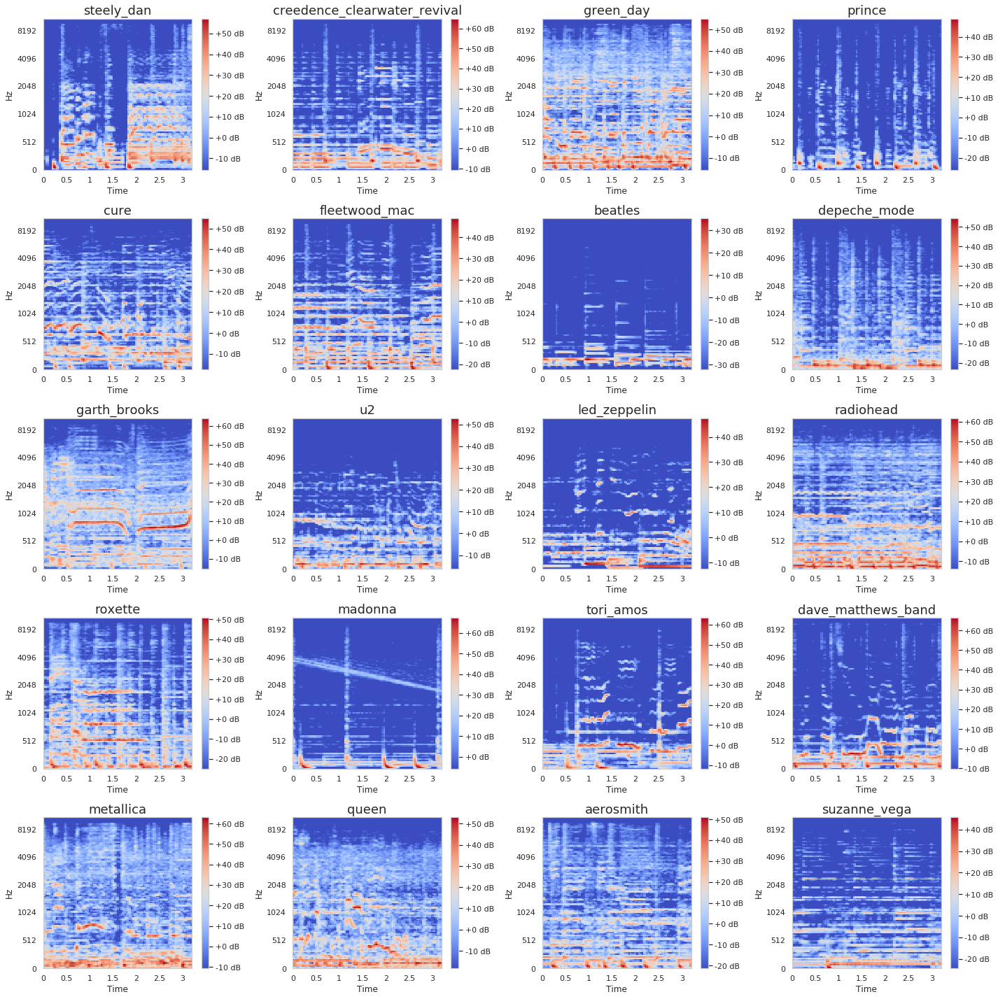

In [56]:
plot_mel(
        song_split_data["test"],
        data_holder,
        SAMPLING_RATE,
        experiment_name="model:song_level:frame_dataset:artist20")

### Эксперименты

#### Song-split model, frame-level features

In [ ]:
# YOU CAN USE FUNCTION FOR LAUNCH ONE EXPERIMENT AND GET STATS FOR IT
# OR USE FUNCTION FOR LAUNCH SEVERAL EXPERIMENTS (IF LEARN MORE THAN ONE MODEL) AND GET MEAN AND BEST SCORES ONLY

##### Измени имя эксперимента в каждой клетке на твое имя эксперимента


100%|██████████| 666/666 [00:14<00:00, 45.82it/s]

                              precision    recall  f1-score   support

          dave_matthews_band       0.80      0.85      0.82       544
                   tori_amos       0.64      0.83      0.72       613
creedence_clearwater_revival       0.92      0.92      0.92       545
                     madonna       0.53      0.51      0.52       607
                garth_brooks       0.89      0.79      0.83       462
                depeche_mode       0.71      0.69      0.70       475
                   metallica       0.90      0.96      0.93       800
                   aerosmith       0.64      0.72      0.68       429
                          u2       0.36      0.33      0.35       456
                   green_day       0.90      0.80      0.85       457
                       queen       0.60      0.55      0.57       529
                led_zeppelin       0.65      0.66      0.66       573
                  steely_dan       0.58      0.61      0.60       324
                   

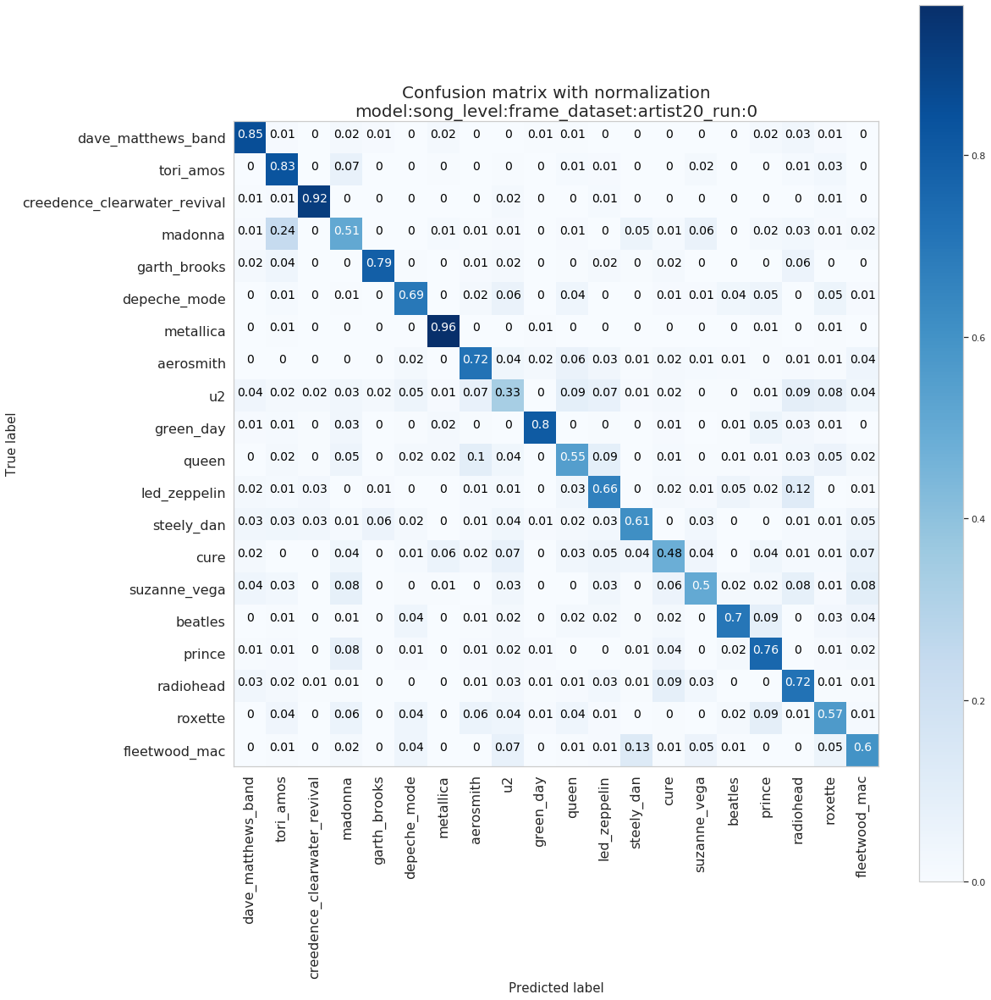


100%|██████████| 666/666 [00:14<00:00, 46.31it/s]

                              precision    recall  f1-score   support

          dave_matthews_band       0.74      0.81      0.77       544
                   tori_amos       0.62      0.86      0.72       613
creedence_clearwater_revival       0.96      0.89      0.92       545
                     madonna       0.48      0.38      0.43       607
                garth_brooks       0.88      0.79      0.84       462
                depeche_mode       0.74      0.74      0.74       475
                   metallica       0.90      0.95      0.92       800
                   aerosmith       0.58      0.68      0.63       429
                          u2       0.40      0.33      0.36       456
                   green_day       0.85      0.80      0.82       457
                       queen       0.56      0.49      0.52       529
                led_zeppelin       0.49      0.61      0.54       573
                  steely_dan       0.67      0.75      0.71       324
                   

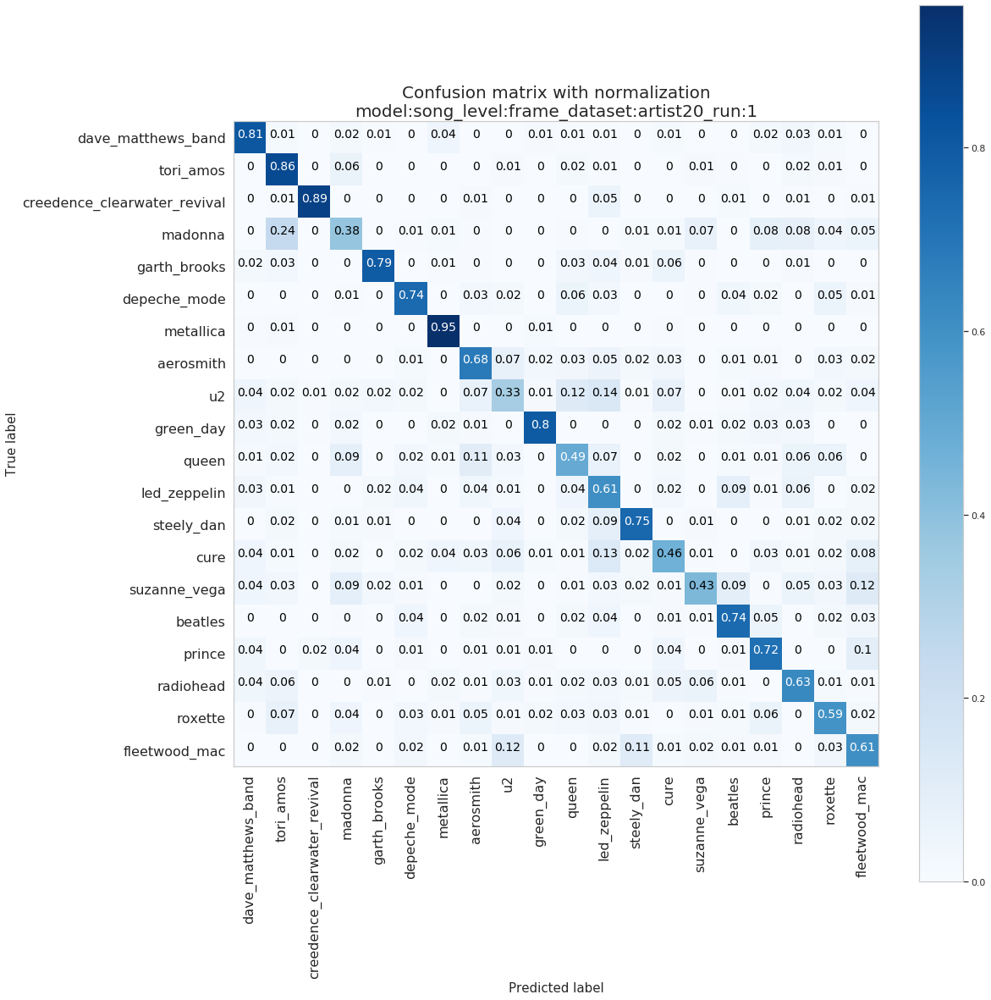


100%|██████████| 666/666 [00:14<00:00, 46.70it/s]

                              precision    recall  f1-score   support

          dave_matthews_band       0.71      0.85      0.78       544
                   tori_amos       0.61      0.85      0.71       613
creedence_clearwater_revival       0.96      0.90      0.93       545
                     madonna       0.51      0.39      0.44       607
                garth_brooks       0.84      0.76      0.80       462
                depeche_mode       0.66      0.78      0.71       475
                   metallica       0.93      0.94      0.94       800
                   aerosmith       0.59      0.70      0.64       429
                          u2       0.46      0.28      0.35       456
                   green_day       0.83      0.83      0.83       457
                       queen       0.60      0.42      0.49       529
                led_zeppelin       0.59      0.67      0.63       573
                  steely_dan       0.65      0.75      0.70       324
                   

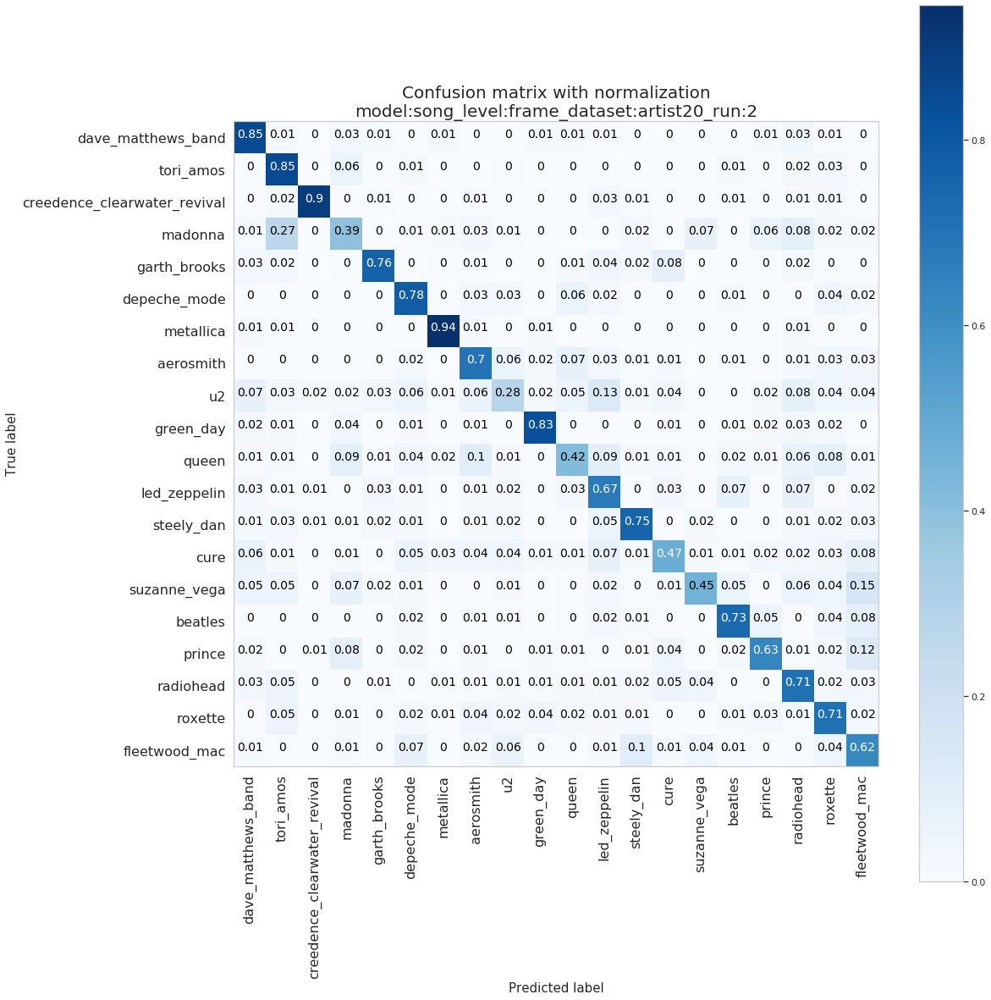

TESTED 3 MODELS
MEAN F1: 0.67
BEST F1: 0.68
MEAN ACCURACY: 0.68
BEST ACCURACY: 0.69


In [52]:
#EXAMPLE:
# report, (f1, accuracy), cm = make_experiment(
#                                         model_song, song_split_data["test"],
#                                         data_holder, feature_level="frame",
#                                         experiment_name="model:song_level:frame_dataset:artist20",
#                                         verbose=True)
# print(f"F1 SCORE: {f1}")
# print(f"ACCURACY: {accuracy}")

#EXAMPLE:
mean_f1, mean_accuracy, best_f1, best_accuracy = make_several_experiments(
                                           models_song, song_split_data["test"],
                                           data_holder, feature_level="frame",
                                           experiment_name="model:song_level:frame_dataset:artist20",
                                           verbose=True)
print(f"TESTED {len(models_song)} MODELS")
print(f"MEAN F1: {mean_f1}")
print(f"BEST F1: {best_f1}")
print(f"MEAN ACCURACY: {mean_accuracy}")
print(f"BEST ACCURACY: {best_accuracy}")

##### Измени имя эксперимента в каждой клетке на твое имя эксперимента


100%|██████████| 333/333 [00:13<00:00, 24.88it/s]

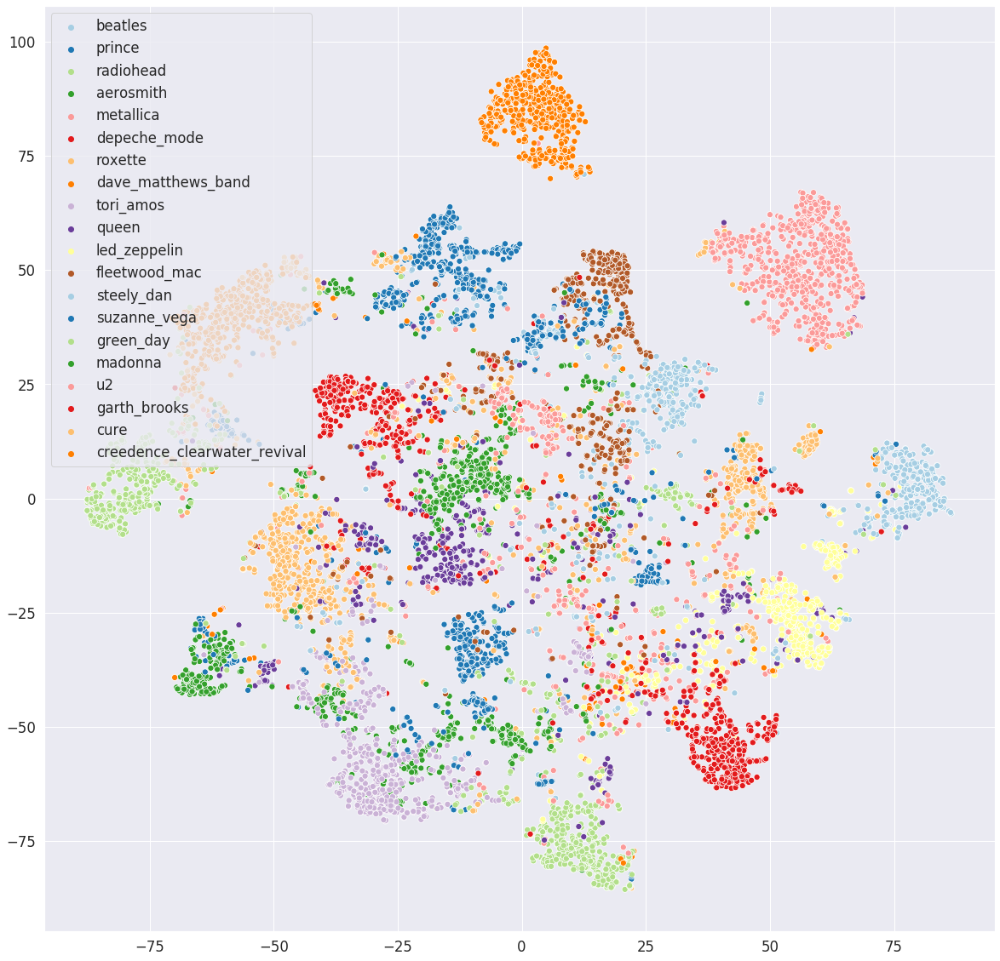

In [53]:
plot_tsne(
        models_song[-1], song_split_data["test"],
        data_holder, experiment_name="model:song_level:frame_dataset:artist20")

#### Song-split model, song-level features

##### Измени имя эксперимента в каждой клетке на твое имя эксперимента


100%|██████████| 666/666 [00:14<00:00, 45.99it/s]

                              precision    recall  f1-score   support

          dave_matthews_band       1.00      1.00      1.00         7
                   tori_amos       0.80      1.00      0.89         8
creedence_clearwater_revival       0.86      1.00      0.92         6
                     madonna       0.67      0.57      0.62         7
                garth_brooks       1.00      1.00      1.00         7
                depeche_mode       0.88      1.00      0.93         7
                   metallica       0.88      1.00      0.93         7
                   aerosmith       0.83      1.00      0.91         5
                          u2       1.00      0.33      0.50         6
                   green_day       1.00      1.00      1.00         9
                       queen       1.00      0.88      0.93         8
                led_zeppelin       0.62      1.00      0.77         5
                  steely_dan       0.50      0.80      0.62         5
                   

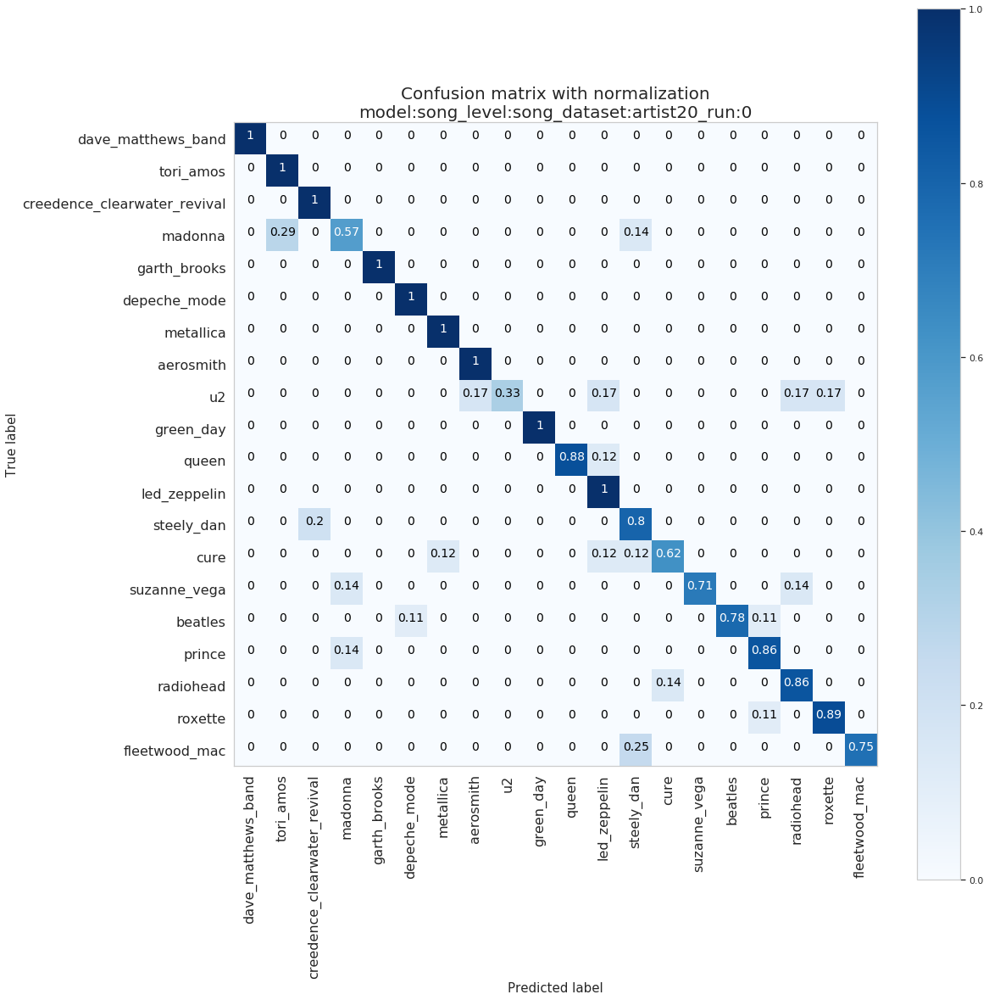


100%|██████████| 666/666 [00:14<00:00, 46.48it/s]

                              precision    recall  f1-score   support

          dave_matthews_band       0.78      1.00      0.88         7
                   tori_amos       0.73      1.00      0.84         8
creedence_clearwater_revival       1.00      1.00      1.00         6
                     madonna       0.50      0.29      0.36         7
                garth_brooks       1.00      1.00      1.00         7
                depeche_mode       0.78      1.00      0.88         7
                   metallica       1.00      1.00      1.00         7
                   aerosmith       1.00      1.00      1.00         5
                          u2       0.57      0.67      0.62         6
                   green_day       1.00      1.00      1.00         9
                       queen       1.00      0.75      0.86         8
                led_zeppelin       0.50      0.60      0.55         5
                  steely_dan       1.00      0.80      0.89         5
                   

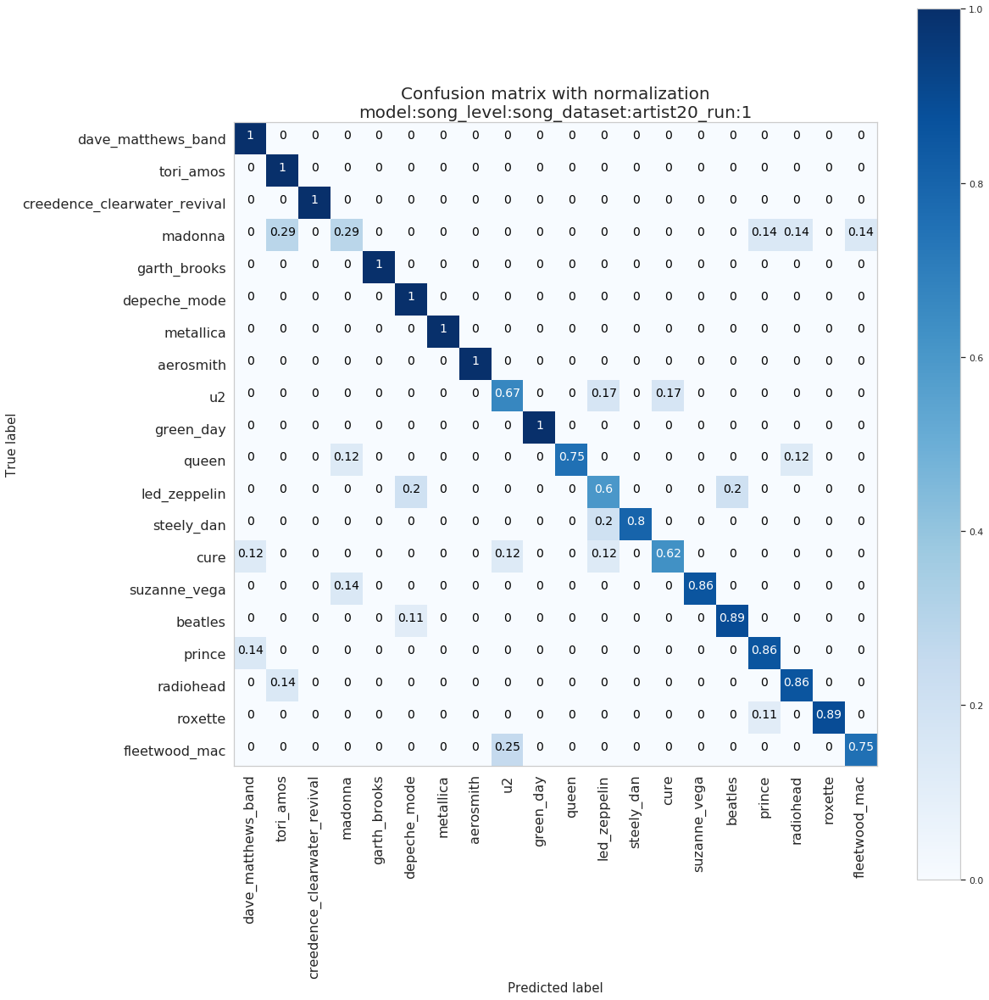


100%|██████████| 666/666 [00:14<00:00, 46.62it/s]

                              precision    recall  f1-score   support

          dave_matthews_band       0.78      1.00      0.88         7
                   tori_amos       0.73      1.00      0.84         8
creedence_clearwater_revival       1.00      1.00      1.00         6
                     madonna       0.50      0.43      0.46         7
                garth_brooks       1.00      1.00      1.00         7
                depeche_mode       1.00      1.00      1.00         7
                   metallica       1.00      1.00      1.00         7
                   aerosmith       0.83      1.00      0.91         5
                          u2       0.67      0.33      0.44         6
                   green_day       0.90      1.00      0.95         9
                       queen       1.00      0.62      0.77         8
                led_zeppelin       0.50      1.00      0.67         5
                  steely_dan       1.00      0.80      0.89         5
                   

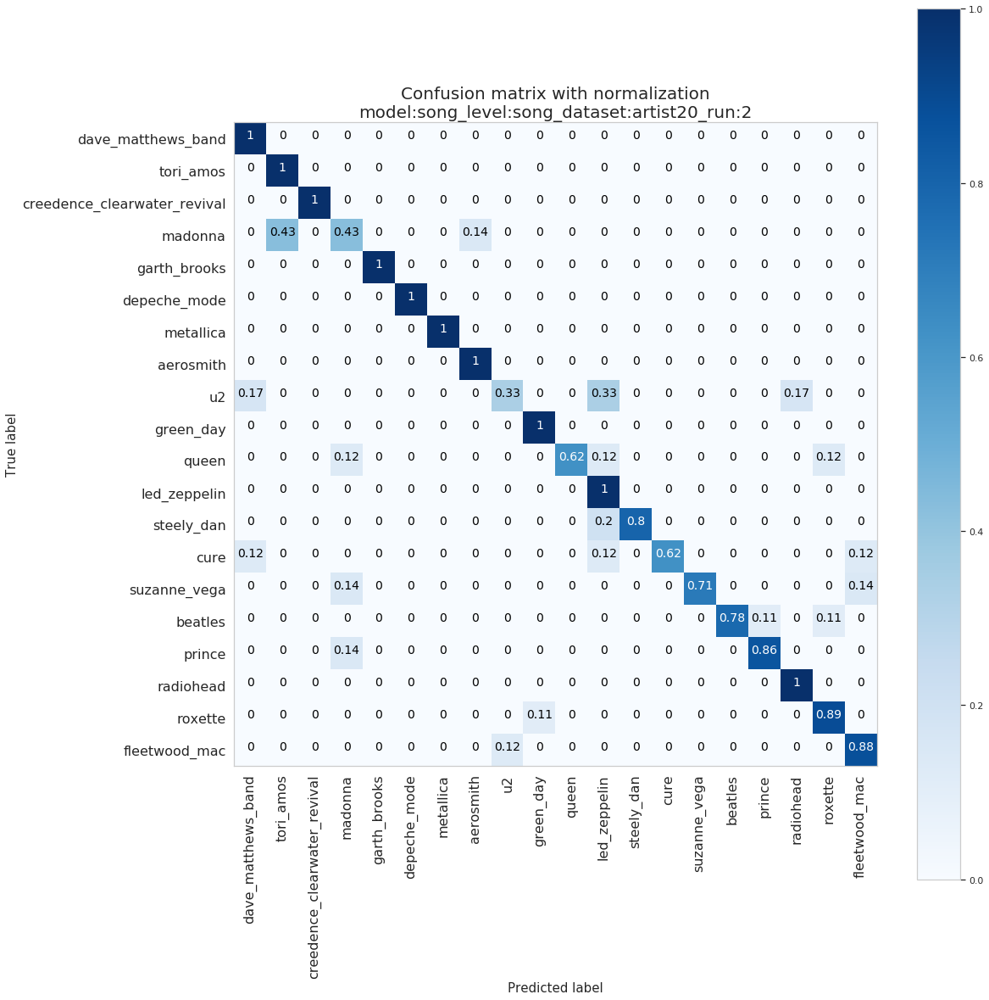

TESTED 3 MODELS
MEAN F1: 0.8433333333333333
BEST F1: 0.85
MEAN ACCURACY: 0.85
BEST ACCURACY: 0.85


In [54]:
# report, (f1, accuracy), cm = make_experiment(
#                                         model_song, song_split_data["test"],
#                                         data_holder, feature_level="song",
#                                         experiment_name="model:song_level:song_dataset:artist20",
#                                         verbose=True)
# print(f"F1 SCORE: {f1}")
# print(f"ACCURACY: {accuracy}")

mean_f1, mean_accuracy, best_f1, best_accuracy = make_several_experiments(
                                           models_song, song_split_data["test"],
                                           data_holder, feature_level="song",
                                           experiment_name="model:song_level:song_dataset:artist20",
                                           verbose=True)
print(f"TESTED {len(models_song)} MODELS")
print(f"MEAN F1: {mean_f1}")
print(f"BEST F1: {best_f1}")
print(f"MEAN ACCURACY: {mean_accuracy}")
print(f"BEST ACCURACY: {best_accuracy}")

#### Album-split model, frame-level features

##### Измени имя эксперимента в каждой клетке на твое имя эксперимента

In [55]:
# report, (f1, accuracy), cm = make_experiment(
#                                         model_album, song_split_data["test"],
#                                         data_holder, feature_level="frame",
#                                         experiment_name="model:album_level:frame_dataset:artist20",
#                                         verbose=True)
# print(f"F1 SCORE: {f1}")
# print(f"ACCURACY: {accuracy}")

mean_f1, mean_accuracy, best_f1, best_accuracy = make_several_experiments(
                                           models_album, song_split_data["test"],
                                           data_holder, feature_level="frame",
                                           experiment_name="model:album_level:frame_dataset:artist20",
                                           verbose=True)
print(f"TESTED {len(models_song)} MODELS")
print(f"MEAN F1: {mean_f1}")
print(f"BEST F1: {best_f1}")
print(f"MEAN ACCURACY: {mean_accuracy}")
print(f"BEST ACCURACY: {best_accuracy}")

/home/liebeann/.virtualenv/sound_py37-3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3118: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/liebeann/.virtualenv/sound_py37-3/lib/python3.7/site-packages/numpy/core/_methods.py:85: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


ValueError: zero-size array to reduction operation maximum which has no identity

##### Измени имя эксперимента в каждой клетке на твое имя эксперимента

In [ ]:
plot_tsne(
        models_album[-1], song_split_data["test"],
        data_holder, experiment_name="model:album_level:frame_dataset:artist20")

#### Album-split model, song-level features

##### Измени имя эксперимента в каждой клетке на твое имя эксперимента

In [ ]:
# report, (f1, accuracy), cm = make_experiment(
#                                         model_album, song_split_data["test"],
#                                         data_holder, feature_level="song",
#                                         experiment_name="model:album_level:song_dataset:artist20",
#                                         verbose=True)
# print(f"F1 SCORE: {f1}")
# print(f"ACCURACY: {accuracy}")

mean_f1, mean_accuracy, best_f1, best_accuracy = make_several_experiments(
                                           models_album, song_split_data["test"],
                                           data_holder, feature_level="song",
                                           experiment_name="model:album_level:song_dataset:artist20",
                                           verbose=True)
print(f"TESTED {len(models_song)} MODELS")
print(f"MEAN F1: {mean_f1}")
print(f"BEST F1: {best_f1}")
print(f"MEAN ACCURACY: {mean_accuracy}")
print(f"BEST ACCURACY: {best_accuracy}")